In [1]:
import os
import pickle

In [7]:
from constants_feature_level import xlims, ylims, sample_names, marker_list, reference_sample
from helper import universal_feature_data_loader
from exploratory_data_analysis import process_feature_samples, process_feature_samples_per_marker
from normalize import normalize_and_plot_distributions
from image_transformation import generate_normalized_feature, calculate_shift_in_log_pixels

# Load your feature dataset (can be pickle, npy, or csv file)

In [8]:
feature_data_dir = "/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/feature-level-dataset"

pickle_files_paths = [
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC01.pkl'),
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC02.pkl'),
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC03.pkl'),
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC04.pkl'),
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC05.pkl'),
    os.path.join(feature_data_dir, f'10x_res_intensity_mean_feature_CRC06.pkl')
]

feature_data = [universal_feature_data_loader(path) for path in pickle_files_paths]

# Let's visualize what the feature data format looks like

The above dataset is CRC-ORION data for patient sample CRC01-06

feature_data contains 6 dictionary, each dictionar is a key-value pair with the key being the keyword "intensity_mean", and values being the cell mean intensity array for the 19 channels. intensity_mean should have a shape of (#channel, #cells)

In [9]:
feature_data

[{'intensity_mean': array([[6722.73333333, 2891.28846154, 1652.75      , ..., 4811.99401198,
          4117.25882353, 1989.40559441],
         [ 312.        ,  185.40384615,  192.375     , ...,  423.88622754,
           288.57647059,  239.93706294],
         [ 255.66666667,  193.19230769,  181.625     , ...,  217.76646707,
           735.89411765,  193.51048951],
         ...,
         [ 205.06666667,  179.19230769,  175.375     , ...,  295.39520958,
           217.37647059,  160.67132867],
         [ 209.53333333,  203.17307692,  193.8125    , ...,  842.84431138,
           232.6       ,  231.63636364],
         [ 502.8       ,  141.59615385,  137.15625   , ...,  103.26347305,
           207.95294118,  173.94405594]])},
 {'intensity_mean': array([[2888.4       , 7291.10285714, 2589.5       , ..., 4878.27380952,
          2320.59770115, 2252.70229008],
         [ 582.36923077,  374.97714286,  709.96774194, ...,  577.5       ,
           910.42528736, 4209.5648855 ],
         [ 185.6153

In [10]:
feature_data[0]['intensity_mean'].shape

(19, 1206148)

# Step #1: Perform EDA 

## 1. Plot samples for each marker on the same plot --> visualize variability
Caution: this step will generate two dictionary results_range, results_hist 

* results_range contains the min and max for each marker 
* results_hist contains the bin_counts and bin_edges for each marker

You need to save these two dicts as they will be used in the following pipeline

####################Processing Hoechst####################
Processing CRC01 for marker Hoechst......
Processing CRC02 for marker Hoechst......
Processing CRC03 for marker Hoechst......
Processing CRC04 for marker Hoechst......
Processing CRC05 for marker Hoechst......
Processing CRC06 for marker Hoechst......
Plotting the pixel intensidty distribution......
####################Processing AF1####################
Processing CRC01 for marker AF1......
Processing CRC02 for marker AF1......
Processing CRC03 for marker AF1......
Processing CRC04 for marker AF1......
Processing CRC05 for marker AF1......
Processing CRC06 for marker AF1......
Plotting the pixel intensidty distribution......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/exploratory_data_analysis.py:20: RuntimeWarning: divide by zero encountered in log
  ch = np.log(image)


####################Processing CD31####################
Processing CRC01 for marker CD31......
Processing CRC02 for marker CD31......
Processing CRC03 for marker CD31......
Processing CRC04 for marker CD31......
Processing CRC05 for marker CD31......
Processing CRC06 for marker CD31......
Plotting the pixel intensidty distribution......
####################Processing CD45####################
Processing CRC01 for marker CD45......
Processing CRC02 for marker CD45......
Processing CRC03 for marker CD45......
Processing CRC04 for marker CD45......
Processing CRC05 for marker CD45......
Processing CRC06 for marker CD45......
Plotting the pixel intensidty distribution......
####################Processing CD68####################
Processing CRC01 for marker CD68......
Processing CRC02 for marker CD68......
Processing CRC03 for marker CD68......
Processing CRC04 for marker CD68......
Processing CRC05 for marker CD68......
Processing CRC06 for marker CD68......
Plotting the pixel intensidty di

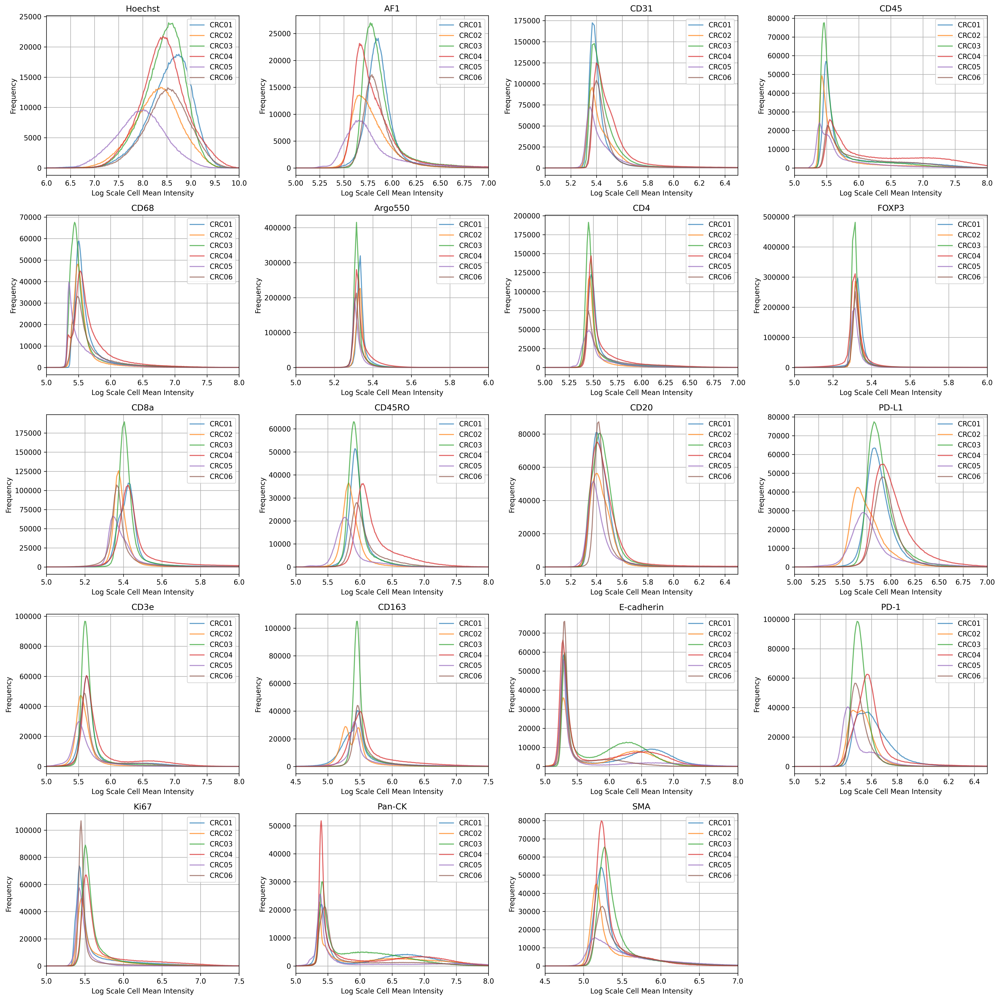

In [11]:
results_range, results_hist = process_feature_samples(
    feature_data, 
    sample_names, 
    marker_list, 
    bin_counts=1024, 
    subplots_per_row=4,
    if_grid=True,
    dpi=300,
    xlims=xlims, # if this is the first time you run this, set xlims = None
    ylims=None # if this is the first time you run this, set ylims = None
)

### I recommend you saving these two dicts as a pickle file for later use

In [ ]:
file_path = 'feature-level-crc01-06-all-marker-10x-resolution-range-list.pkl'  # Change this to your desired file path
with open(file_path, 'wb') as file:
    pickle.dump(results_range, file)
    
file_path = 'feature-level-crc01-06-all-marker-10x-resolution-hist-list.pkl'  # Change this to your desired file path
with open(file_path, 'wb') as file:
    pickle.dump(results_hist, file)

### And when you need to use it you can load them: 

you might need to change the filepath

In [ ]:
file_path = 'feature-level-crc01-06-all-marker-10x-resolution-range-list.pkl'
with open(file_path, 'rb') as file:
    results_range = pickle.load(file)

file_path = 'feature-level-crc01-06-all-marker-10x-resolution-hist-list.pkl'
with open(file_path, 'rb') as file:
    results_hist = pickle.load(file)

## 2. Plot samples for each marker separately --> pick reference sample per marker

####################Processing Hoechst####################
Processing CRC01 for marker Hoechst......
Processing CRC02 for marker Hoechst......
Processing CRC03 for marker Hoechst......
Processing CRC04 for marker Hoechst......
Processing CRC05 for marker Hoechst......
Processing CRC06 for marker Hoechst......


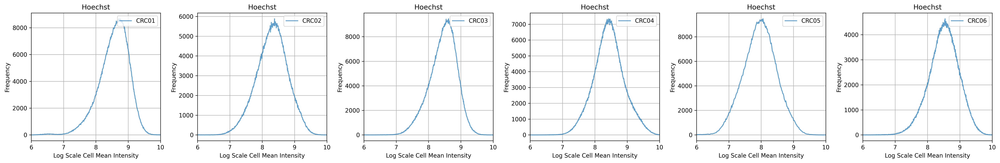

####################Processing AF1####################
Processing CRC01 for marker AF1......
Processing CRC02 for marker AF1......
Processing CRC03 for marker AF1......
Processing CRC04 for marker AF1......
Processing CRC05 for marker AF1......
Processing CRC06 for marker AF1......


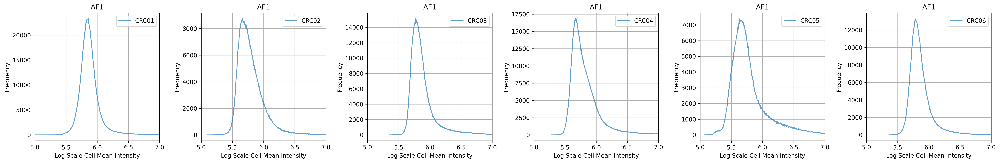

####################Processing CD31####################
Processing CRC01 for marker CD31......
Processing CRC02 for marker CD31......
Processing CRC03 for marker CD31......
Processing CRC04 for marker CD31......
Processing CRC05 for marker CD31......
Processing CRC06 for marker CD31......


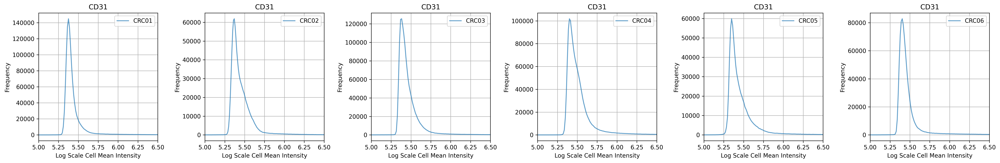

####################Processing CD45####################
Processing CRC01 for marker CD45......
Processing CRC02 for marker CD45......
Processing CRC03 for marker CD45......
Processing CRC04 for marker CD45......
Processing CRC05 for marker CD45......
Processing CRC06 for marker CD45......


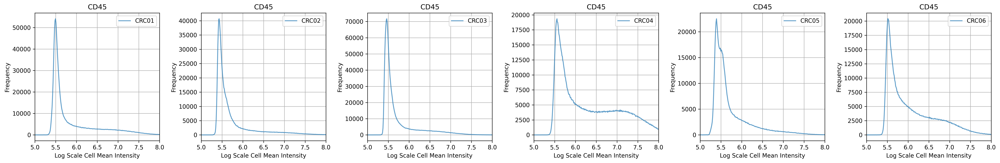

####################Processing CD68####################
Processing CRC01 for marker CD68......
Processing CRC02 for marker CD68......
Processing CRC03 for marker CD68......
Processing CRC04 for marker CD68......
Processing CRC05 for marker CD68......
Processing CRC06 for marker CD68......


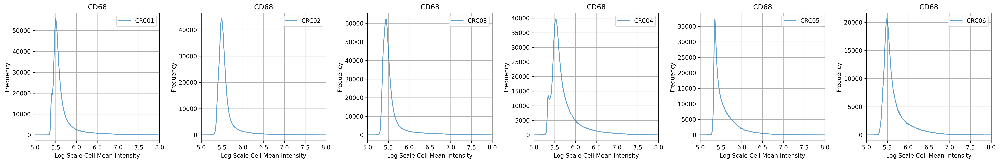

####################Processing Argo550####################
Processing CRC01 for marker Argo550......
Processing CRC02 for marker Argo550......
Processing CRC03 for marker Argo550......
Processing CRC04 for marker Argo550......
Processing CRC05 for marker Argo550......
Processing CRC06 for marker Argo550......


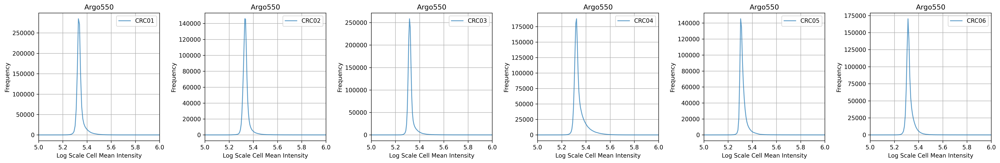

####################Processing CD4####################
Processing CRC01 for marker CD4......
Processing CRC02 for marker CD4......
Processing CRC03 for marker CD4......
Processing CRC04 for marker CD4......
Processing CRC05 for marker CD4......
Processing CRC06 for marker CD4......


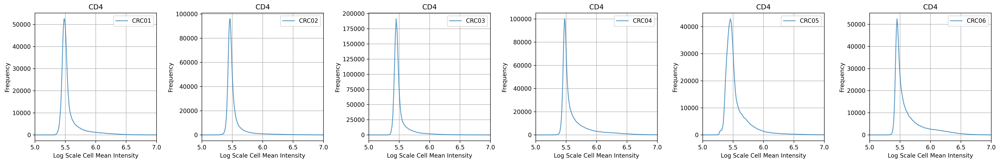

####################Processing FOXP3####################
Processing CRC01 for marker FOXP3......
Processing CRC02 for marker FOXP3......
Processing CRC03 for marker FOXP3......
Processing CRC04 for marker FOXP3......
Processing CRC05 for marker FOXP3......
Processing CRC06 for marker FOXP3......


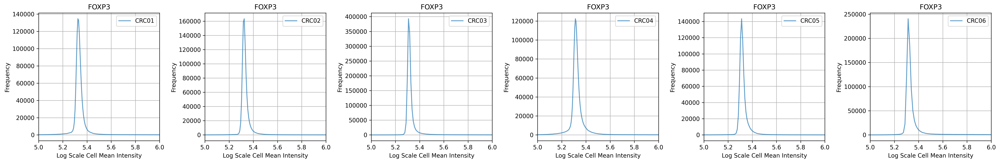

####################Processing CD8a####################
Processing CRC01 for marker CD8a......
Processing CRC02 for marker CD8a......
Processing CRC03 for marker CD8a......
Processing CRC04 for marker CD8a......
Processing CRC05 for marker CD8a......
Processing CRC06 for marker CD8a......


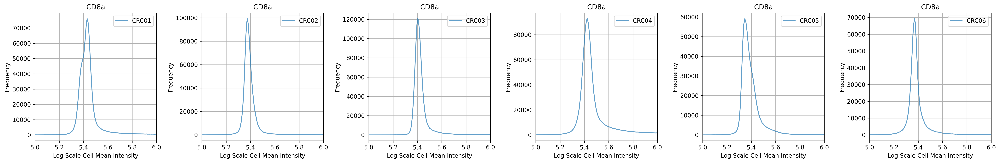

####################Processing CD45RO####################
Processing CRC01 for marker CD45RO......
Processing CRC02 for marker CD45RO......
Processing CRC03 for marker CD45RO......
Processing CRC04 for marker CD45RO......
Processing CRC05 for marker CD45RO......
Processing CRC06 for marker CD45RO......


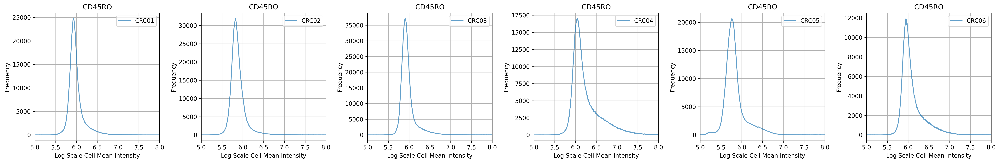

####################Processing CD20####################
Processing CRC01 for marker CD20......
Processing CRC02 for marker CD20......
Processing CRC03 for marker CD20......
Processing CRC04 for marker CD20......
Processing CRC05 for marker CD20......
Processing CRC06 for marker CD20......


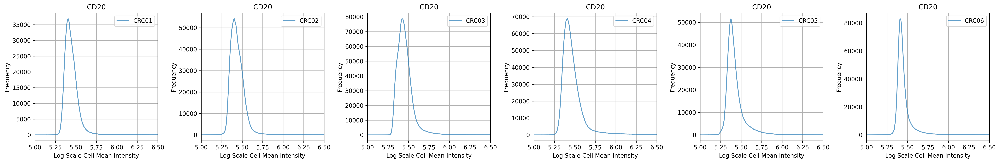

####################Processing PD-L1####################
Processing CRC01 for marker PD-L1......
Processing CRC02 for marker PD-L1......
Processing CRC03 for marker PD-L1......
Processing CRC04 for marker PD-L1......
Processing CRC05 for marker PD-L1......
Processing CRC06 for marker PD-L1......


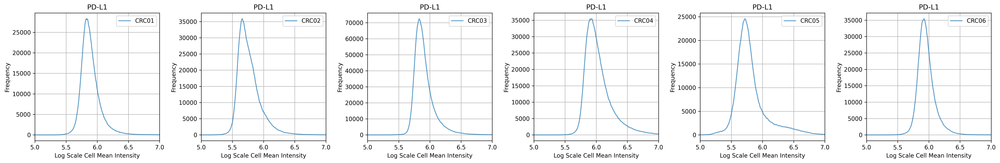

####################Processing CD3e####################
Processing CRC01 for marker CD3e......
Processing CRC02 for marker CD3e......
Processing CRC03 for marker CD3e......
Processing CRC04 for marker CD3e......
Processing CRC05 for marker CD3e......
Processing CRC06 for marker CD3e......


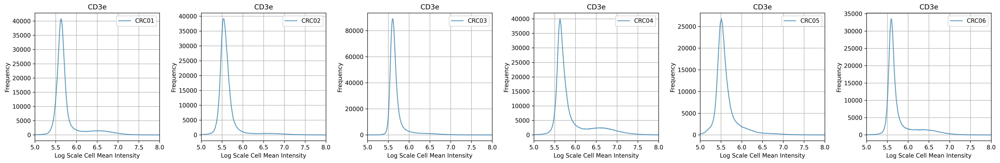

####################Processing CD163####################
Processing CRC01 for marker CD163......
Processing CRC02 for marker CD163......
Processing CRC03 for marker CD163......
Processing CRC04 for marker CD163......
Processing CRC05 for marker CD163......
Processing CRC06 for marker CD163......


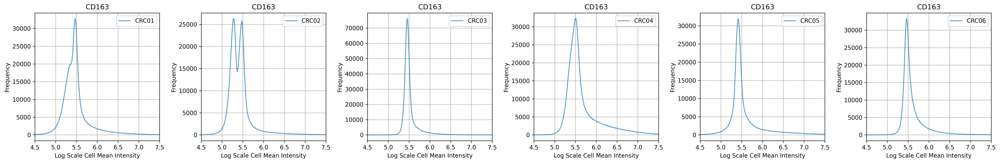

####################Processing E-cadherin####################
Processing CRC01 for marker E-cadherin......
Processing CRC02 for marker E-cadherin......
Processing CRC03 for marker E-cadherin......
Processing CRC04 for marker E-cadherin......
Processing CRC05 for marker E-cadherin......
Processing CRC06 for marker E-cadherin......


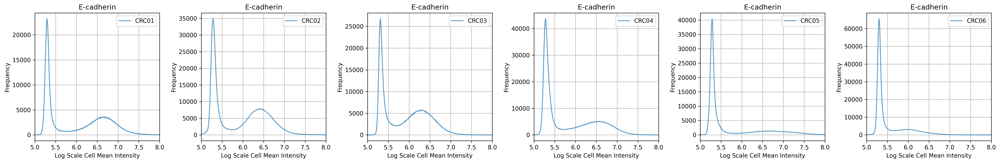

####################Processing PD-1####################
Processing CRC01 for marker PD-1......
Processing CRC02 for marker PD-1......
Processing CRC03 for marker PD-1......
Processing CRC04 for marker PD-1......
Processing CRC05 for marker PD-1......
Processing CRC06 for marker PD-1......


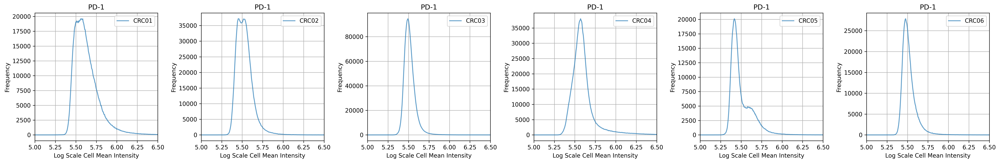

####################Processing Ki67####################
Processing CRC01 for marker Ki67......
Processing CRC02 for marker Ki67......
Processing CRC03 for marker Ki67......
Processing CRC04 for marker Ki67......
Processing CRC05 for marker Ki67......
Processing CRC06 for marker Ki67......


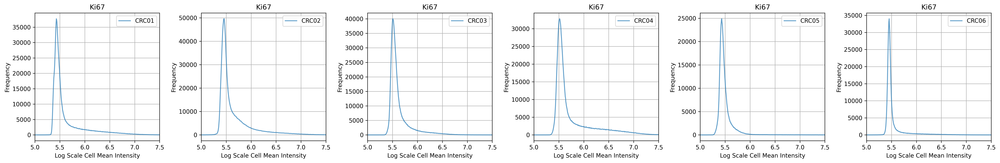

####################Processing Pan-CK####################
Processing CRC01 for marker Pan-CK......
Processing CRC02 for marker Pan-CK......
Processing CRC03 for marker Pan-CK......
Processing CRC04 for marker Pan-CK......
Processing CRC05 for marker Pan-CK......
Processing CRC06 for marker Pan-CK......


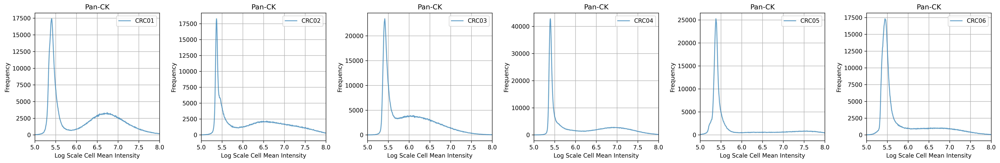

####################Processing SMA####################
Processing CRC01 for marker SMA......
Processing CRC02 for marker SMA......
Processing CRC03 for marker SMA......
Processing CRC04 for marker SMA......
Processing CRC05 for marker SMA......
Processing CRC06 for marker SMA......


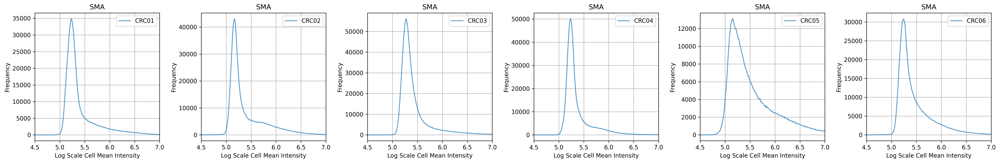

In [12]:
process_feature_samples_per_marker(feature_data, 
                               sample_names, 
                               marker_list, 
                               bin_counts=1024, 
                               if_grid=True,
                               dpi=300, 
                               xlims=xlims, 
                               ylims=None, 
                               save_filename=None)

# Step #2: Perform Normalization

At the end of step 1, you should have identified reference sample per marker

You should put the ref sample per marker in a list, they should look like this (for a 19 marker/channel dataset): 

reference_sample = ['CRC01', 'CRC01', 'CRC01', 'CRC02', 'CRC02', 'CRC01', 'CRC02', 'CRC01', 'CRC02', 'CRC01', 'CRC01', 'CRC01', 'CRC02', 'CRC05', 'CRC01', 'CRC01', 'CRC02', 'CRC01', 'CRC01']

You should update the ref sample constant in constants.py

this step will generate a dict called shifts_fft_dict which contains the amount of shift for each marker

## 1. calculate amount of shift in integer units

****************************** Processing marker Hoechst ******************************
Reference sample for Hoechst is CRC01


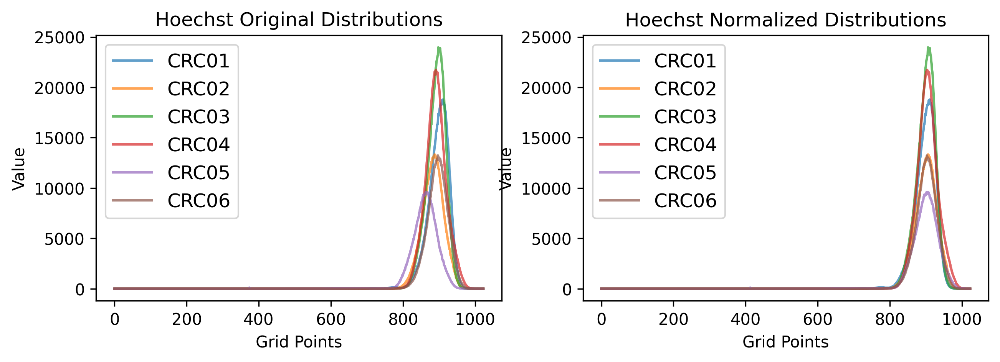

##### Metrics for original marker image #####
Hoechst Pearson Correlation Coefficients: ['1', '0.87935', '0.96756', '0.92791', '0.58849', '0.98072']
Hoechst Spearman Correlation Coefficients: ['1', '0.88502', '0.91865', '0.94922', '0.65509', '0.93335']
Hoechst KL Divergences: ['0', '0.17034', '0.062169', '0.092873', '0.73791', '0.025007'] 

##### Metrics for shifted marker image #####
Hoechst shifted Pearson Correlation Coefficients: ['1', '0.99284', '0.99892', '0.99004', '0.98725', '0.99444']
Hoechst shifted Spearman Correlation Coefficients: ['1', '0.92472', '0.94152', '0.95045', '0.77082', '0.94114']
Hoechst shifted KL Divergences: ['0', '0.032349', '0.011852', '0.063298', '0.052927', '0.024082'] 

Hoechst shifts_direct is: [0, -18, -8, -13, -39, -6]
Hoechst shifts_fft is:    [0, -18, -8, -13, -39, -6]

****************************** Processing marker AF1 ******************************
Reference sample for AF1 is CRC01


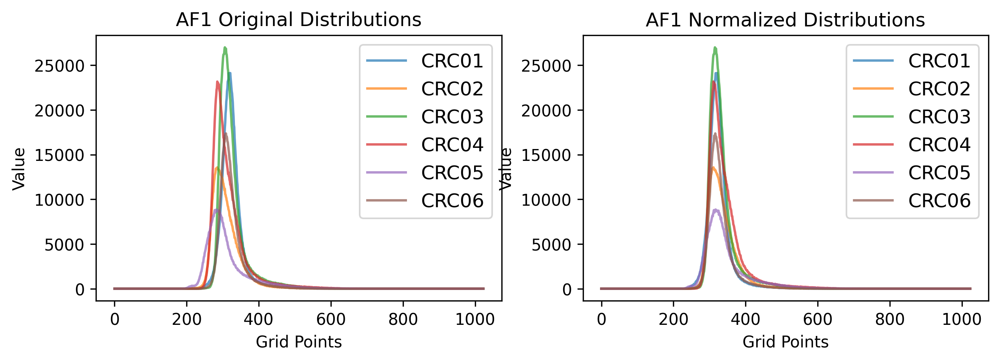

##### Metrics for original marker image #####
AF1 Pearson Correlation Coefficients: ['1', '0.72717', '0.93686', '0.71815', '0.57858', '0.95747']
AF1 Spearman Correlation Coefficients: ['1', '0.94293', '0.92373', '0.92949', '0.93375', '0.90666']
AF1 KL Divergences: ['0', '0.33076', '0.085609', '0.32817', '0.63523', '0.051342'] 

##### Metrics for shifted marker image #####
AF1 shifted Pearson Correlation Coefficients: ['1', '0.96559', '0.99136', '0.96893', '0.96115', '0.99597']
AF1 shifted Spearman Correlation Coefficients: ['1', '0.93903', '0.90685', '0.88587', '0.94601', '0.90044']
AF1 shifted KL Divergences: ['0', '0.082247', '0.08708', '0.14997', '0.13983', '0.034075'] 

AF1 shifts_direct is: [0, -26, -9, -26, -34, -7]
AF1 shifts_fft is:    [0, -26, -9, -26, -34, -7]

****************************** Processing marker CD31 ******************************
Reference sample for CD31 is CRC01


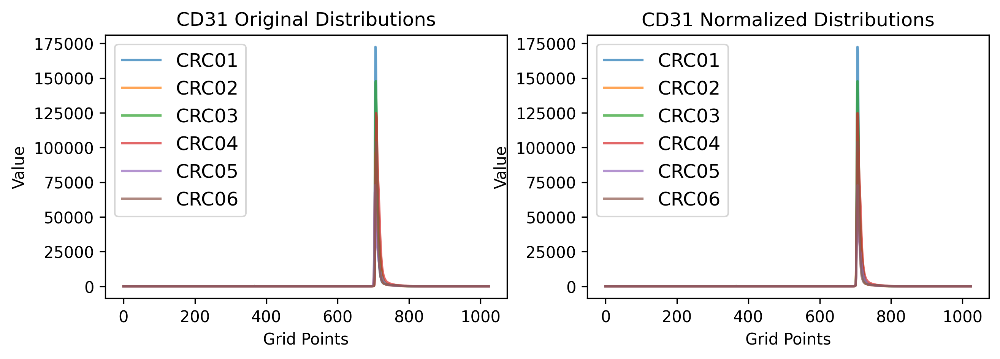

##### Metrics for original marker image #####
CD31 Pearson Correlation Coefficients: ['1', '0.95773', '0.95621', '0.766', '0.91377', '0.88931']
CD31 Spearman Correlation Coefficients: ['1', '0.82366', '0.78947', '0.82745', '0.84096', '0.84382']
CD31 KL Divergences: ['0', '0.09201', '0.10597', '0.55176', '0.15352', '0.22385'] 

##### Metrics for shifted marker image #####
CD31 shifted Pearson Correlation Coefficients: ['1', '0.95773', '0.9731', '0.93878', '0.96506', '0.98701']
CD31 shifted Spearman Correlation Coefficients: ['1', '0.82366', '0.78569', '0.82691', '0.83216', '0.81976']
CD31 shifted KL Divergences: ['0', '0.09201', '0.053084', '0.13038', '0.10039', '0.022879'] 

CD31 shifts_direct is: [0, 0, 1, 2, -1, 2]
CD31 shifts_fft is:    [0, 0, 1, 2, -1, 2]

****************************** Processing marker CD45 ******************************
Reference sample for CD45 is CRC02


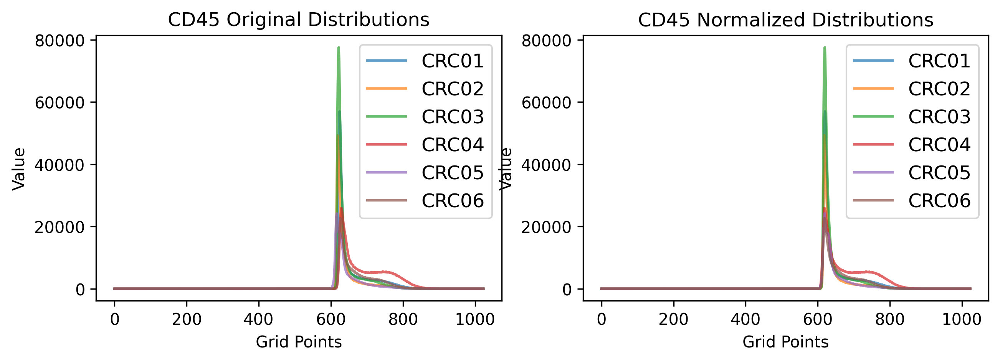

##### Metrics for original marker image #####
CD45 Pearson Correlation Coefficients: ['1', '0.82783', '0.92562', '0.7284', '0.7941', '0.88291']
CD45 Spearman Correlation Coefficients: ['1', '0.83783', '0.77042', '0.82166', '0.83851', '0.78516']
CD45 KL Divergences: ['0', '0.16568', '0.11496', '0.44795', '0.24367', '0.17802'] 

##### Metrics for shifted marker image #####
CD45 shifted Pearson Correlation Coefficients: ['1', '0.98544', '0.98909', '0.88574', '0.93557', '0.93706']
CD45 shifted Spearman Correlation Coefficients: ['1', '0.82027', '0.75681', '0.83598', '0.82064', '0.78028']
CD45 shifted KL Divergences: ['0', '0.057215', '0.074006', '0.19847', '0.087867', '0.0946'] 

CD45 shifts_direct is: [4, 0, 2, 10, -3, 7]
CD45 shifts_fft is:    [4, 0, 2, 10, -3, 7]

****************************** Processing marker CD68 ******************************
Reference sample for CD68 is CRC02


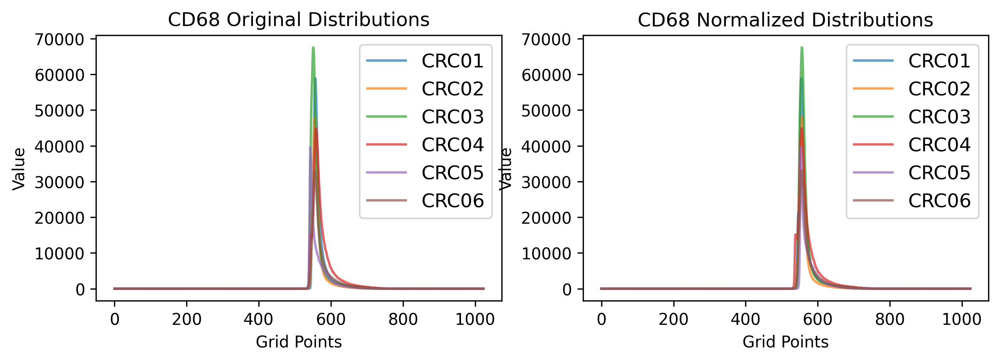

##### Metrics for original marker image #####
CD68 Pearson Correlation Coefficients: ['1', '0.98053', '0.81384', '0.94833', '0.56687', '0.9791']
CD68 Spearman Correlation Coefficients: ['1', '0.90214', '0.87328', '0.90571', '0.87542', '0.87542']
CD68 KL Divergences: ['0', '0.052487', '0.24913', '0.11413', '0.45374', '0.05438'] 

##### Metrics for shifted marker image #####
CD68 shifted Pearson Correlation Coefficients: ['1', '0.99434', '0.98887', '0.96093', '0.94749', '0.9873']
CD68 shifted Spearman Correlation Coefficients: ['1', '0.89161', '0.86779', '0.90739', '0.86848', '0.8708']
CD68 shifted KL Divergences: ['0', '0.024534', '0.029063', '0.11094', '0.26222', '0.041285'] 

CD68 shifts_direct is: [2, 0, -5, 4, -10, 0]
CD68 shifts_fft is:    [2, 0, -5, 4, -10, 0]

****************************** Processing marker Argo550 ******************************
Reference sample for Argo550 is CRC01


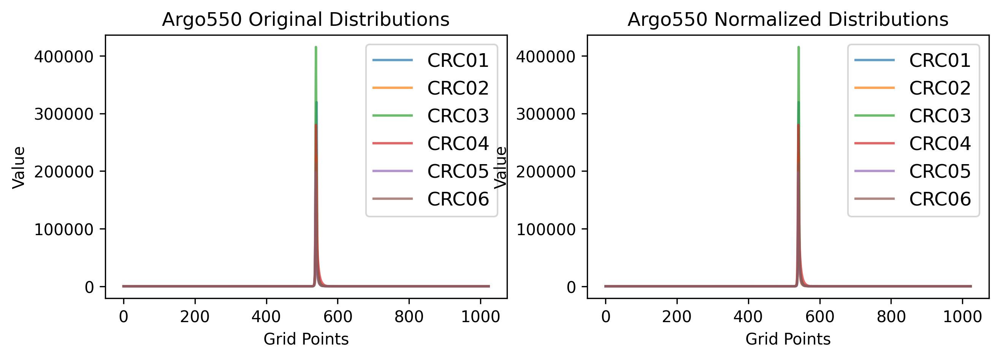

##### Metrics for original marker image #####
Argo550 Pearson Correlation Coefficients: ['1', '0.98813', '0.64403', '0.79306', '0.5344', '0.62604']
Argo550 Spearman Correlation Coefficients: ['1', '0.68446', '0.5859', '0.57989', '0.61983', '0.61852']
Argo550 KL Divergences: ['0', '0.032432', '0.53258', '0.28741', '0.62568', '0.50368'] 

##### Metrics for shifted marker image #####
Argo550 shifted Pearson Correlation Coefficients: ['1', '0.98813', '0.98678', '0.96648', '0.96041', '0.99671']
Argo550 shifted Spearman Correlation Coefficients: ['1', '0.68446', '0.57177', '0.55123', '0.62736', '0.61077']
Argo550 shifted KL Divergences: ['0', '0.032432', '0.0386', '0.085548', '0.042799', '0.015968'] 

Argo550 shifts_direct is: [0, 0, -2, -1, -2, -2]
Argo550 shifts_fft is:    [0, 0, -2, -1, -2, -2]

****************************** Processing marker CD4 ******************************
Reference sample for CD4 is CRC02


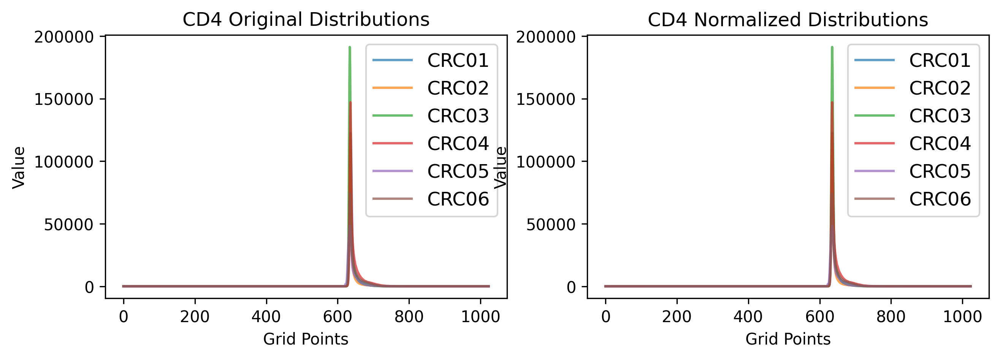

##### Metrics for original marker image #####
CD4 Pearson Correlation Coefficients: ['1', '0.93379', '0.86756', '0.98749', '0.86961', '0.91354']
CD4 Spearman Correlation Coefficients: ['1', '0.81064', '0.71538', '0.82835', '0.77523', '0.78124']
CD4 KL Divergences: ['0', '0.08926', '0.17288', '0.053675', '0.19678', '0.1278'] 

##### Metrics for shifted marker image #####
CD4 shifted Pearson Correlation Coefficients: ['1', '0.98798', '0.99106', '0.98749', '0.95869', '0.96649']
CD4 shifted Spearman Correlation Coefficients: ['1', '0.8202', '0.71721', '0.82835', '0.76798', '0.77748']
CD4 shifted KL Divergences: ['0', '0.029537', '0.037937', '0.053675', '0.077756', '0.096237'] 

CD4 shifts_direct is: [1, 0, -1, 1, -1, 0]
CD4 shifts_fft is:    [1, 0, -1, 1, -1, 0]

****************************** Processing marker FOXP3 ******************************
Reference sample for FOXP3 is CRC01


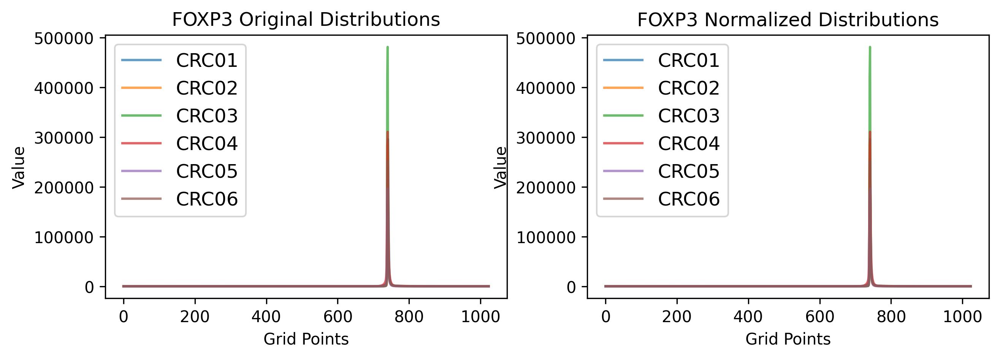

##### Metrics for original marker image #####
FOXP3 Pearson Correlation Coefficients: ['1', '0.97813', '0.80112', '0.87466', '0.83751', '0.94917']
FOXP3 Spearman Correlation Coefficients: ['1', '0.90783', '0.75903', '0.93299', '0.84165', '0.83557']
FOXP3 KL Divergences: ['0', '0.055745', '0.35891', '0.17878', '0.23508', '0.097499'] 

##### Metrics for shifted marker image #####
FOXP3 shifted Pearson Correlation Coefficients: ['1', '0.97813', '0.97604', '0.99787', '0.99643', '0.96247']
FOXP3 shifted Spearman Correlation Coefficients: ['1', '0.90783', '0.76019', '0.93344', '0.83461', '0.82688']
FOXP3 shifted KL Divergences: ['0', '0.055745', '0.14393', '0.020326', '0.039852', '0.12916'] 

FOXP3 shifts_direct is: [0, 0, -1, -1, -1, -1]
FOXP3 shifts_fft is:    [0, 0, -1, -1, -1, -1]

****************************** Processing marker CD8a ******************************
Reference sample for CD8a is CRC02


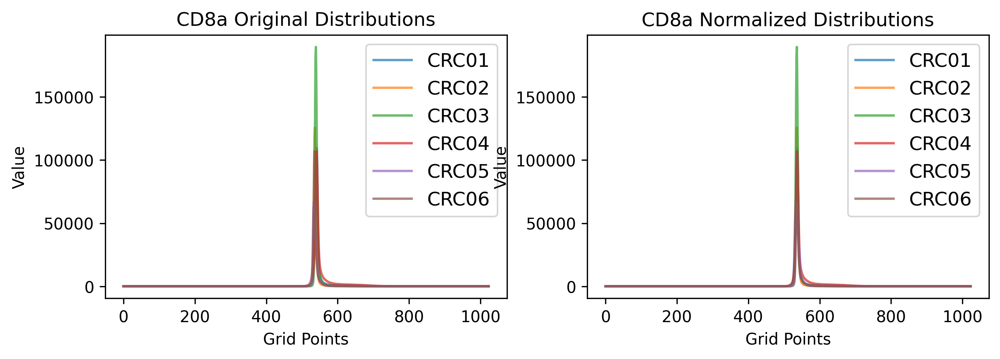

##### Metrics for original marker image #####
CD8a Pearson Correlation Coefficients: ['1', '0.72706', '0.91037', '0.98518', '0.68801', '0.62435']
CD8a Spearman Correlation Coefficients: ['1', '0.86711', '0.8102', '0.90495', '0.84449', '0.86528']
CD8a KL Divergences: ['0', '0.42945', '0.171', '0.072055', '0.40631', '0.57598'] 

##### Metrics for shifted marker image #####
CD8a shifted Pearson Correlation Coefficients: ['1', '0.94776', '0.94479', '0.98518', '0.94995', '0.95722']
CD8a shifted Spearman Correlation Coefficients: ['1', '0.871', '0.81953', '0.90495', '0.83716', '0.86413']
CD8a shifted KL Divergences: ['0', '0.13596', '0.17589', '0.072055', '0.156', '0.071265'] 

CD8a shifts_direct is: [4, 0, 3, 4, -2, -1]
CD8a shifts_fft is:    [4, 0, 3, 4, -2, -1]

****************************** Processing marker CD45RO ******************************
Reference sample for CD45RO is CRC01


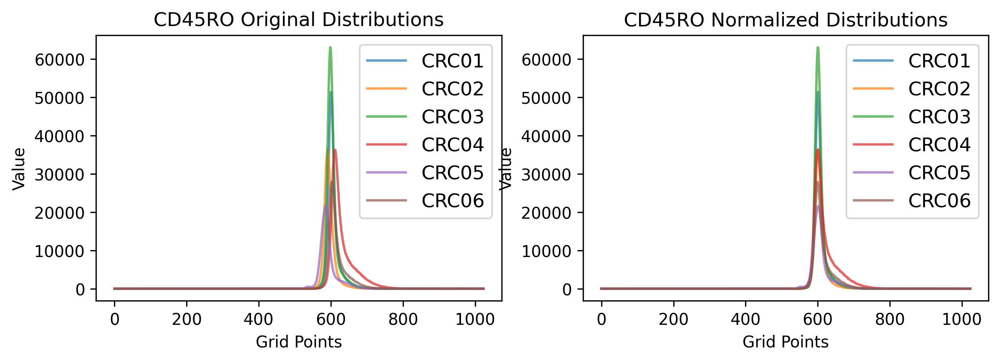

##### Metrics for original marker image #####
CD45RO Pearson Correlation Coefficients: ['1', '0.76852', '0.98258', '0.69091', '0.52355', '0.95849']
CD45RO Spearman Correlation Coefficients: ['1', '0.88963', '0.84798', '0.89311', '0.86999', '0.88791']
CD45RO KL Divergences: ['0', '0.32892', '0.027872', '0.63826', '0.74277', '0.12118'] 

##### Metrics for shifted marker image #####
CD45RO shifted Pearson Correlation Coefficients: ['1', '0.99494', '0.9988', '0.96231', '0.97835', '0.98449']
CD45RO shifted Spearman Correlation Coefficients: ['1', '0.8881', '0.83944', '0.91944', '0.86846', '0.89402']
CD45RO shifted KL Divergences: ['0', '0.01055', '0.012403', '0.15895', '0.063416', '0.06831'] 

CD45RO shifts_direct is: [0, -10, -2, 11, -16, 3]
CD45RO shifts_fft is:    [0, -10, -2, 11, -16, 3]

****************************** Processing marker CD20 ******************************
Reference sample for CD20 is CRC01


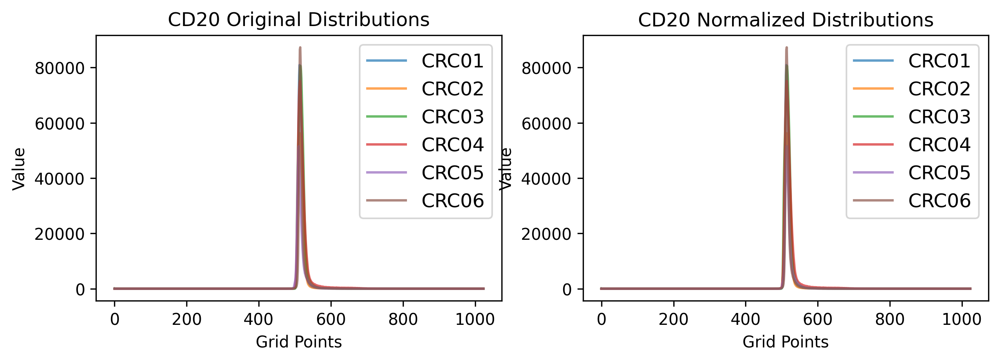

##### Metrics for original marker image #####
CD20 Pearson Correlation Coefficients: ['1', '0.99459', '0.98343', '0.99076', '0.92202', '0.94275']
CD20 Spearman Correlation Coefficients: ['1', '0.87913', '0.76666', '0.91317', '0.83462', '0.85877']
CD20 KL Divergences: ['0', '0.012013', '0.032692', '0.05339', '0.14247', '0.12086'] 

##### Metrics for shifted marker image #####
CD20 shifted Pearson Correlation Coefficients: ['1', '0.99459', '0.98581', '0.99076', '0.99466', '0.9547']
CD20 shifted Spearman Correlation Coefficients: ['1', '0.87913', '0.77028', '0.91317', '0.82453', '0.8553']
CD20 shifted KL Divergences: ['0', '0.012013', '0.03617', '0.05339', '0.032356', '0.08465'] 

CD20 shifts_direct is: [0, 0, 1, 0, -3, 1]
CD20 shifts_fft is:    [0, 0, 1, 0, -3, 1]

****************************** Processing marker PD-L1 ******************************
Reference sample for PD-L1 is CRC01


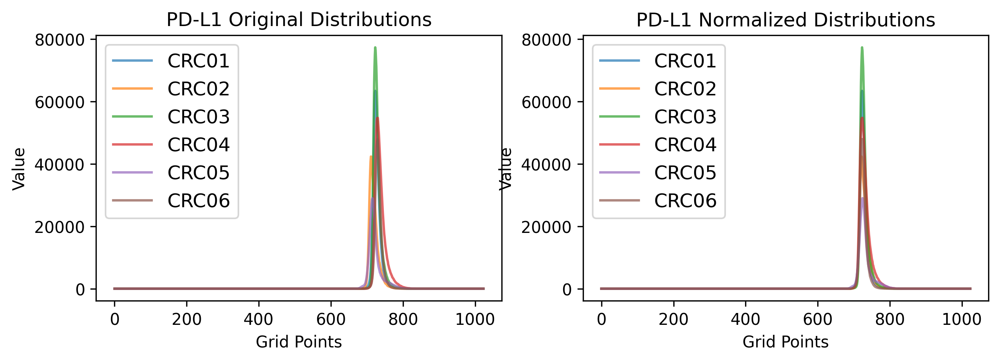

##### Metrics for original marker image #####
PD-L1 Pearson Correlation Coefficients: ['1', '0.6781', '0.99735', '0.83733', '0.73519', '0.85654']
PD-L1 Spearman Correlation Coefficients: ['1', '0.82565', '0.69066', '0.8839', '0.73543', '0.7888']
PD-L1 KL Divergences: ['0', '0.4455', '0.02508', '0.37345', '0.44265', '0.25163'] 

##### Metrics for shifted marker image #####
PD-L1 shifted Pearson Correlation Coefficients: ['1', '0.98874', '0.99735', '0.98145', '0.98693', '0.99822']
PD-L1 shifted Spearman Correlation Coefficients: ['1', '0.85018', '0.69066', '0.87313', '0.76685', '0.76282']
PD-L1 shifted KL Divergences: ['0', '0.025964', '0.02508', '0.064703', '0.084567', '0.010897'] 

PD-L1 shifts_direct is: [0, -10, 0, 6, -9, 6]
PD-L1 shifts_fft is:    [0, -10, 0, 6, -9, 6]

****************************** Processing marker CD3e ******************************
Reference sample for CD3e is CRC02


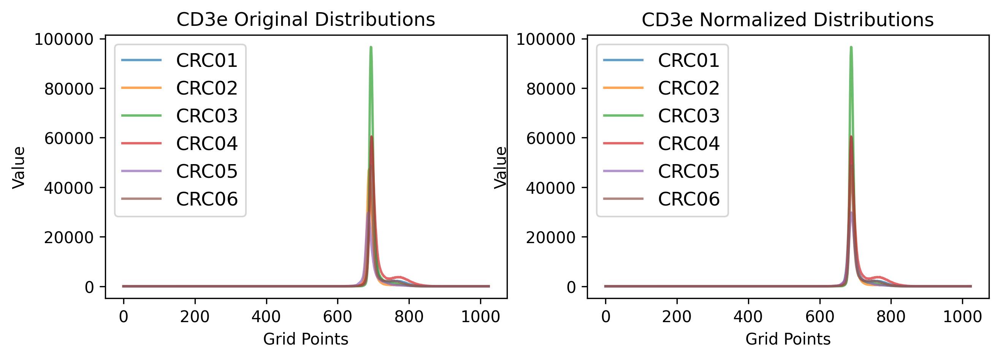

##### Metrics for original marker image #####
CD3e Pearson Correlation Coefficients: ['1', '0.83936', '0.97409', '0.98233', '0.73735', '0.96292']
CD3e Spearman Correlation Coefficients: ['1', '0.91709', '0.8899', '0.90437', '0.91031', '0.92623']
CD3e KL Divergences: ['0', '0.21927', '0.11518', '0.069875', '0.35765', '0.044909'] 

##### Metrics for shifted marker image #####
CD3e shifted Pearson Correlation Coefficients: ['1', '0.99478', '0.98148', '0.98948', '0.98526', '0.98941']
CD3e shifted Spearman Correlation Coefficients: ['1', '0.92472', '0.89672', '0.90129', '0.91679', '0.9355']
CD3e shifted KL Divergences: ['0', '0.042678', '0.12736', '0.050596', '0.062399', '0.03696'] 

CD3e shifts_direct is: [6, 0, 5, 7, -3, 4]
CD3e shifts_fft is:    [6, 0, 5, 7, -3, 4]

****************************** Processing marker CD163 ******************************
Reference sample for CD163 is CRC05


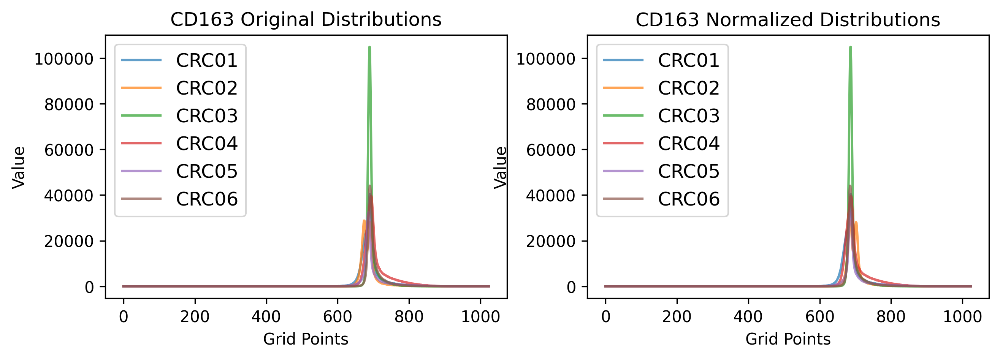

##### Metrics for original marker image #####
CD163 Pearson Correlation Coefficients: ['1', '0.95215', '0.86399', '0.92983', '0.91285', '0.88028']
CD163 Spearman Correlation Coefficients: ['1', '0.94438', '0.85682', '0.88728', '0.93248', '0.83922']
CD163 KL Divergences: ['0', '0.063793', '0.76261', '0.21097', '0.11327', '0.54621'] 

##### Metrics for shifted marker image #####
CD163 shifted Pearson Correlation Coefficients: ['1', '0.81879', '0.86399', '0.97478', '0.9325', '0.90191']
CD163 shifted Spearman Correlation Coefficients: ['1', '0.92854', '0.85682', '0.89434', '0.92449', '0.8412']
CD163 shifted KL Divergences: ['0', '0.32551', '0.76261', '0.12111', '0.14396', '0.43202'] 

CD163 shifts_direct is: [3, -11, 3, 6, 0, 5]
CD163 shifts_fft is:    [3, -11, 3, 6, 0, 5]

****************************** Processing marker E-cadherin ******************************
Reference sample for E-cadherin is CRC01


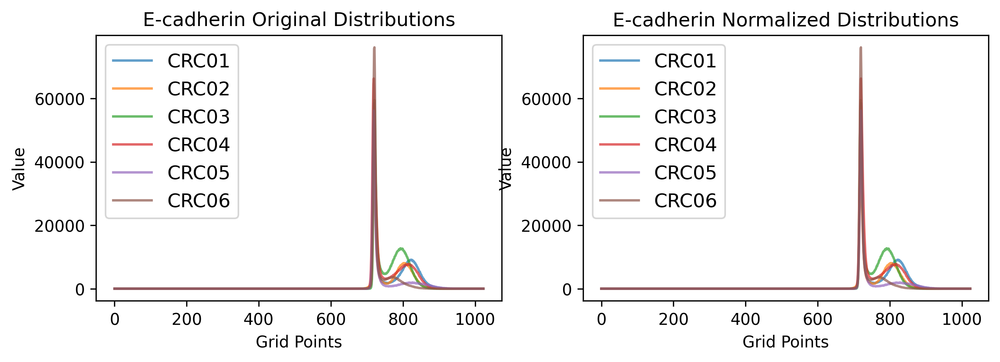

##### Metrics for original marker image #####
E-cadherin Pearson Correlation Coefficients: ['1', '0.97166', '0.90173', '0.97906', '0.95465', '0.92193']
E-cadherin Spearman Correlation Coefficients: ['1', '0.86549', '0.87595', '0.92793', '0.91031', '0.82132']
E-cadherin KL Divergences: ['0', '0.09122', '0.30211', '0.055486', '0.19106', '0.61268'] 

##### Metrics for shifted marker image #####
E-cadherin shifted Pearson Correlation Coefficients: ['1', '0.97166', '0.93646', '0.97984', '0.95641', '0.93898']
E-cadherin shifted Spearman Correlation Coefficients: ['1', '0.86549', '0.86449', '0.92357', '0.89775', '0.82086']
E-cadherin shifted KL Divergences: ['0', '0.09122', '0.26963', '0.052462', '0.19143', '0.61119'] 

E-cadherin shifts_direct is: [0, 0, 2, -1, -1, 1]
E-cadherin shifts_fft is:    [0, 0, 2, -1, -1, 1]

****************************** Processing marker PD-1 ******************************
Reference sample for PD-1 is CRC01


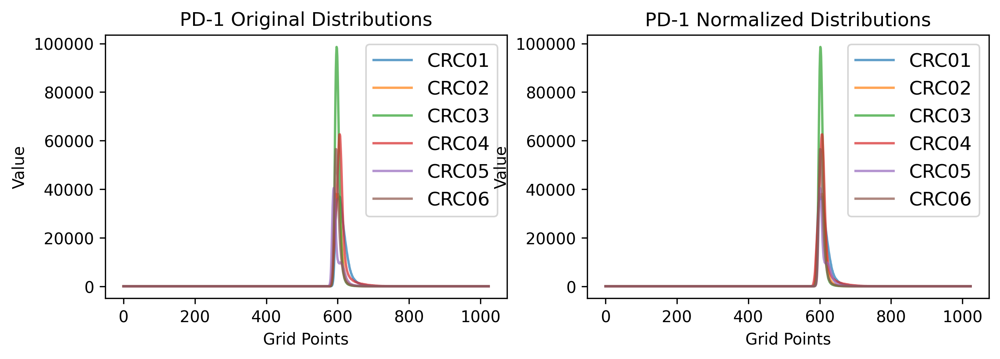

##### Metrics for original marker image #####
PD-1 Pearson Correlation Coefficients: ['1', '0.86873', '0.79282', '0.95782', '0.54315', '0.78156']
PD-1 Spearman Correlation Coefficients: ['1', '0.8101', '0.82225', '0.88478', '0.84691', '0.83589']
PD-1 KL Divergences: ['0', '0.39236', '0.74932', '0.094393', '0.60599', '0.55749'] 

##### Metrics for shifted marker image #####
PD-1 shifted Pearson Correlation Coefficients: ['1', '0.97411', '0.87353', '0.95933', '0.91927', '0.89659']
PD-1 shifted Spearman Correlation Coefficients: ['1', '0.80746', '0.81748', '0.88576', '0.84828', '0.84516']
PD-1 shifted KL Divergences: ['0', '0.13411', '0.47615', '0.078288', '0.11709', '0.30118'] 

PD-1 shifts_direct is: [0, -6, -5, -1, -12, -6]
PD-1 shifts_fft is:    [0, -6, -5, -1, -12, -6]

****************************** Processing marker Ki67 ******************************
Reference sample for Ki67 is CRC02


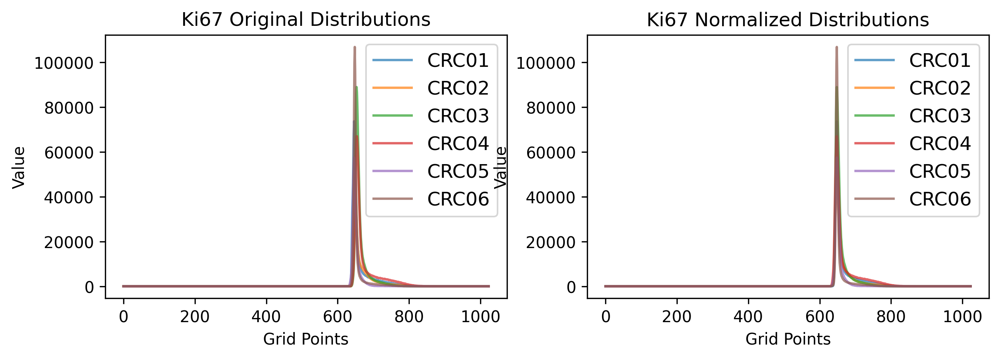

##### Metrics for original marker image #####
Ki67 Pearson Correlation Coefficients: ['1', '0.96253', '0.59508', '0.63119', '0.98994', '0.89982']
Ki67 Spearman Correlation Coefficients: ['1', '0.93228', '0.88467', '0.92111', '0.93007', '0.91824']
Ki67 KL Divergences: ['0', '0.060409', '0.83939', '0.62234', '0.25817', '0.26774'] 

##### Metrics for shifted marker image #####
Ki67 shifted Pearson Correlation Coefficients: ['1', '0.99392', '0.99463', '0.98884', '0.98994', '0.93215']
Ki67 shifted Spearman Correlation Coefficients: ['1', '0.93017', '0.88294', '0.93113', '0.93007', '0.9094']
Ki67 shifted KL Divergences: ['0', '0.022146', '0.083619', '0.032771', '0.25817', '0.20202'] 

Ki67 shifts_direct is: [-2, 0, 5, 6, -2, 0]
Ki67 shifts_fft is:    [-2, 0, 5, 6, -2, 0]

****************************** Processing marker Pan-CK ******************************
Reference sample for Pan-CK is CRC01


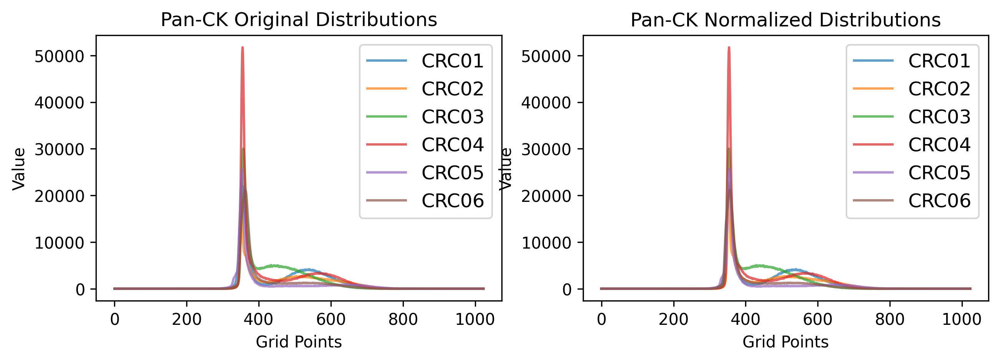

##### Metrics for original marker image #####
Pan-CK Pearson Correlation Coefficients: ['1', '0.91952', '0.89509', '0.90591', '0.90309', '0.87623']
Pan-CK Spearman Correlation Coefficients: ['1', '0.97008', '0.93614', '0.95565', '0.92487', '0.95177']
Pan-CK KL Divergences: ['0', '0.073608', '0.26213', '0.1402', '0.30844', '0.2153'] 

##### Metrics for shifted marker image #####
Pan-CK shifted Pearson Correlation Coefficients: ['1', '0.93234', '0.93444', '0.90892', '0.92066', '0.95306']
Pan-CK shifted Spearman Correlation Coefficients: ['1', '0.96795', '0.93332', '0.95636', '0.92436', '0.95261']
Pan-CK shifted KL Divergences: ['0', '0.086715', '0.21324', '0.12251', '0.29714', '0.16241'] 

Pan-CK shifts_direct is: [0, -2, 4, 1, -2, 6]
Pan-CK shifts_fft is:    [0, -2, 4, 1, -2, 6]

****************************** Processing marker SMA ******************************
Reference sample for SMA is CRC01


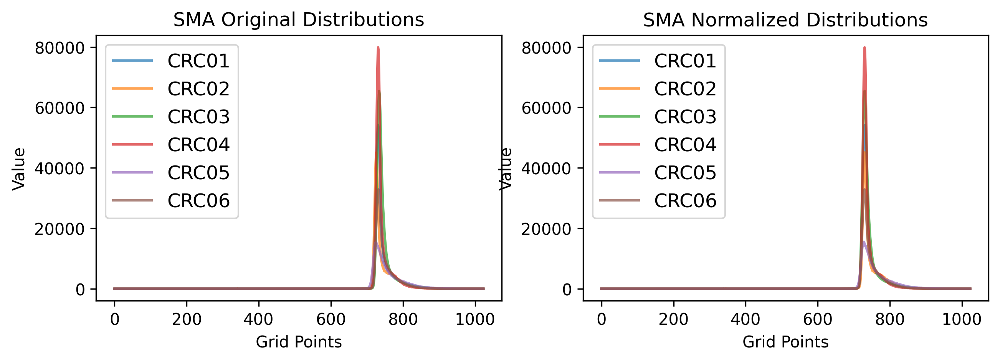

##### Metrics for original marker image #####
SMA Pearson Correlation Coefficients: ['1', '0.89009', '0.92301', '0.98856', '0.87896', '0.97521']
SMA Spearman Correlation Coefficients: ['1', '0.81572', '0.88633', '0.9159', '0.86784', '0.83232']
SMA KL Divergences: ['0', '0.12041', '0.13489', '0.030705', '0.2174', '0.054562'] 

##### Metrics for shifted marker image #####
SMA shifted Pearson Correlation Coefficients: ['1', '0.98858', '0.99658', '0.98972', '0.90357', '0.9852']
SMA shifted Spearman Correlation Coefficients: ['1', '0.81735', '0.89331', '0.91161', '0.85902', '0.82139']
SMA shifted KL Divergences: ['0', '0.030087', '0.013193', '0.02719', '0.18761', '0.030454'] 

SMA shifts_direct is: [0, -4, 4, 1, -3, 2]
SMA shifts_fft is:    [0, -4, 4, 1, -3, 2]



In [13]:
shifts_fft_dict = normalize_and_plot_distributions(
    results_hist=results_hist, 
    keys=marker_list, 
    sample_names=sample_names, 
    reference_sample=reference_sample, 
    bin_counts=1024,
    dpi=300, 
    xlim=None)

In [14]:
shifts_fft_dict

{'Hoechst': [0, -18, -8, -13, -39, -6],
 'AF1': [0, -26, -9, -26, -34, -7],
 'CD31': [0, 0, 1, 2, -1, 2],
 'CD45': [4, 0, 2, 10, -3, 7],
 'CD68': [2, 0, -5, 4, -10, 0],
 'Argo550': [0, 0, -2, -1, -2, -2],
 'CD4': [1, 0, -1, 1, -1, 0],
 'FOXP3': [0, 0, -1, -1, -1, -1],
 'CD8a': [4, 0, 3, 4, -2, -1],
 'CD45RO': [0, -10, -2, 11, -16, 3],
 'CD20': [0, 0, 1, 0, -3, 1],
 'PD-L1': [0, -10, 0, 6, -9, 6],
 'CD3e': [6, 0, 5, 7, -3, 4],
 'CD163': [3, -11, 3, 6, 0, 5],
 'E-cadherin': [0, 0, 2, -1, -1, 1],
 'PD-1': [0, -6, -5, -1, -12, -6],
 'Ki67': [-2, 0, 5, 6, -2, 0],
 'Pan-CK': [0, -2, 4, 1, -2, 6],
 'SMA': [0, -4, 4, 1, -3, 2]}

## 2. compute amount of shift in log pixel scale 

In [15]:
shift_in_log_pixels_dict = calculate_shift_in_log_pixels(
    results_range=results_range,
    keys=marker_list,
    bin_counts=1024,
    shifts_fft_dict=shifts_fft_dict
)

********** Processing marker Hoechst **********
shift_in_log_pixels for Hoechst is [0.0, -0.29407964111361745, -0.1307020627171633, -0.21239085191539037, -0.6371725557461712, -0.09802654703787247]

********** Processing marker AF1 **********
shift_in_log_pixels for AF1 is [0.0, -0.14038014708037977, -0.04859312783551607, -0.14038014708037977, -0.1835740384897274, -0.037794654983179174]

********** Processing marker CD31 **********
shift_in_log_pixels for CD31 is [0.0, 0.0, 0.01587380508817108, 0.03174761017634216, -0.01587380508817108, 0.03174761017634216]

********** Processing marker CD45 **********
shift_in_log_pixels for CD45 is [0.049564837760208307, 0.0, 0.024782418880104153, 0.12391209440052077, -0.03717362832015623, 0.08673846608036453]

********** Processing marker CD68 **********
shift_in_log_pixels for CD68 is [0.022216017355205637, 0.0, -0.05554004338801409, 0.044432034710411274, -0.11108008677602818, 0.0]

********** Processing marker Argo550 **********
shift_in_log_pixels

## 3. Now perform feature transformation

##############################Performing feature normalization##############################

******************************  Processing CRC01 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.0


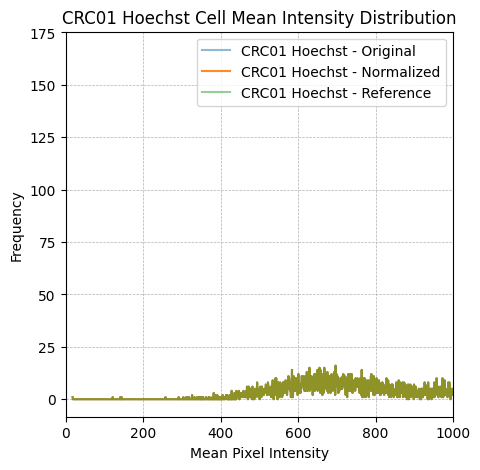

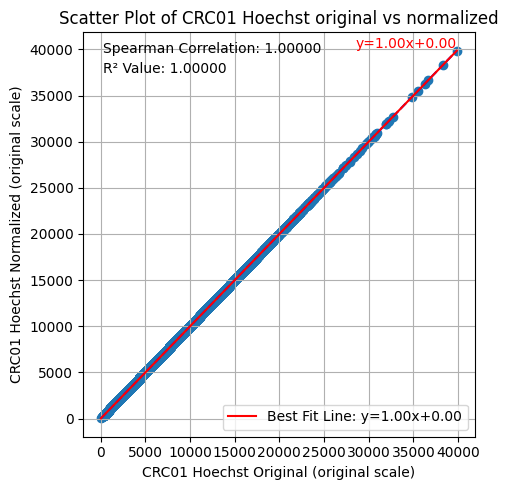

Currently processing Hoechst Original......
Positive class is empty. Adjust model parameters or input data.


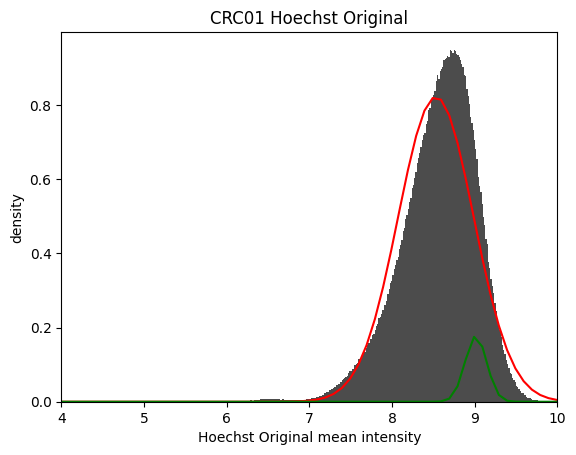

Positive population threshold is: 1.0
Proportion of positive population >= 1.0: 100.0%
Number of positive population >= 1.0: 1206148
Currently processing Hoechst Normalized......
Positive class is empty. Adjust model parameters or input data.


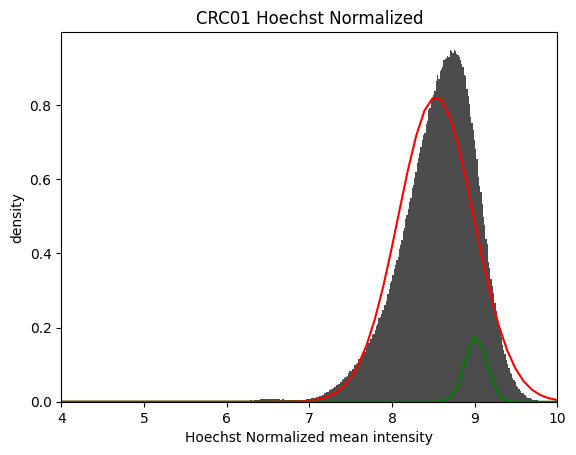

Positive population threshold is: 1.0
Proportion of elements >= 1.0: 100.0%
Number of elements >= 1.0: 1206148
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.0


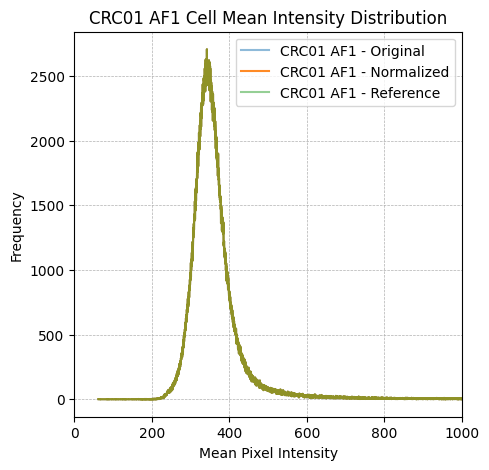

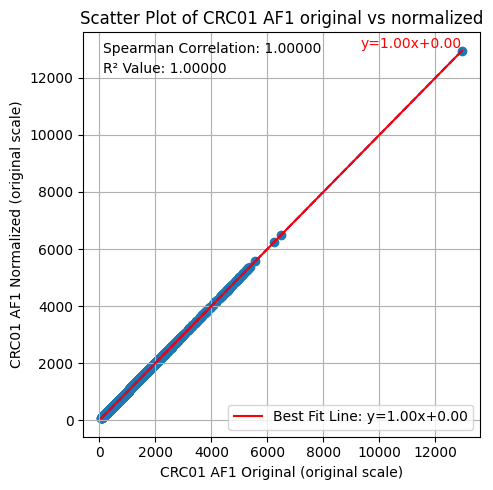

Currently processing AF1 Original......


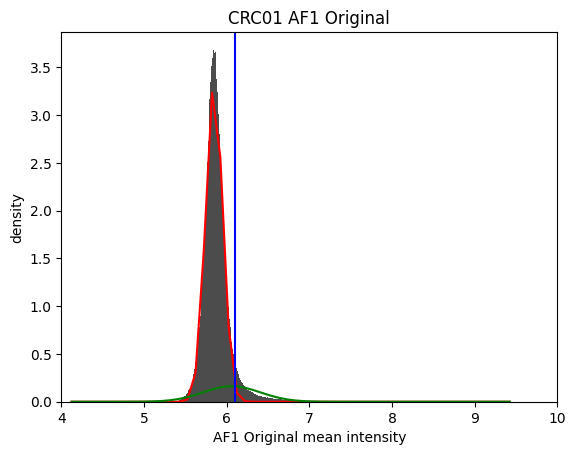

Positive population threshold is: [446.80487805]
Proportion of positive population >= [446.80487805]: 6.622487455934098%
Number of positive population >= [446.80487805]: 79877
Currently processing AF1 Normalized......


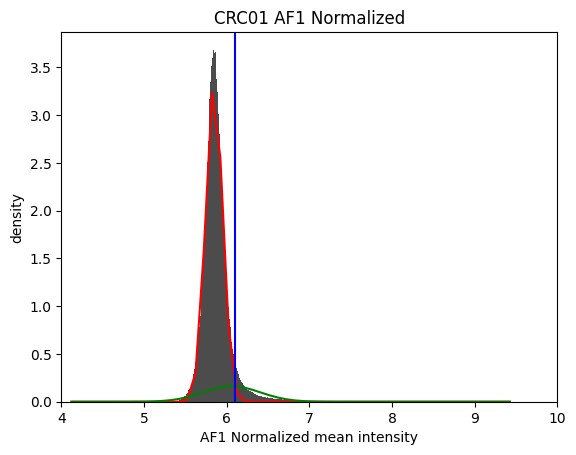

Positive population threshold is: [446.80487805]
Proportion of elements >= [446.80487805]: 6.622487455934098%
Number of elements >= [446.80487805]: 79877
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 1.0


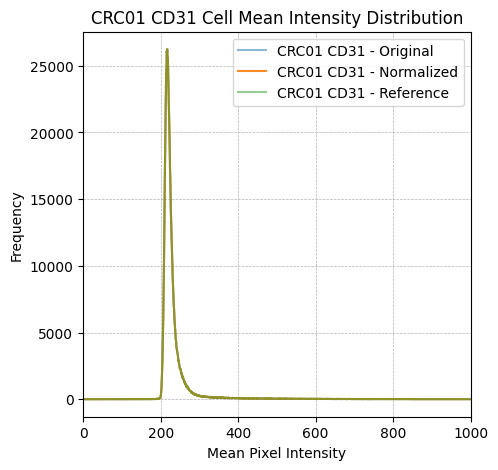

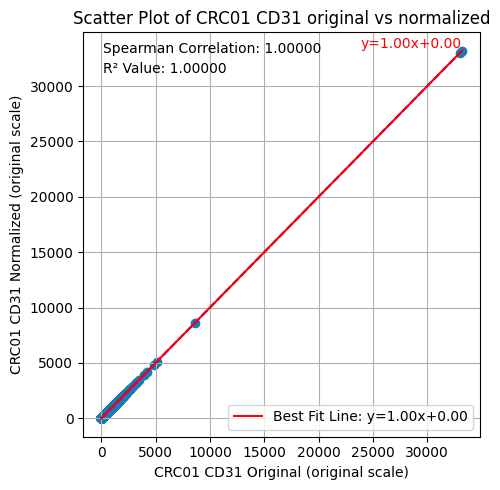

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


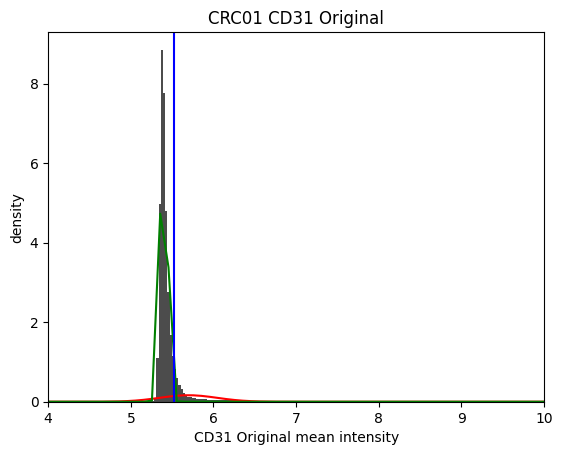

Positive population threshold is: [249.77777778]
Proportion of positive population >= [249.77777778]: 11.523958917147812%
Number of positive population >= [249.77777778]: 138996
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


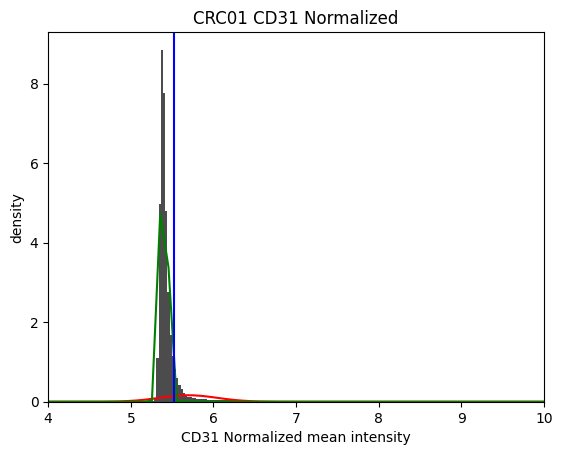

Positive population threshold is: [249.77777778]
Proportion of elements >= [249.77777778]: 11.523958917147812%
Number of elements >= [249.77777778]: 138996
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 0.9516434537060401


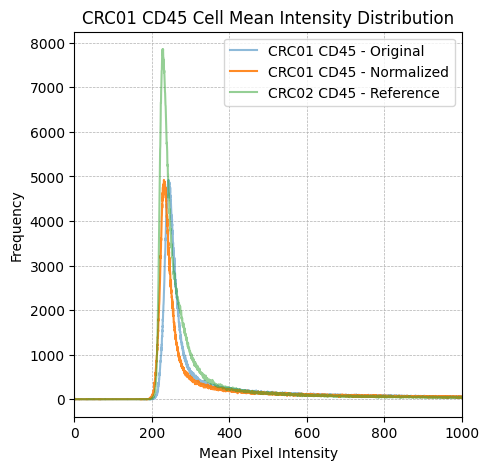

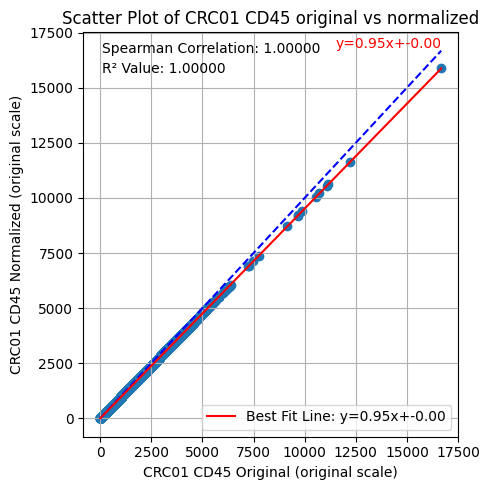

Currently processing CD45 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


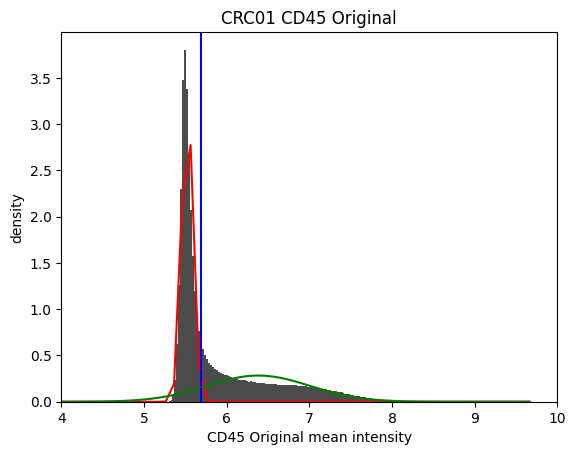

Positive population threshold is: [296.28658537]
Proportion of positive population >= [296.28658537]: 40.88975813913384%
Number of positive population >= [296.28658537]: 493191
Currently processing CD45 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


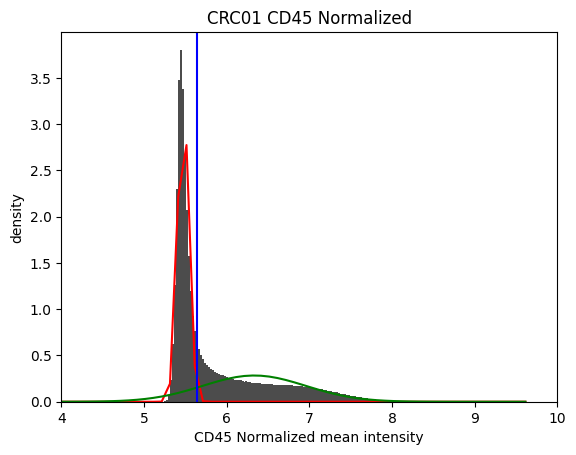

Positive population threshold is: [281.95540501]
Proportion of elements >= [281.95540501]: 40.89083595048037%
Number of elements >= [281.95540501]: 493204
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 0.9780289410052907


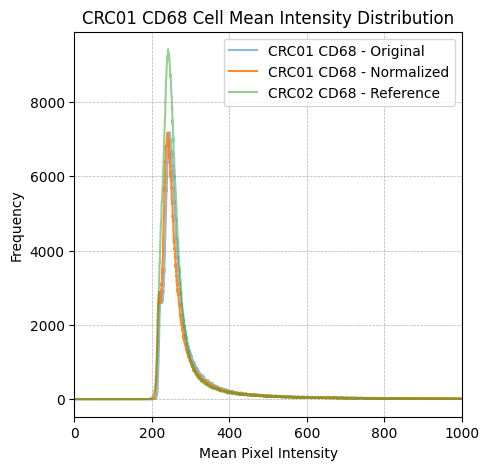

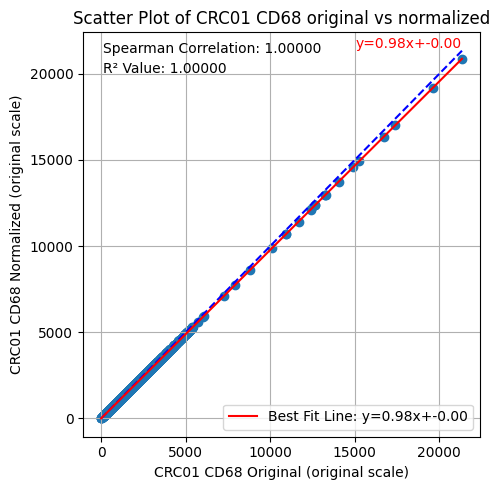

Currently processing CD68 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


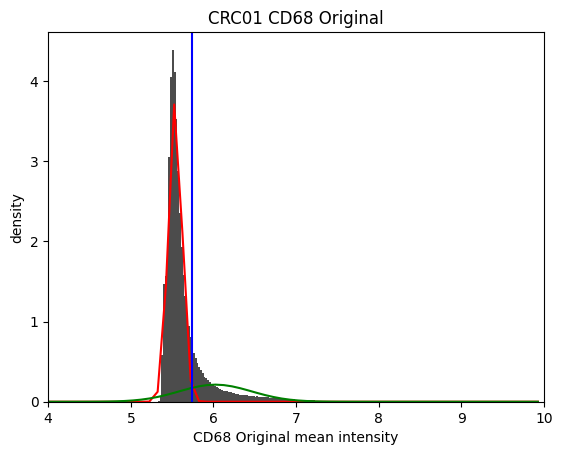

Positive population threshold is: [310.74691358]
Proportion of positive population >= [310.74691358]: 19.127586332688857%
Number of positive population >= [310.74691358]: 230707
Currently processing CD68 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


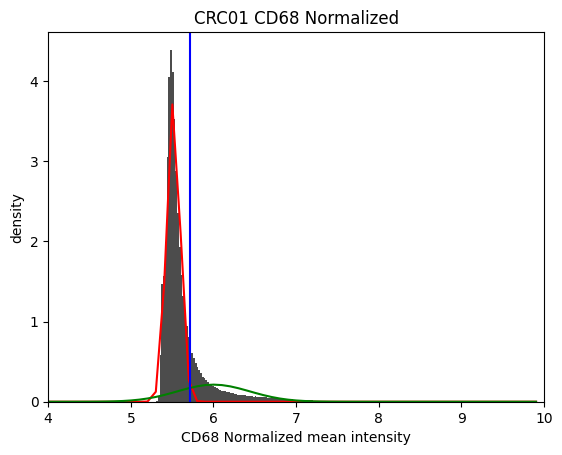

Positive population threshold is: [303.91884406]
Proportion of elements >= [303.91884406]: 19.12800087551445%
Number of elements >= [303.91884406]: 230712
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.0


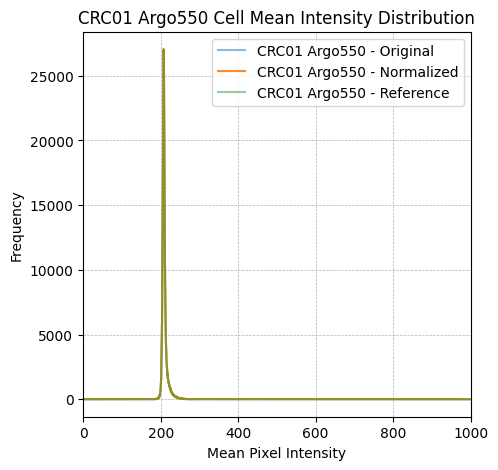

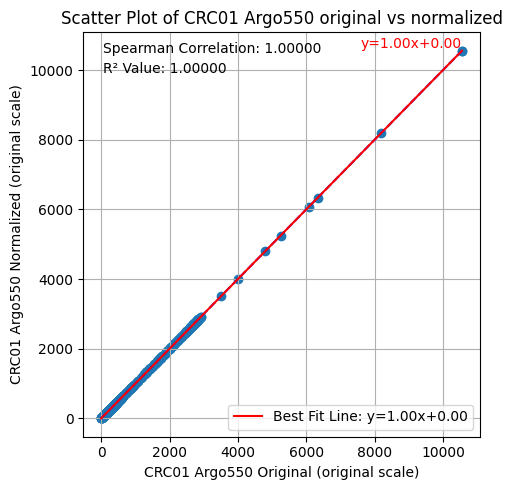

Currently processing Argo550 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


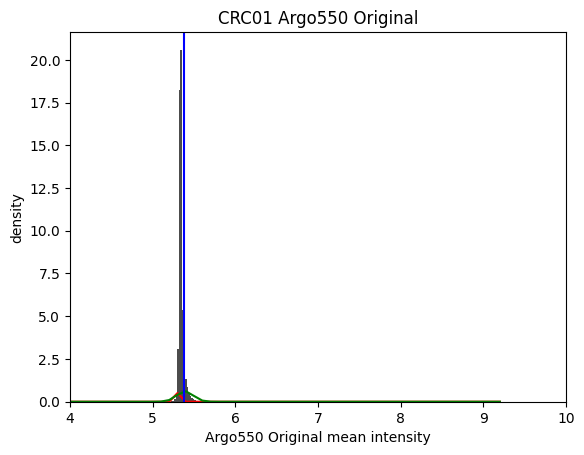

Positive population threshold is: [216.17985612]
Proportion of positive population >= [216.17985612]: 10.418870652689389%
Number of positive population >= [216.17985612]: 125667
Currently processing Argo550 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


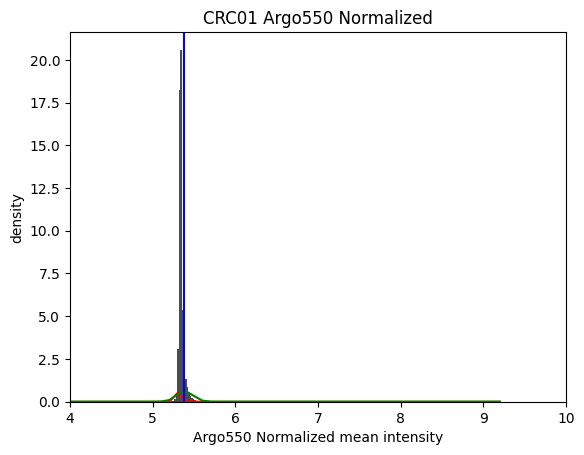

Positive population threshold is: [216.17985612]
Proportion of elements >= [216.17985612]: 10.418870652689389%
Number of elements >= [216.17985612]: 125667
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 0.9865707092651675


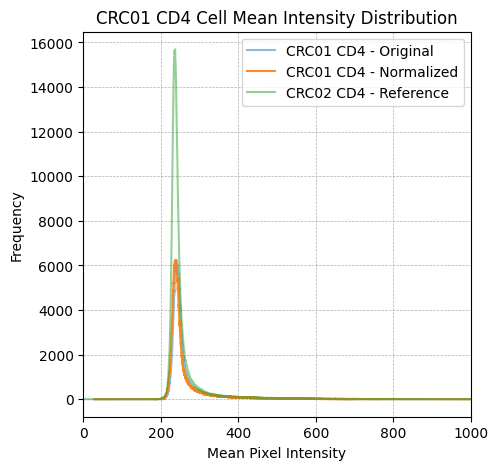

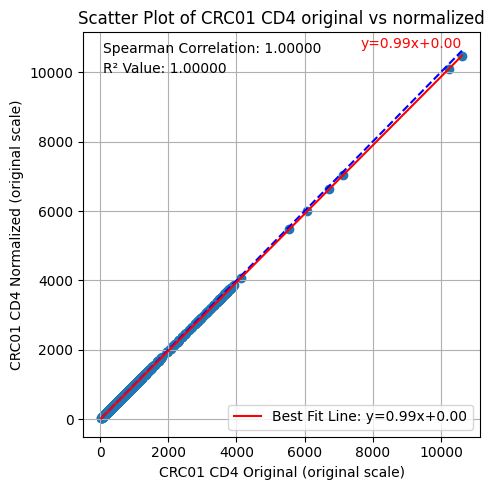

Currently processing CD4 Original......


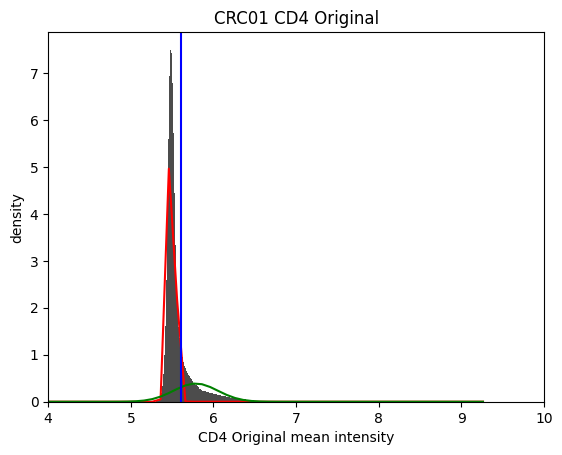

Positive population threshold is: [270.97435897]
Proportion of positive population >= [270.97435897]: 21.427387020498315%
Number of positive population >= [270.97435897]: 258446
Currently processing CD4 Normalized......


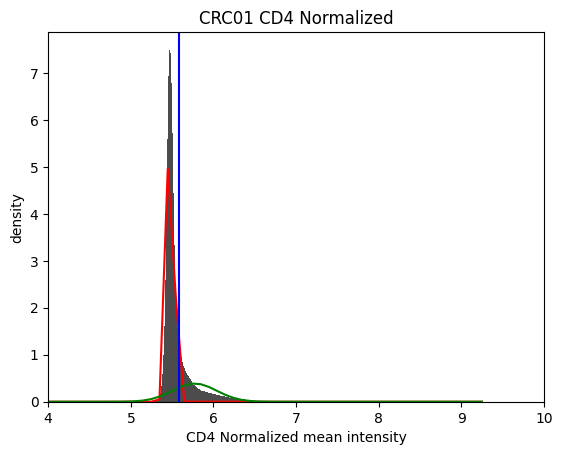

Positive population threshold is: [267.33536553]
Proportion of elements >= [267.33536553]: 21.427387020498315%
Number of elements >= [267.33536553]: 258446
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0


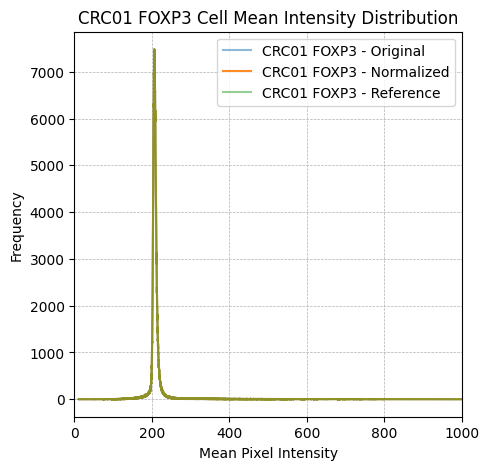

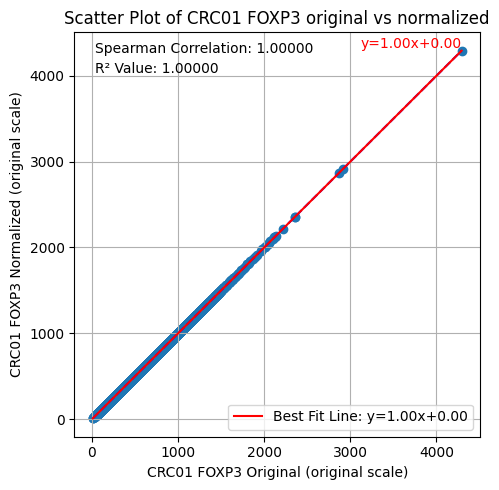

Currently processing FOXP3 Original......


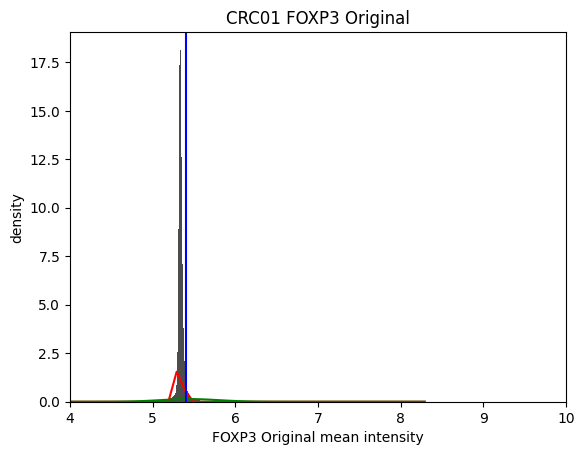

Positive population threshold is: [221.63333333]
Proportion of positive population >= [221.63333333]: 6.543724319071955%
Number of positive population >= [221.63333333]: 78927
Currently processing FOXP3 Normalized......


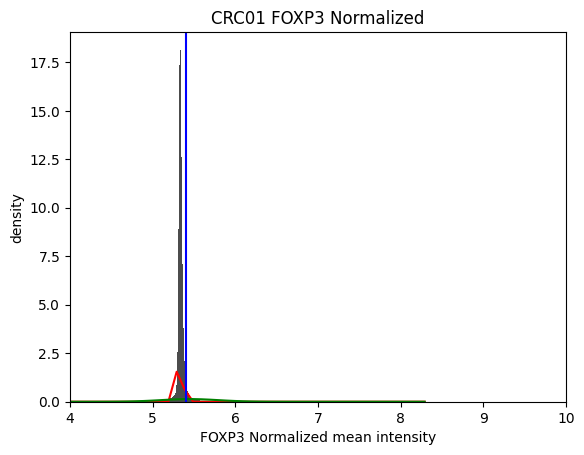

Positive population threshold is: [221.63333333]
Proportion of elements >= [221.63333333]: 6.543724319071955%
Number of elements >= [221.63333333]: 78927
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 0.9606454752187334


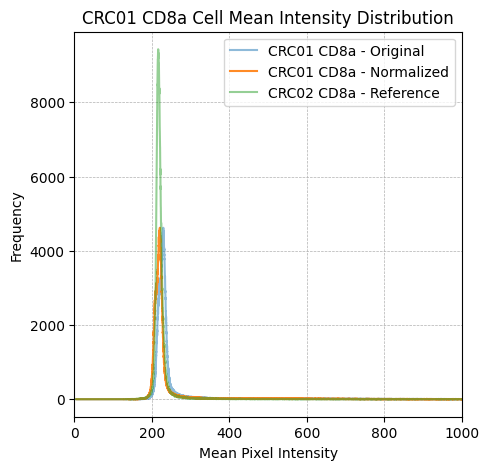

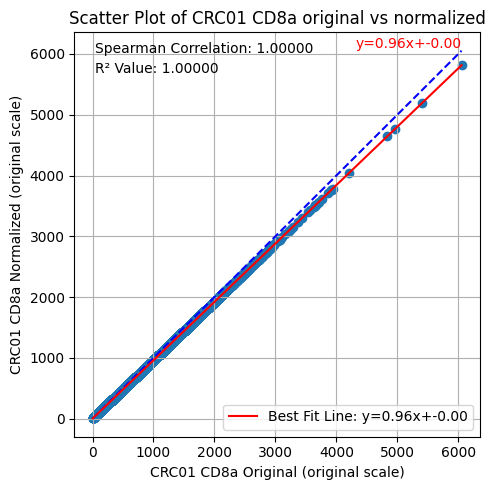

Currently processing CD8a Original......


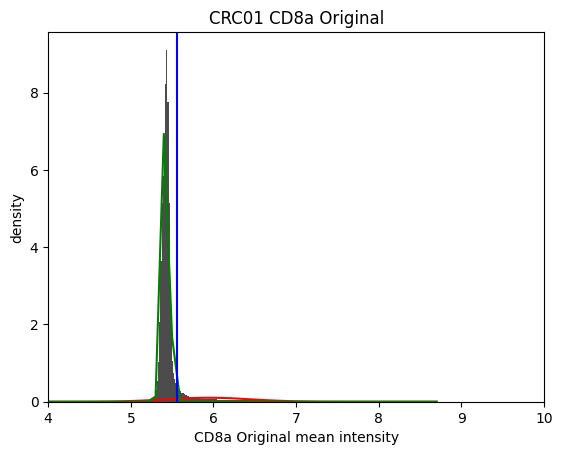

Positive population threshold is: [258.37096774]
Proportion of positive population >= [258.37096774]: 10.96125848569164%
Number of positive population >= [258.37096774]: 132209
Currently processing CD8a Normalized......


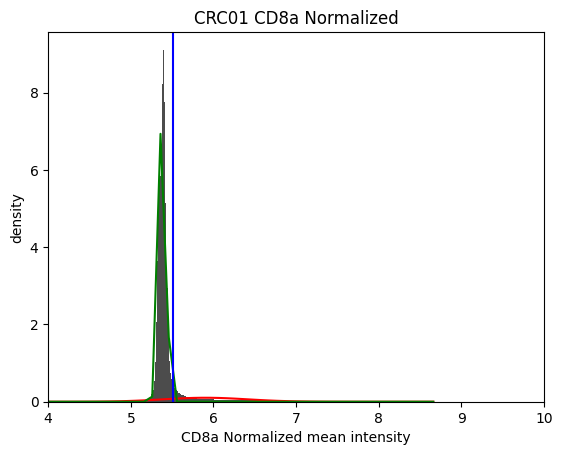

Positive population threshold is: [248.20290109]
Proportion of elements >= [248.20290109]: 10.96125848569164%
Number of elements >= [248.20290109]: 132209
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 1.0


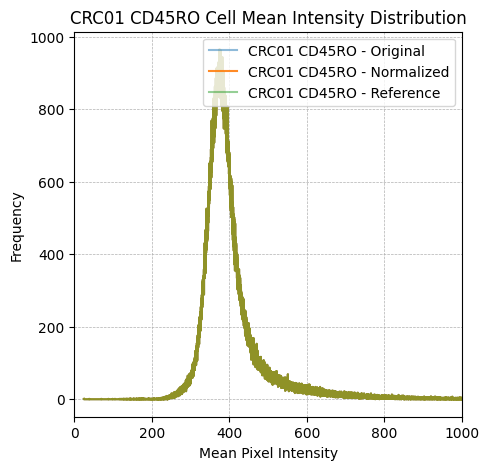

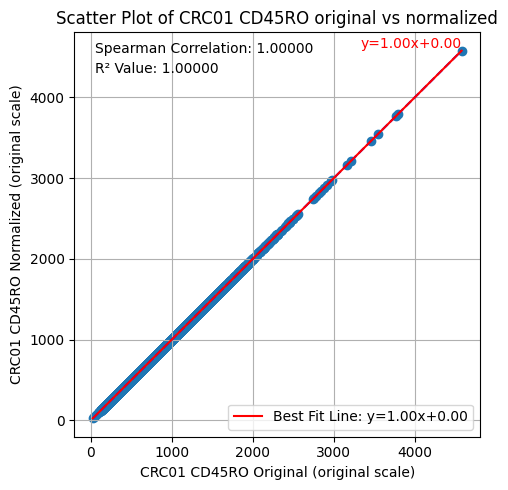

Currently processing CD45RO Original......


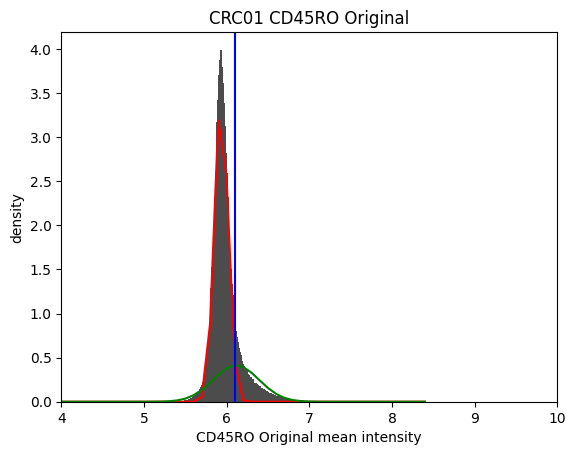

Positive population threshold is: [446.87301587]
Proportion of positive population >= [446.87301587]: 15.97739249246361%
Number of positive population >= [446.87301587]: 192711
Currently processing CD45RO Normalized......


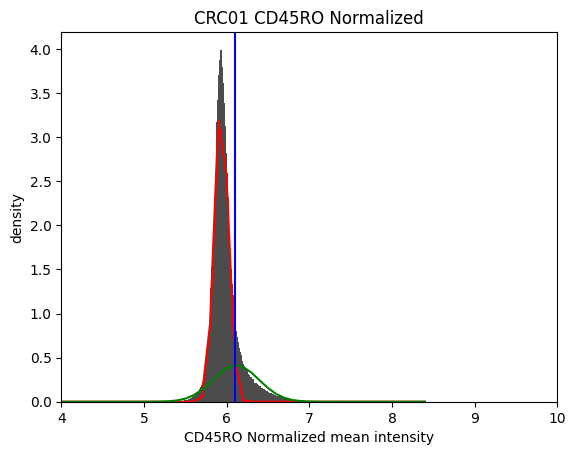

Positive population threshold is: [446.87301587]
Proportion of elements >= [446.87301587]: 15.97739249246361%
Number of elements >= [446.87301587]: 192711
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 1.0


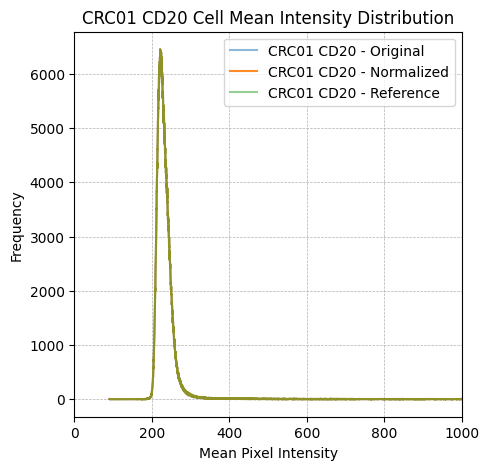

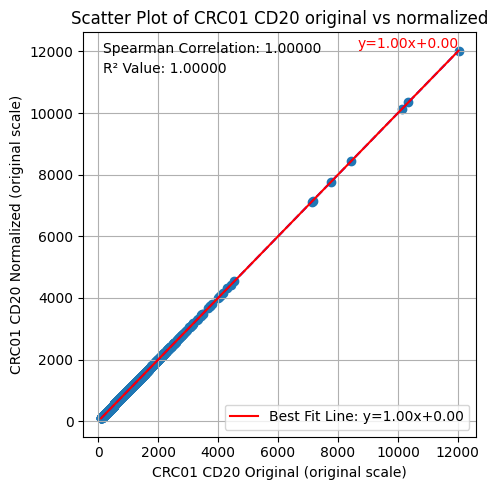

Currently processing CD20 Original......


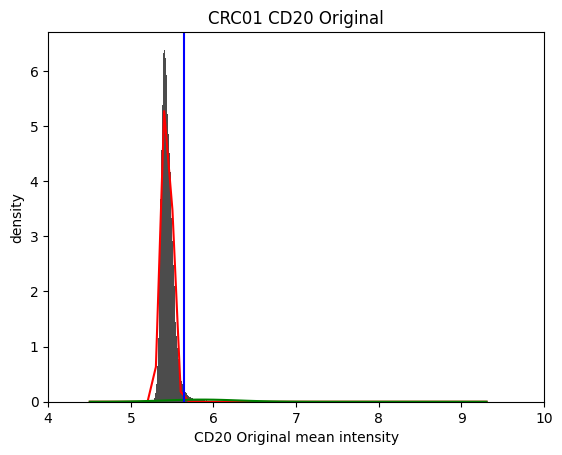

Positive population threshold is: [281.20873786]
Proportion of positive population >= [281.20873786]: 3.1471262233158783%
Number of positive population >= [281.20873786]: 37959
Currently processing CD20 Normalized......


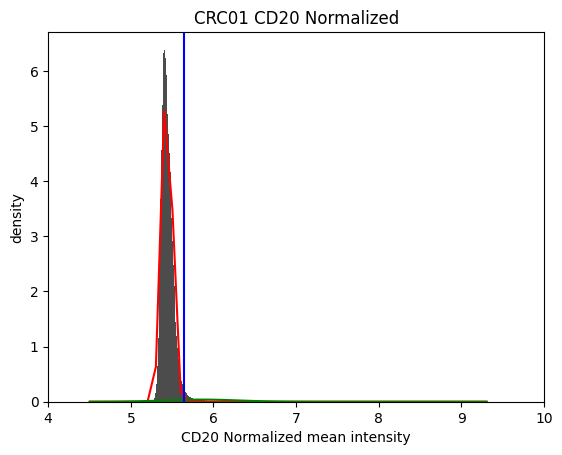

Positive population threshold is: [281.20873786]
Proportion of elements >= [281.20873786]: 3.1471262233158783%
Number of elements >= [281.20873786]: 37959
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 1.0


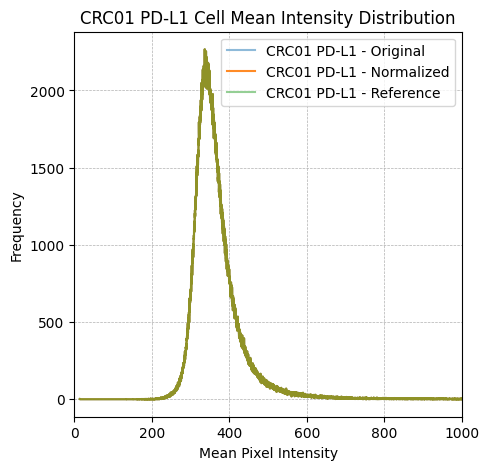

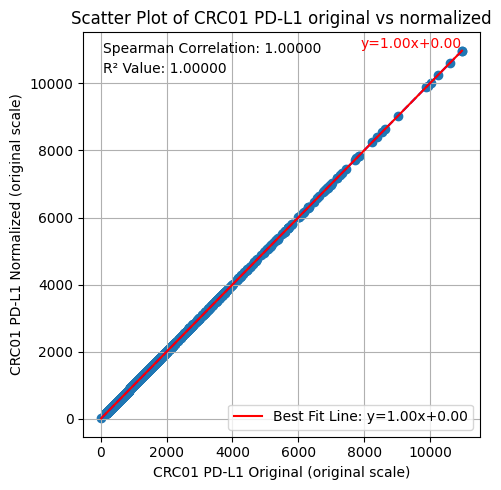

Currently processing PD-L1 Original......


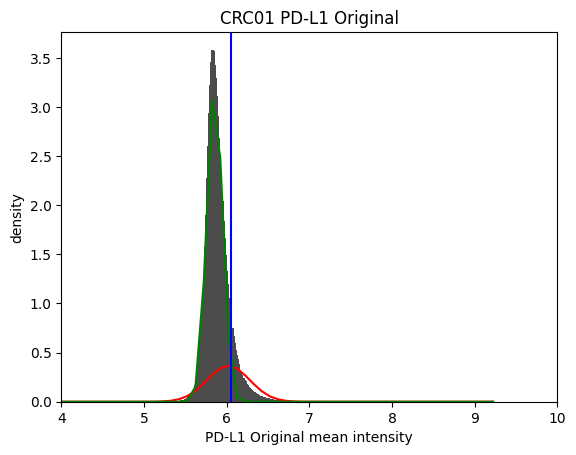

Positive population threshold is: [424.47164179]
Proportion of positive population >= [424.47164179]: 11.998942086709095%
Number of positive population >= [424.47164179]: 144725
Currently processing PD-L1 Normalized......


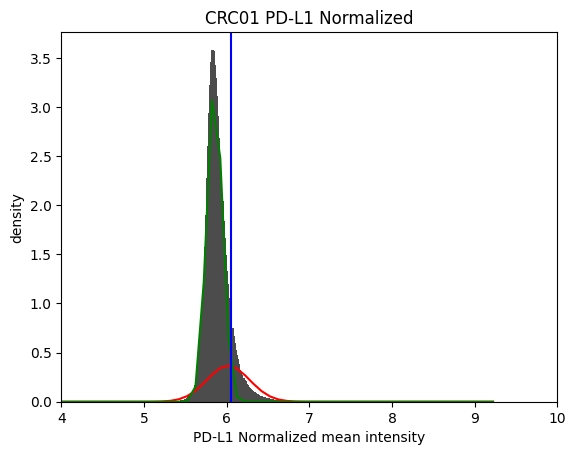

Positive population threshold is: [424.47164179]
Proportion of elements >= [424.47164179]: 11.998942086709095%
Number of elements >= [424.47164179]: 144725
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 0.9256236002020217


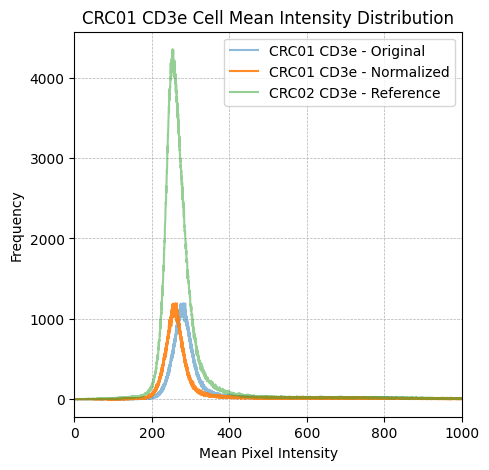

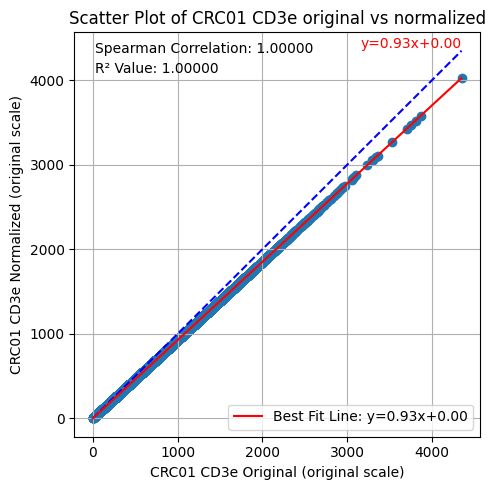

Currently processing CD3e Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


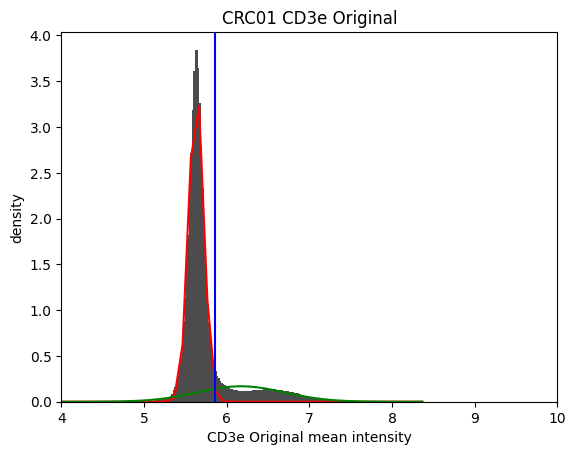

Positive population threshold is: [350.21631206]
Proportion of positive population >= [350.21631206]: 16.398982546088874%
Number of positive population >= [350.21631206]: 197796
Currently processing CD3e Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


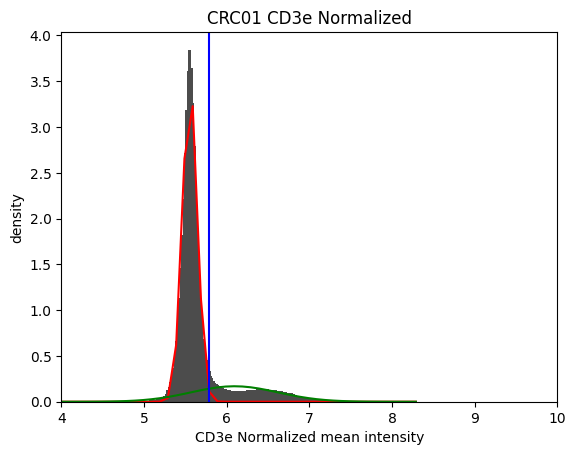

Positive population threshold is: [324.16811062]
Proportion of elements >= [324.16811062]: 16.398982546088874%
Number of elements >= [324.16811062]: 197796
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 0.964941578761398


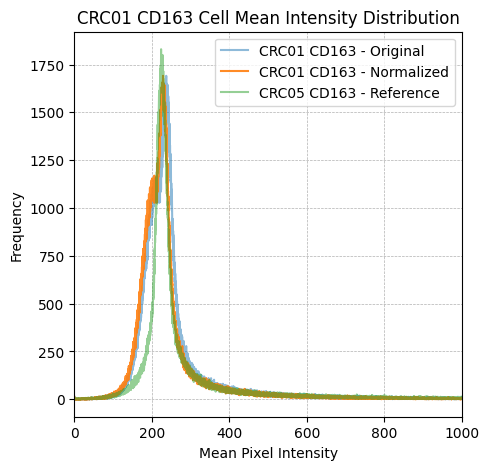

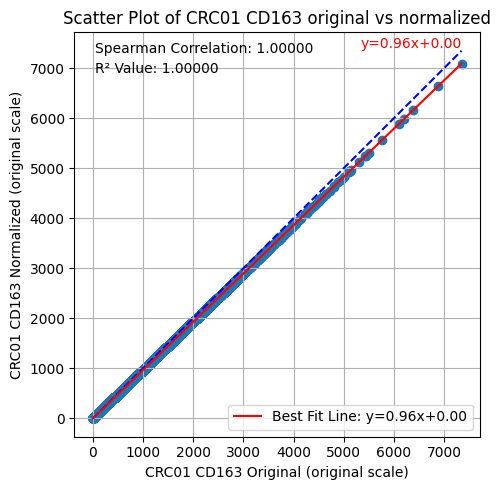

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


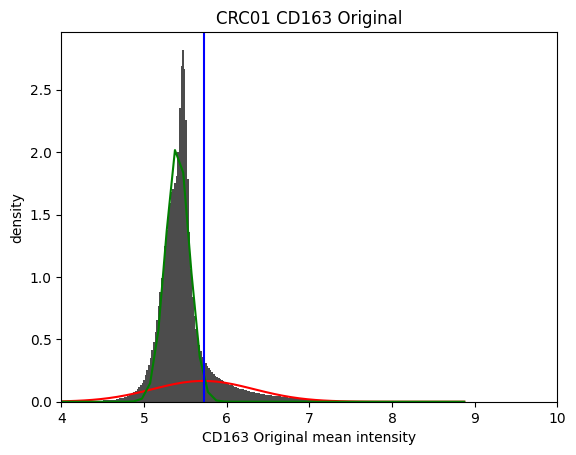

Positive population threshold is: [307.52351097]
Proportion of positive population >= [307.52351097]: 13.23038300440742%
Number of positive population >= [307.52351097]: 159578
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


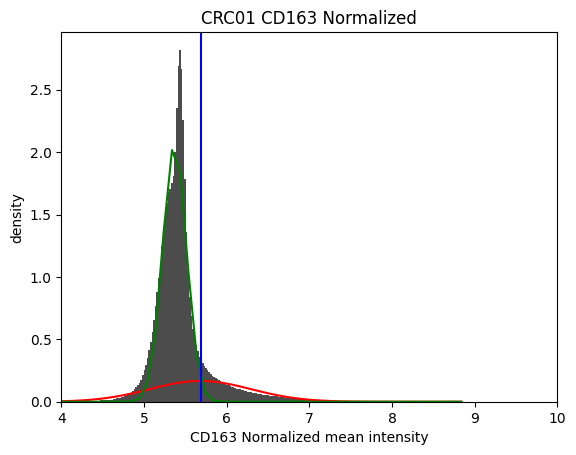

Positive population threshold is: [296.73980735]
Proportion of elements >= [296.73980735]: 13.230963364363246%
Number of elements >= [296.73980735]: 159585
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 1.0


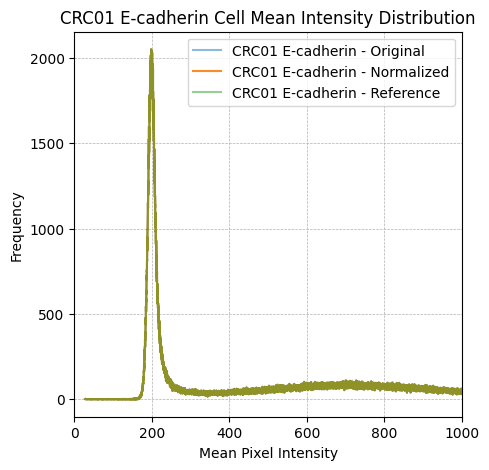

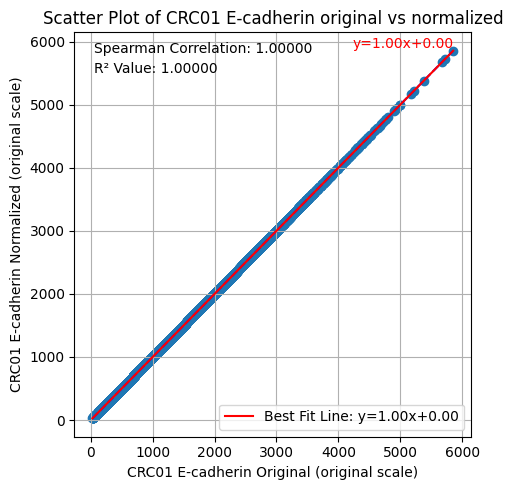

Currently processing E-cadherin Original......


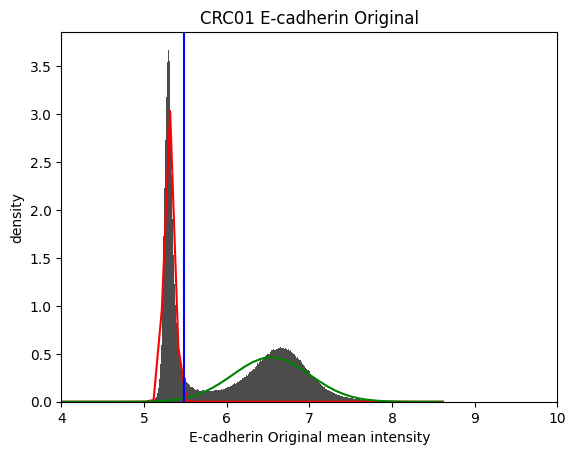

Positive population threshold is: [240.95031056]
Proportion of positive population >= [240.95031056]: 53.81968050355346%
Number of positive population >= [240.95031056]: 649145
Currently processing E-cadherin Normalized......


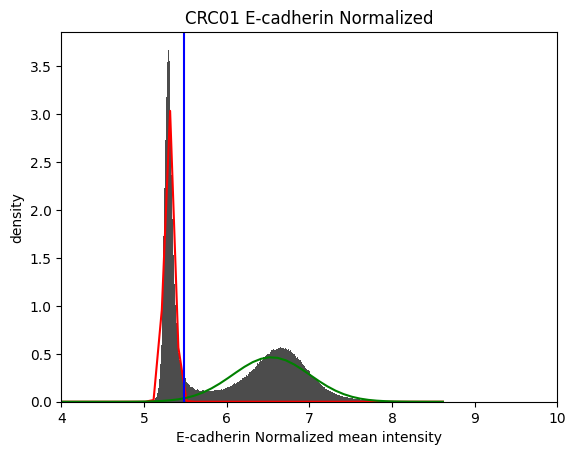

Positive population threshold is: [240.95031056]
Proportion of elements >= [240.95031056]: 53.81968050355346%
Number of elements >= [240.95031056]: 649145
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.0


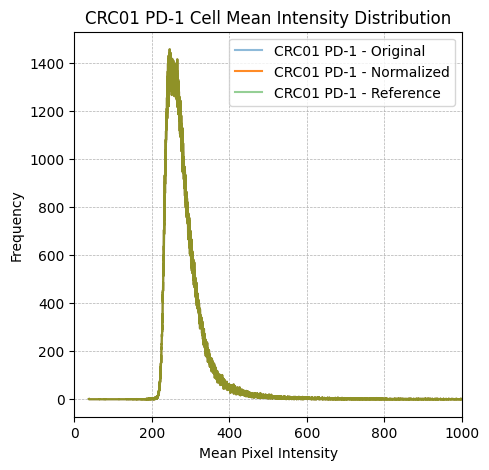

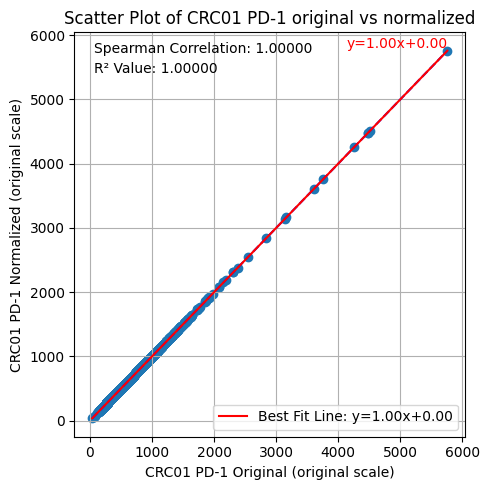

Currently processing PD-1 Original......


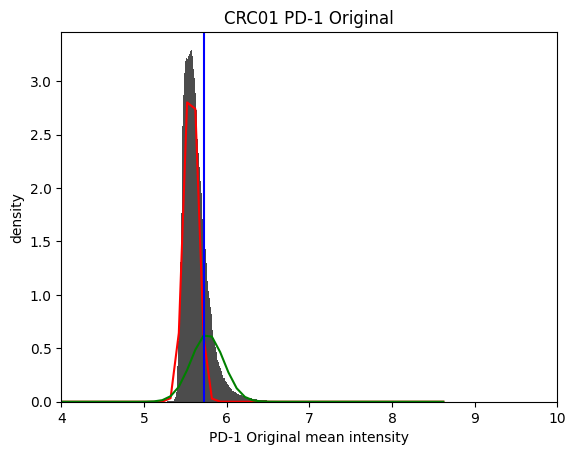

Positive population threshold is: [305.16239316]
Proportion of positive population >= [305.16239316]: 21.438248042528777%
Number of positive population >= [305.16239316]: 258577
Currently processing PD-1 Normalized......


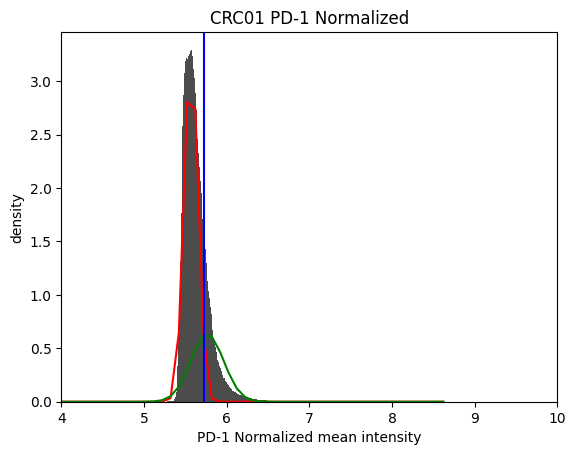

Positive population threshold is: [305.16239316]
Proportion of elements >= [305.16239316]: 21.438248042528777%
Number of elements >= [305.16239316]: 258577
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 1.0226241715253523


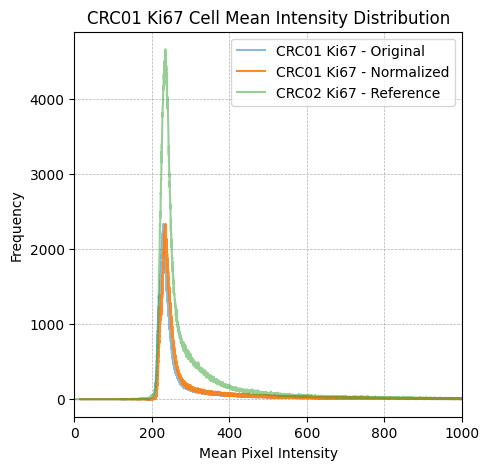

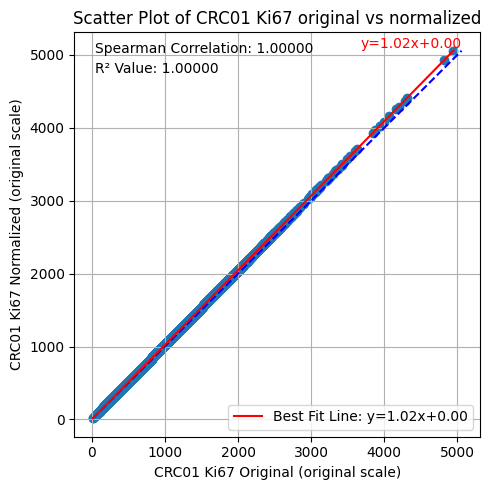

Currently processing Ki67 Original......


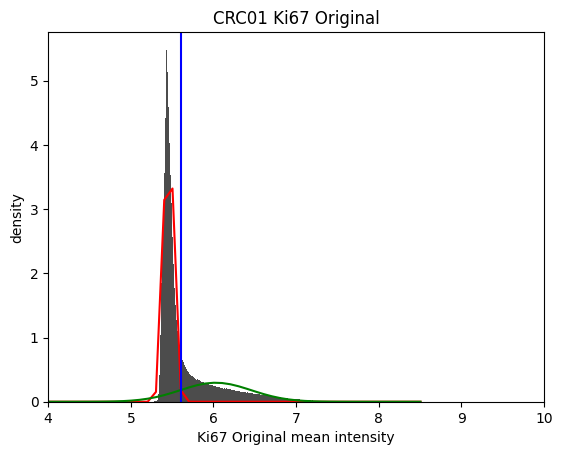

Positive population threshold is: [271.56382979]
Proportion of positive population >= [271.56382979]: 29.183483287291445%
Number of positive population >= [271.56382979]: 351996
Currently processing Ki67 Normalized......


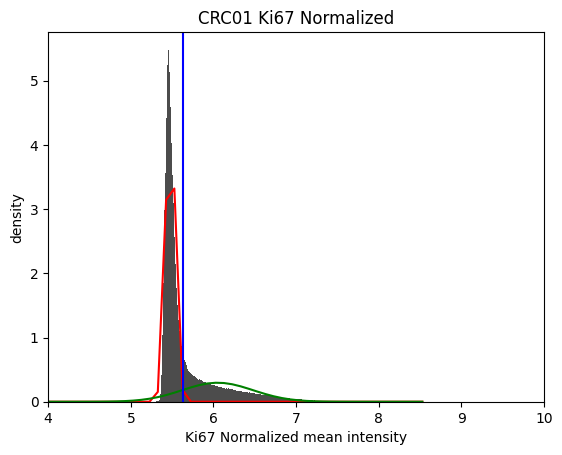

Positive population threshold is: [277.70773645]
Proportion of elements >= [277.70773645]: 29.183483287291445%
Number of elements >= [277.70773645]: 351996
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 1.0


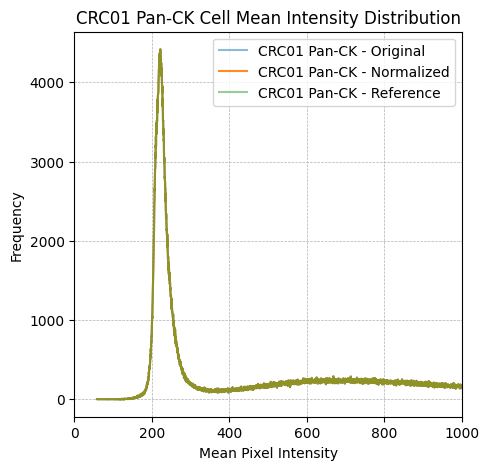

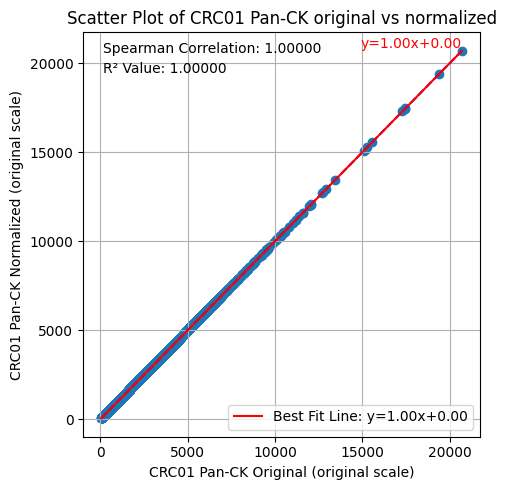

Currently processing Pan-CK Original......


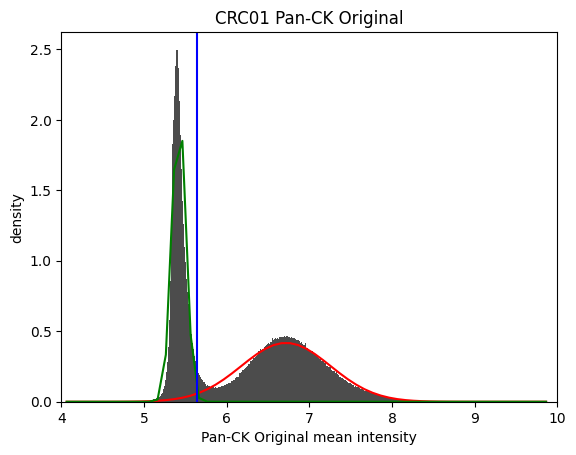

Positive population threshold is: [282.34736842]
Proportion of positive population >= [282.34736842]: 55.52295406533858%
Number of positive population >= [282.34736842]: 669689
Currently processing Pan-CK Normalized......


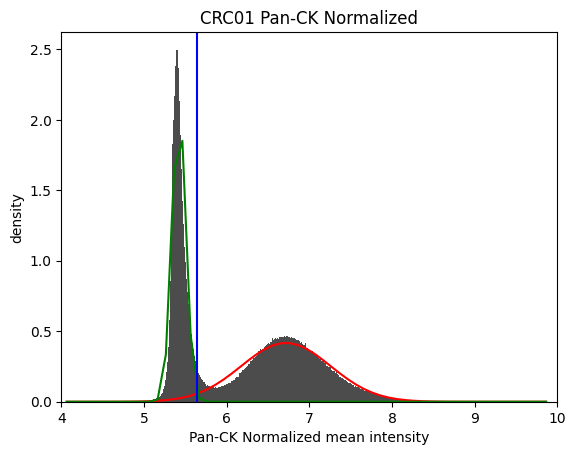

Positive population threshold is: [282.34736842]
Proportion of elements >= [282.34736842]: 55.52295406533858%
Number of elements >= [282.34736842]: 669689
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 1.0


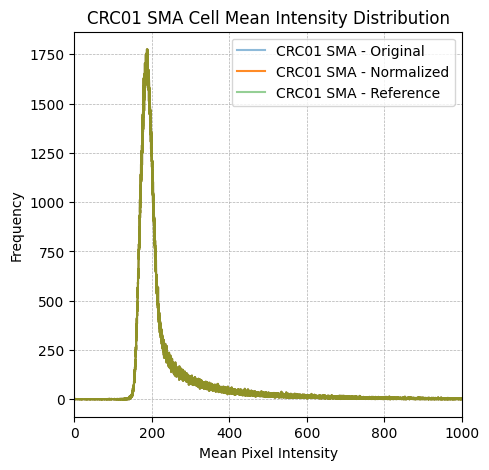

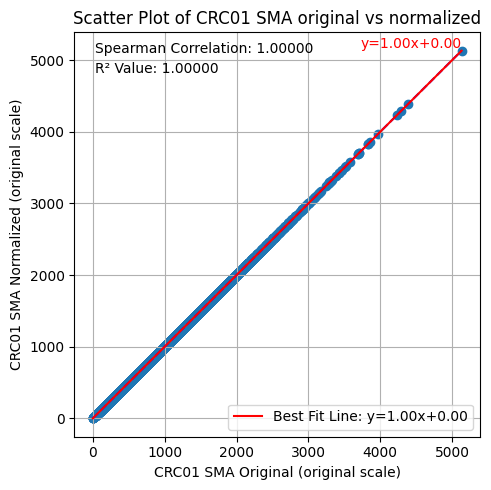

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


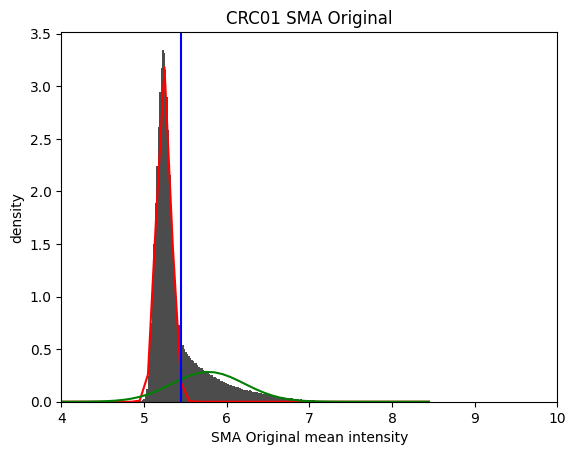

Positive population threshold is: [231.19607843]
Proportion of positive population >= [231.19607843]: 25.981554502432537%
Number of positive population >= [231.19607843]: 313376
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


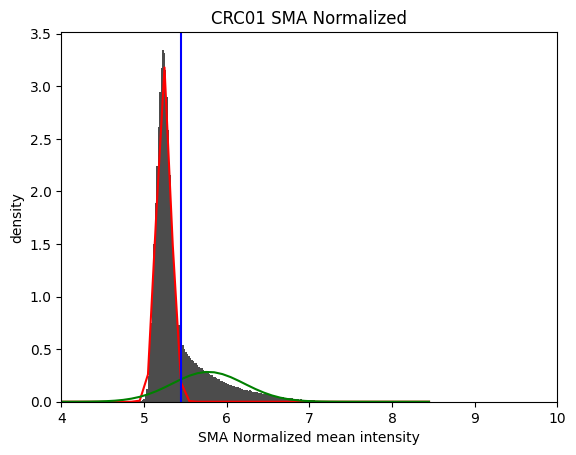

Positive population threshold is: [231.19607843]
Proportion of elements >= [231.19607843]: 25.981554502432537%
Number of elements >= [231.19607843]: 313376
******************************  Processing CRC02 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.3418907690866775


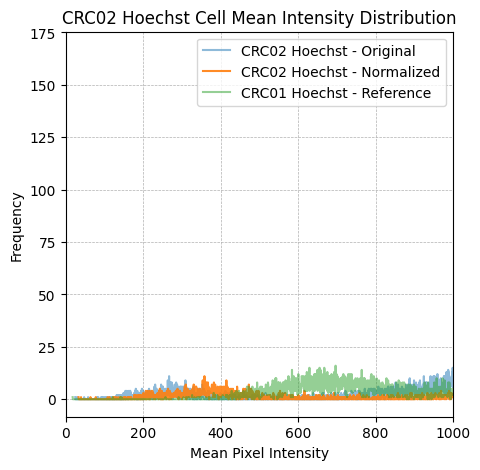

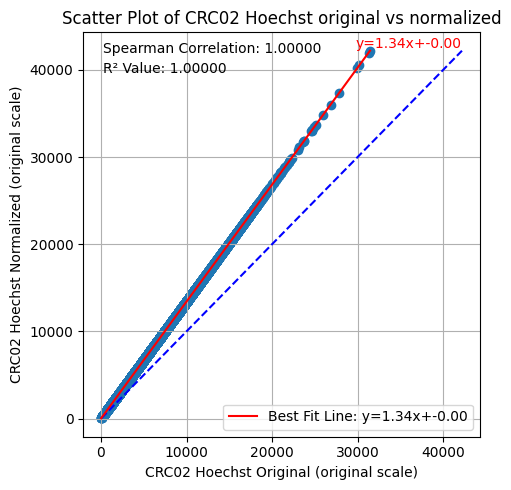

Currently processing Hoechst Original......


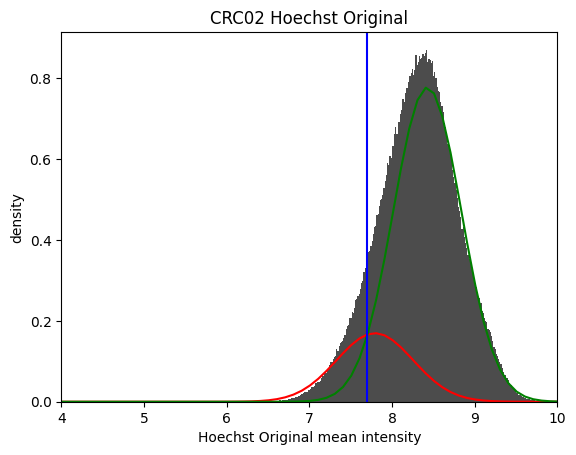

Positive population threshold is: [2217.23076923]
Proportion of positive population >= [2217.23076923]: 88.83723692135422%
Number of positive population >= [2217.23076923]: 837792
Currently processing Hoechst Normalized......


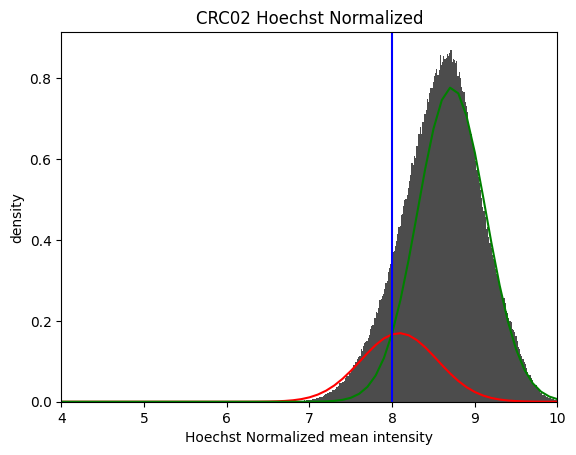

Positive population threshold is: [2975.28150217]
Proportion of elements >= [2975.28150217]: 88.83713088401211%
Number of elements >= [2975.28150217]: 837791
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.150711155208103


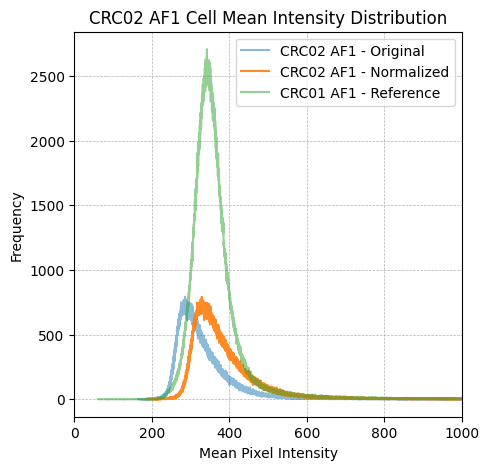

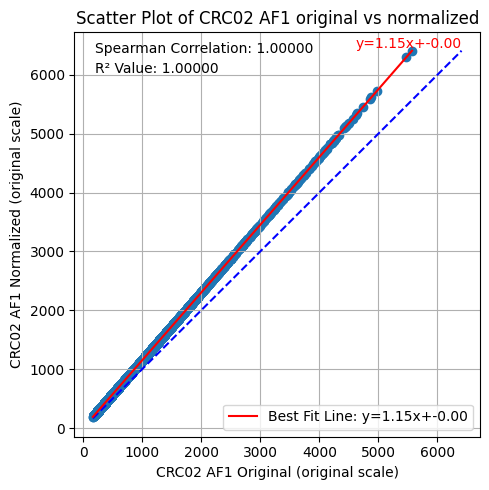

Currently processing AF1 Original......


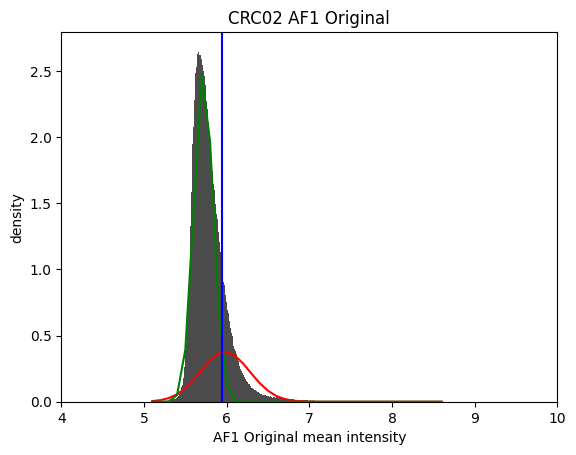

Positive population threshold is: [381.37662338]
Proportion of positive population >= [381.37662338]: 17.72806511541104%
Number of positive population >= [381.37662338]: 167187
Currently processing AF1 Normalized......


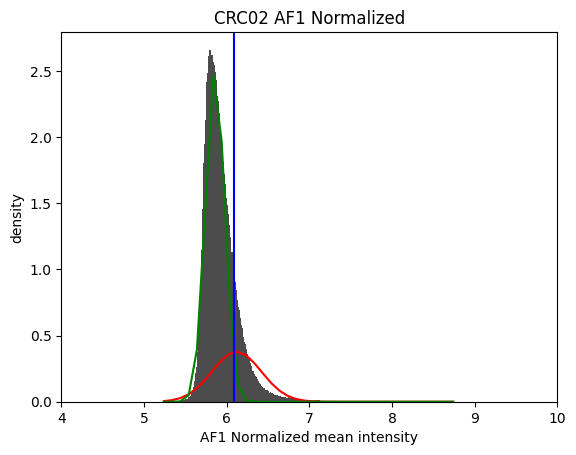

Positive population threshold is: [438.85433486]
Proportion of elements >= [438.85433486]: 17.72806511541104%
Number of elements >= [438.85433486]: 167187
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 1.0


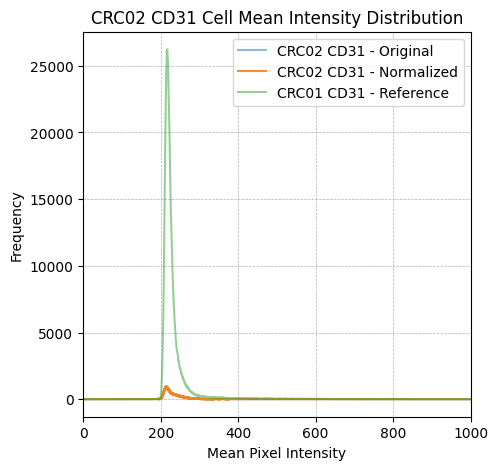

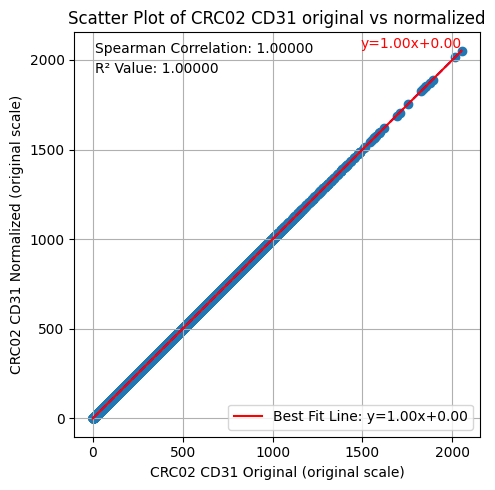

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


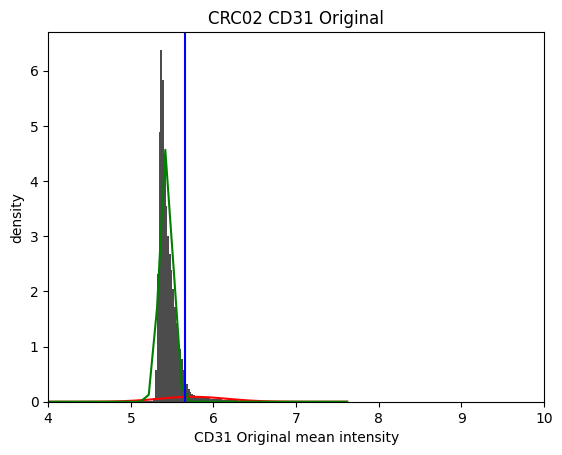

Positive population threshold is: [284.26415094]
Proportion of positive population >= [284.26415094]: 6.339866647438562%
Number of positive population >= [284.26415094]: 59789
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


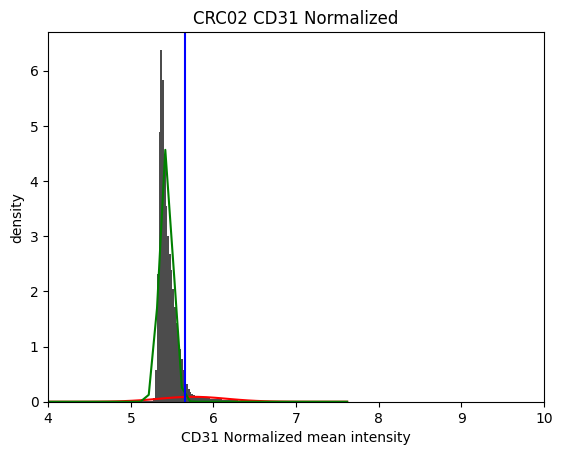

Positive population threshold is: [284.26415094]
Proportion of elements >= [284.26415094]: 6.339866647438562%
Number of elements >= [284.26415094]: 59789
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 1.0


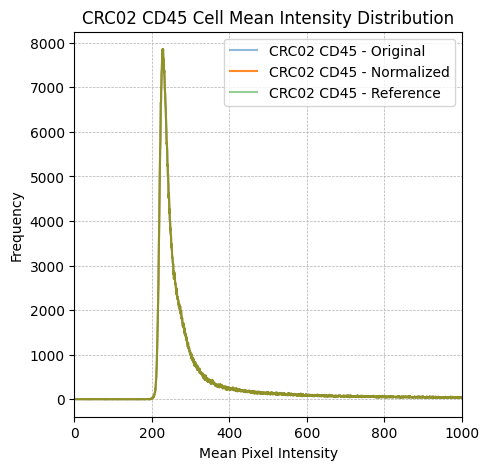

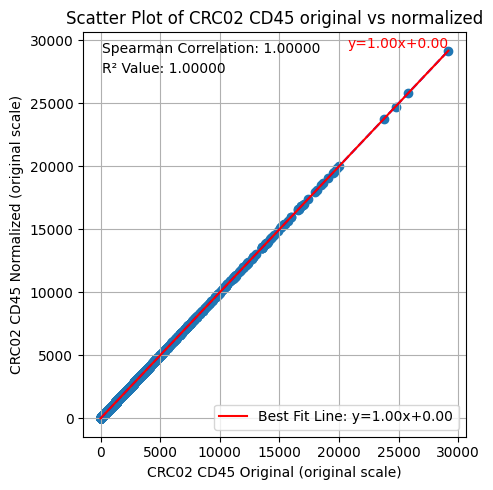

Currently processing CD45 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


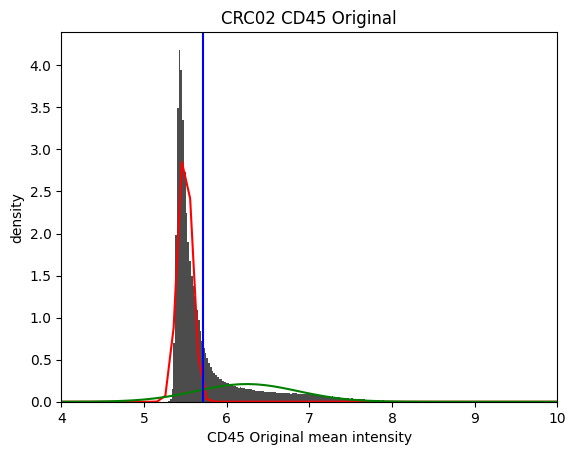

Positive population threshold is: [302.13793103]
Proportion of positive population >= [302.13793103]: 28.318968808055445%
Number of positive population >= [302.13793103]: 267066
Currently processing CD45 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


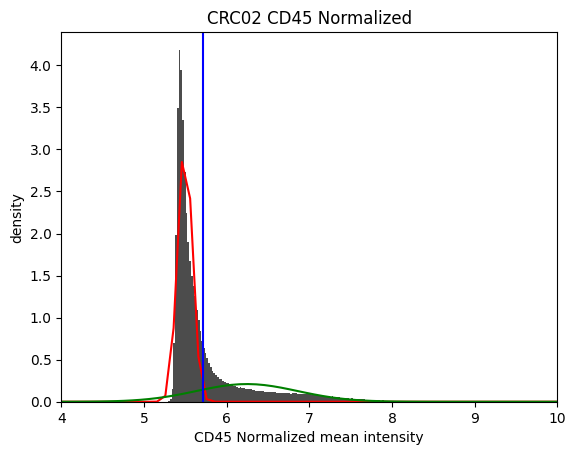

Positive population threshold is: [302.13793103]
Proportion of elements >= [302.13793103]: 28.318968808055445%
Number of elements >= [302.13793103]: 267066
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 1.0


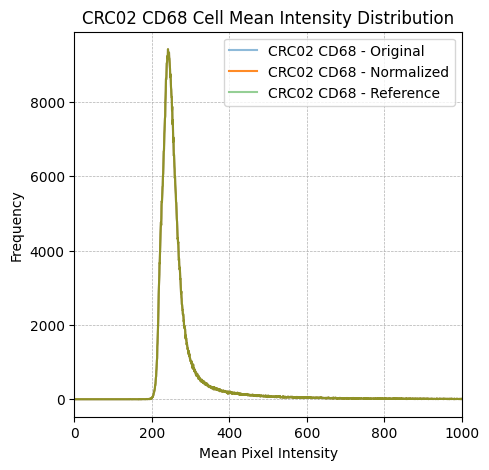

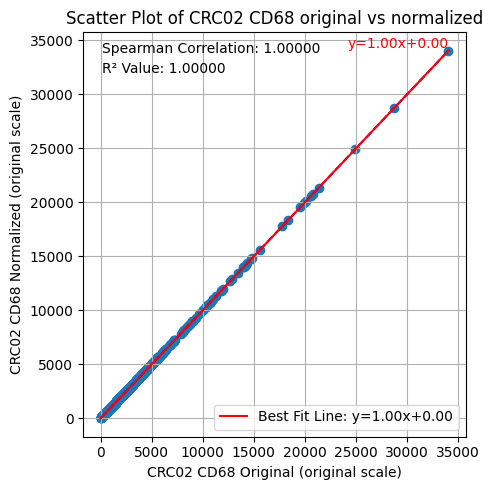

Currently processing CD68 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


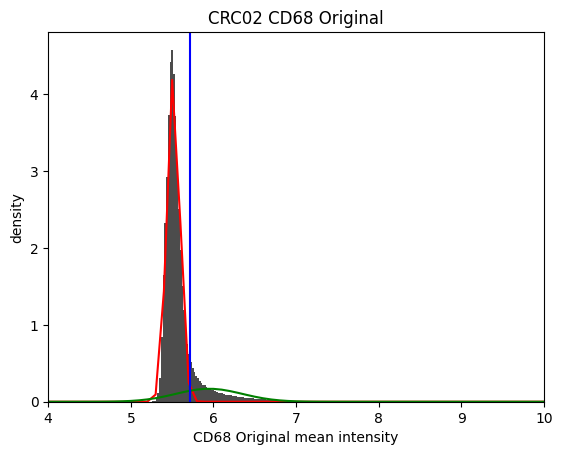

Positive population threshold is: [303.90659341]
Proportion of positive population >= [303.90659341]: 13.378095230016202%
Number of positive population >= [303.90659341]: 126164
Currently processing CD68 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


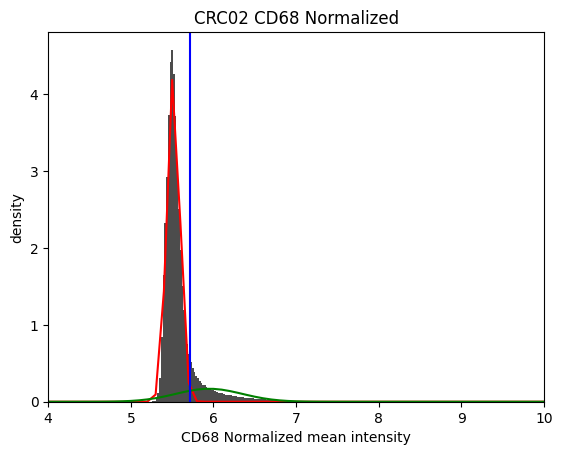

Positive population threshold is: [303.90659341]
Proportion of elements >= [303.90659341]: 13.378095230016202%
Number of elements >= [303.90659341]: 126164
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.0


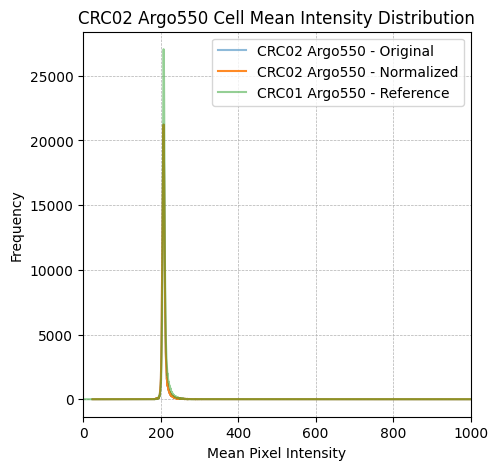

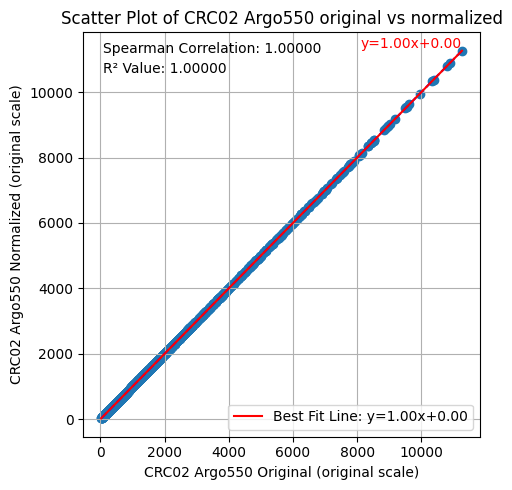

Currently processing Argo550 Original......


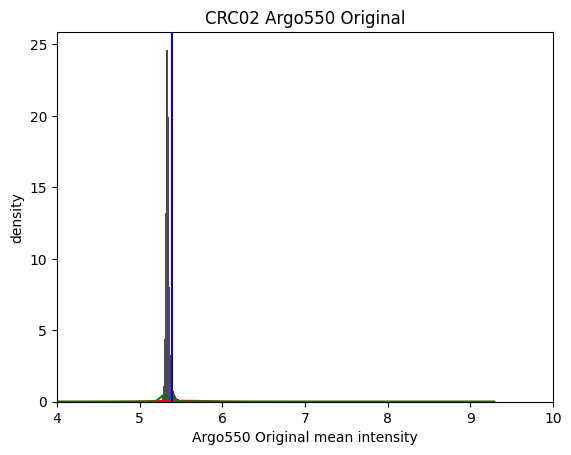

Positive population threshold is: [220.47058824]
Proportion of positive population >= [220.47058824]: 4.488878803559461%
Number of positive population >= [220.47058824]: 42333
Currently processing Argo550 Normalized......


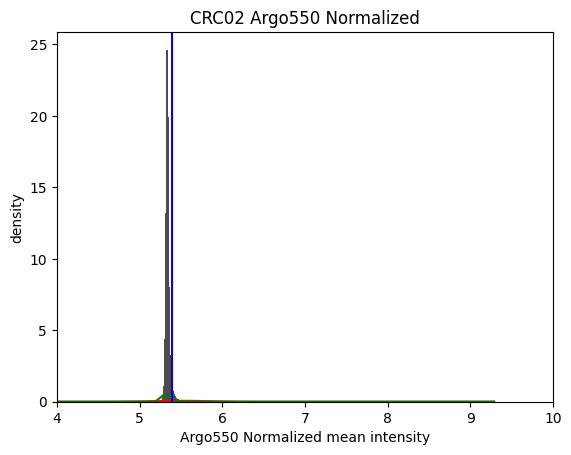

Positive population threshold is: [220.47058824]
Proportion of elements >= [220.47058824]: 4.488878803559461%
Number of elements >= [220.47058824]: 42333
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 1.0


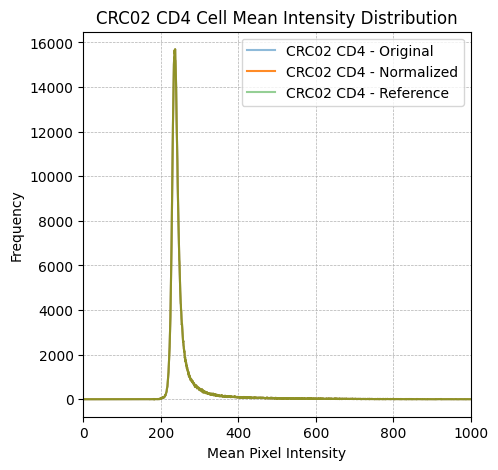

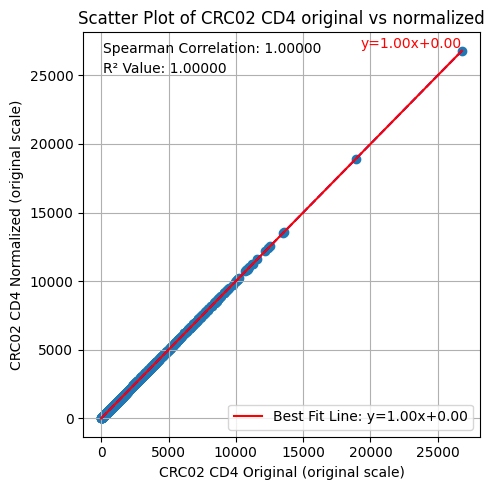

Currently processing CD4 Original......


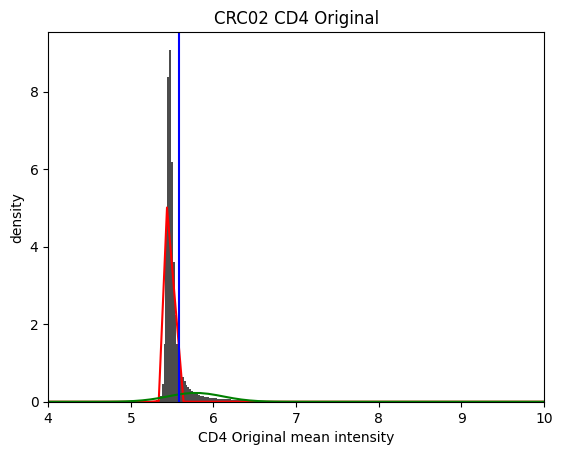

Positive population threshold is: [266.66783217]
Proportion of positive population >= [266.66783217]: 15.584626281991465%
Number of positive population >= [266.66783217]: 146973
Currently processing CD4 Normalized......


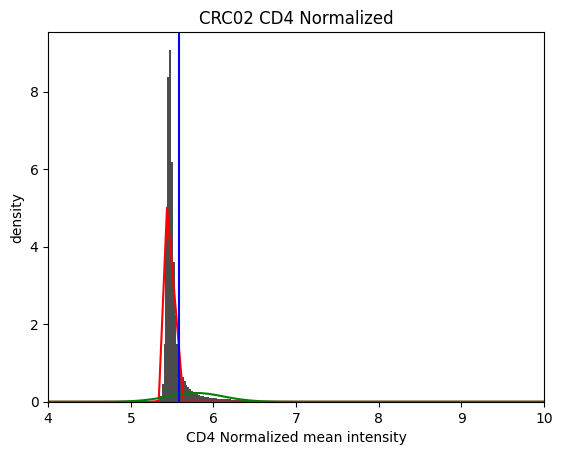

Positive population threshold is: [266.66783217]
Proportion of elements >= [266.66783217]: 15.584626281991465%
Number of elements >= [266.66783217]: 146973
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0


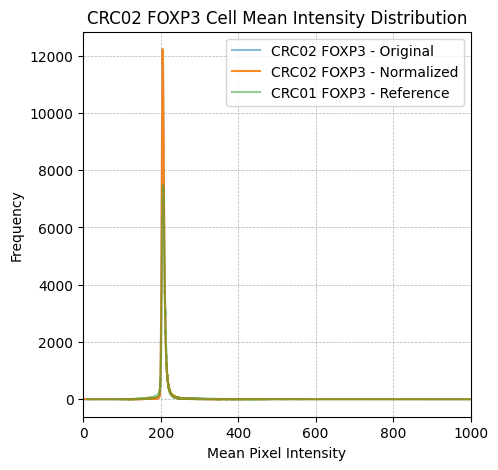

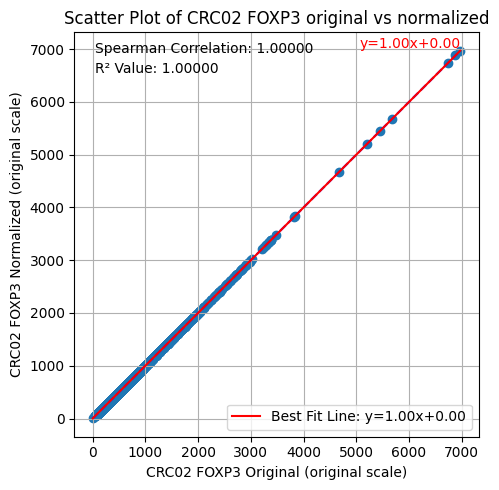

Currently processing FOXP3 Original......


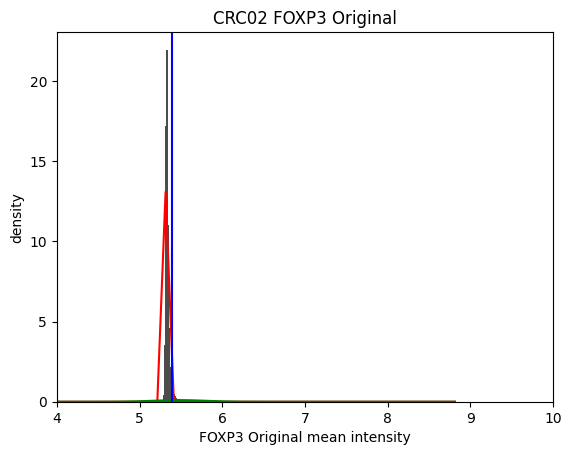

Positive population threshold is: [219.59375]
Proportion of positive population >= [219.59375]: 5.937454934129603%
Number of positive population >= [219.59375]: 55994
Currently processing FOXP3 Normalized......


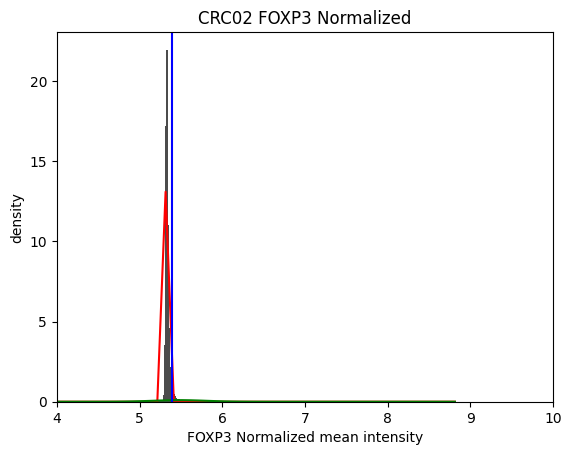

Positive population threshold is: [219.59375]
Proportion of elements >= [219.59375]: 5.937454934129603%
Number of elements >= [219.59375]: 55994
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 1.0


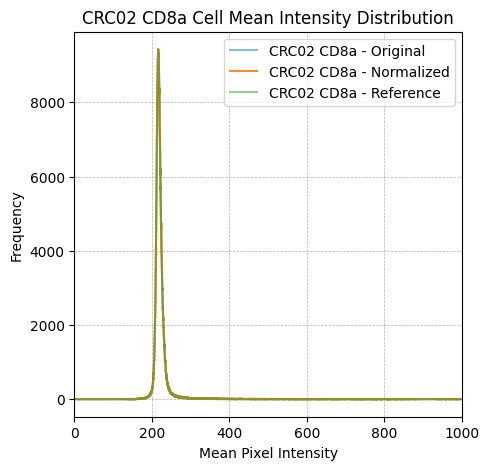

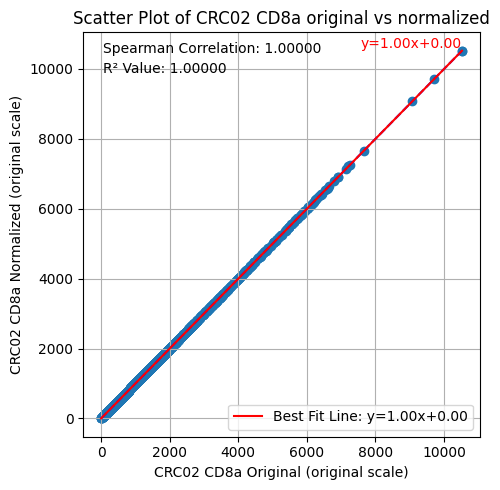

Currently processing CD8a Original......


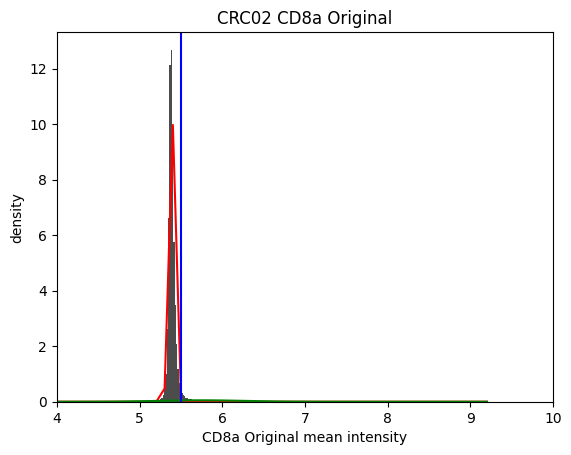

Positive population threshold is: [244.71428571]
Proportion of positive population >= [244.71428571]: 5.0045383982423255%
Number of positive population >= [244.71428571]: 47196
Currently processing CD8a Normalized......


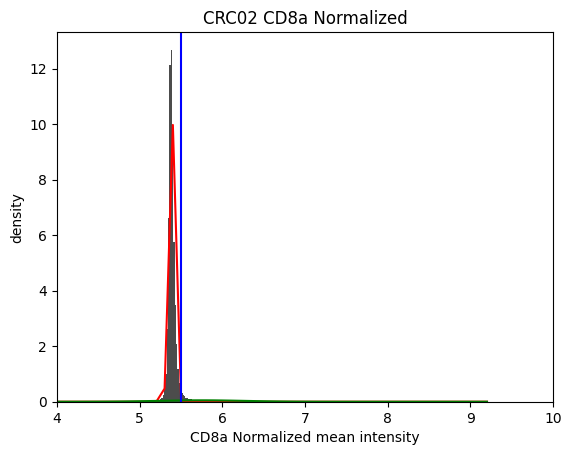

Positive population threshold is: [244.71428571]
Proportion of elements >= [244.71428571]: 5.0045383982423255%
Number of elements >= [244.71428571]: 47196
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 1.112554414662955


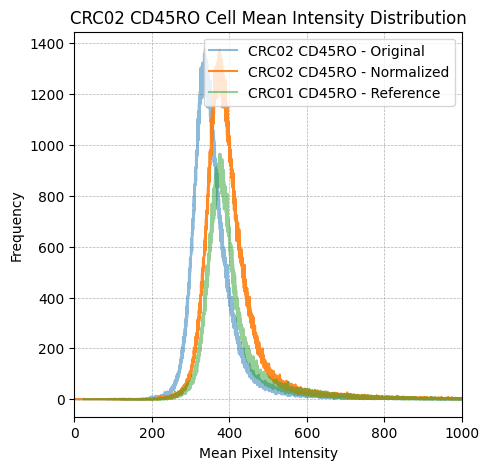

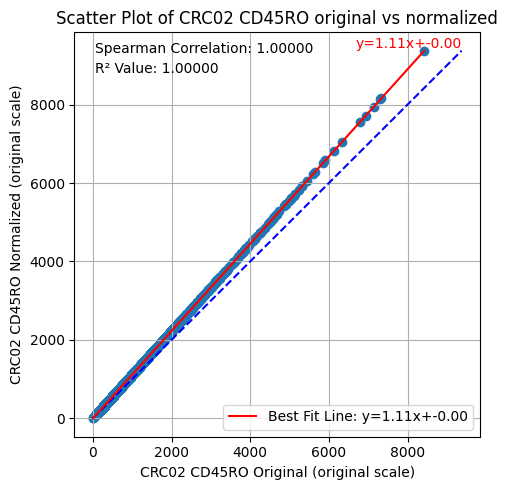

Currently processing CD45RO Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


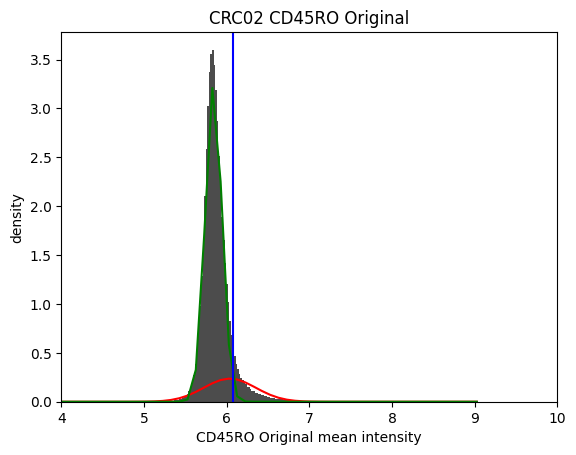

Positive population threshold is: [433.26865672]
Proportion of positive population >= [433.26865672]: 9.103942044230298%
Number of positive population >= [433.26865672]: 85856
Currently processing CD45RO Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


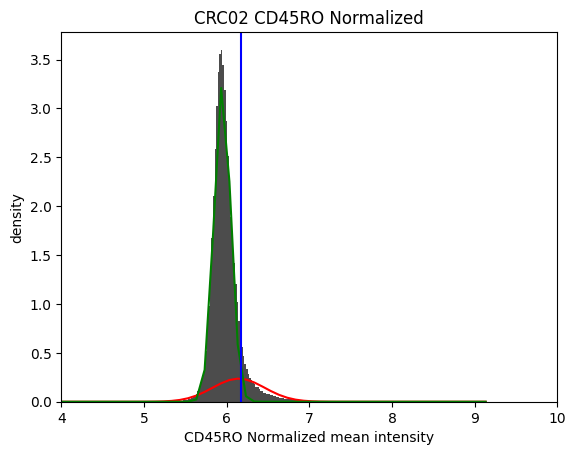

Positive population threshold is: [482.04201401]
Proportion of elements >= [482.04201401]: 9.10266959612497%
Number of elements >= [482.04201401]: 85844
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 1.0


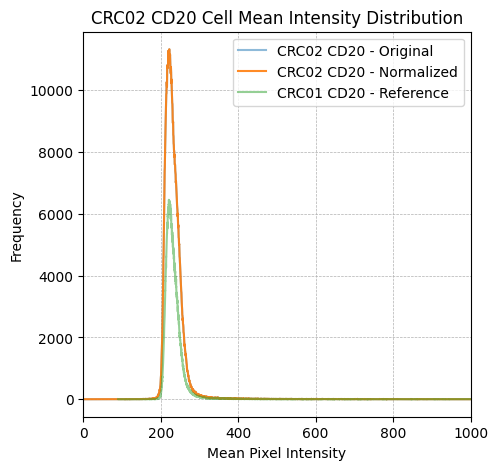

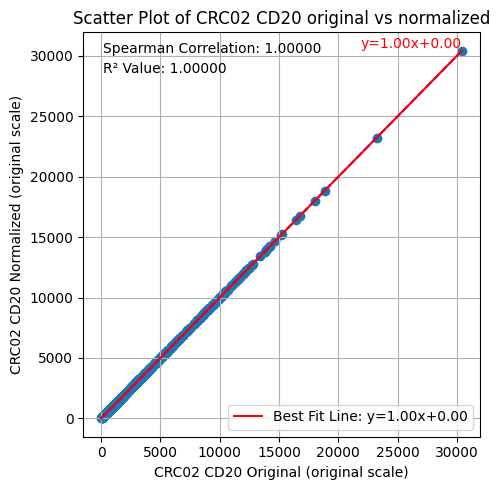

Currently processing CD20 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


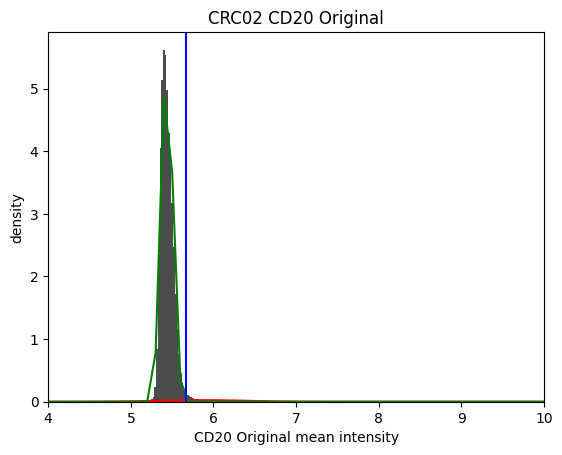

Positive population threshold is: [288.62934363]
Proportion of positive population >= [288.62934363]: 2.309281236480239%
Number of positive population >= [288.62934363]: 21778
Currently processing CD20 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


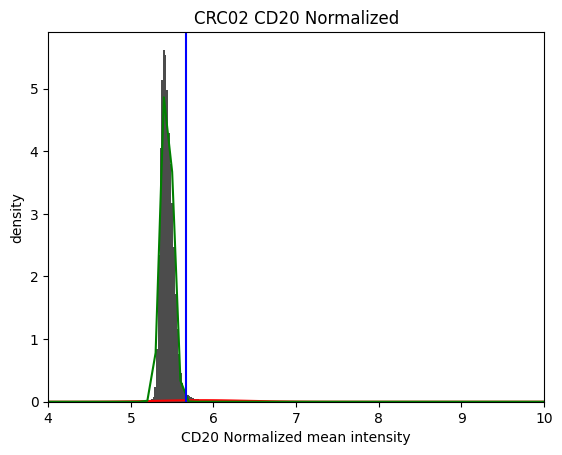

Positive population threshold is: [288.62934363]
Proportion of elements >= [288.62934363]: 2.309281236480239%
Number of elements >= [288.62934363]: 21778
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 1.1581404487272147


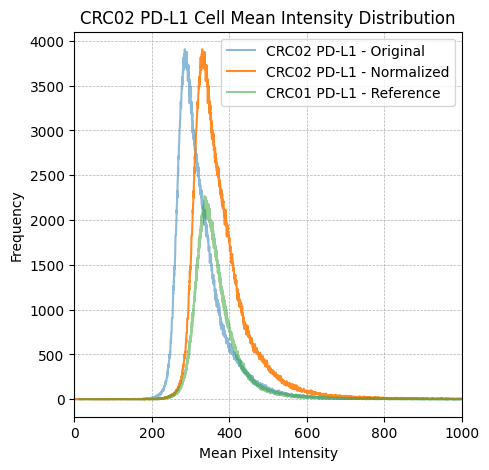

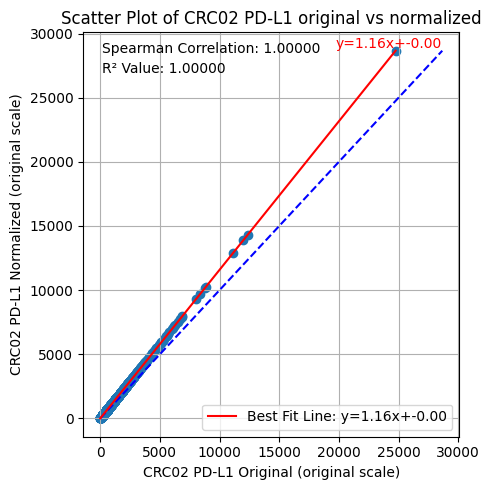

Currently processing PD-L1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


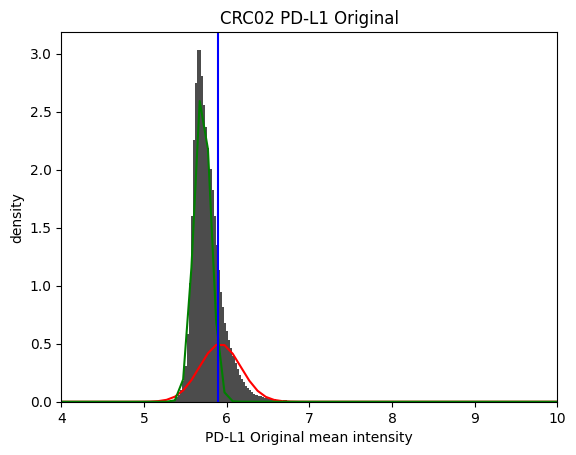

Positive population threshold is: [362.41975309]
Proportion of positive population >= [362.41975309]: 19.861854550698574%
Number of positive population >= [362.41975309]: 187310
Currently processing PD-L1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


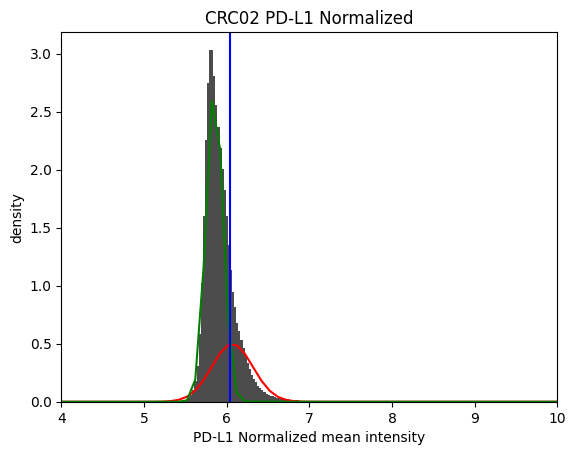

Positive population threshold is: [419.76024491]
Proportion of elements >= [419.76024491]: 19.853583638013962%
Number of elements >= [419.76024491]: 187232
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 1.0


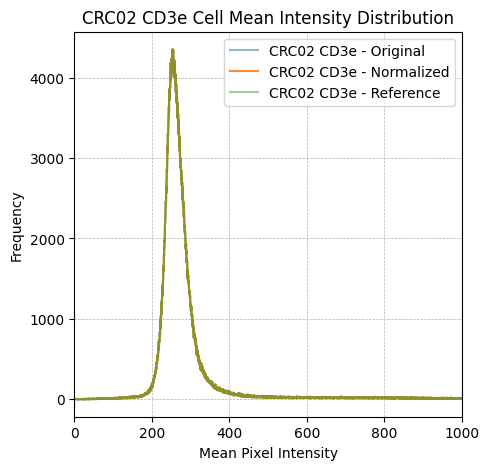

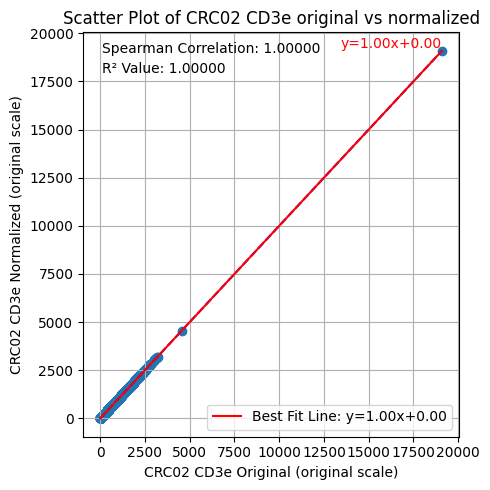

Currently processing CD3e Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


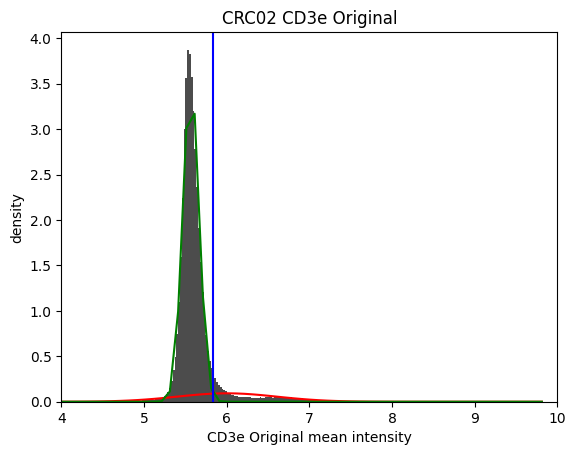

Positive population threshold is: [340.9939759]
Proportion of positive population >= [340.9939759]: 9.012749930015355%
Number of positive population >= [340.9939759]: 84996
Currently processing CD3e Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


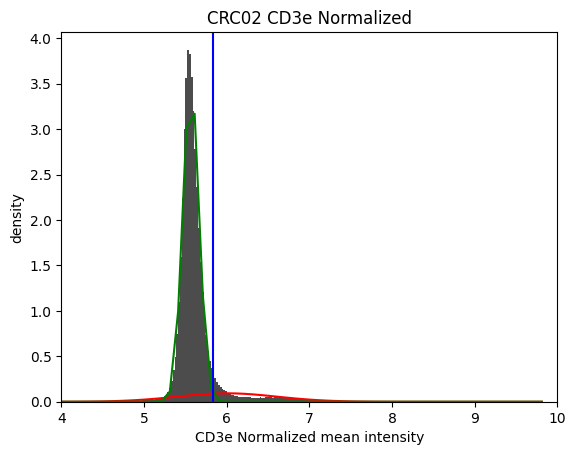

Positive population threshold is: [340.9939759]
Proportion of elements >= [340.9939759]: 9.012749930015355%
Number of elements >= [340.9939759]: 84996
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 1.1398024659817032


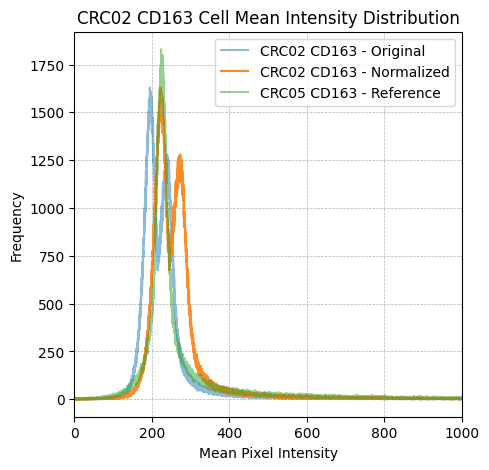

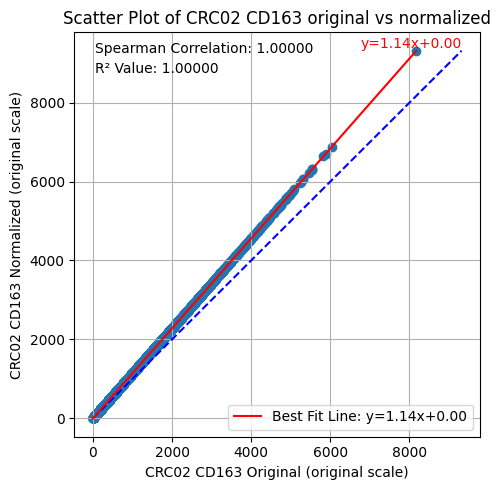

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


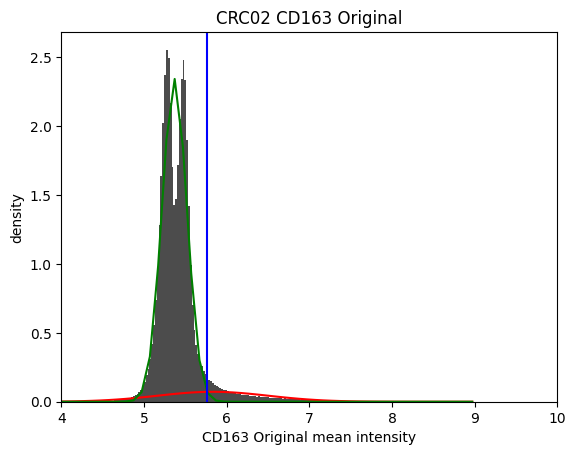

Positive population threshold is: [318.51552795]
Proportion of positive population >= [318.51552795]: 7.04342441234105%
Number of positive population >= [318.51552795]: 66424
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


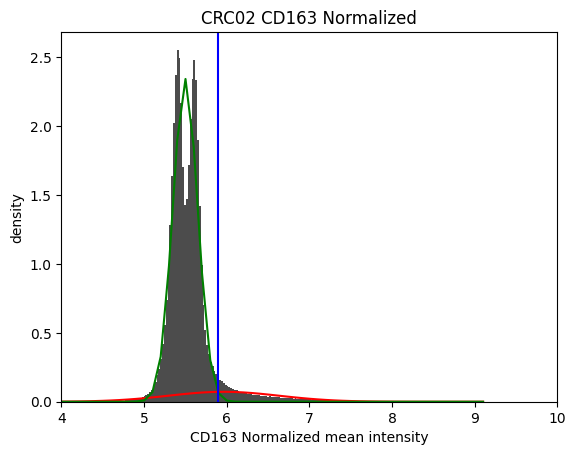

Positive population threshold is: [363.04943448]
Proportion of elements >= [363.04943448]: 7.043000262972608%
Number of elements >= [363.04943448]: 66420
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 1.0


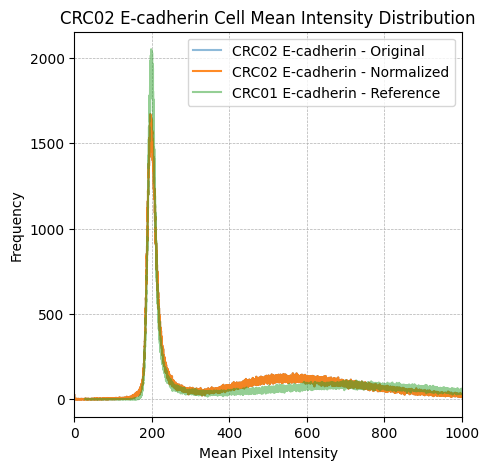

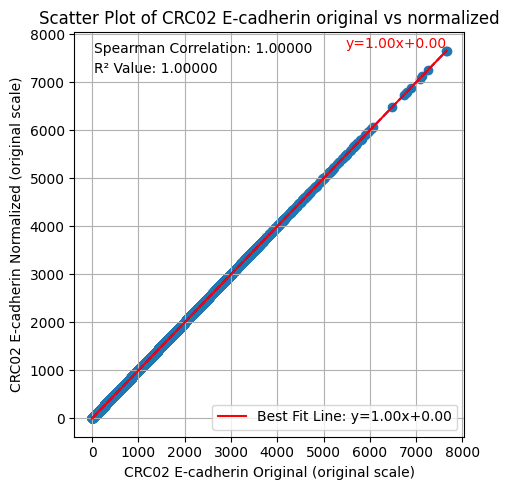

Currently processing E-cadherin Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


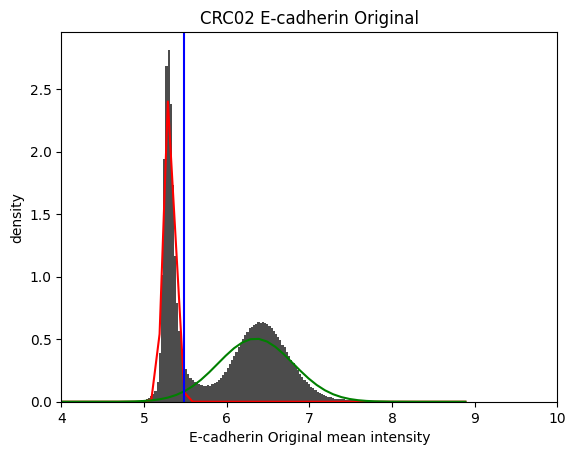

Positive population threshold is: [241.27272727]
Proportion of positive population >= [241.27272727]: 55.92918402144499%
Number of positive population >= [241.27272727]: 527448
Currently processing E-cadherin Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


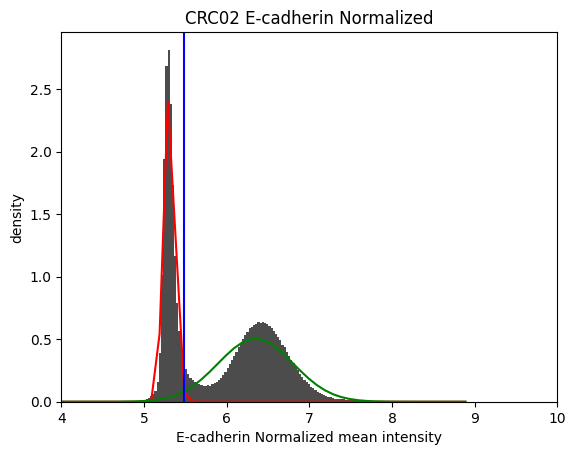

Positive population threshold is: [241.27272727]
Proportion of elements >= [241.27272727]: 55.92918402144499%
Number of elements >= [241.27272727]: 527448
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.0571071102490945


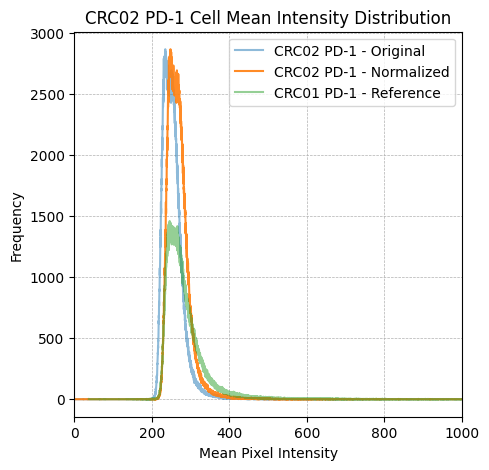

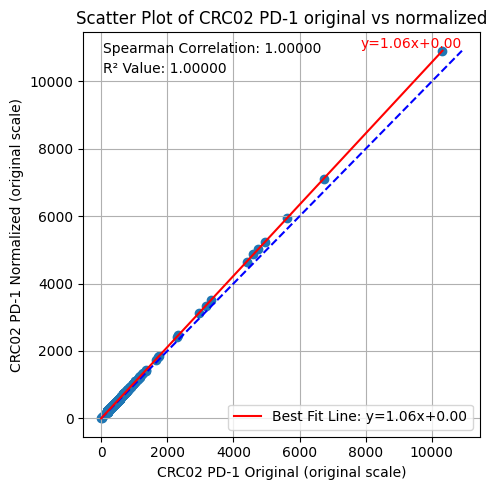

Currently processing PD-1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


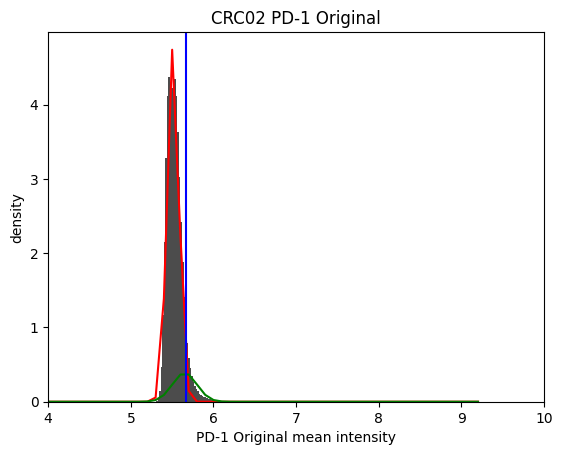

Positive population threshold is: [290.55029586]
Proportion of positive population >= [290.55029586]: 7.065904328868454%
Number of positive population >= [290.55029586]: 66636
Currently processing PD-1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


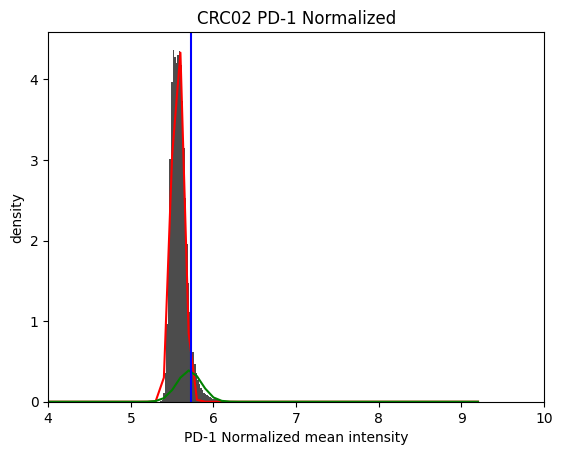

Positive population threshold is: [307.14775642]
Proportion of elements >= [307.14775642]: 7.063995656710468%
Number of elements >= [307.14775642]: 66618
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 1.0


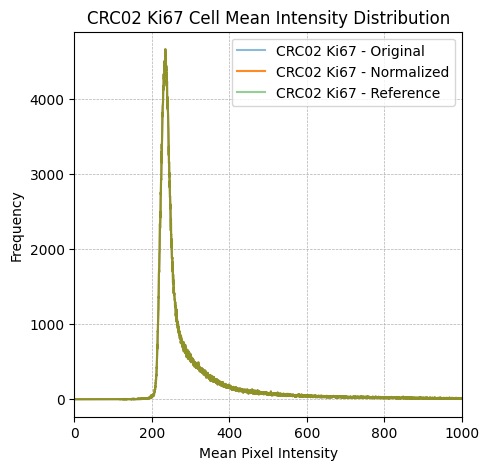

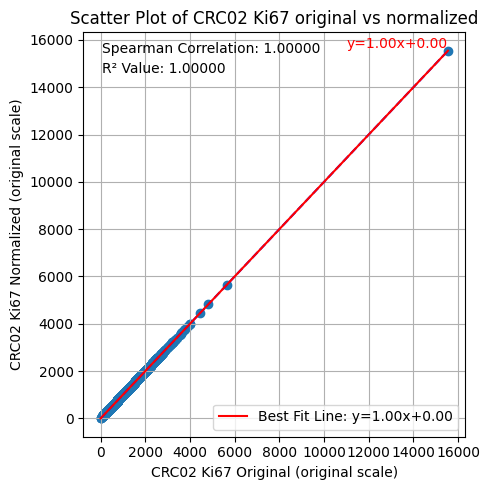

Currently processing Ki67 Original......


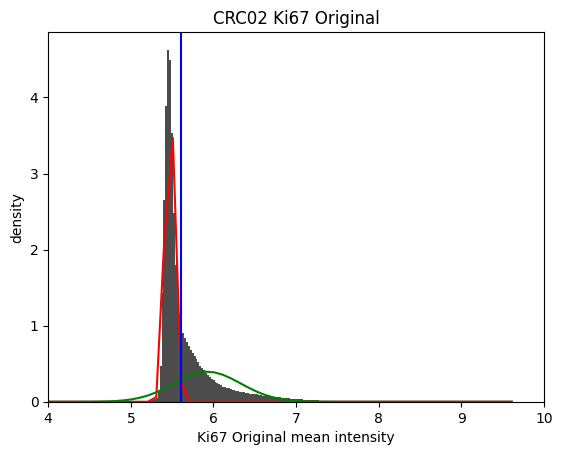

Positive population threshold is: [271.62043796]
Proportion of positive population >= [271.62043796]: 35.073335425803556%
Number of positive population >= [271.62043796]: 330764
Currently processing Ki67 Normalized......


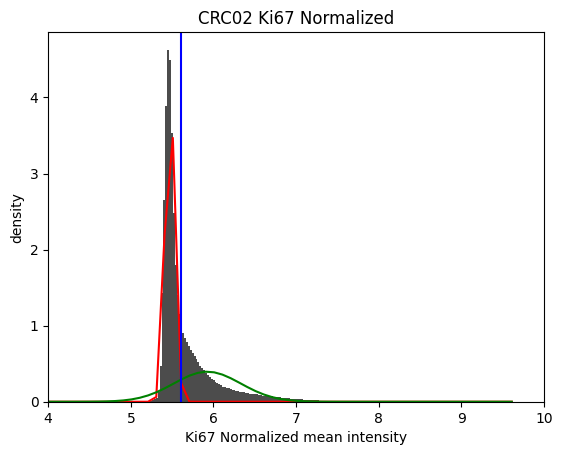

Positive population threshold is: [271.62043796]
Proportion of elements >= [271.62043796]: 35.073335425803556%
Number of elements >= [271.62043796]: 330764
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 1.0146419310833903


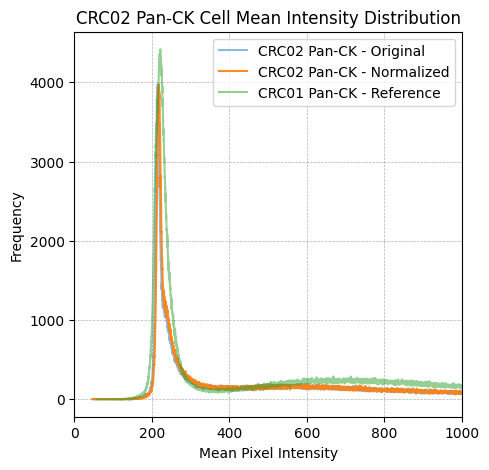

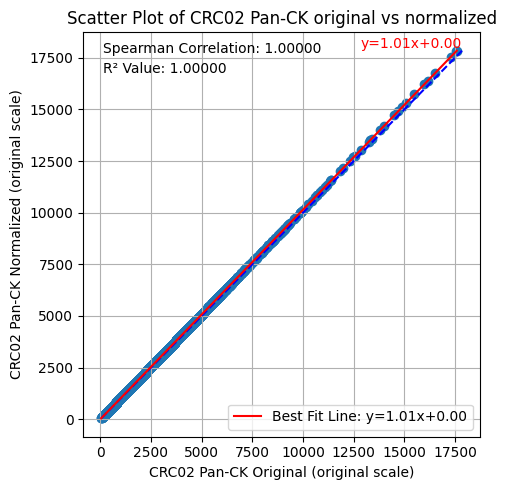

Currently processing Pan-CK Original......


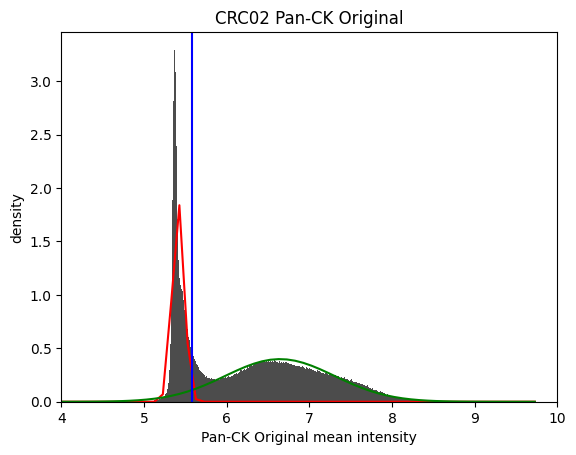

Positive population threshold is: [266.9673913]
Proportion of positive population >= [266.9673913]: 64.15959044136983%
Number of positive population >= [266.9673913]: 605066
Currently processing Pan-CK Normalized......


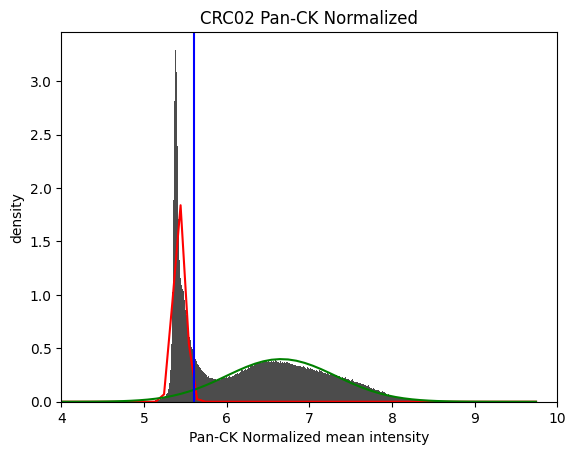

Positive population threshold is: [270.87630945]
Proportion of elements >= [270.87630945]: 64.15959044136983%
Number of elements >= [270.87630945]: 605066
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 1.0552305829701967


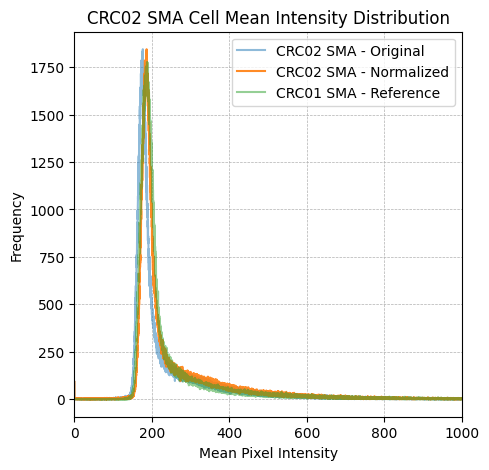

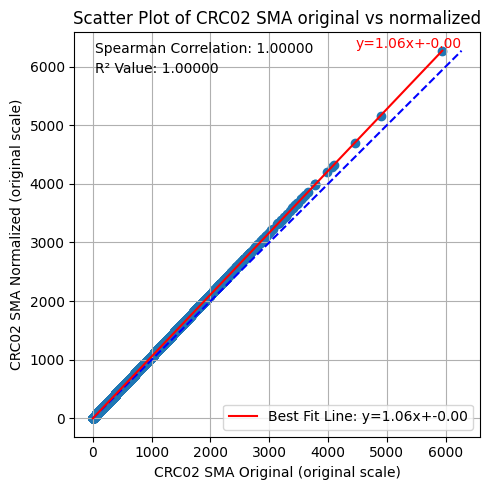

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


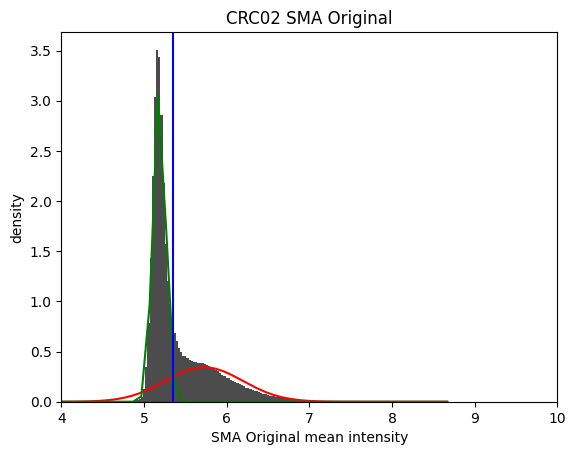

Positive population threshold is: [212.03658537]
Proportion of positive population >= [212.03658537]: 35.114477914542384%
Number of positive population >= [212.03658537]: 331152
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


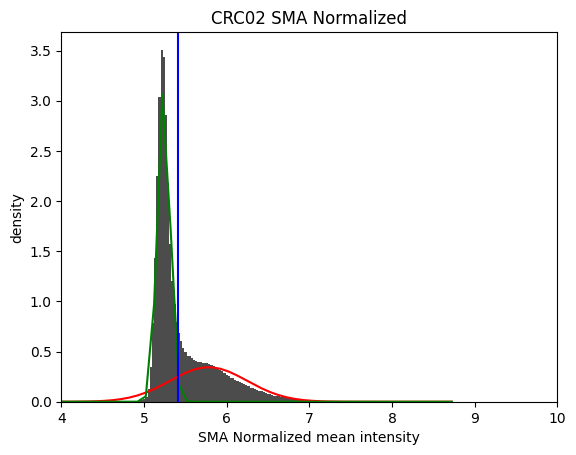

Positive population threshold is: [223.749784]
Proportion of elements >= [223.749784]: 35.11384169048972%
Number of elements >= [223.749784]: 331146
******************************  Processing CRC03 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.1396281929992265


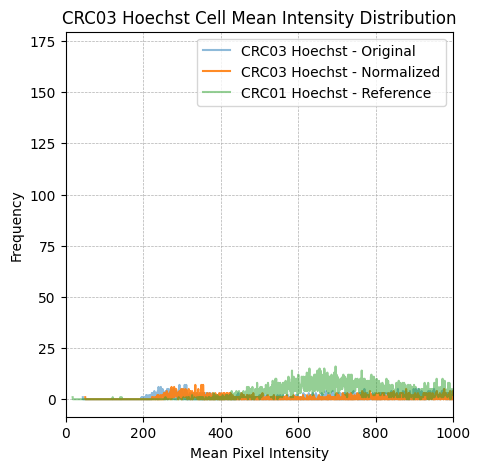

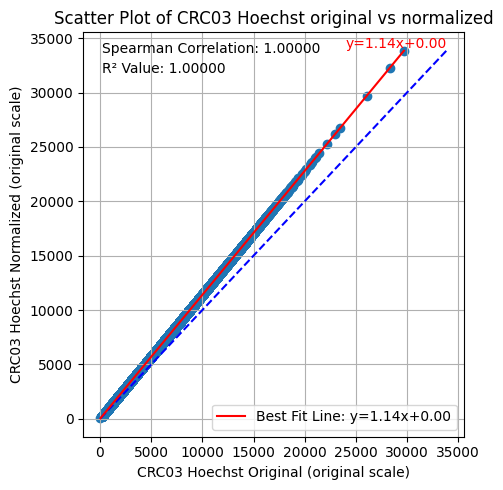

Currently processing Hoechst Original......


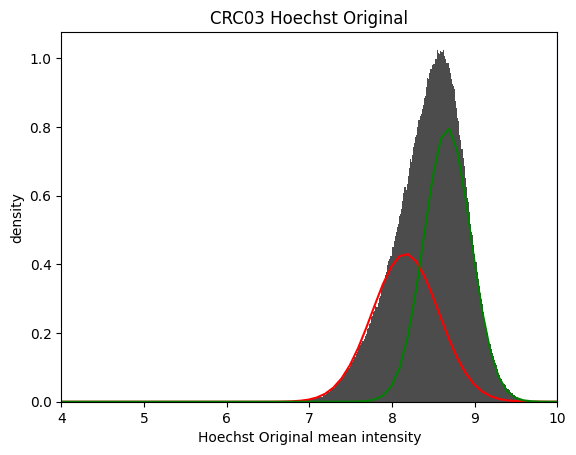

Positive population threshold is: [22166.83018868]
Proportion of positive population >= [22166.83018868]: 0.00034911276481948774%
Number of positive population >= [22166.83018868]: 5
Currently processing Hoechst Normalized......


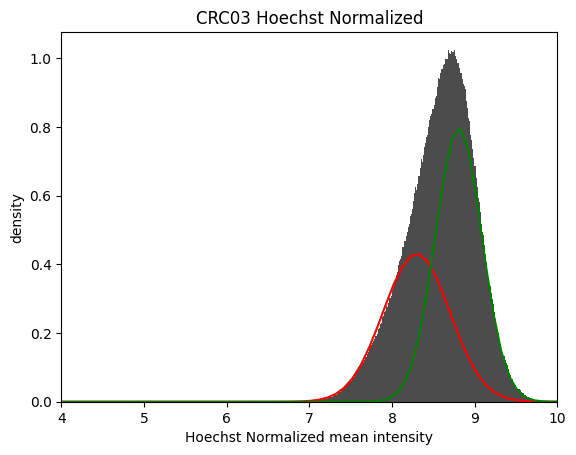

Positive population threshold is: [25261.94463245]
Proportion of elements >= [25261.94463245]: 0.0004189353177833853%
Number of elements >= [25261.94463245]: 6
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.049793132230291


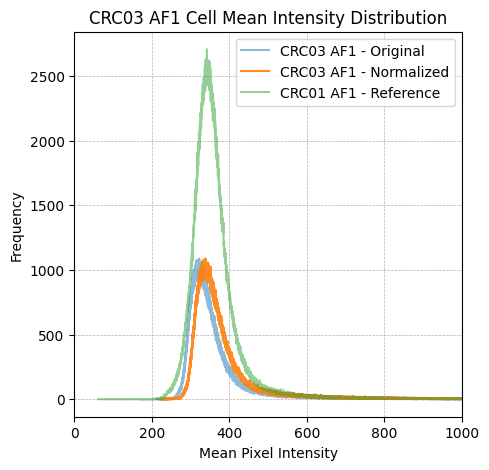

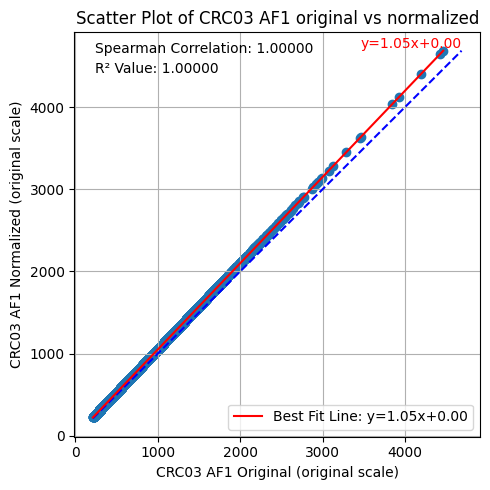

Currently processing AF1 Original......


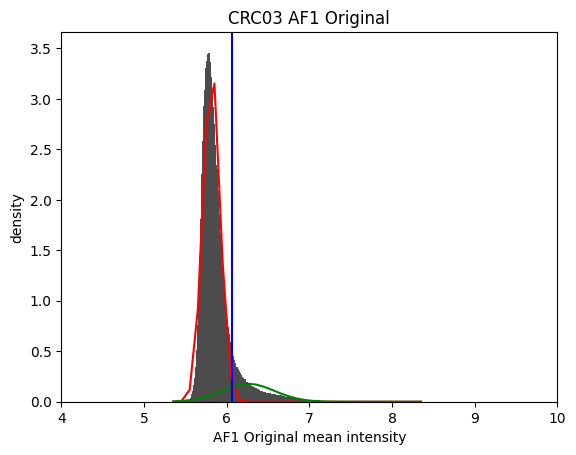

Positive population threshold is: [432.81679389]
Proportion of positive population >= [432.81679389]: 11.625455068488941%
Number of positive population >= [432.81679389]: 166500
Currently processing AF1 Normalized......


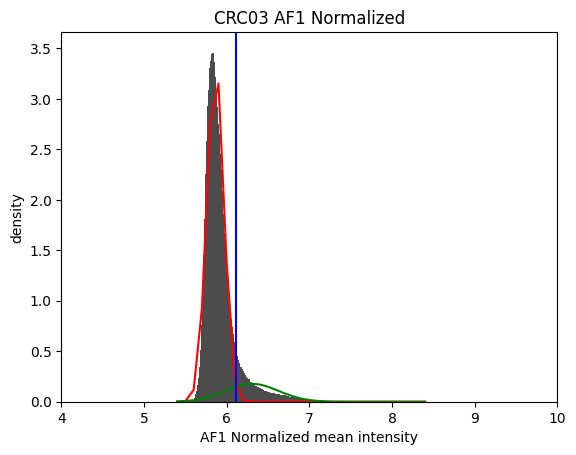

Positive population threshold is: [454.36809774]
Proportion of elements >= [454.36809774]: 11.625455068488941%
Number of elements >= [454.36809774]: 166500
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 0.984251519752188


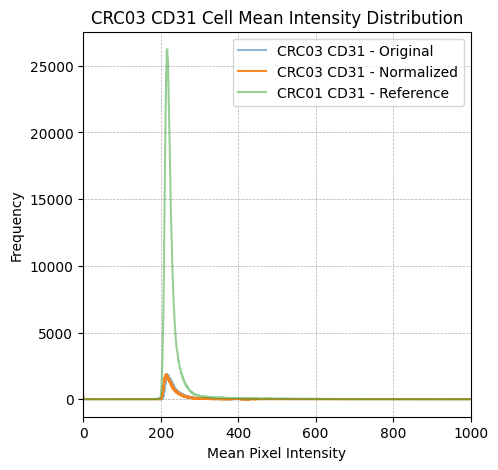

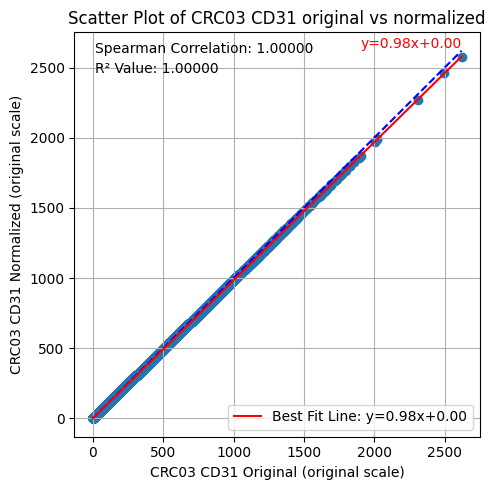

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


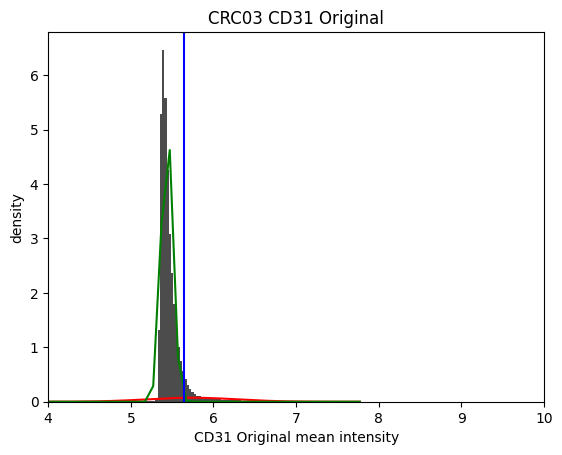

Positive population threshold is: [281.50802139]
Proportion of positive population >= [281.50802139]: 7.502223848311901%
Number of positive population >= [281.50802139]: 107447
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


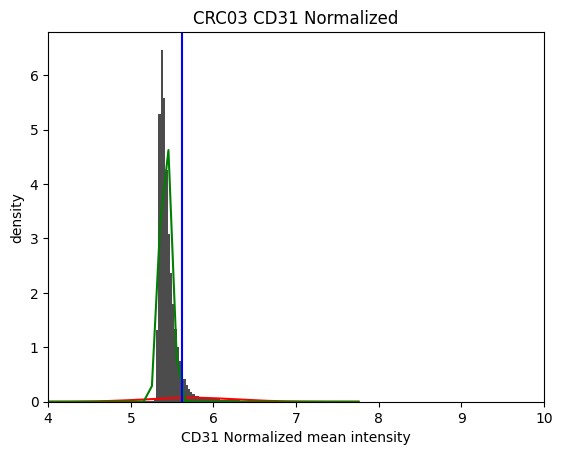

Positive population threshold is: [277.06015246]
Proportion of elements >= [277.06015246]: 7.505854621066023%
Number of elements >= [277.06015246]: 107499
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 0.9755221441392503


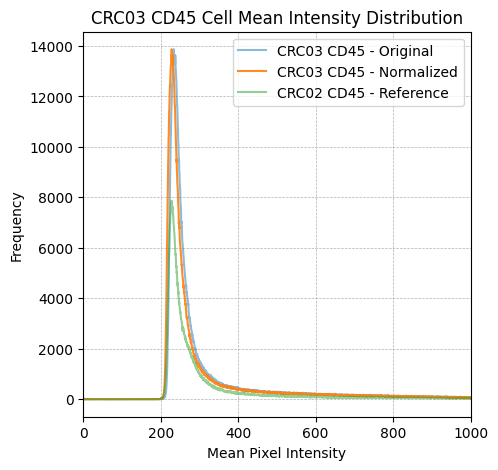

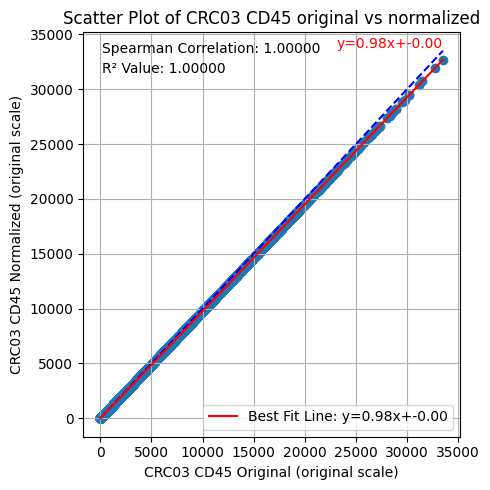

Currently processing CD45 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


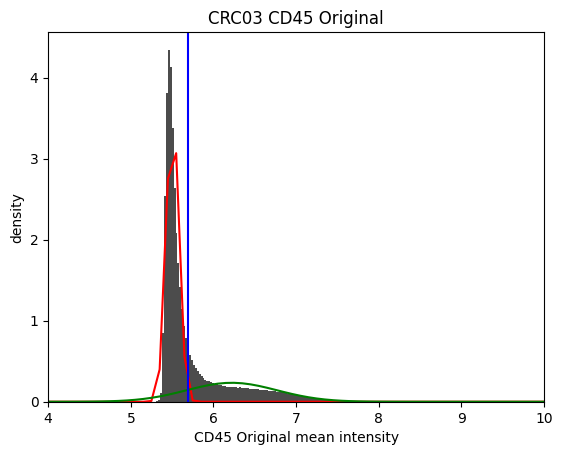

Positive population threshold is: [296.67857143]
Proportion of positive population >= [296.67857143]: 29.36122139195449%
Number of positive population >= [296.67857143]: 420512
Currently processing CD45 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


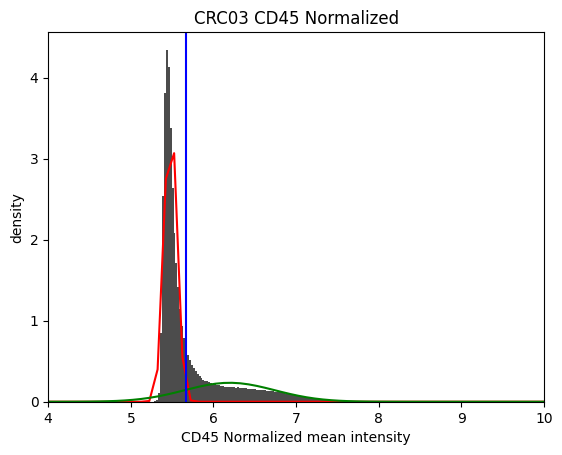

Positive population threshold is: [289.41694624]
Proportion of elements >= [289.41694624]: 29.360942101742634%
Number of elements >= [289.41694624]: 420508
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 1.0571113465447333


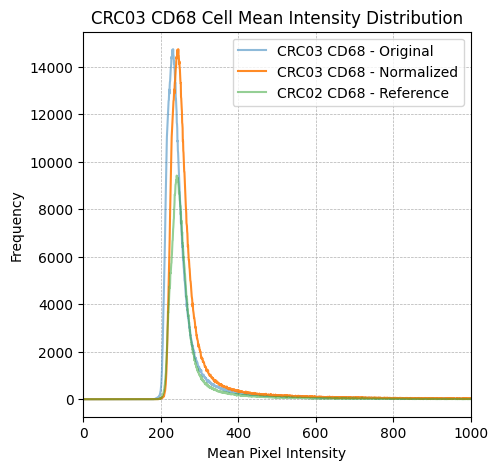

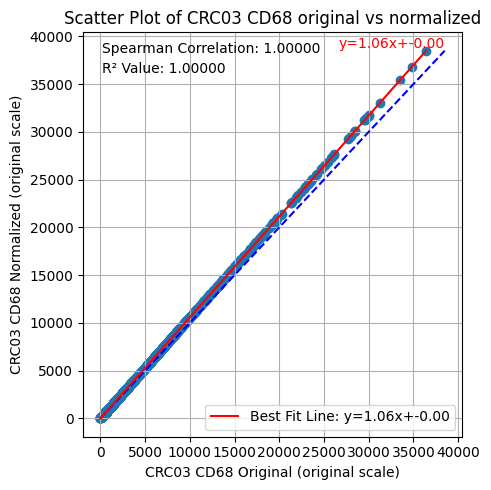

Currently processing CD68 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


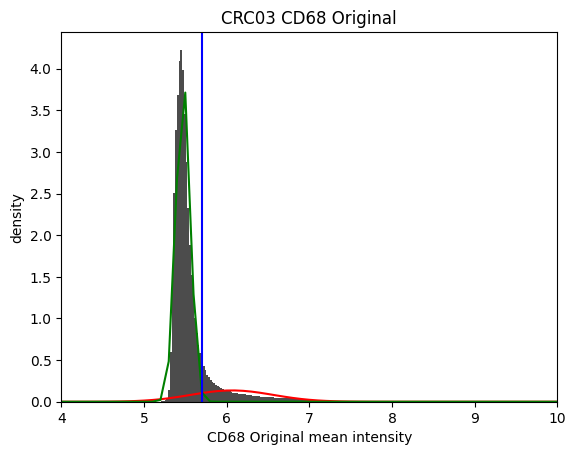

Positive population threshold is: [299.5872093]
Proportion of positive population >= [299.5872093]: 14.671463941538972%
Number of positive population >= [299.5872093]: 210125
Currently processing CD68 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


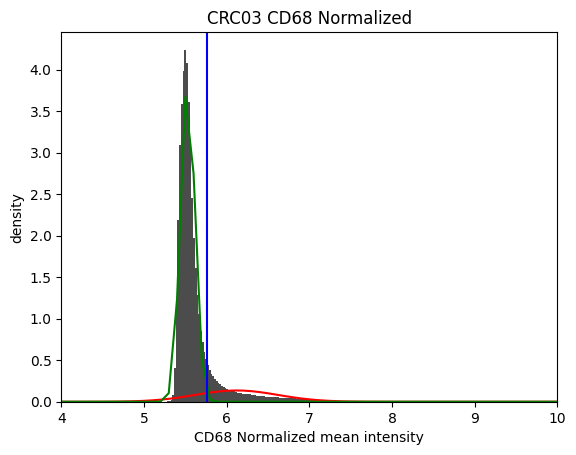

Positive population threshold is: [316.69703823]
Proportion of elements >= [316.69703823]: 14.671463941538972%
Number of elements >= [316.69703823]: 210125
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.0199380292125437


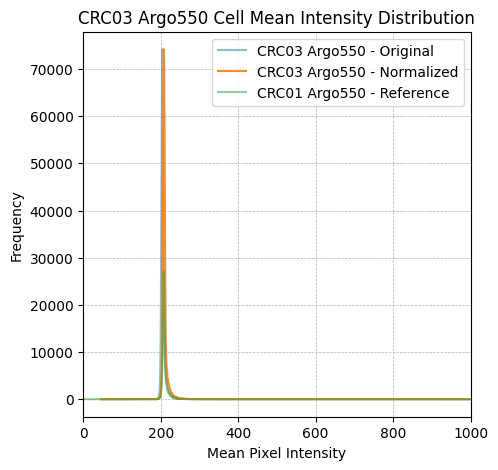

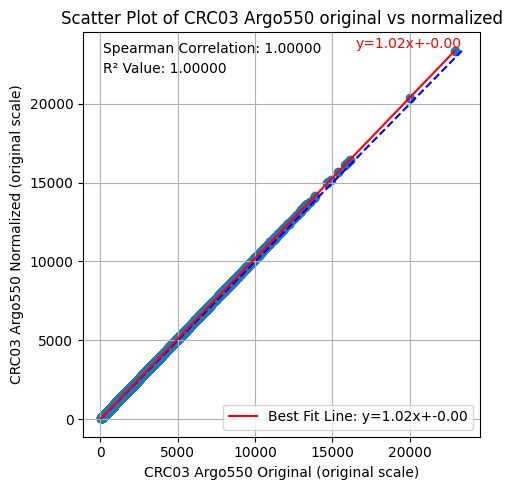

Currently processing Argo550 Original......


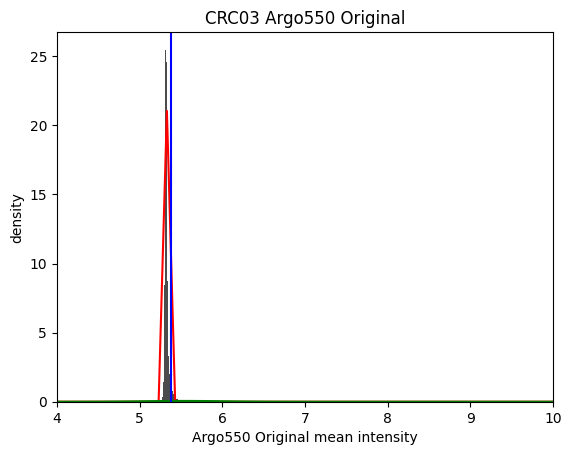

Positive population threshold is: [216.67619048]
Proportion of positive population >= [216.67619048]: 6.361881913305526%
Number of positive population >= [216.67619048]: 91115
Currently processing Argo550 Normalized......


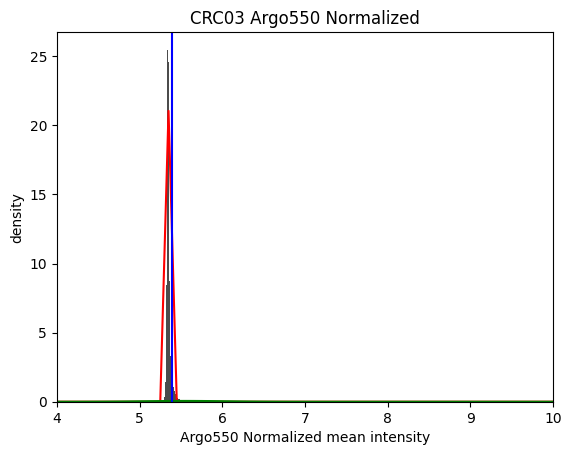

Positive population threshold is: [220.99628669]
Proportion of elements >= [220.99628669]: 6.361881913305526%
Number of elements >= [220.99628669]: 91115
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 1.0136120914686744


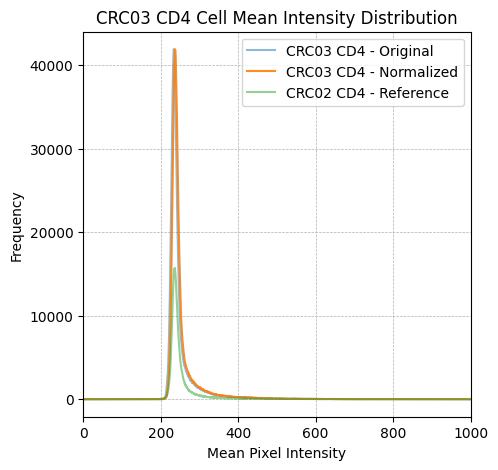

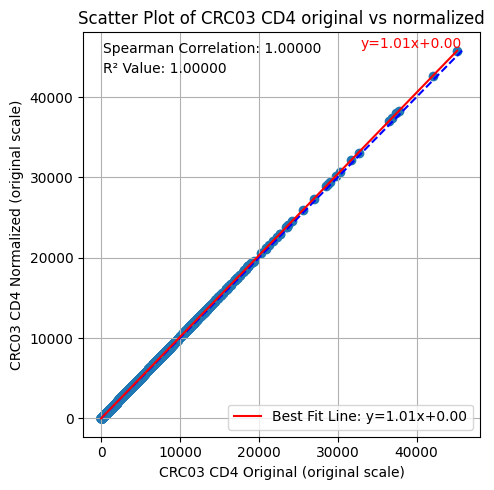

Currently processing CD4 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


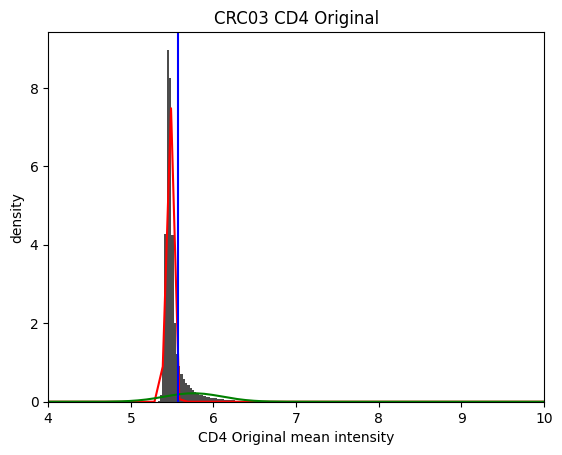

Positive population threshold is: [263.24390244]
Proportion of positive population >= [263.24390244]: 16.453335493177637%
Number of positive population >= [263.24390244]: 235645
Currently processing CD4 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


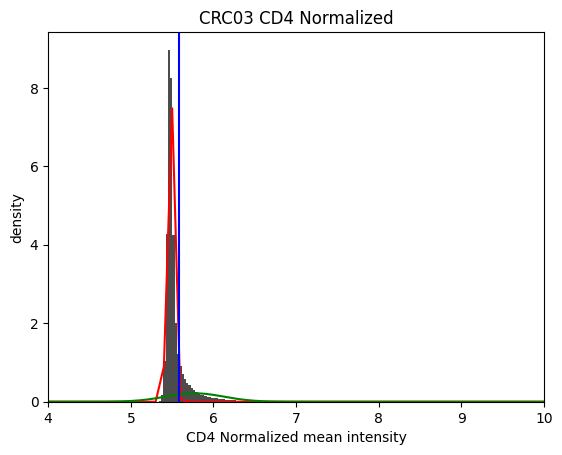

Positive population threshold is: [266.82720252]
Proportion of elements >= [266.82720252]: 16.453335493177637%
Number of elements >= [266.82720252]: 235645
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0136644155042476


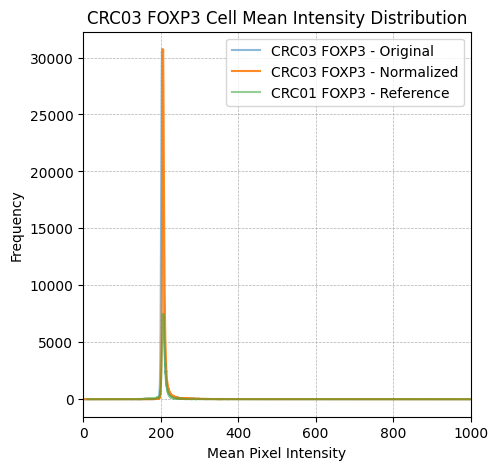

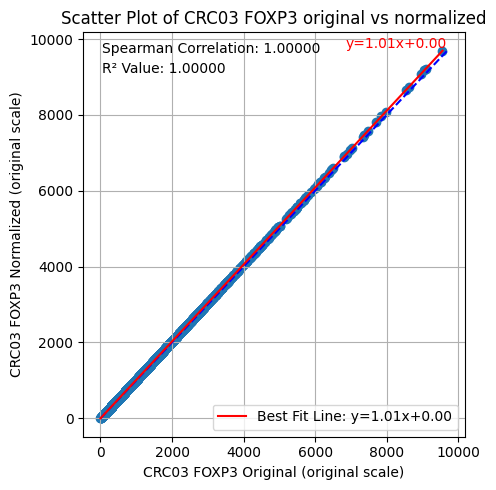

Currently processing FOXP3 Original......


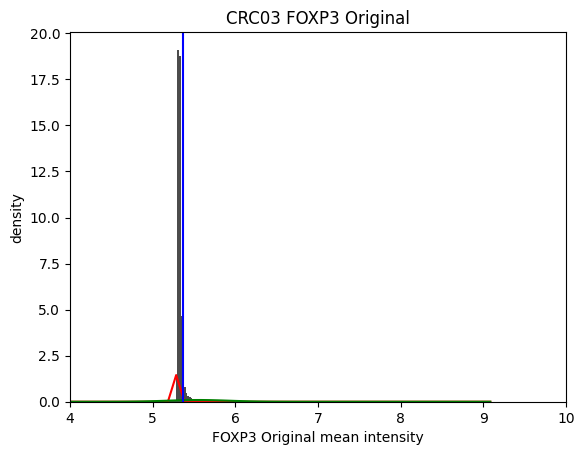

Positive population threshold is: [215.35353535]
Proportion of positive population >= [215.35353535]: 7.603466550109552%
Number of positive population >= [215.35353535]: 108897
Currently processing FOXP3 Normalized......


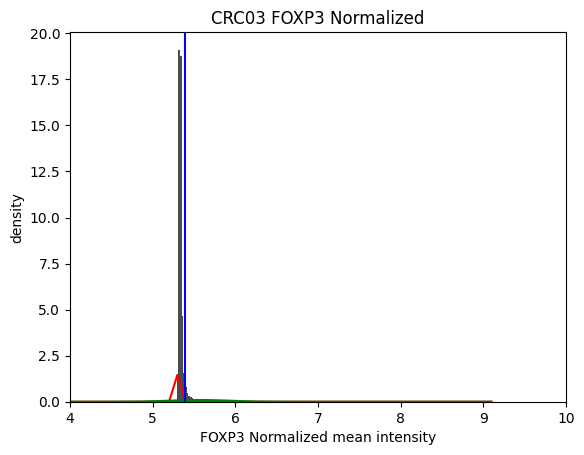

Positive population threshold is: [218.29621554]
Proportion of elements >= [218.29621554]: 7.603536372662516%
Number of elements >= [218.29621554]: 108898
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 0.9703364734093509


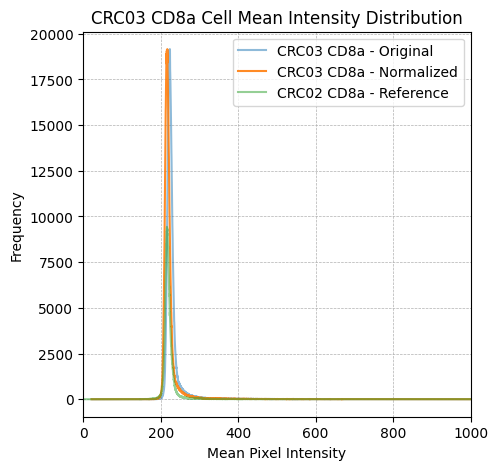

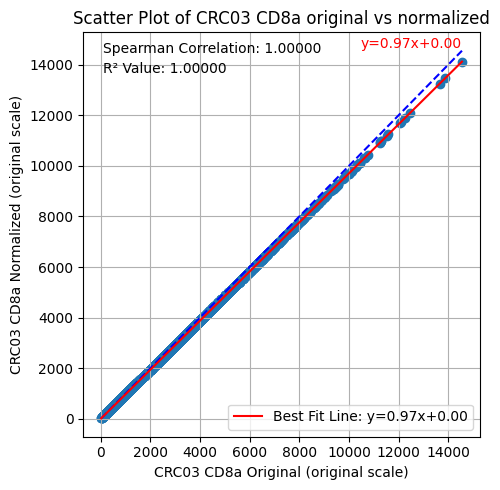

Currently processing CD8a Original......


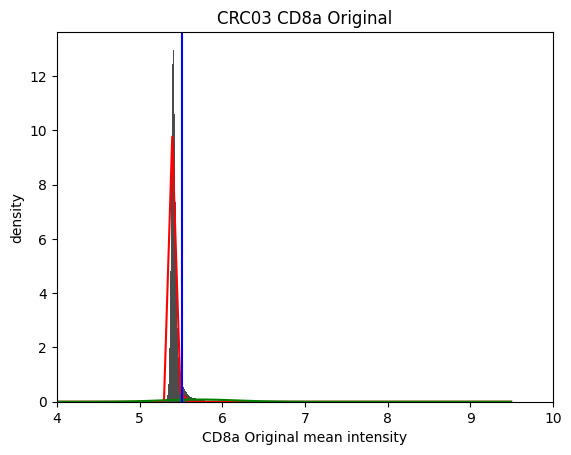

Positive population threshold is: [247.51685393]
Proportion of positive population >= [247.51685393]: 7.637260665744078%
Number of positive population >= [247.51685393]: 109381
Currently processing CD8a Normalized......


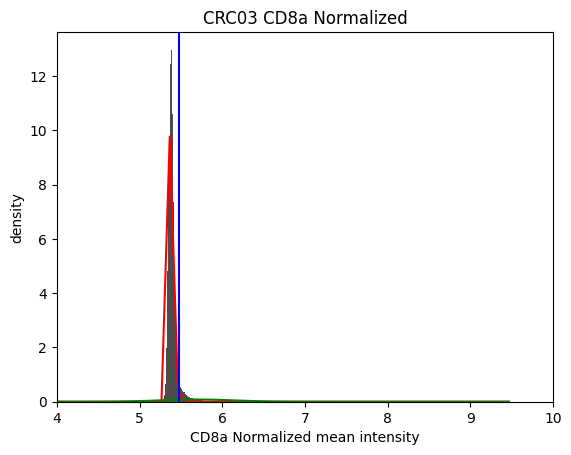

Positive population threshold is: [240.17463115]
Proportion of elements >= [240.17463115]: 7.637260665744078%
Number of elements >= [240.17463115]: 109381
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 1.0215608769911557


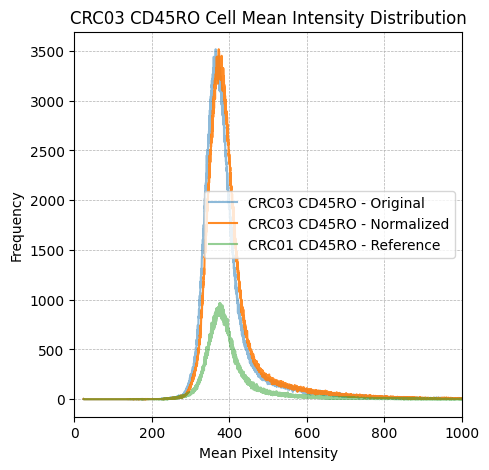

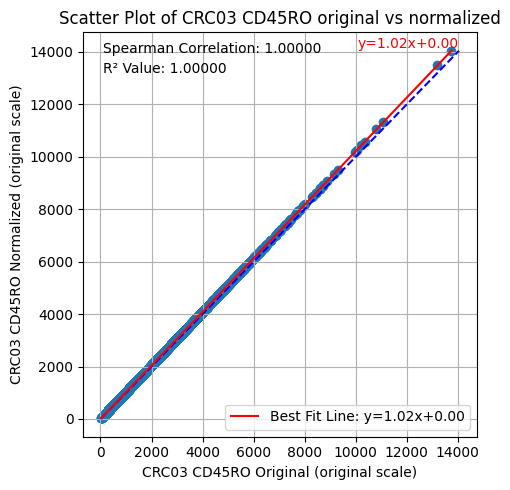

Currently processing CD45RO Original......


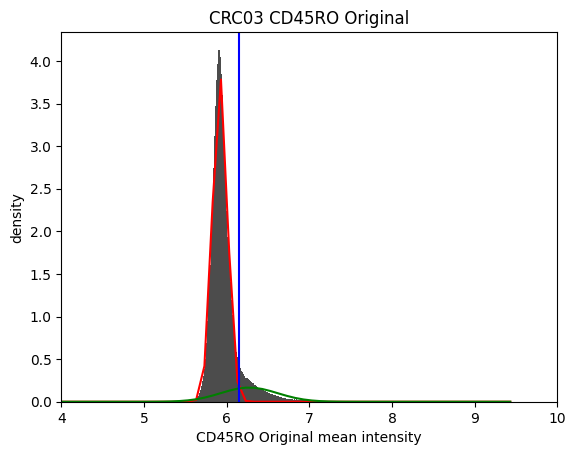

Positive population threshold is: [467.15]
Proportion of positive population >= [467.15]: 10.649684890818474%
Number of positive population >= [467.15]: 152525
Currently processing CD45RO Normalized......


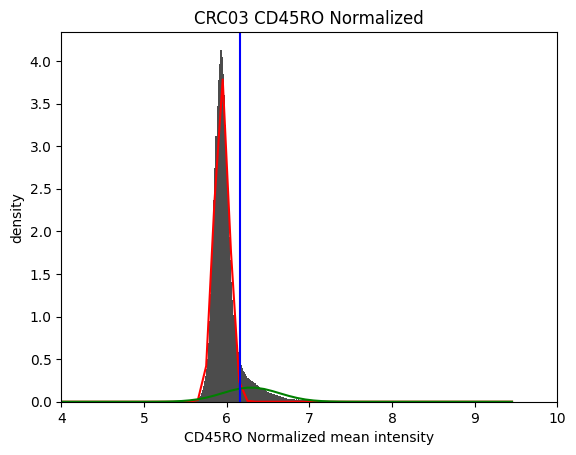

Positive population threshold is: [477.22216369]
Proportion of elements >= [477.22216369]: 10.649684890818474%
Number of elements >= [477.22216369]: 152525
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 0.9895254533665644


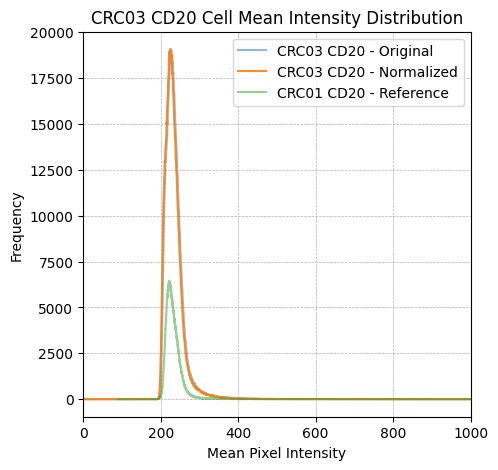

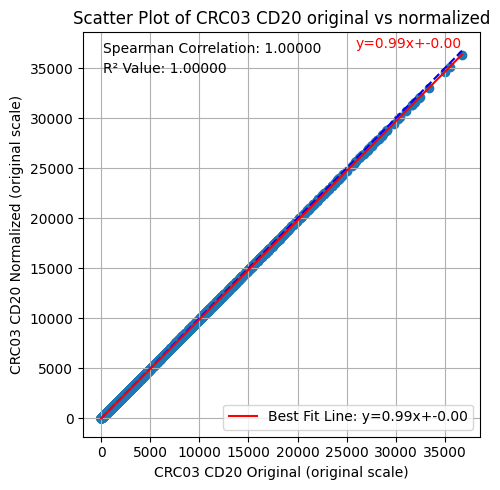

Currently processing CD20 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


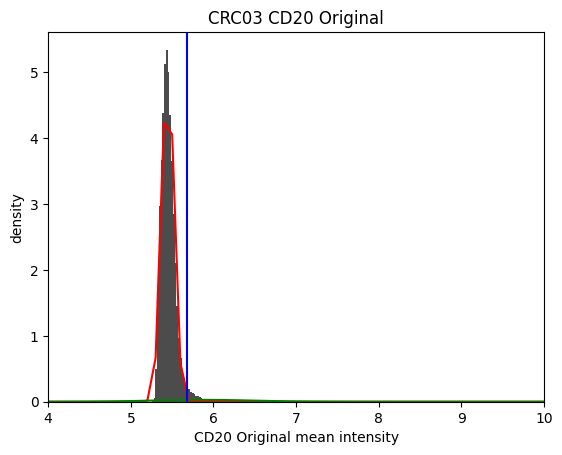

Positive population threshold is: [294.05702648]
Proportion of positive population >= [294.05702648]: 3.278099039102026%
Number of positive population >= [294.05702648]: 46949
Currently processing CD20 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


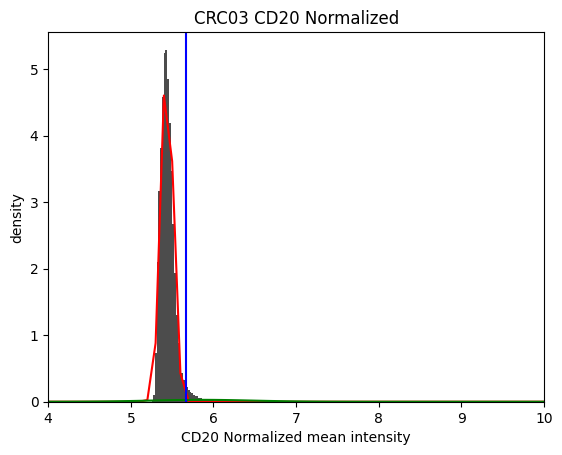

Positive population threshold is: [290.97182659]
Proportion of elements >= [290.97182659]: 3.2784481518668454%
Number of elements >= [290.97182659]: 46954
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 1.0


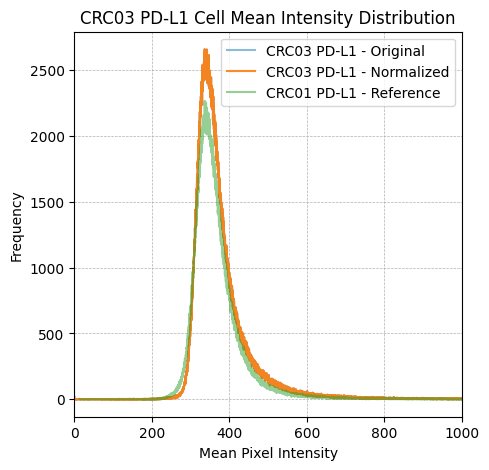

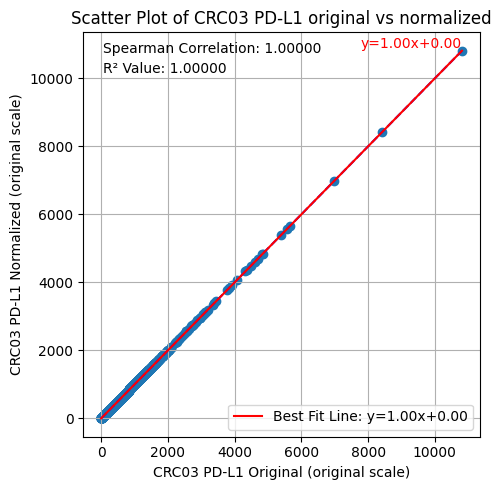

Currently processing PD-L1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


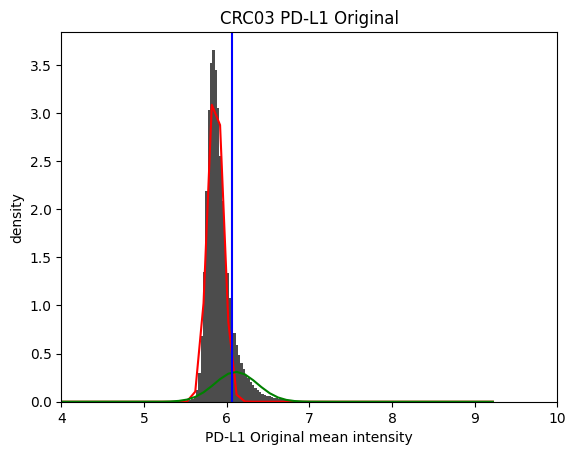

Positive population threshold is: [431.86]
Proportion of positive population >= [431.86]: 13.523511348259534%
Number of positive population >= [431.86]: 193684
Currently processing PD-L1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


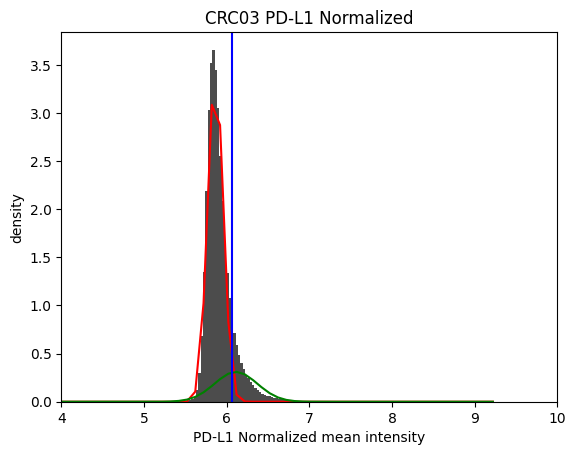

Positive population threshold is: [431.86]
Proportion of elements >= [431.86]: 13.523511348259534%
Number of elements >= [431.86]: 193684
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 0.9376239293862265


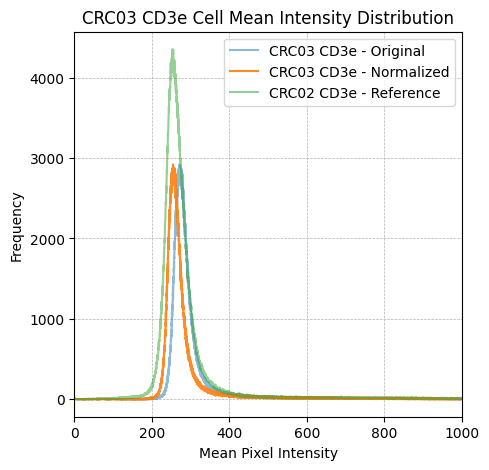

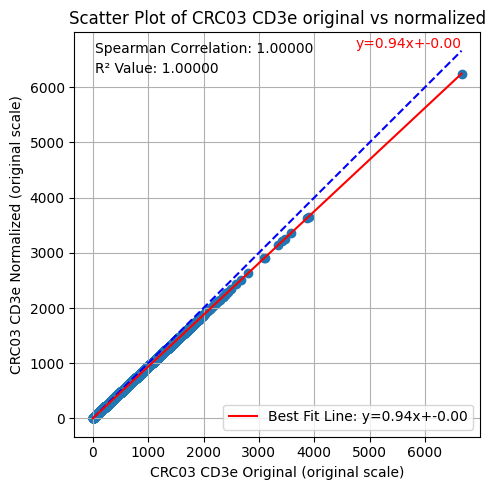

Currently processing CD3e Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


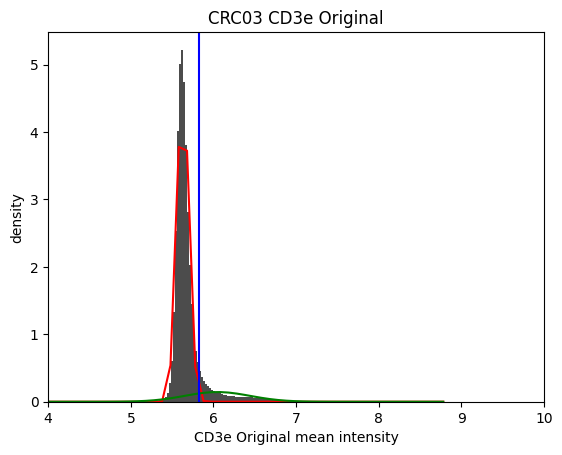

Positive population threshold is: [337.80379747]
Proportion of positive population >= [337.80379747]: 11.381355423327157%
Number of positive population >= [337.80379747]: 163004
Currently processing CD3e Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


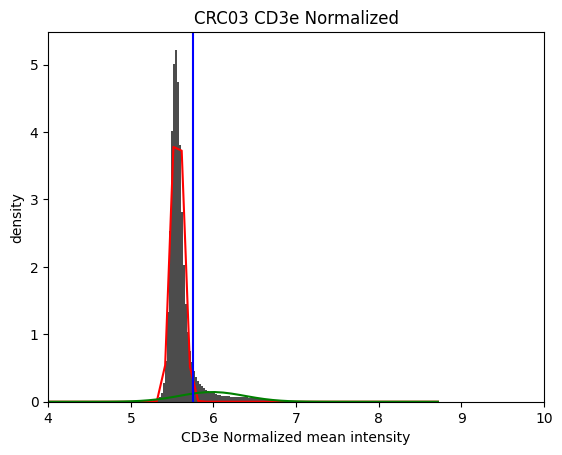

Positive population threshold is: [316.73154387]
Proportion of elements >= [316.73154387]: 11.381704536091975%
Number of elements >= [316.73154387]: 163009
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 0.964941578761398


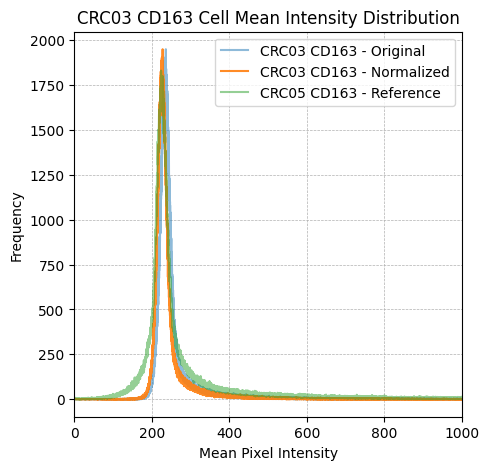

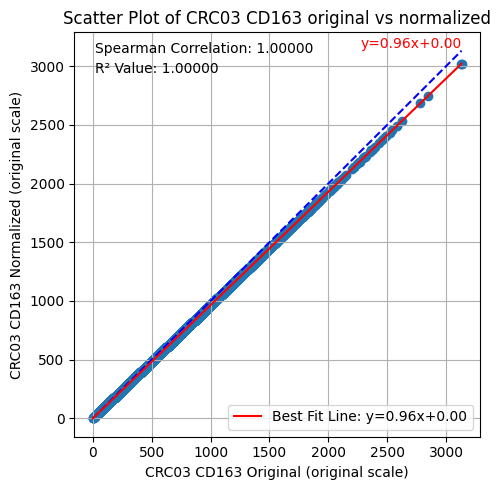

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


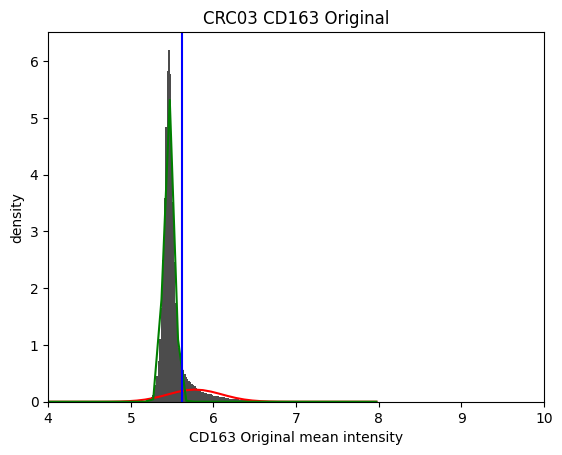

Positive population threshold is: [275.94642857]
Proportion of positive population >= [275.94642857]: 13.376883987035349%
Number of positive population >= [275.94642857]: 191584
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


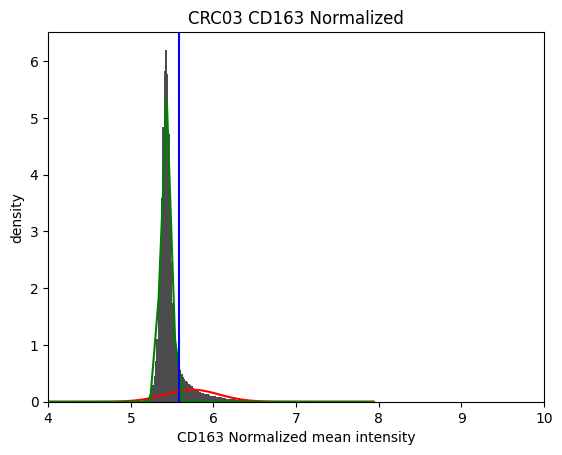

Positive population threshold is: [266.27218244]
Proportion of elements >= [266.27218244]: 13.376883987035349%
Number of elements >= [266.27218244]: 191584
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 0.9736555196857377


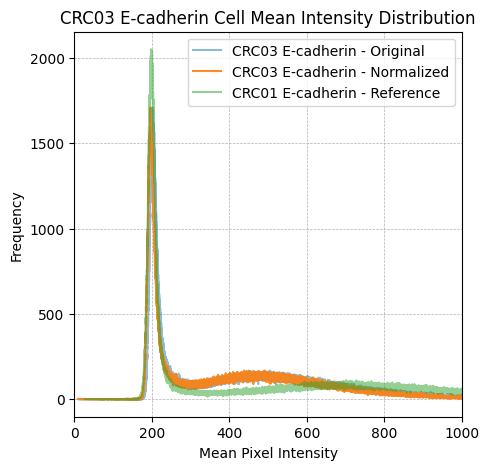

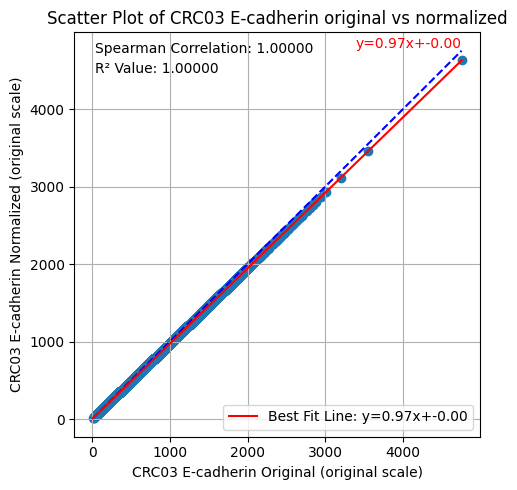

Currently processing E-cadherin Original......


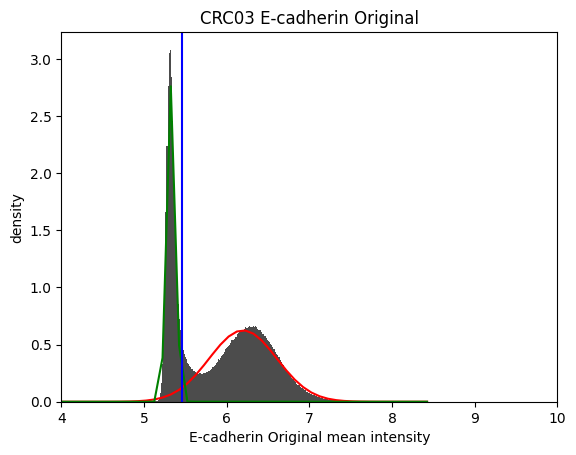

Positive population threshold is: [234.73770492]
Proportion of positive population >= [234.73770492]: 62.26886989405126%
Number of positive population >= [234.73770492]: 891816
Currently processing E-cadherin Normalized......


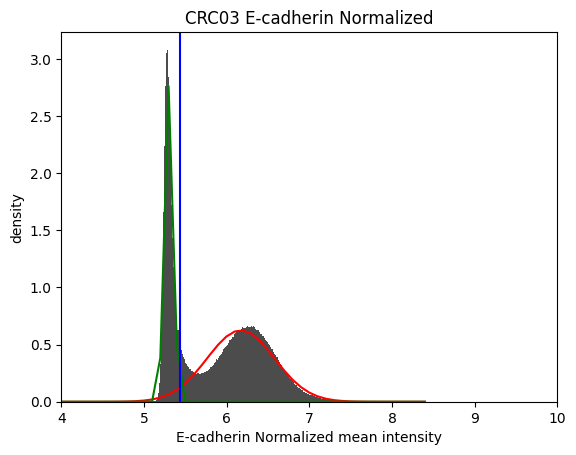

Positive population threshold is: [228.55366207]
Proportion of elements >= [228.55366207]: 62.26886989405126%
Number of elements >= [228.55366207]: 891816
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.0473676642219012


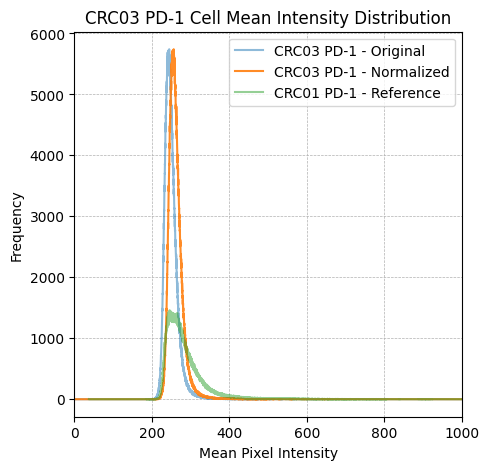

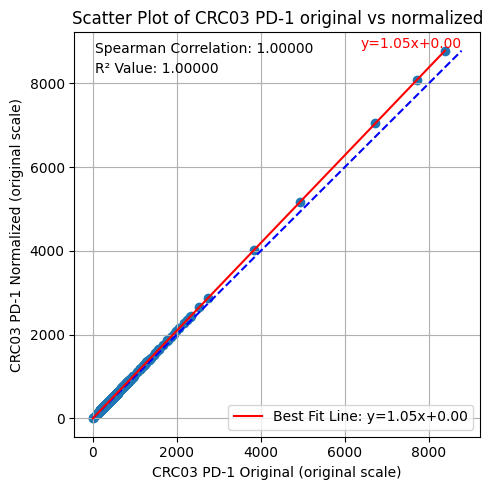

Currently processing PD-1 Original......


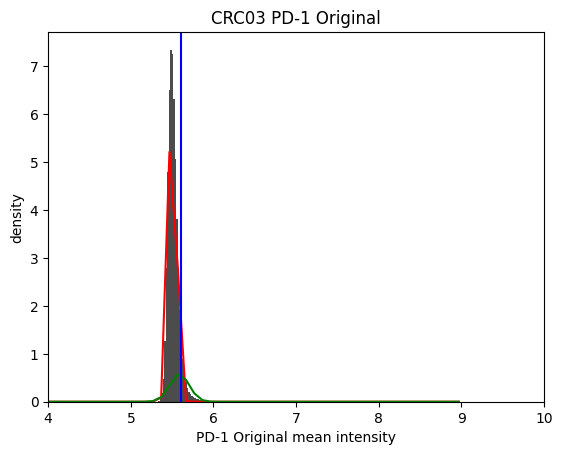

Positive population threshold is: [272.66129032]
Proportion of positive population >= [272.66129032]: 7.980578158667562%
Number of positive population >= [272.66129032]: 114298
Currently processing PD-1 Normalized......


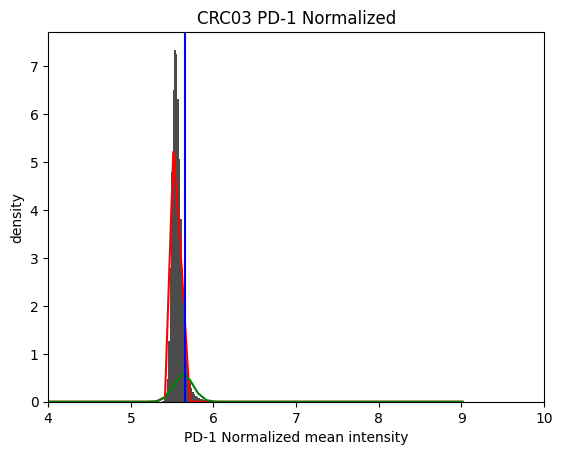

Positive population threshold is: [285.57661877]
Proportion of elements >= [285.57661877]: 7.980578158667562%
Number of elements >= [285.57661877]: 114298
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 0.9456052297163445


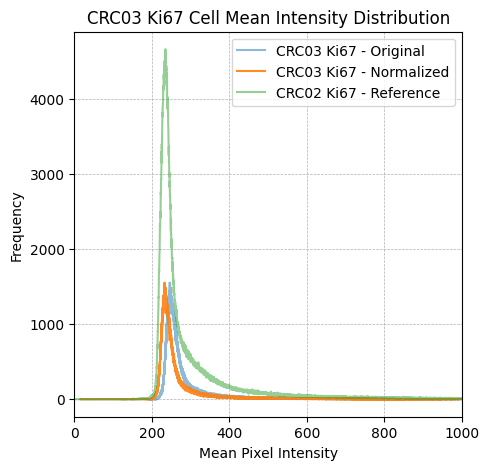

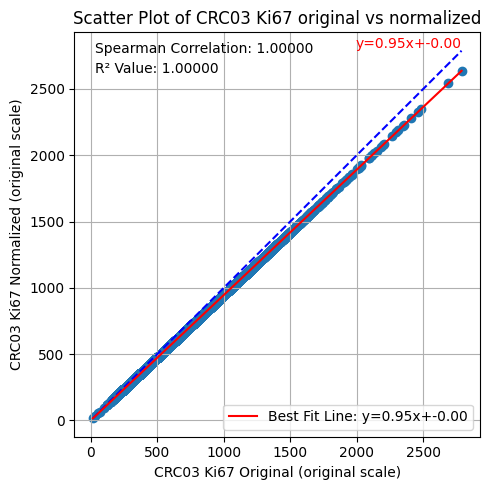

Currently processing Ki67 Original......


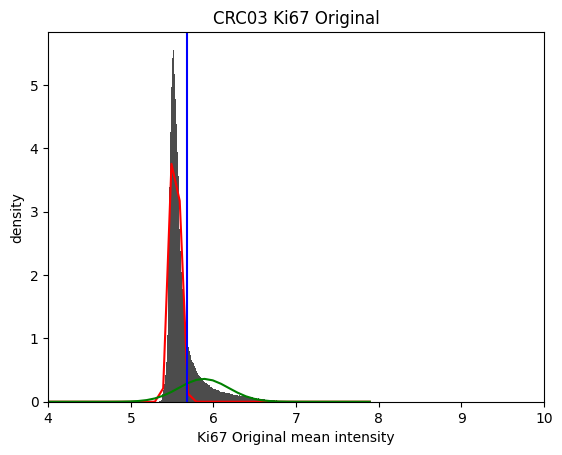

Positive population threshold is: [291.08]
Proportion of positive population >= [291.08]: 22.389090365744497%
Number of positive population >= [291.08]: 320657
Currently processing Ki67 Normalized......


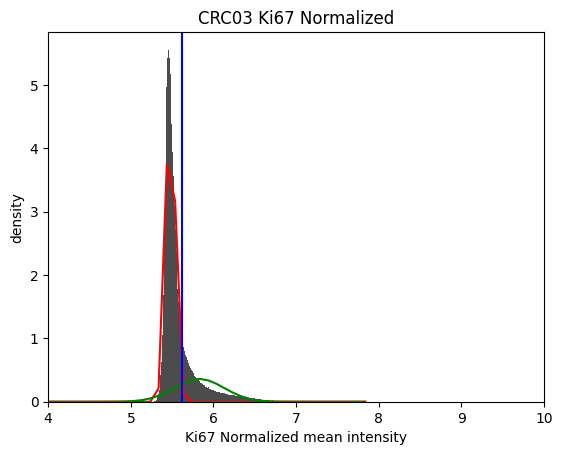

Positive population threshold is: [275.24677027]
Proportion of elements >= [275.24677027]: 22.38916018829746%
Number of elements >= [275.24677027]: 320658
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 0.9713469659992335


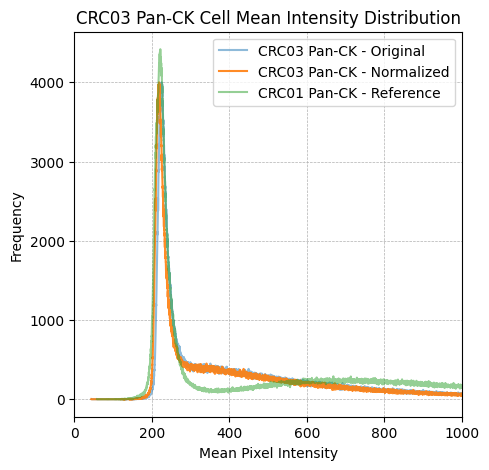

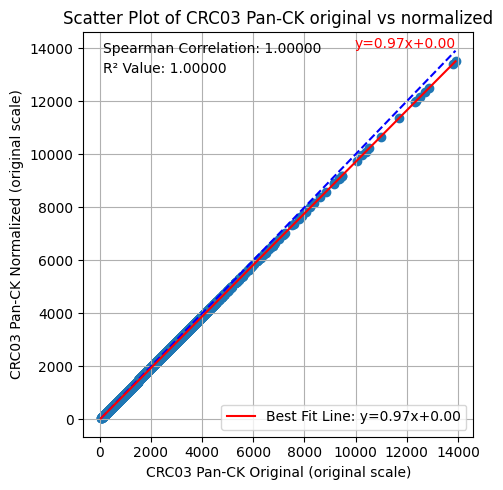

Currently processing Pan-CK Original......


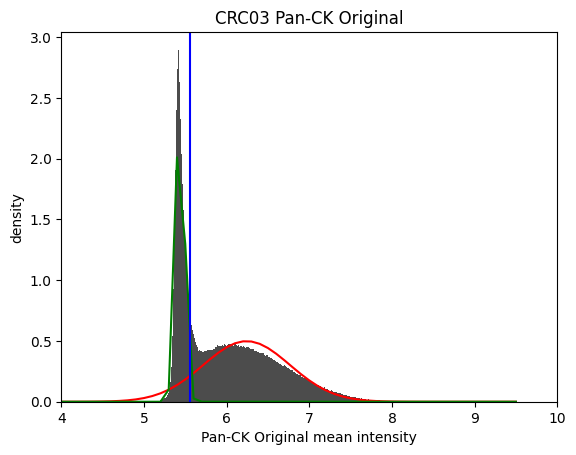

Positive population threshold is: [259.15873016]
Proportion of positive population >= [259.15873016]: 61.81223039766736%
Number of positive population >= [259.15873016]: 885276
Currently processing Pan-CK Normalized......


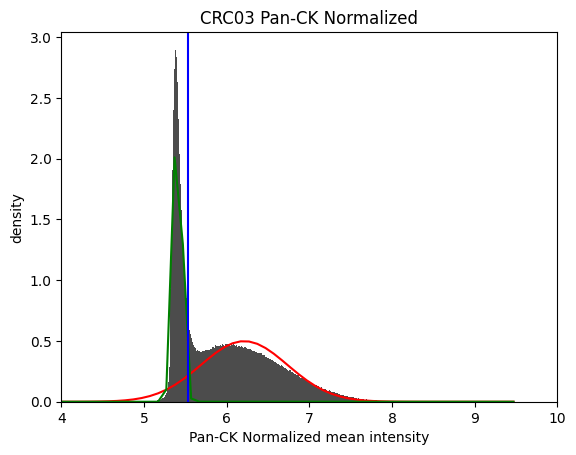

Positive population threshold is: [251.73304625]
Proportion of elements >= [251.73304625]: 61.81223039766736%
Number of elements >= [251.73304625]: 885276
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 0.9476601760207355


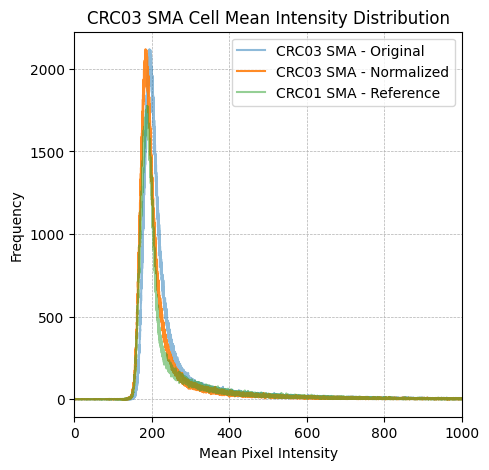

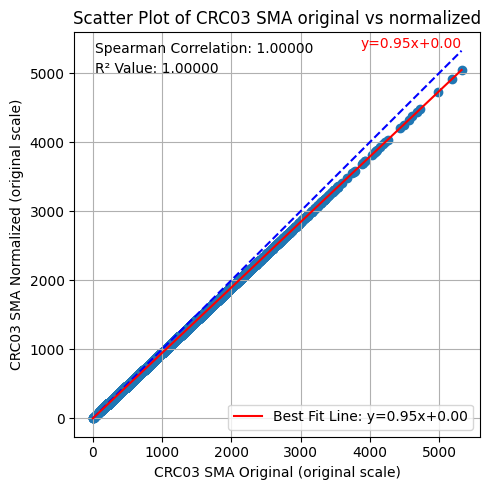

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


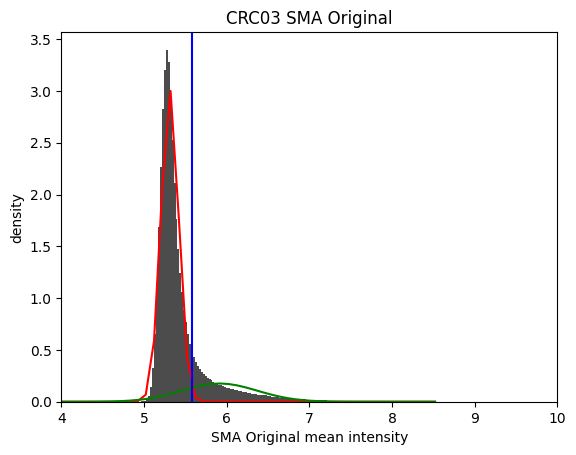

Positive population threshold is: [264.24637681]
Proportion of positive population >= [264.24637681]: 17.32863101713306%
Number of positive population >= [264.24637681]: 248181
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


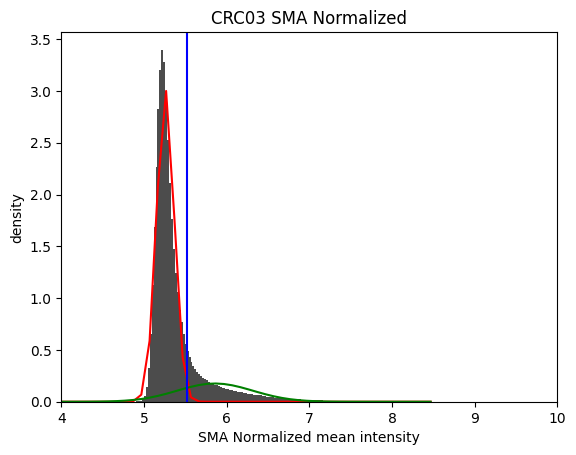

Positive population threshold is: [250.41576796]
Proportion of elements >= [250.41576796]: 17.328770662238984%
Number of elements >= [250.41576796]: 248183
******************************  Processing CRC04 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.2366311302795965


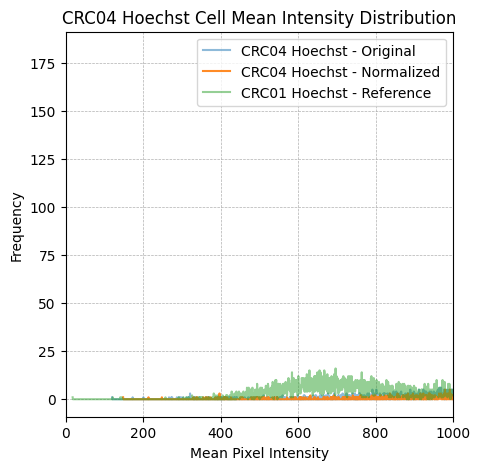

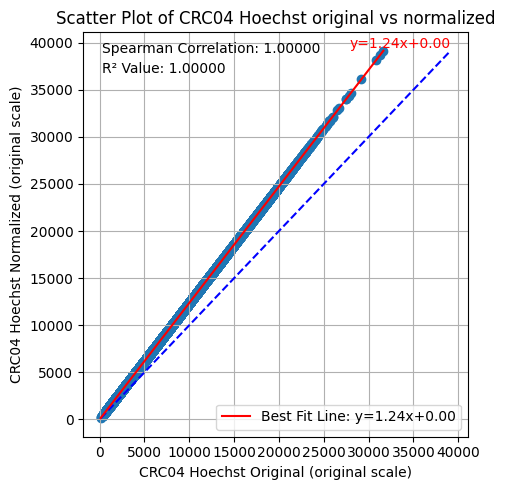

Currently processing Hoechst Original......


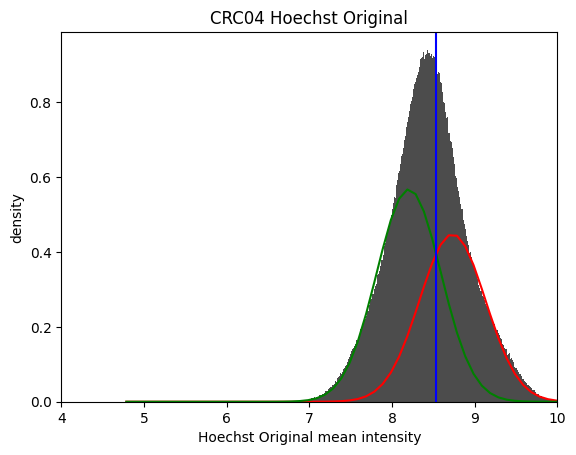

Positive population threshold is: [5085.9]
Proportion of positive population >= [5085.9]: 40.87740513358251%
Number of positive population >= [5085.9]: 580070
Currently processing Hoechst Normalized......


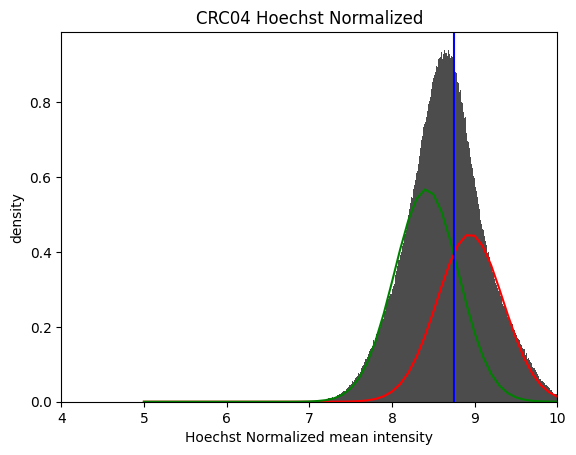

Positive population threshold is: [6289.38226549]
Proportion of elements >= [6289.38226549]: 40.87733466380277%
Number of elements >= [6289.38226549]: 580069
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.150711155208103


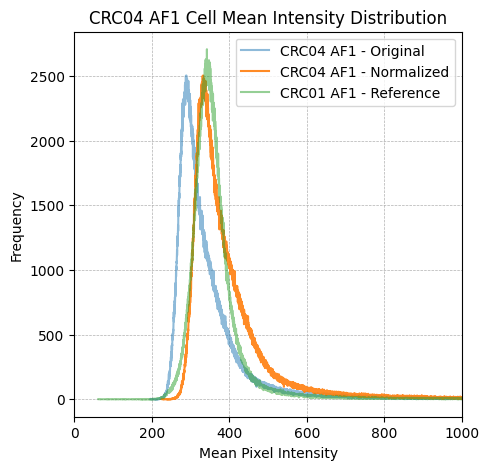

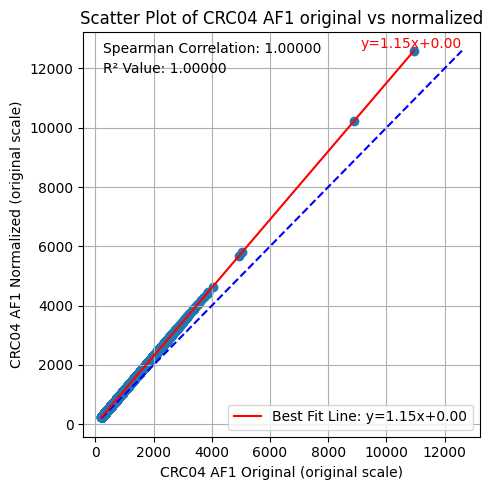

Currently processing AF1 Original......


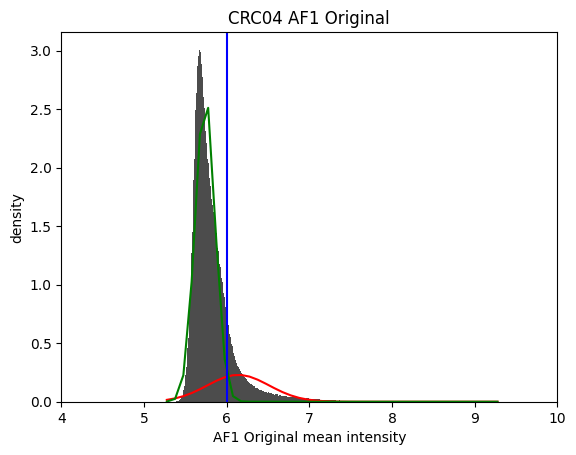

Positive population threshold is: [405.93854749]
Proportion of positive population >= [405.93854749]: 14.929516126304396%
Number of positive population >= [405.93854749]: 211857
Currently processing AF1 Normalized......


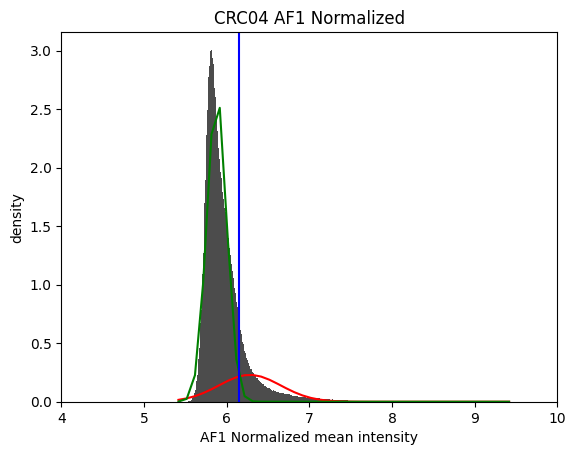

Positive population threshold is: [467.11801492]
Proportion of elements >= [467.11801492]: 14.929445656524656%
Number of elements >= [467.11801492]: 211856
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 0.9687510541344918


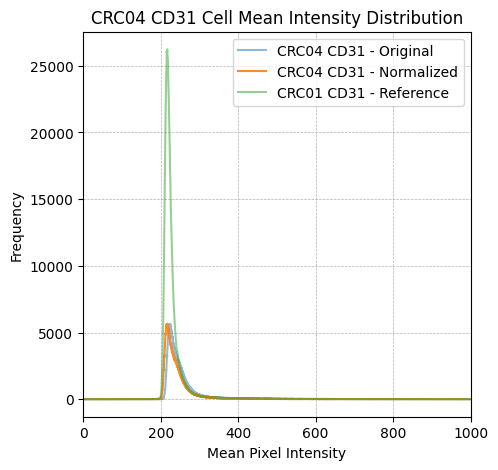

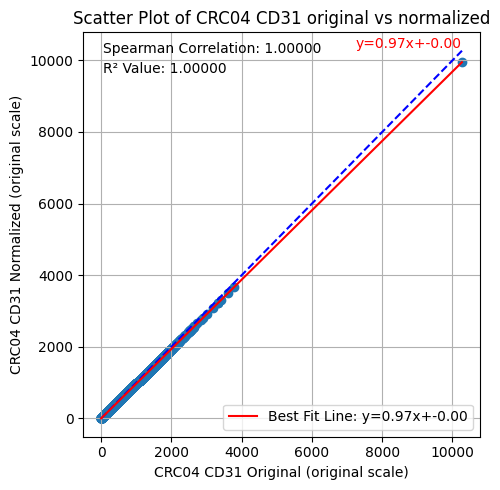

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


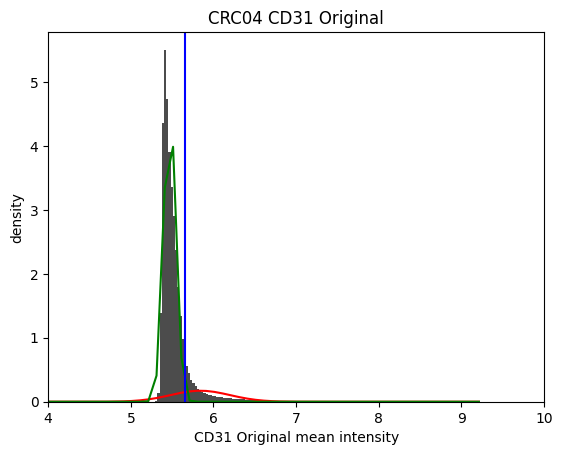

Positive population threshold is: [286.7443609]
Proportion of positive population >= [286.7443609]: 11.800376026744692%
Number of positive population >= [286.7443609]: 167453
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


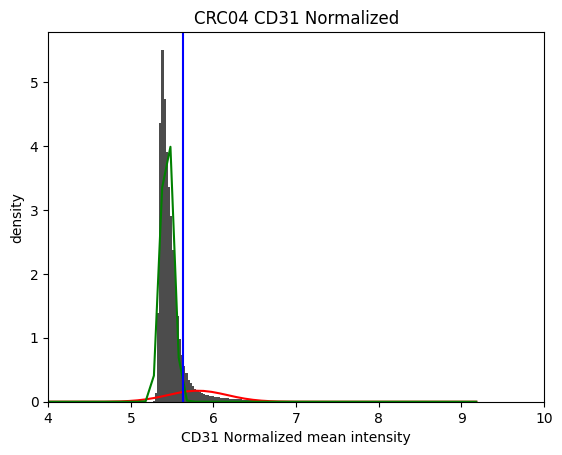

Positive population threshold is: [277.78155226]
Proportion of elements >= [277.78155226]: 11.801080724542087%
Number of elements >= [277.78155226]: 167463
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 0.8834574983304437


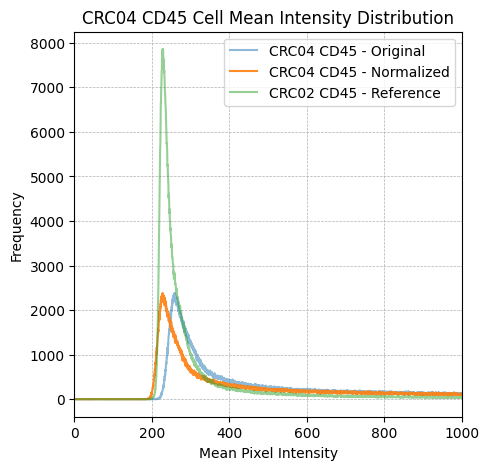

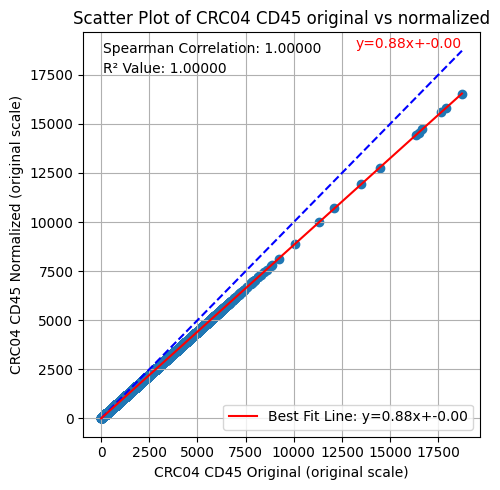

Currently processing CD45 Original......


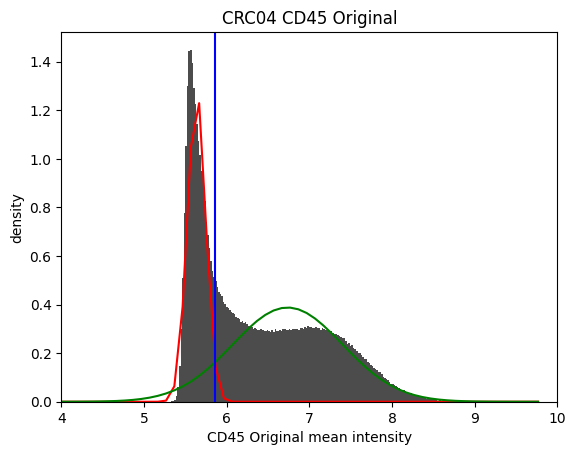

Positive population threshold is: [350.75]
Proportion of positive population >= [350.75]: 61.030564152868685%
Number of positive population >= [350.75]: 866053
Currently processing CD45 Normalized......


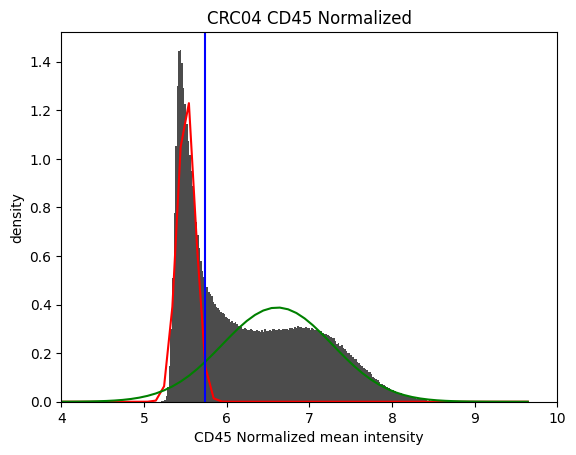

Positive population threshold is: [309.87271754]
Proportion of elements >= [309.87271754]: 61.030564152868685%
Number of elements >= [309.87271754]: 866053
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 0.9565406094439304


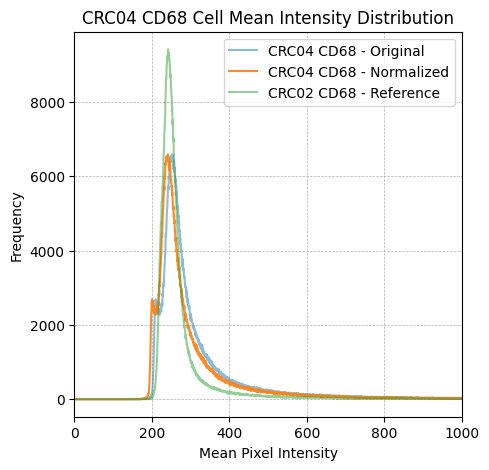

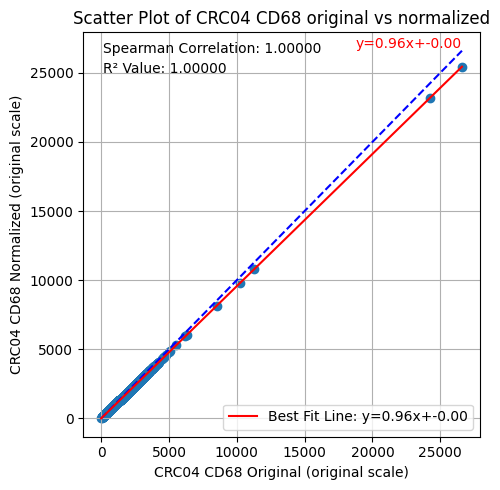

Currently processing CD68 Original......


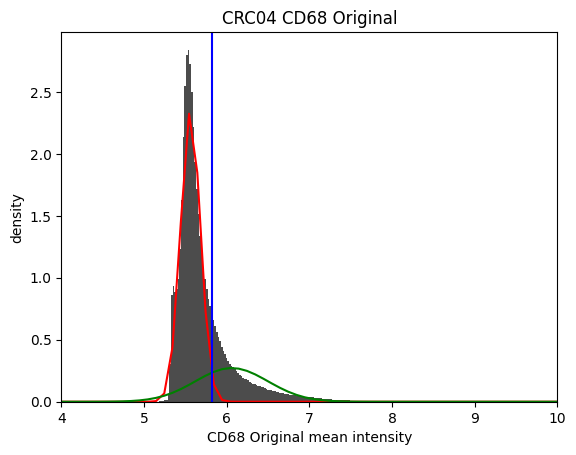

Positive population threshold is: [336.58426966]
Proportion of positive population >= [336.58426966]: 23.255661542104285%
Number of positive population >= [336.58426966]: 330009
Currently processing CD68 Normalized......


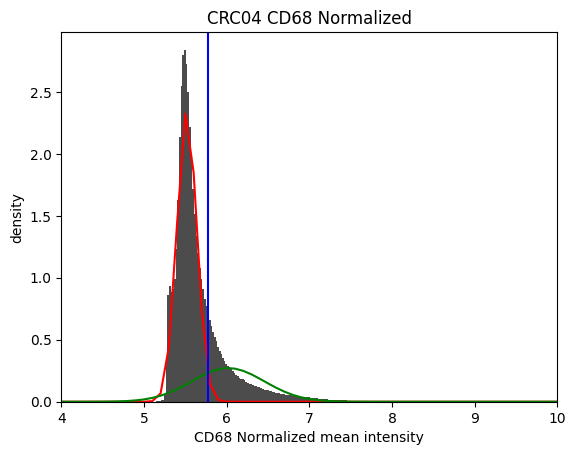

Positive population threshold is: [321.95652243]
Proportion of elements >= [321.95652243]: 23.255661542104285%
Number of elements >= [321.95652243]: 330009
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.009919813258728


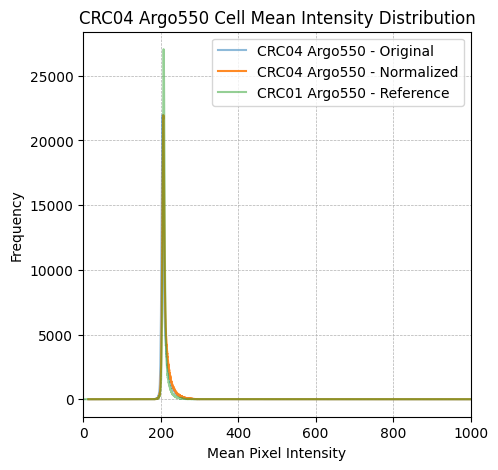

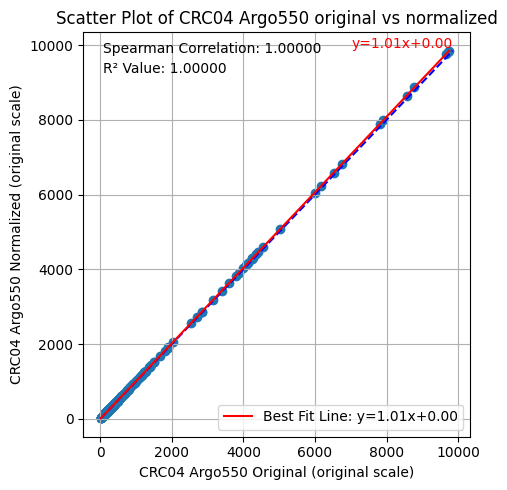

Currently processing Argo550 Original......


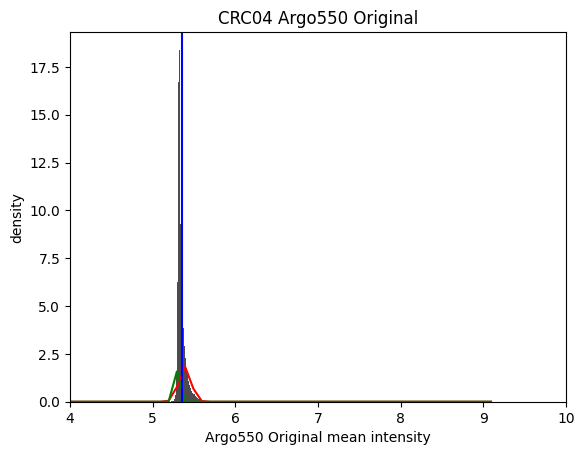

Positive population threshold is: [212.13114754]
Proportion of positive population >= [212.13114754]: 25.417533444957463%
Number of positive population >= [212.13114754]: 360687
Currently processing Argo550 Normalized......


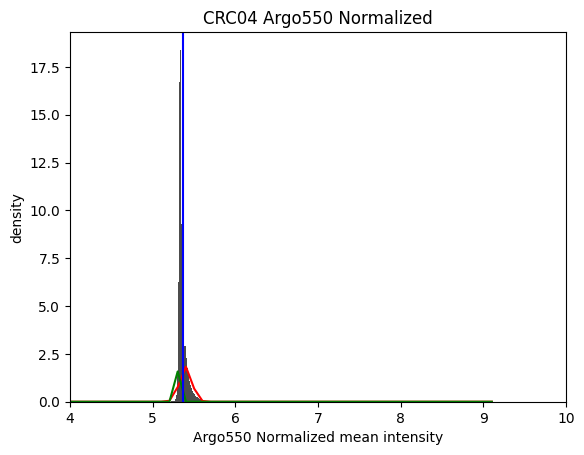

Positive population threshold is: [214.23544891]
Proportion of elements >= [214.23544891]: 25.417533444957463%
Number of elements >= [214.23544891]: 360687
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 0.9865707092651675


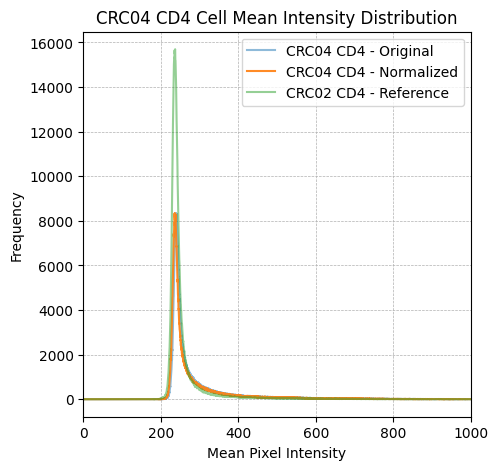

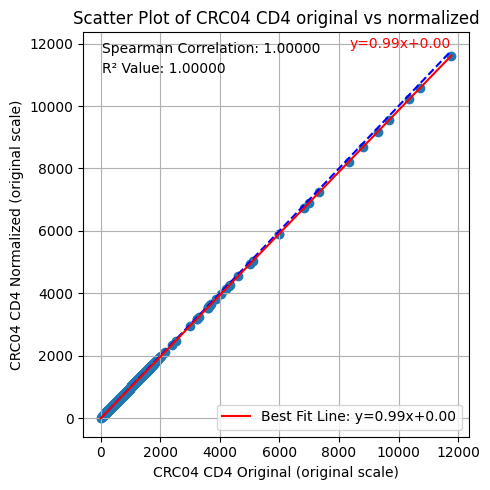

Currently processing CD4 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


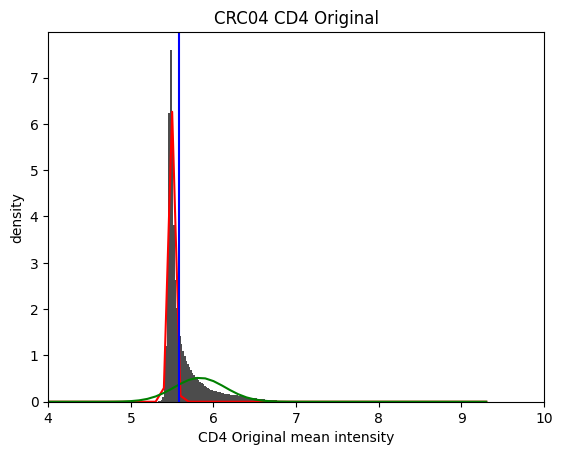

Positive population threshold is: [266.27631579]
Proportion of positive population >= [266.27631579]: 34.99402416267808%
Number of positive population >= [266.27631579]: 496582
Currently processing CD4 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


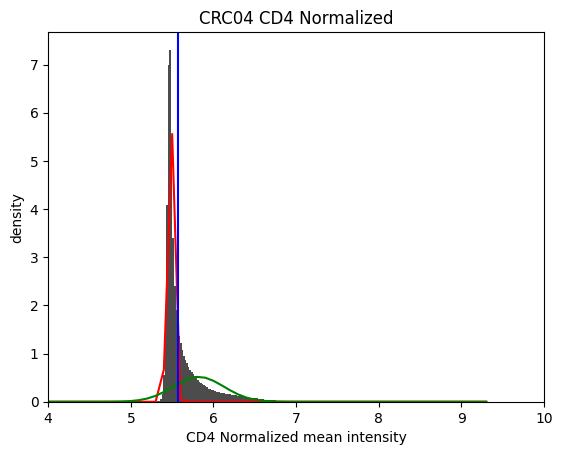

Positive population threshold is: [262.6999661]
Proportion of elements >= [262.6999661]: 34.99458792091599%
Number of elements >= [262.6999661]: 496590
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0136644155042476


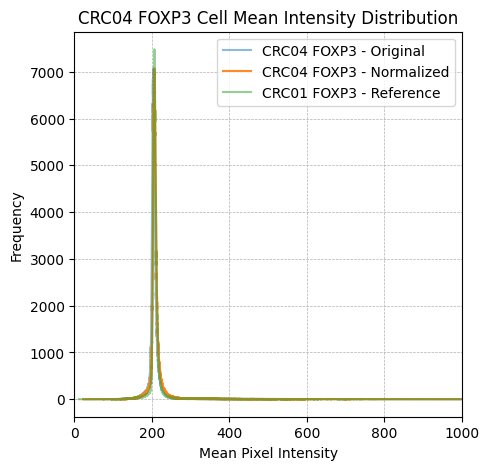

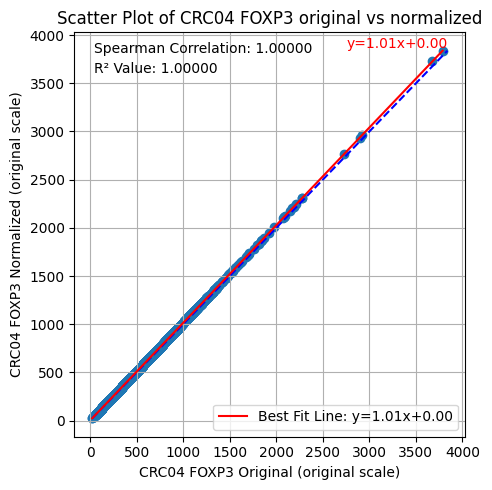

Currently processing FOXP3 Original......


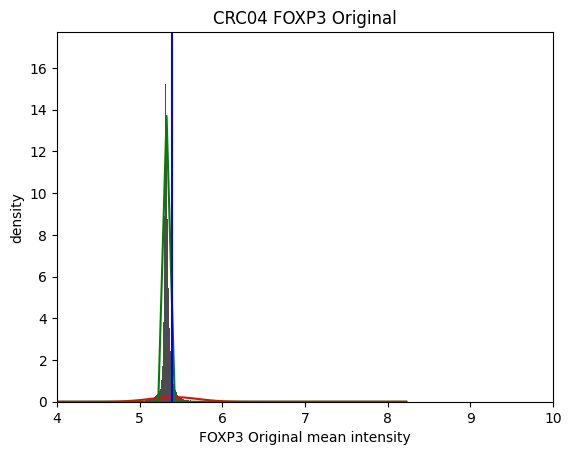

Positive population threshold is: [219.72131148]
Proportion of positive population >= [219.72131148]: 8.696534578111523%
Number of positive population >= [219.72131148]: 123408
Currently processing FOXP3 Normalized......


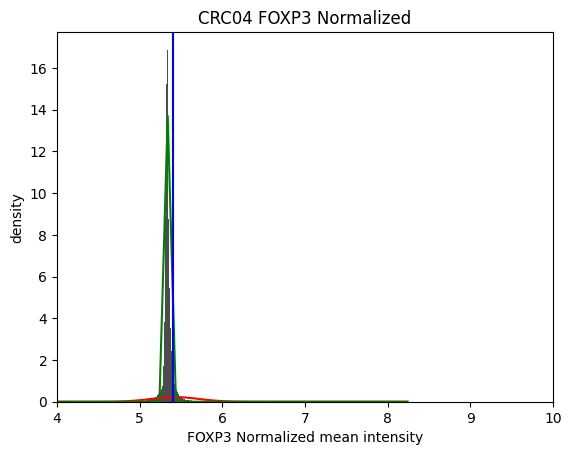

Positive population threshold is: [222.72367477]
Proportion of elements >= [222.72367477]: 8.696534578111523%
Number of elements >= [222.72367477]: 123408
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 0.9606454752187334


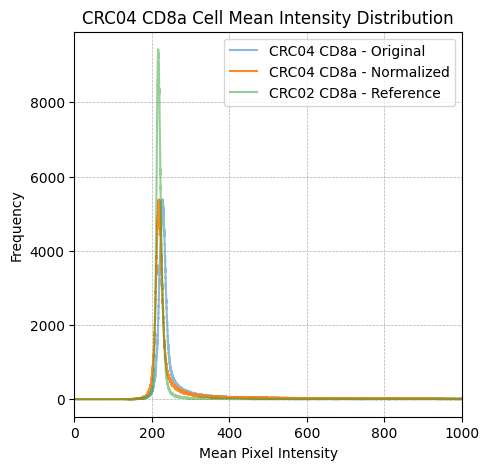

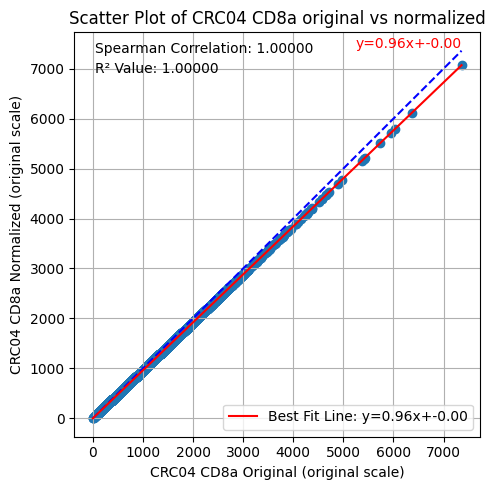

Currently processing CD8a Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


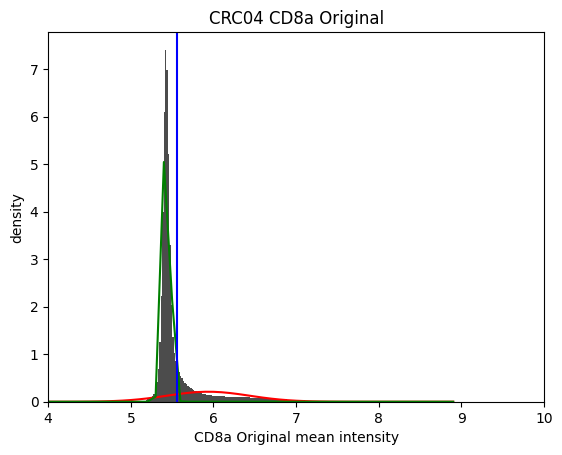

Positive population threshold is: [259.10416667]
Proportion of positive population >= [259.10416667]: 21.986994097451248%
Number of positive population >= [259.10416667]: 312006
Currently processing CD8a Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


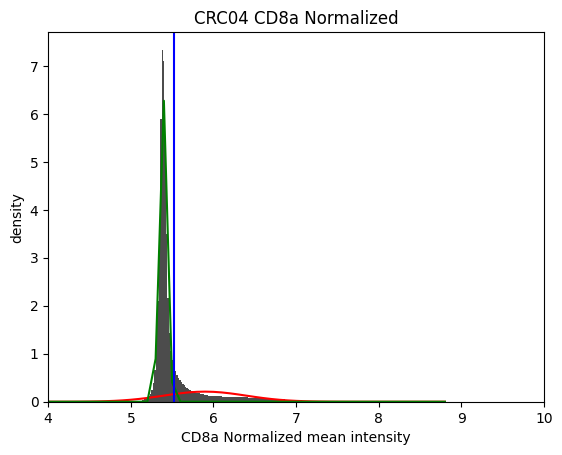

Positive population threshold is: [248.90724532]
Proportion of elements >= [248.90724532]: 21.986994097451248%
Number of elements >= [248.90724532]: 312006
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 0.8892965602529305


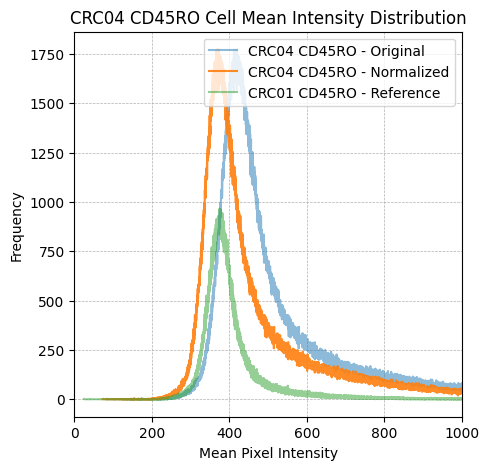

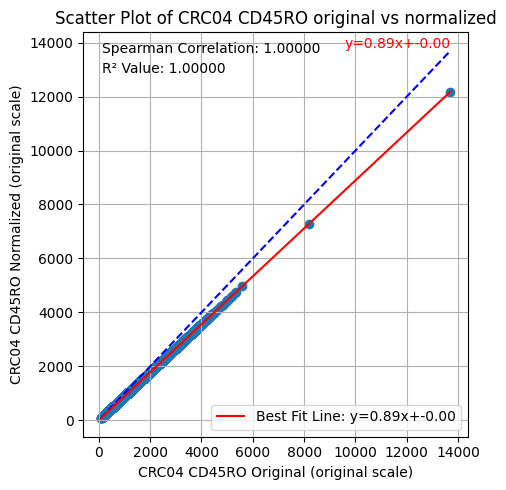

Currently processing CD45RO Original......


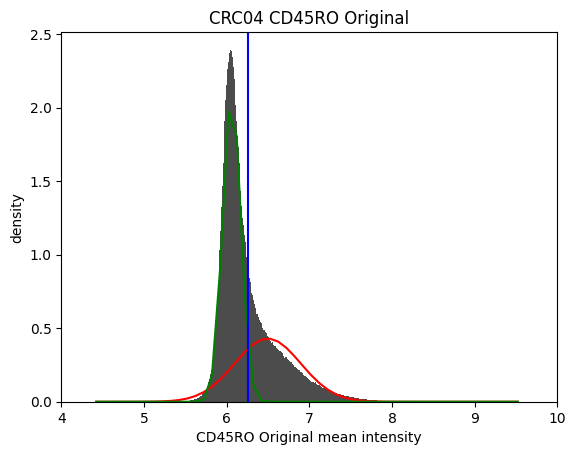

Positive population threshold is: [525.37762238]
Proportion of positive population >= [525.37762238]: 33.327272932275726%
Number of positive population >= [525.37762238]: 472930
Currently processing CD45RO Normalized......


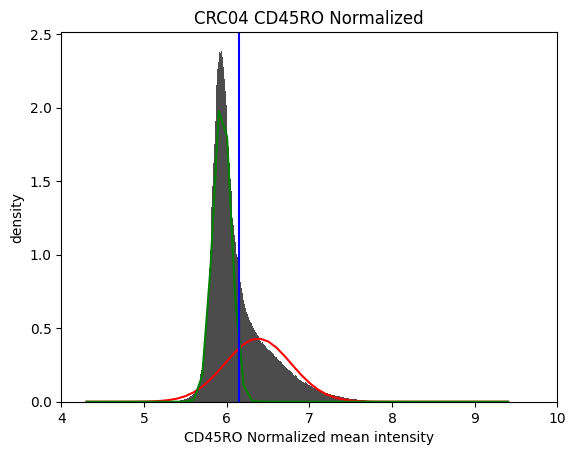

Positive population threshold is: [467.21651241]
Proportion of elements >= [467.21651241]: 33.327272932275726%
Number of elements >= [467.21651241]: 472930
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 1.0


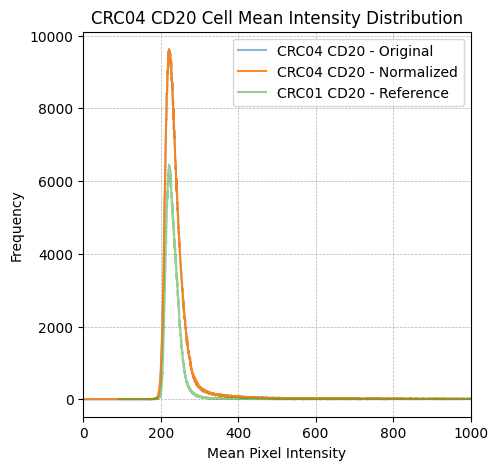

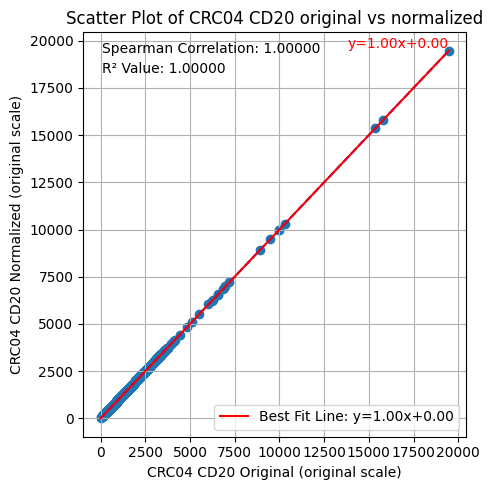

Currently processing CD20 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


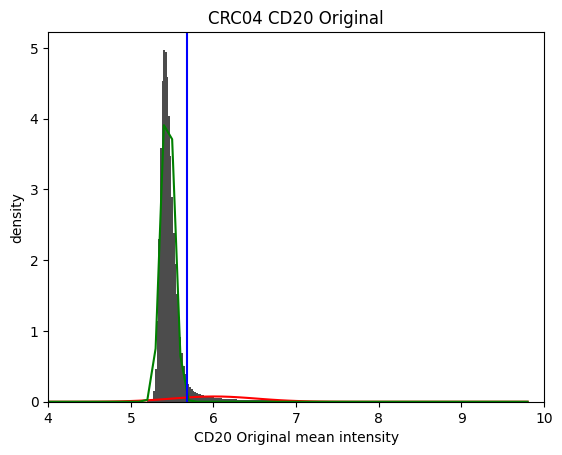

Positive population threshold is: [291.11214953]
Proportion of positive population >= [291.11214953]: 7.553867099632994%
Number of positive population >= [291.11214953]: 107193
Currently processing CD20 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


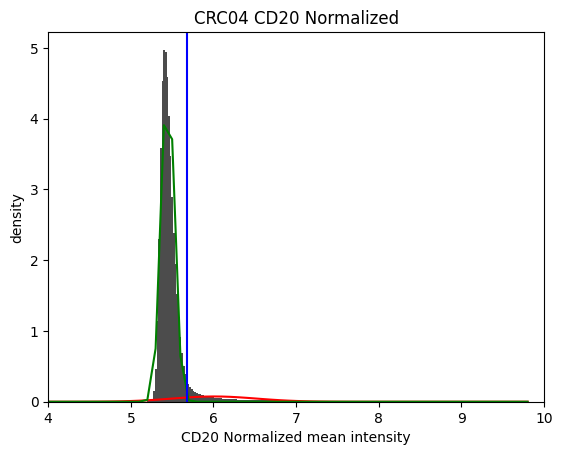

Positive population threshold is: [291.11214953]
Proportion of elements >= [291.11214953]: 7.553867099632994%
Number of elements >= [291.11214953]: 107193
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 0.9156790164524455


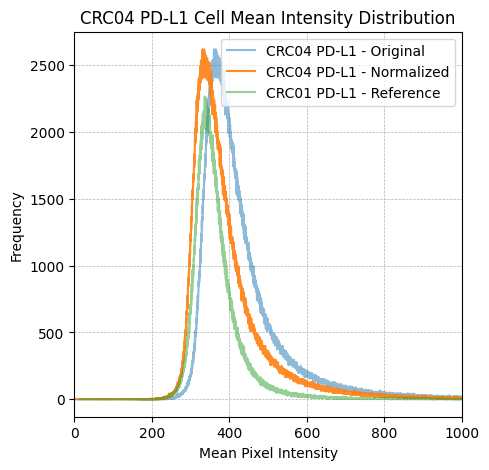

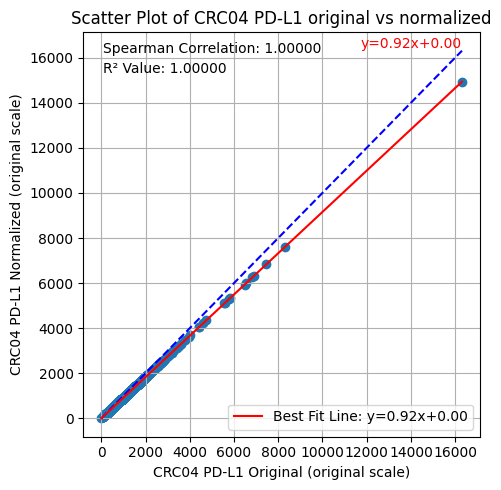

Currently processing PD-L1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


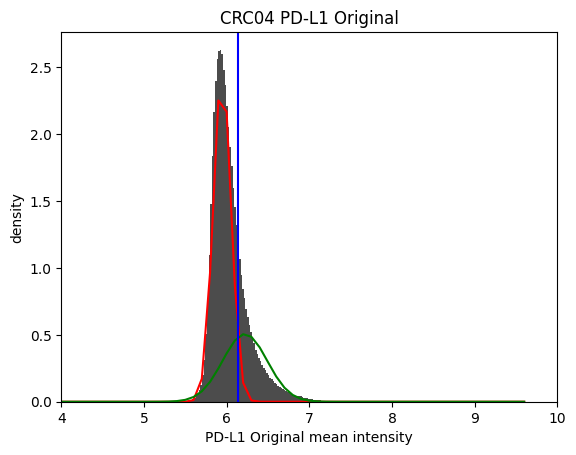

Positive population threshold is: [463.11320755]
Proportion of positive population >= [463.11320755]: 24.000315704613236%
Number of positive population >= [463.11320755]: 340576
Currently processing PD-L1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


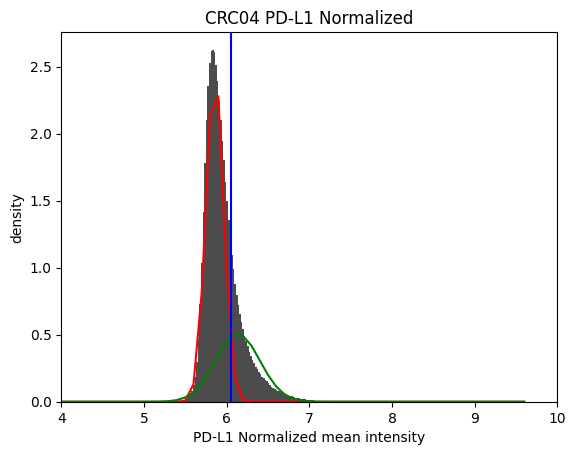

Positive population threshold is: [424.059733]
Proportion of elements >= [424.059733]: 24.00116134197011%
Number of elements >= [424.059733]: 340588
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 0.9137768591420276


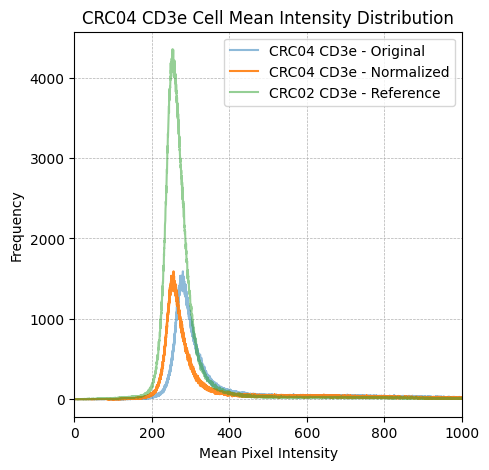

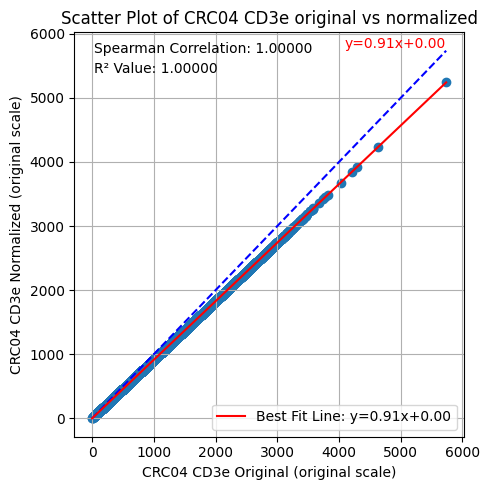

Currently processing CD3e Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


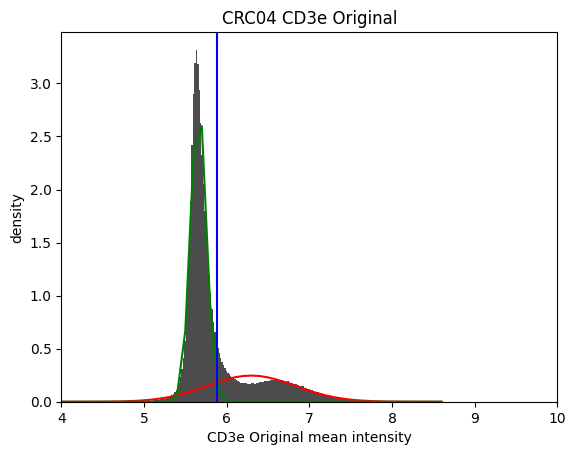

Positive population threshold is: [357.66233766]
Proportion of positive population >= [357.66233766]: 26.686835117628156%
Number of positive population >= [357.66233766]: 378699
Currently processing CD3e Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


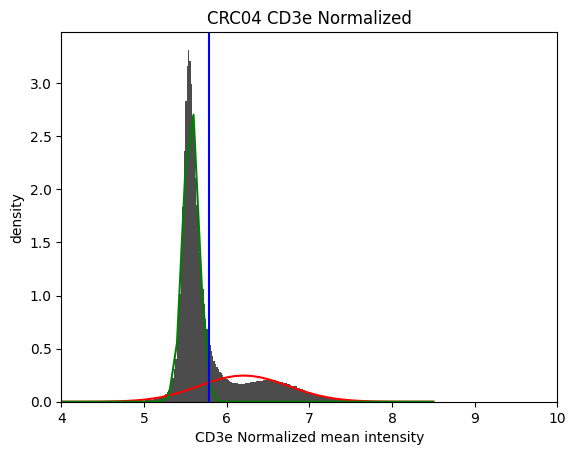

Positive population threshold is: [326.8231595]
Proportion of elements >= [326.8231595]: 26.686905587407892%
Number of elements >= [326.8231595]: 378700
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 0.9311122504225391


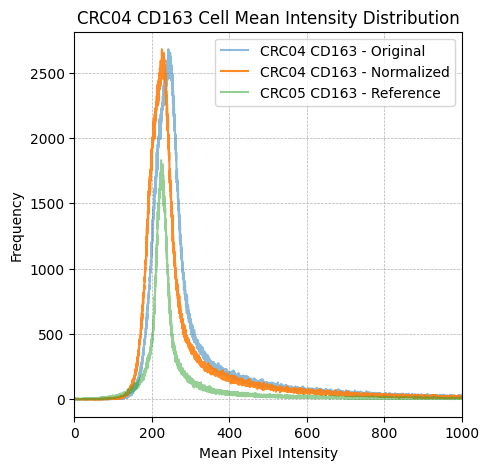

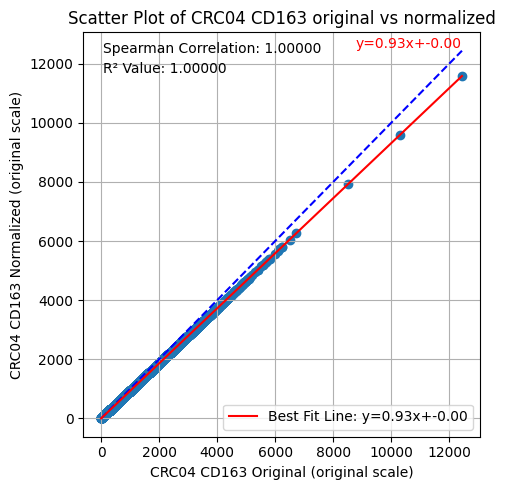

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


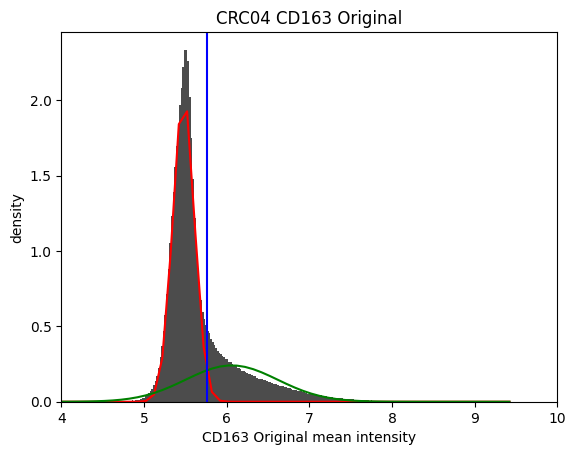

Positive population threshold is: [316.80869565]
Proportion of positive population >= [316.80869565]: 25.310983137991105%
Number of positive population >= [316.80869565]: 359175
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


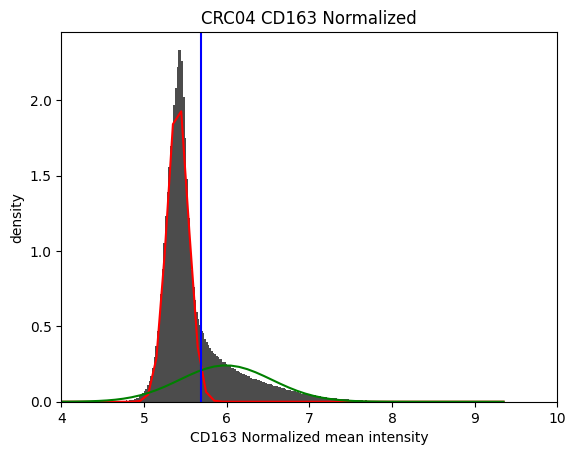

Positive population threshold is: [294.98191981]
Proportion of elements >= [294.98191981]: 25.311194547330324%
Number of elements >= [294.98191981]: 359178
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 1.0134383506524327


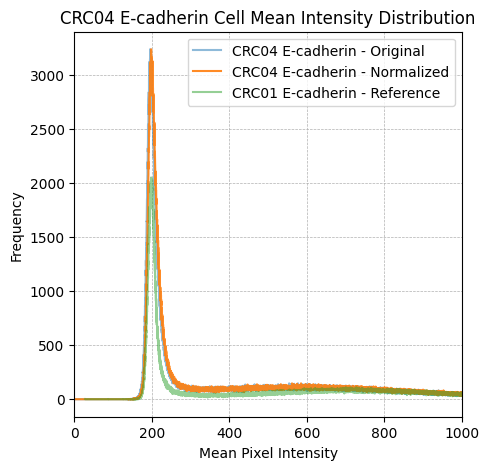

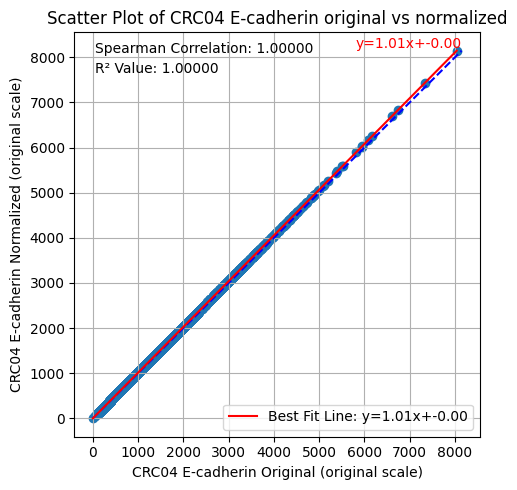

Currently processing E-cadherin Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


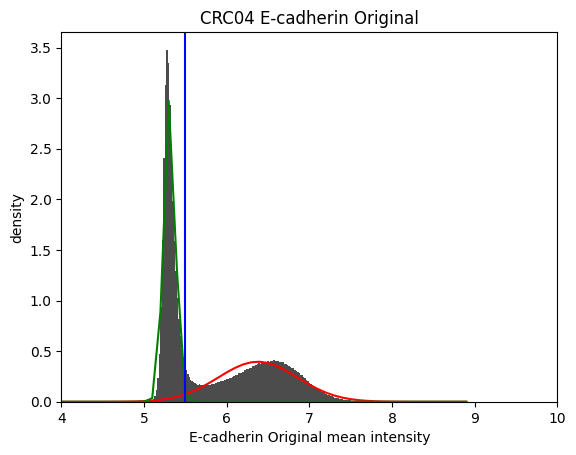

Positive population threshold is: [244.625]
Proportion of positive population >= [244.625]: 46.41203116455539%
Number of positive population >= [244.625]: 658609
Currently processing E-cadherin Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


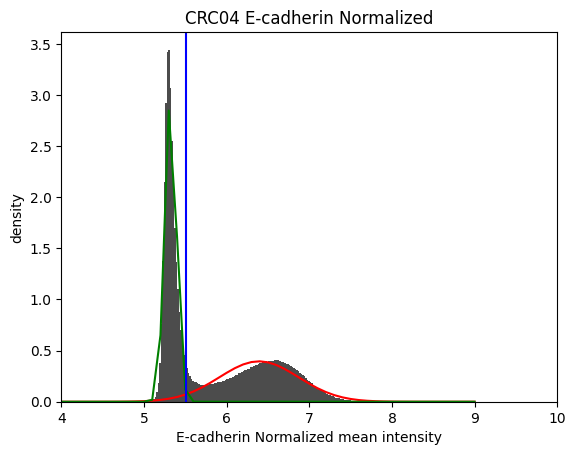

Positive population threshold is: [247.91235653]
Proportion of elements >= [247.91235653]: 46.41189022499591%
Number of elements >= [247.91235653]: 658607
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.0092989752881372


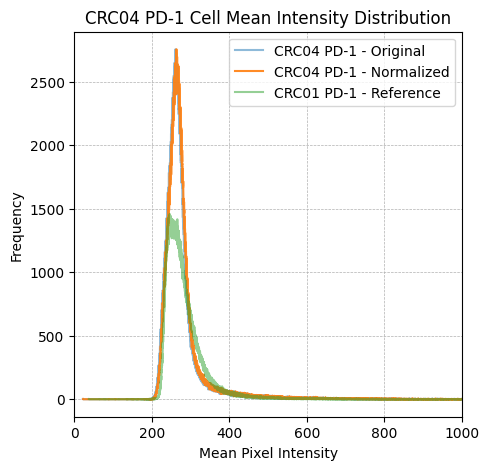

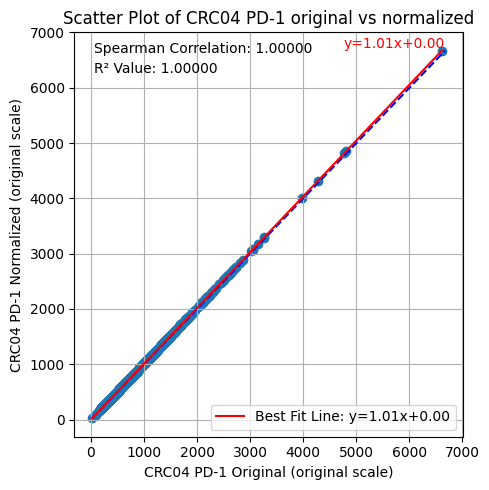

Currently processing PD-1 Original......


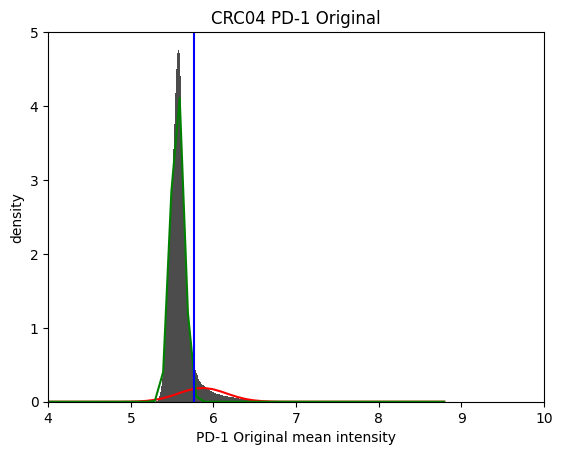

Positive population threshold is: [318.76851852]
Proportion of positive population >= [318.76851852]: 9.178618341310512%
Number of positive population >= [318.76851852]: 130249
Currently processing PD-1 Normalized......


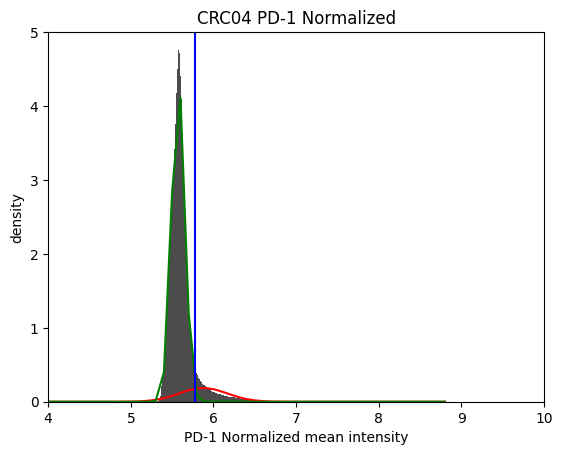

Positive population threshold is: [321.73273909]
Proportion of elements >= [321.73273909]: 9.178618341310512%
Number of elements >= [321.73273909]: 130249
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 0.9350866107934652


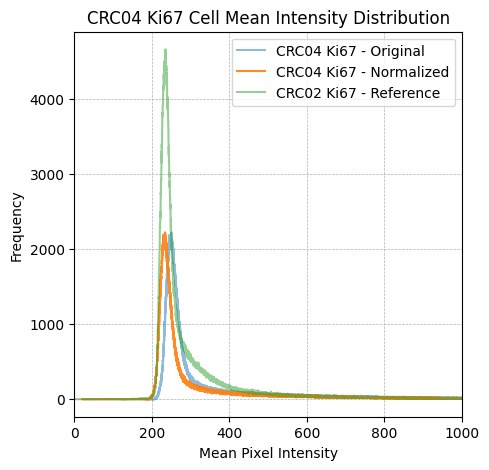

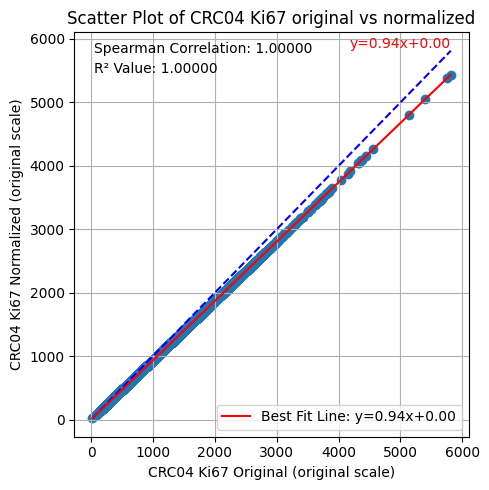

Currently processing Ki67 Original......


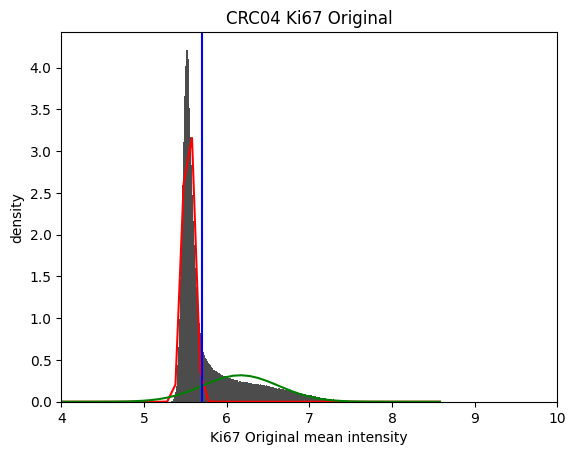

Positive population threshold is: [298.67878788]
Proportion of positive population >= [298.67878788]: 32.8307428642301%
Number of positive population >= [298.67878788]: 465884
Currently processing Ki67 Normalized......


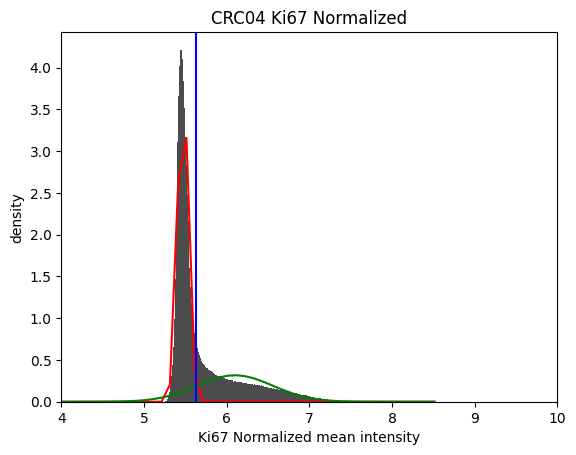

Positive population threshold is: [279.29053547]
Proportion of elements >= [279.29053547]: 32.83067239445037%
Number of elements >= [279.29053547]: 465883
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 0.9927584607211639


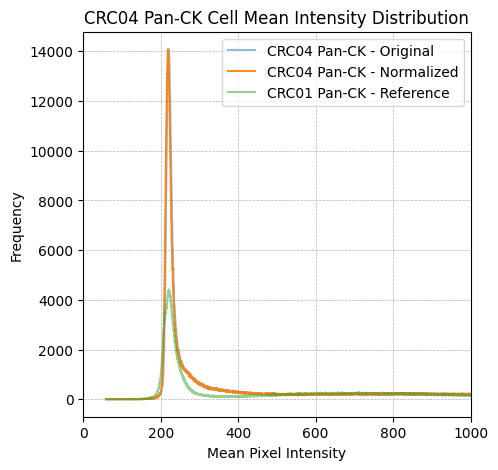

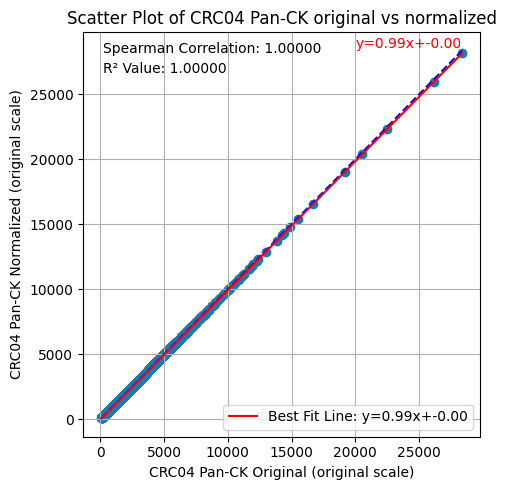

Currently processing Pan-CK Original......


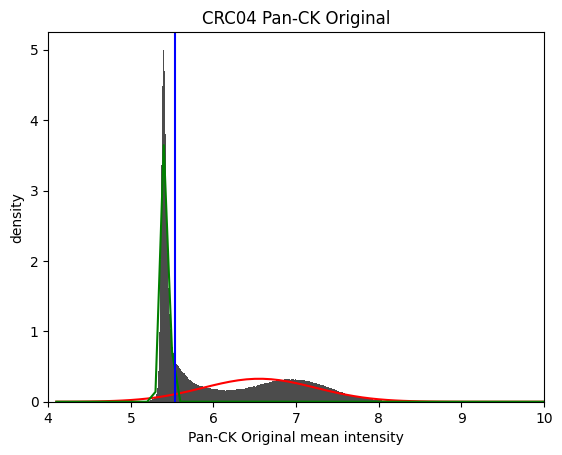

Positive population threshold is: [253.78217822]
Proportion of positive population >= [253.78217822]: 54.242703559005754%
Number of positive population >= [253.78217822]: 769730
Currently processing Pan-CK Normalized......


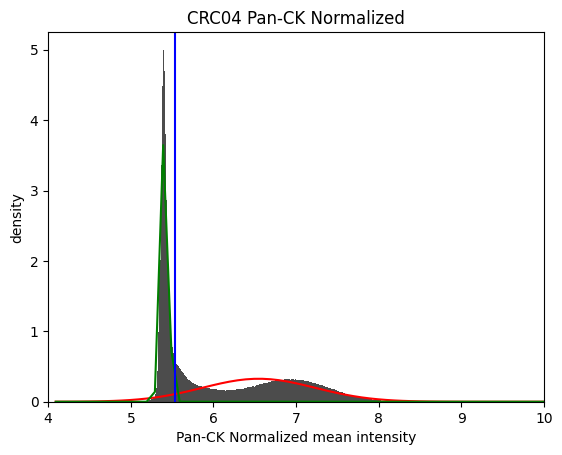

Positive population threshold is: [251.94440461]
Proportion of elements >= [251.94440461]: 54.242703559005754%
Number of elements >= [251.94440461]: 769730
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 0.9866500849414243


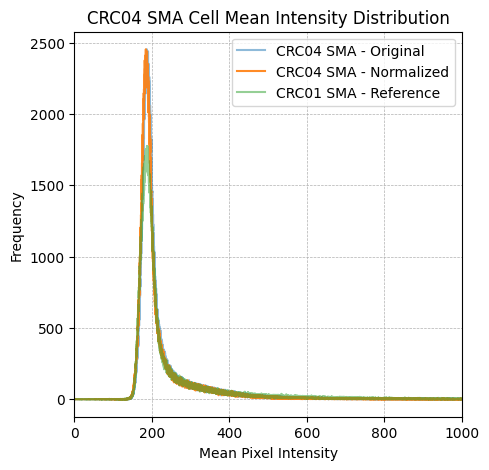

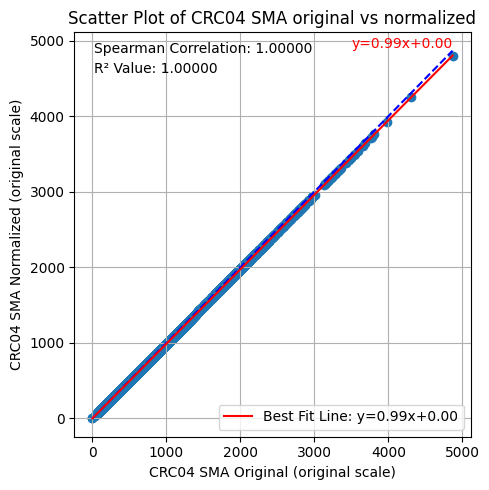

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


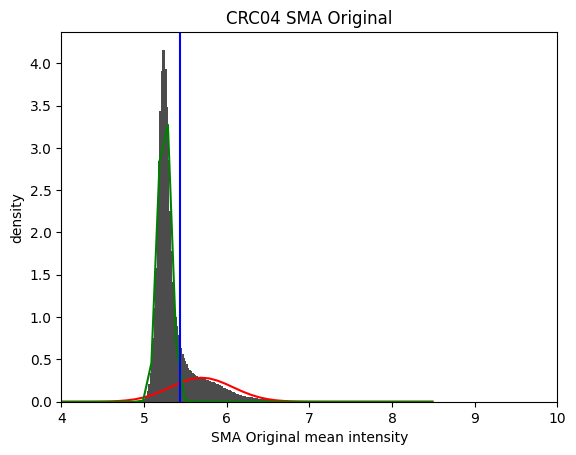

Positive population threshold is: [228.49152542]
Proportion of positive population >= [228.49152542]: 22.38035640795801%
Number of positive population >= [228.49152542]: 317588
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


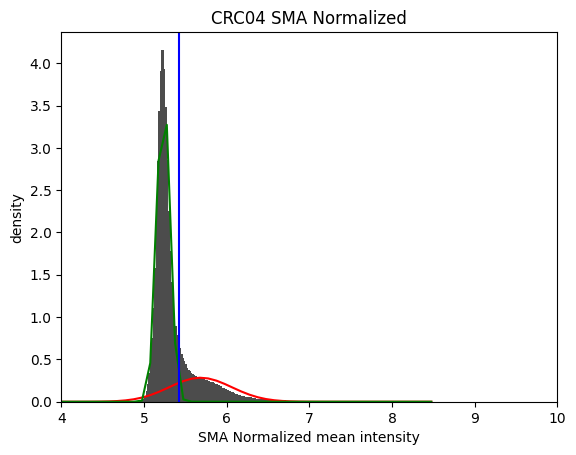

Positive population threshold is: [225.44118297]
Proportion of elements >= [225.44118297]: 22.38035640795801%
Number of elements >= [225.44118297]: 317588
******************************  Processing CRC05 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.8911262588529445


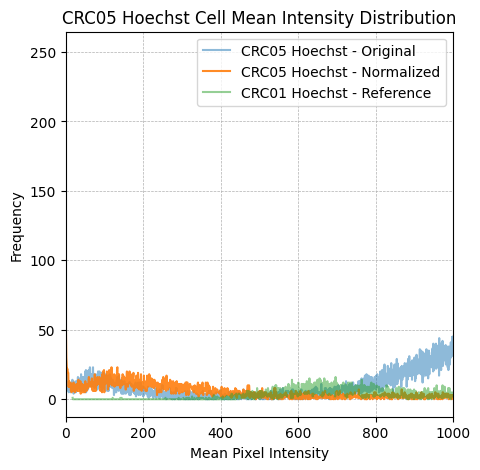

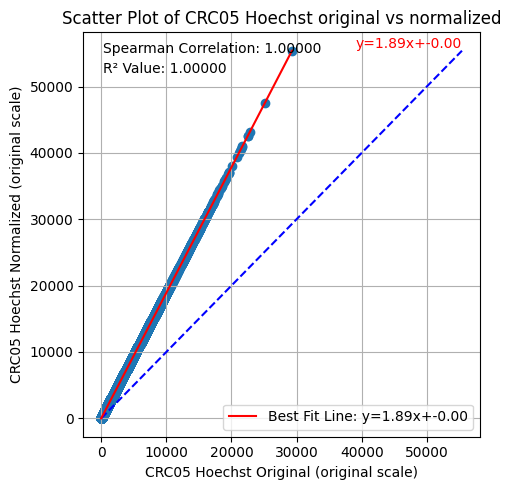

Currently processing Hoechst Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


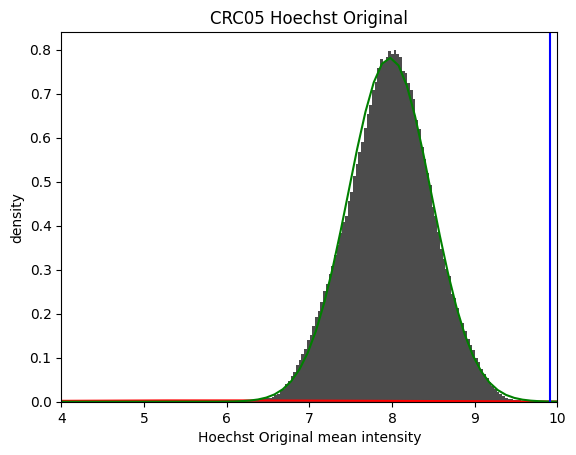

Positive population threshold is: [20144.62295082]
Proportion of positive population >= [20144.62295082]: 0.0016392255751974244%
Number of positive population >= [20144.62295082]: 12
Currently processing Hoechst Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


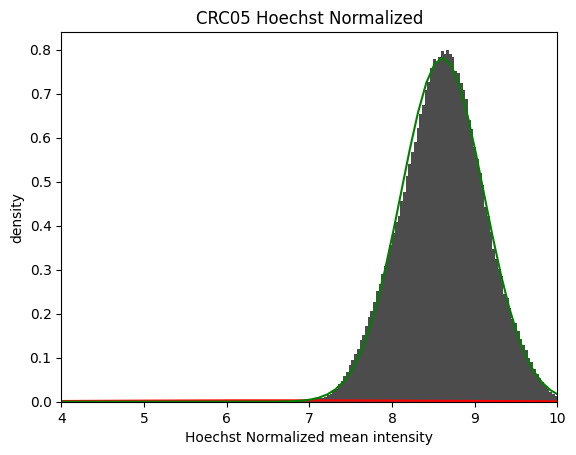

Positive population threshold is: [37017.15870196]
Proportion of elements >= [37017.15870196]: 0.001912429837730328%
Number of elements >= [37017.15870196]: 14
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.2015039196542454


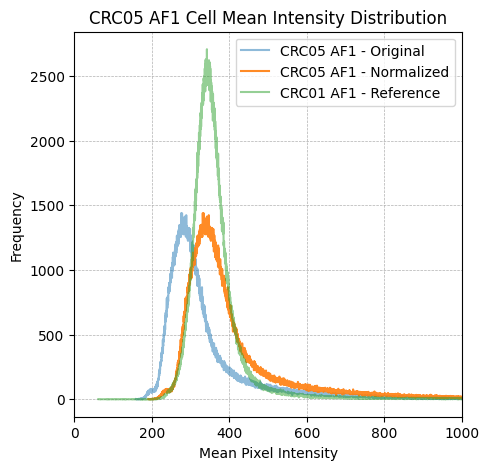

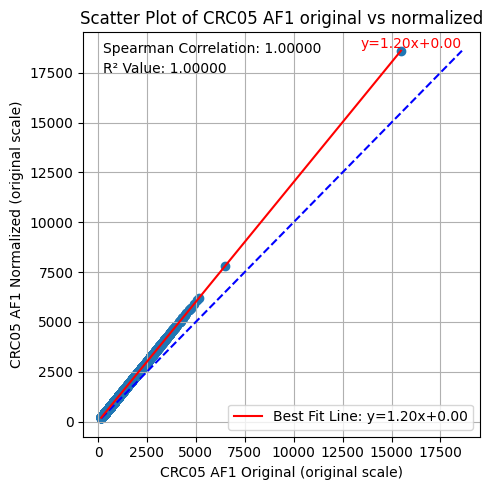

Currently processing AF1 Original......


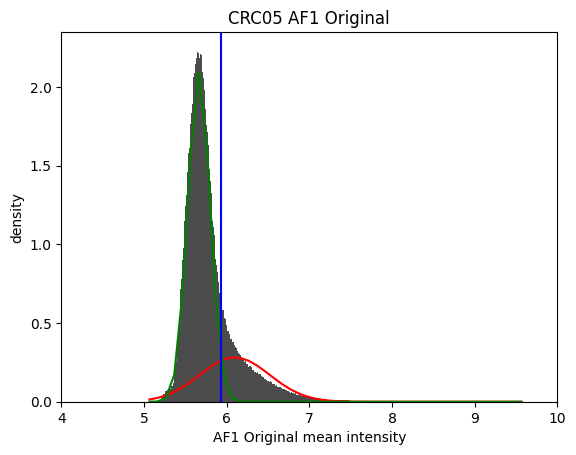

Positive population threshold is: [379.16216216]
Proportion of positive population >= [379.16216216]: 20.975530460226242%
Number of positive population >= [379.16216216]: 153552
Currently processing AF1 Normalized......


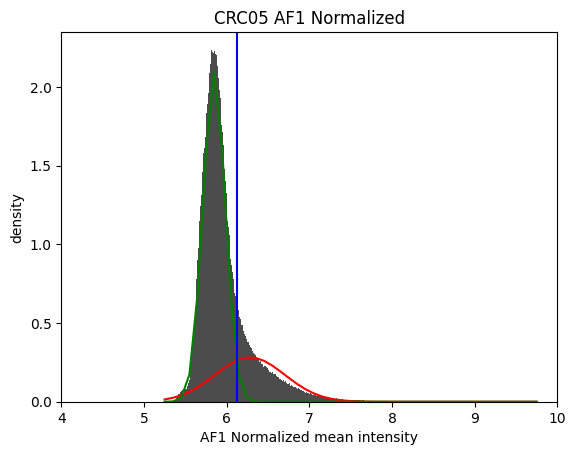

Positive population threshold is: [455.56482402]
Proportion of elements >= [455.56482402]: 20.975530460226242%
Number of elements >= [455.56482402]: 153552
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 1.0160004632268966


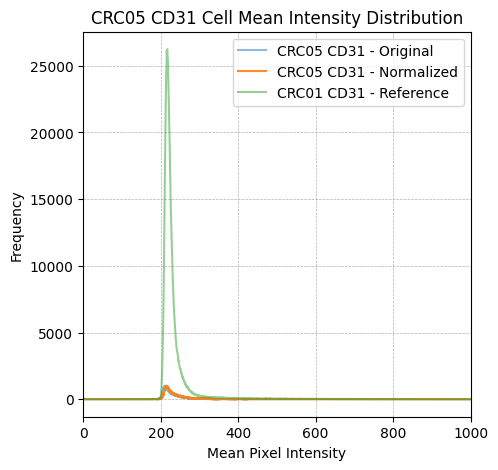

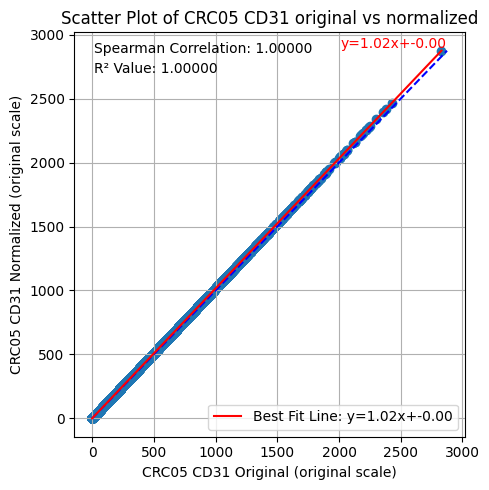

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


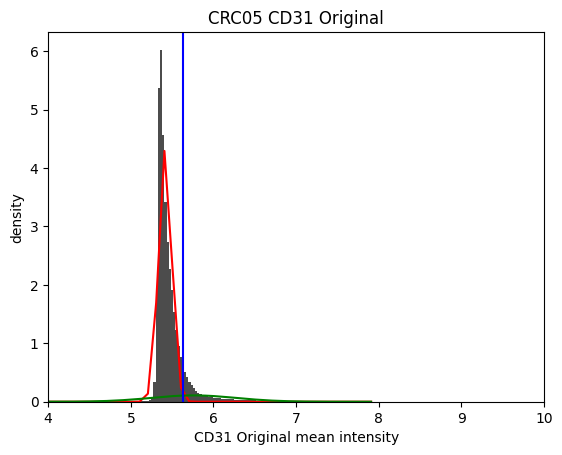

Positive population threshold is: [279.32773109]
Proportion of positive population >= [279.32773109]: 10.749085107225843%
Number of positive population >= [279.32773109]: 78689
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


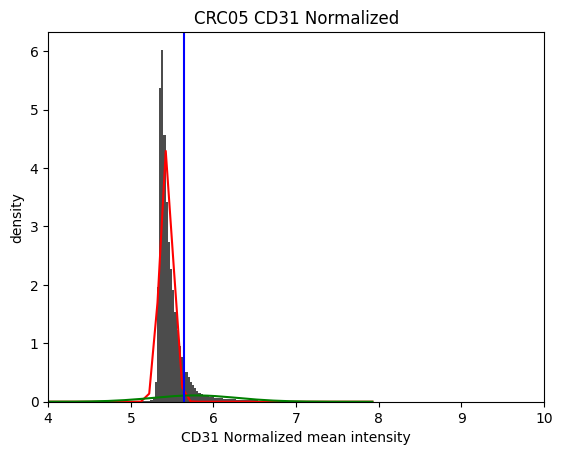

Positive population threshold is: [283.81752071]
Proportion of elements >= [283.81752071]: 10.744440634762784%
Number of elements >= [283.81752071]: 78655
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 1.037873209376667


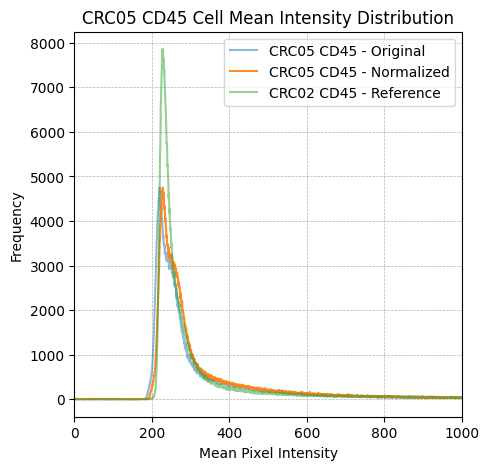

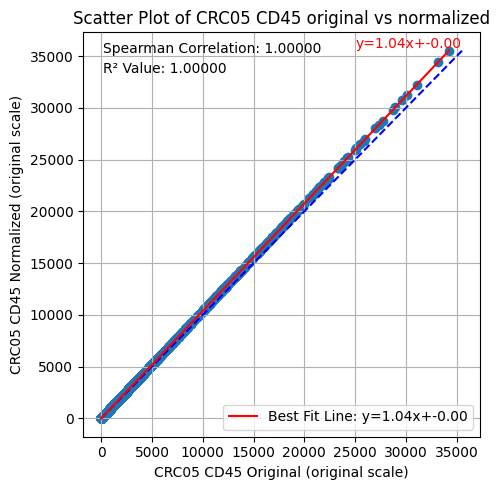

Currently processing CD45 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


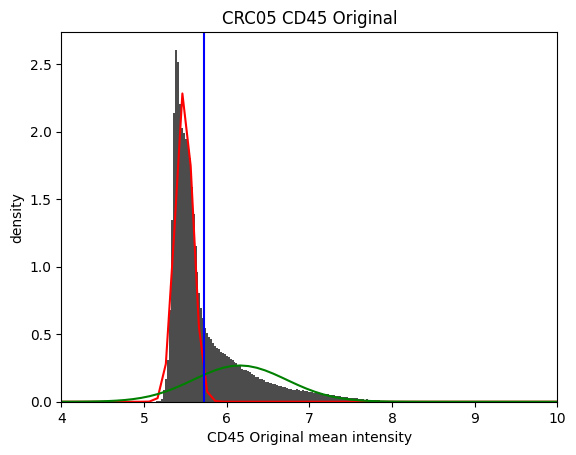

Positive population threshold is: [305.35]
Proportion of positive population >= [305.35]: 32.26596981366103%
Number of positive population >= [305.35]: 236204
Currently processing CD45 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


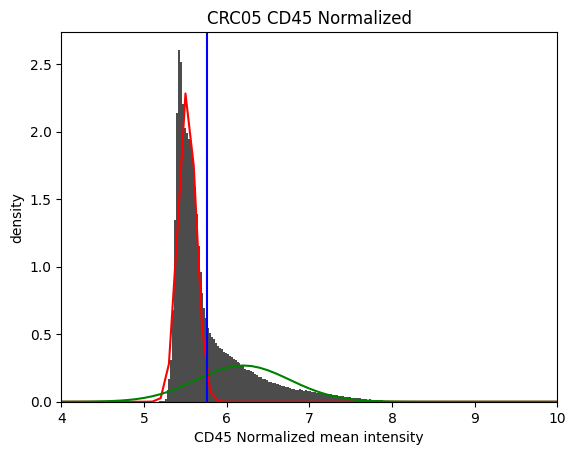

Positive population threshold is: [316.92015984]
Proportion of elements >= [316.92015984]: 32.2648769966109%
Number of elements >= [316.92015984]: 236196
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 1.1174843989936192


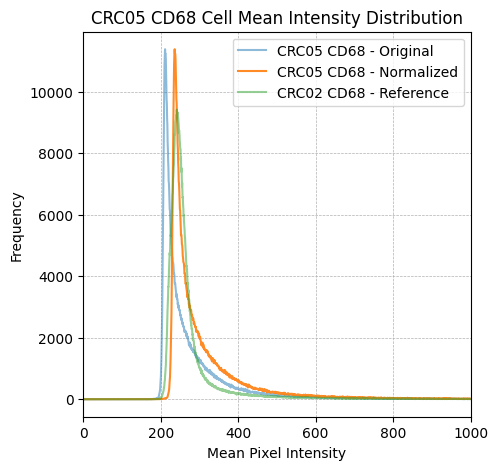

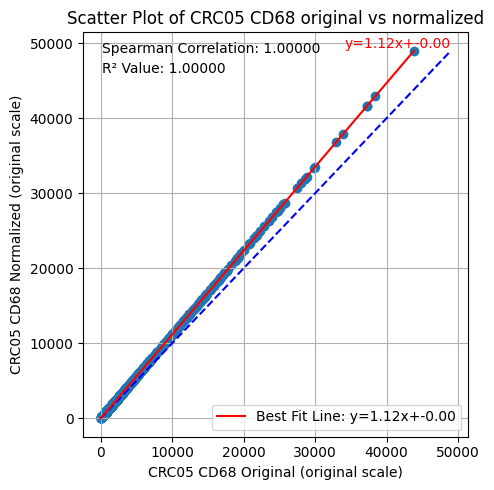

Currently processing CD68 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


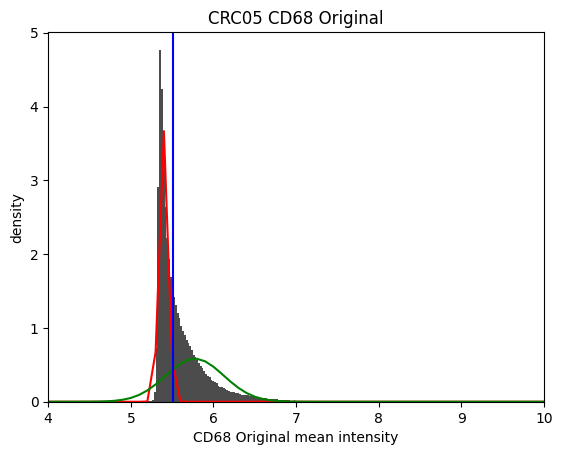

Positive population threshold is: [246.32978723]
Proportion of positive population >= [246.32978723]: 45.339886592910624%
Number of positive population >= [246.32978723]: 331912
Currently processing CD68 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


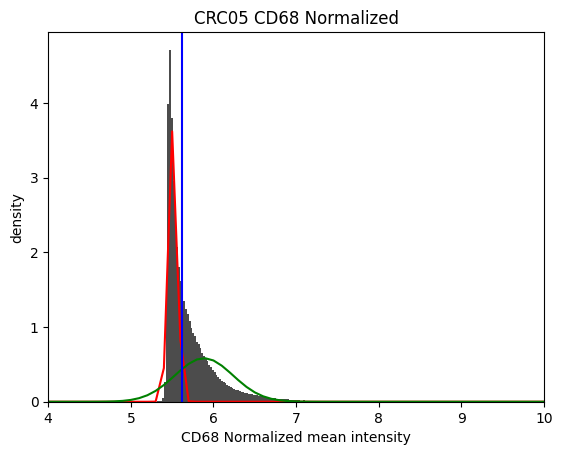

Positive population threshold is: [275.32431624]
Proportion of elements >= [275.32431624]: 45.309970726163264%
Number of elements >= [275.32431624]: 331693
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.0199380292125437


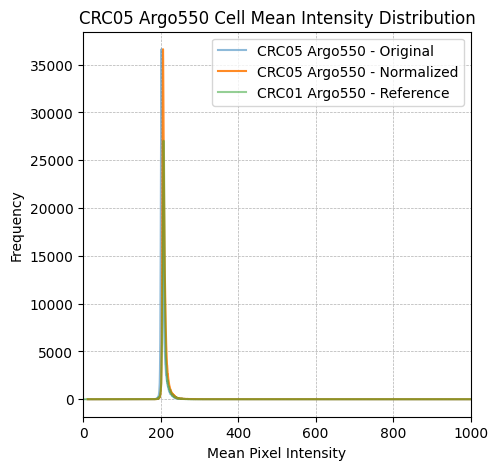

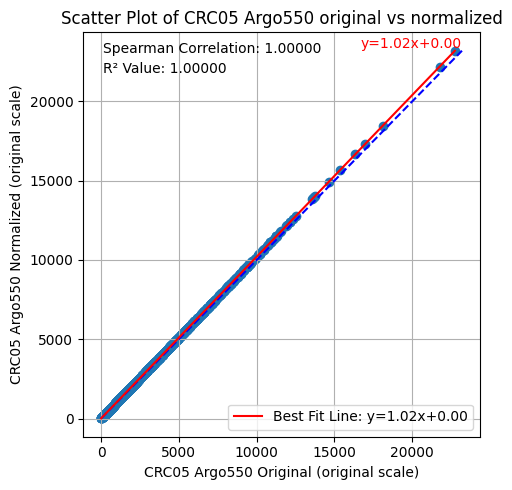

Currently processing Argo550 Original......


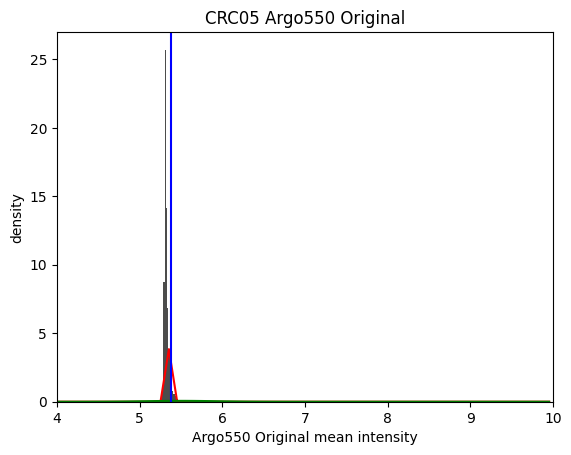

Positive population threshold is: [218.20627803]
Proportion of positive population >= [218.20627803]: 5.567766268289318%
Number of positive population >= [218.20627803]: 40759
Currently processing Argo550 Normalized......


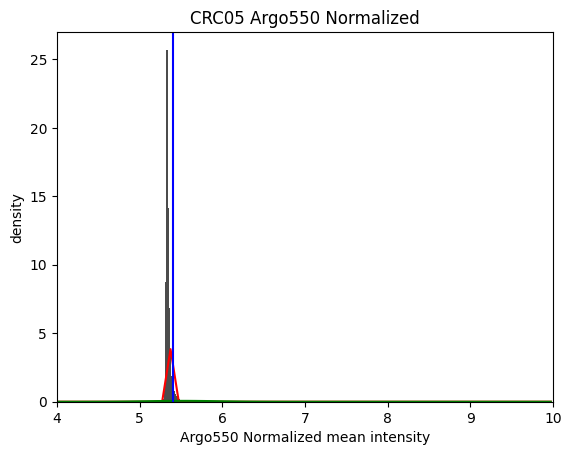

Positive population threshold is: [222.55688117]
Proportion of elements >= [222.55688117]: 5.567766268289318%
Number of elements >= [222.55688117]: 40759
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 1.0136120914686744


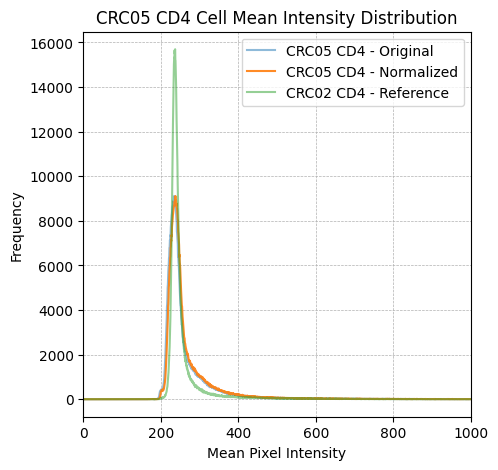

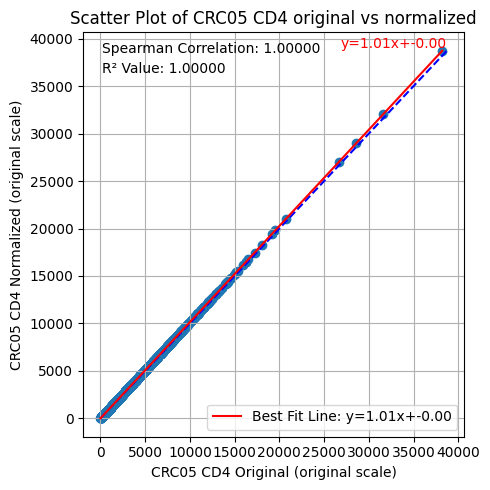

Currently processing CD4 Original......


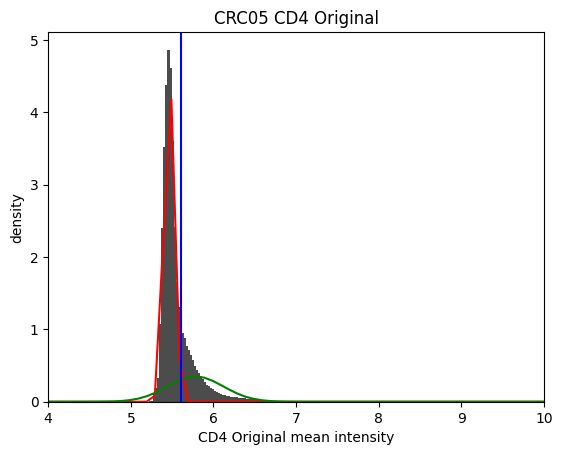

Positive population threshold is: [272.93215339]
Proportion of positive population >= [272.93215339]: 23.587773016434603%
Number of positive population >= [272.93215339]: 172675
Currently processing CD4 Normalized......


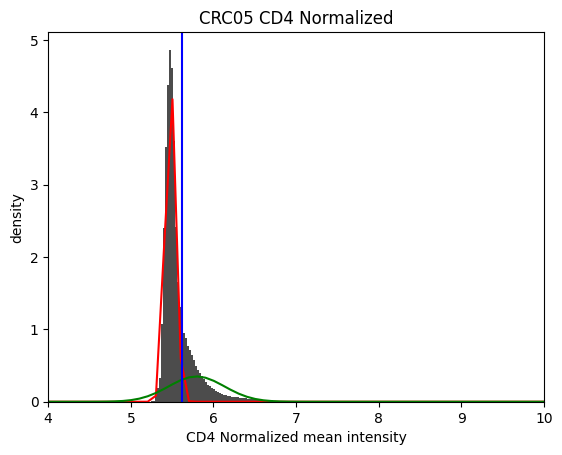

Positive population threshold is: [276.64733083]
Proportion of elements >= [276.64733083]: 23.587773016434603%
Number of elements >= [276.64733083]: 172675
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0136644155042476


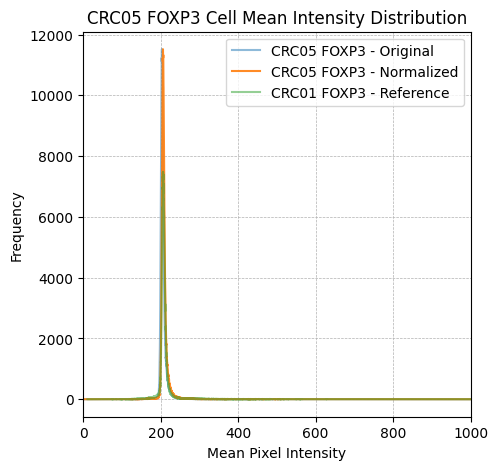

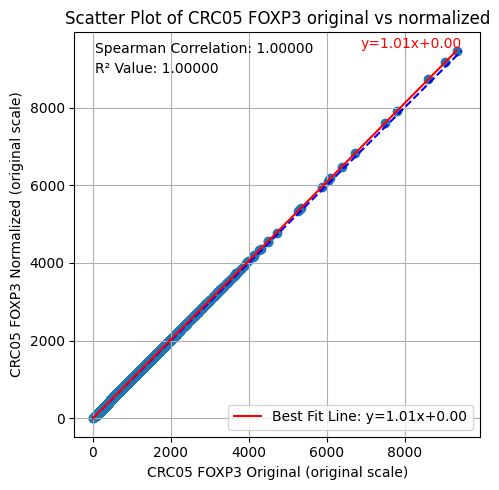

Currently processing FOXP3 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


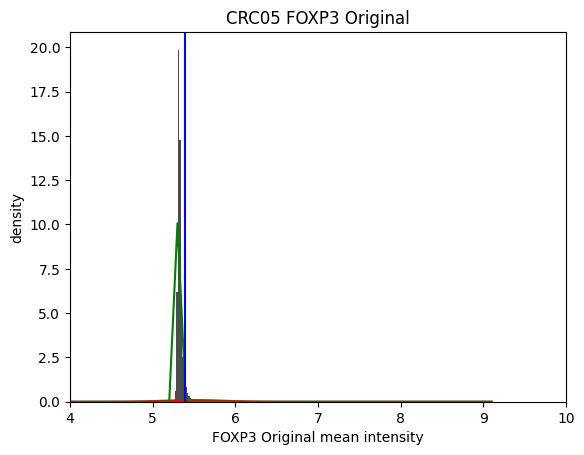

Positive population threshold is: [218.80733945]
Proportion of positive population >= [218.80733945]: 6.414426277878787%
Number of positive population >= [218.80733945]: 46957
Currently processing FOXP3 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


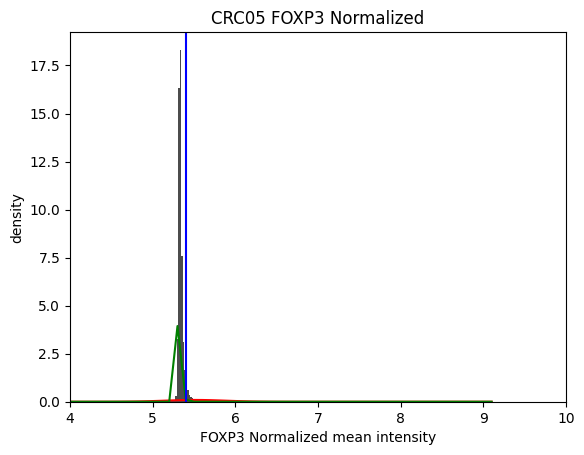

Positive population threshold is: [221.79721385]
Proportion of elements >= [221.79721385]: 6.414426277878787%
Number of elements >= [221.79721385]: 46957
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 1.0202777817003683


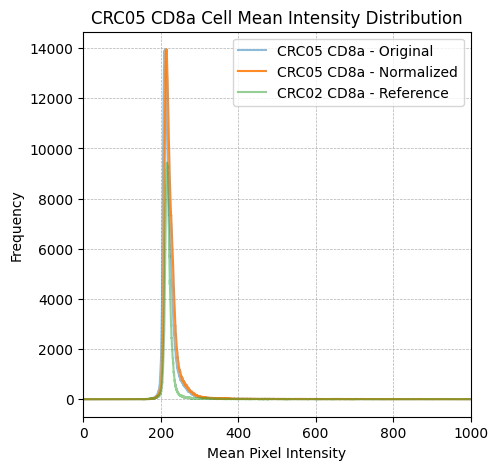

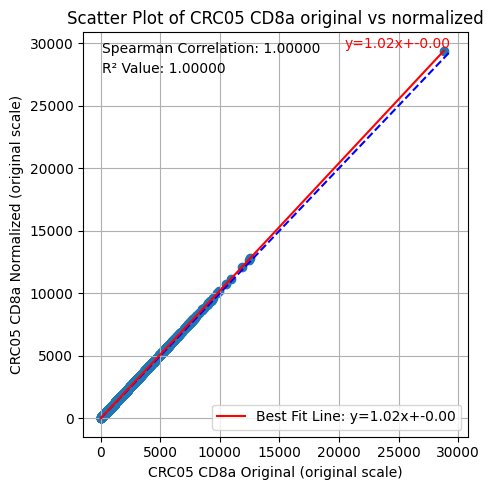

Currently processing CD8a Original......


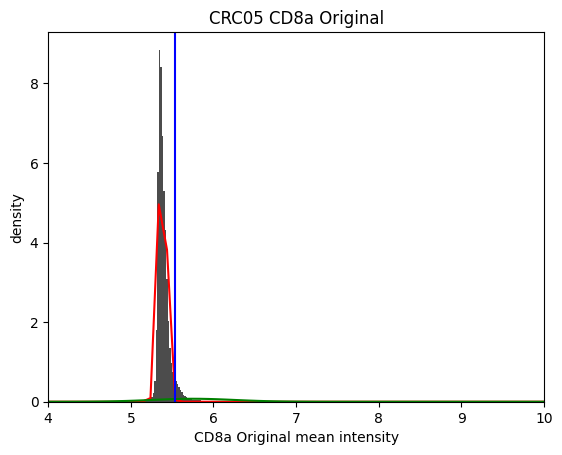

Positive population threshold is: [252.25742574]
Proportion of positive population >= [252.25742574]: 7.3970054080783765%
Number of positive population >= [252.25742574]: 54150
Currently processing CD8a Normalized......


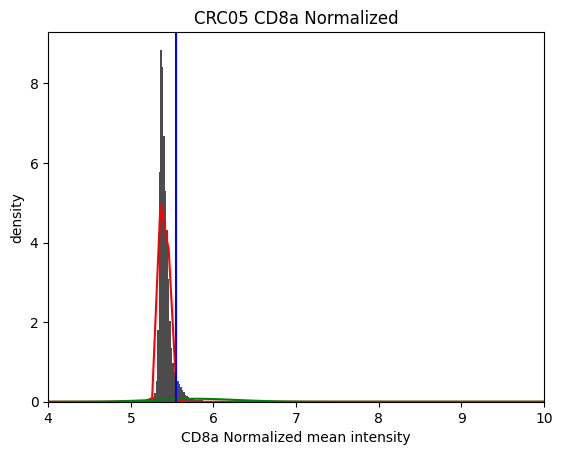

Positive population threshold is: [257.37264675]
Proportion of elements >= [257.37264675]: 7.3970054080783765%
Number of elements >= [257.37264675]: 54150
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 1.1860800967172764


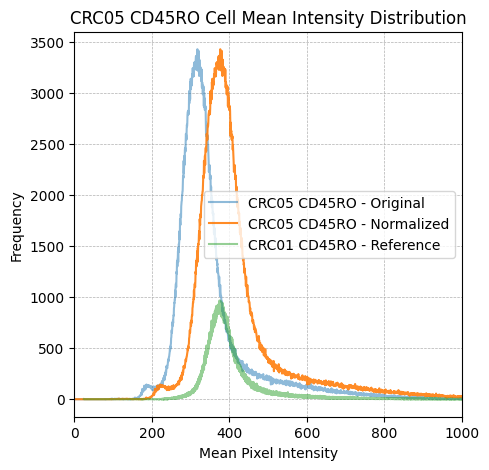

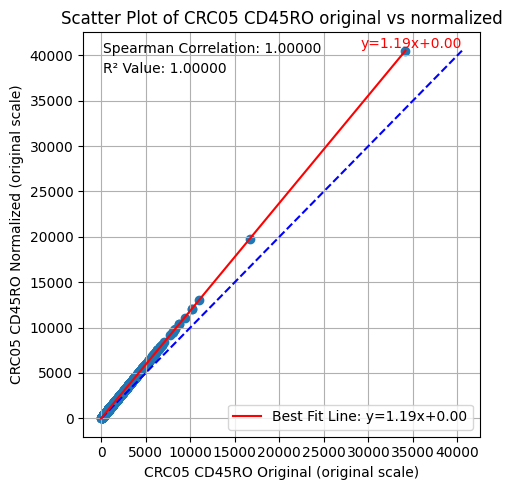

Currently processing CD45RO Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


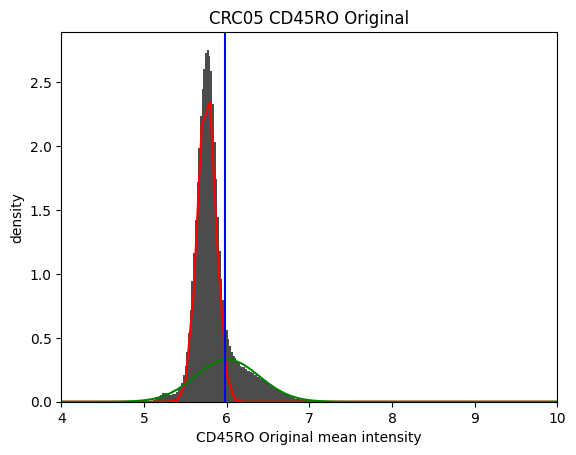

Positive population threshold is: [393.82673267]
Proportion of positive population >= [393.82673267]: 18.154559847442737%
Number of positive population >= [393.82673267]: 132901
Currently processing CD45RO Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


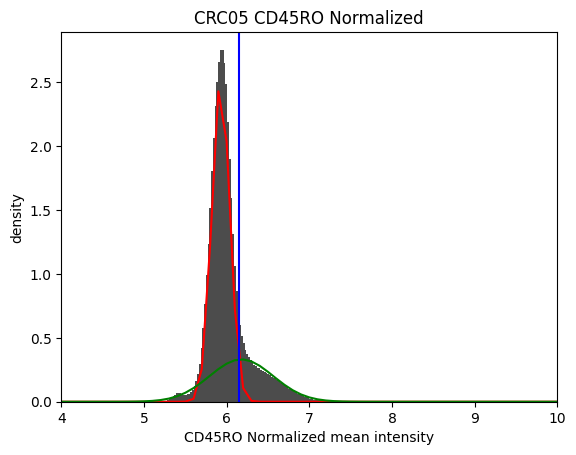

Positive population threshold is: [467.11605615]
Proportion of elements >= [467.11605615]: 18.153876836786406%
Number of elements >= [467.11605615]: 132896
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 1.0320936121800448


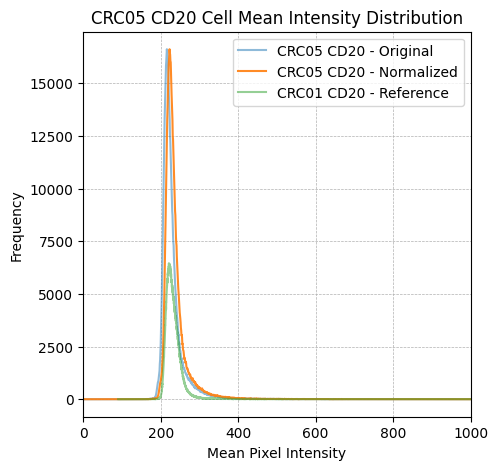

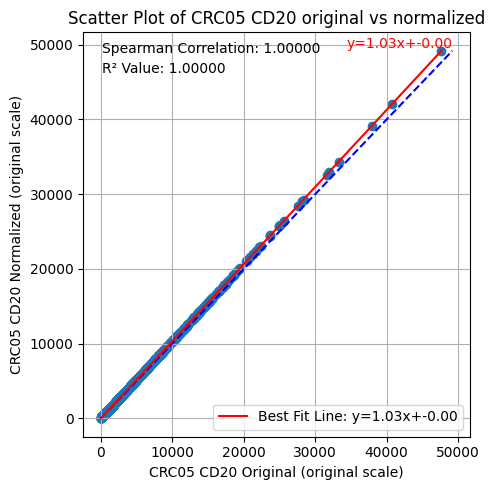

Currently processing CD20 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


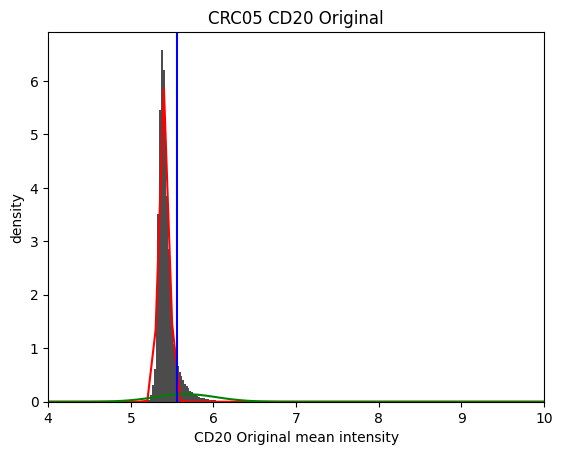

Positive population threshold is: [260.68650794]
Proportion of positive population >= [260.68650794]: 9.58222970194781%
Number of positive population >= [260.68650794]: 70147
Currently processing CD20 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


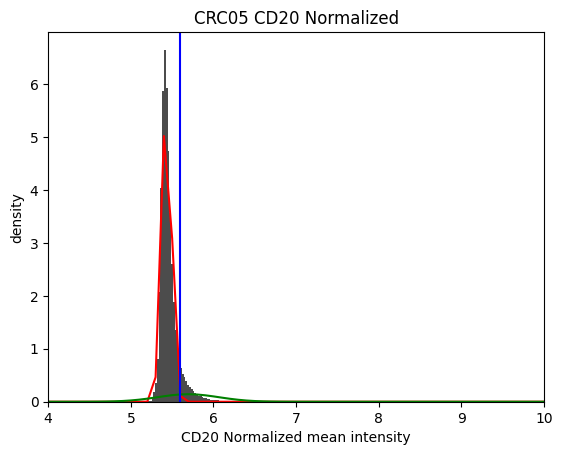

Positive population threshold is: [269.06959414]
Proportion of elements >= [269.06959414]: 9.577995035878551%
Number of elements >= [269.06959414]: 70116
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 1.1412613426336957


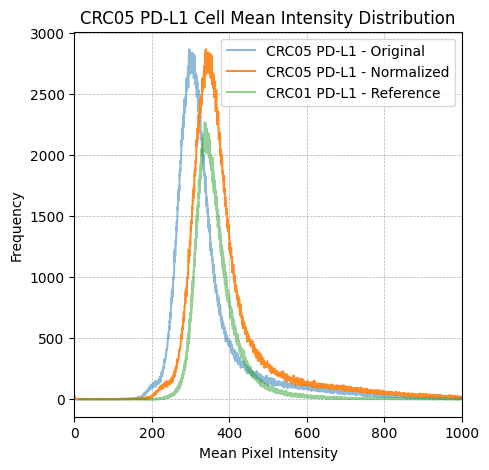

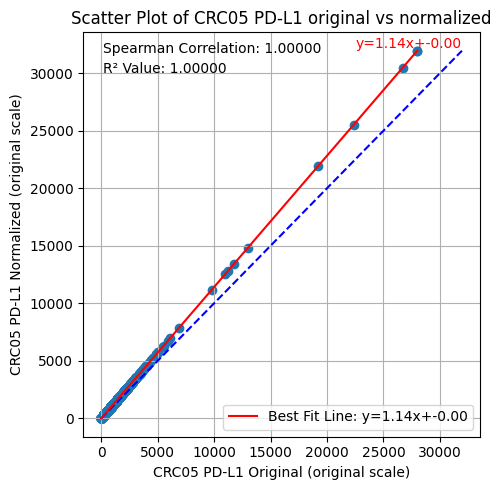

Currently processing PD-L1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


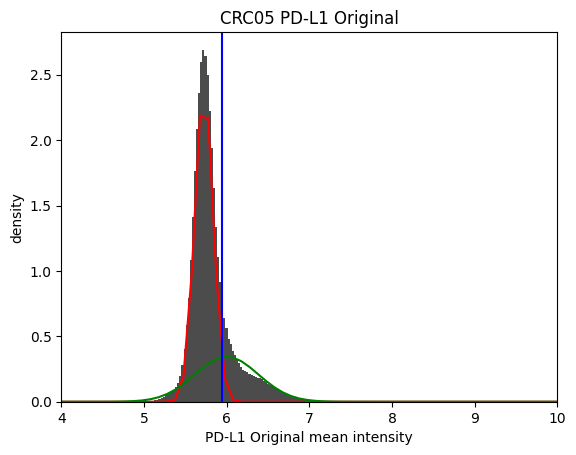

Positive population threshold is: [381.86936937]
Proportion of positive population >= [381.86936937]: 19.926016285706087%
Number of positive population >= [381.86936937]: 145869
Currently processing PD-L1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


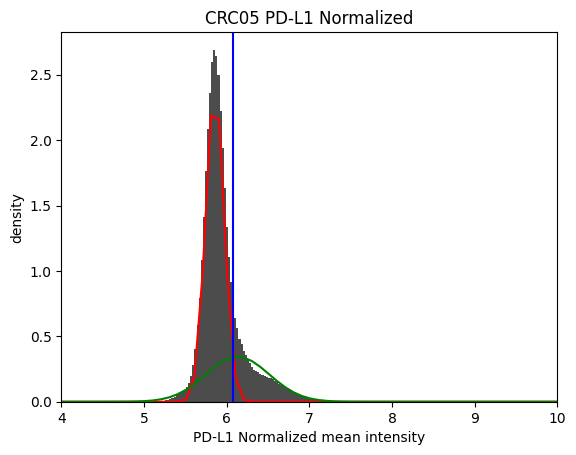

Positive population threshold is: [435.86238688]
Proportion of elements >= [435.86238688]: 19.9182299642239%
Number of elements >= [435.86238688]: 145812
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 1.0394001865983609


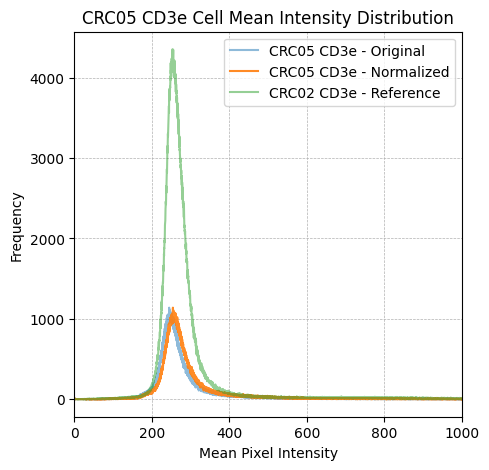

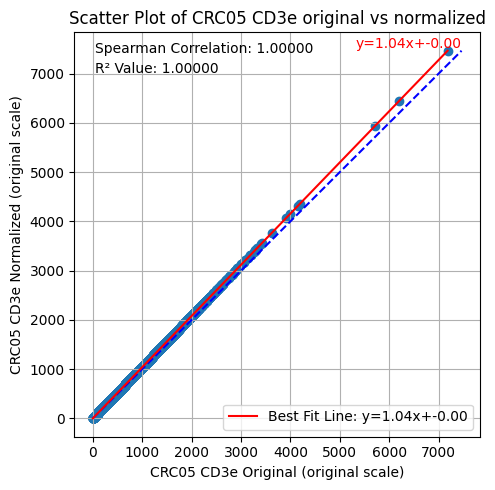

Currently processing CD3e Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


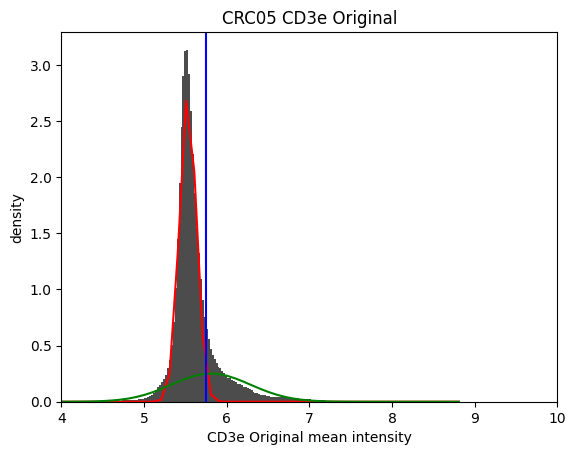

Positive population threshold is: [315.58169935]
Proportion of positive population >= [315.58169935]: 17.861001867351135%
Number of positive population >= [315.58169935]: 130752
Currently processing CD3e Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


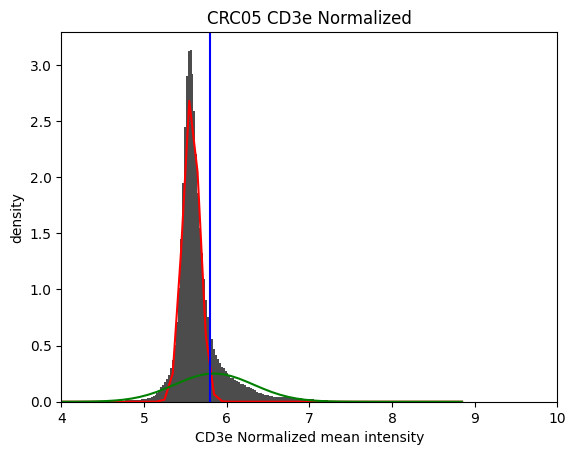

Positive population threshold is: [328.02138273]
Proportion of elements >= [328.02138273]: 17.86004565243227%
Number of elements >= [328.02138273]: 130745
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 1.0


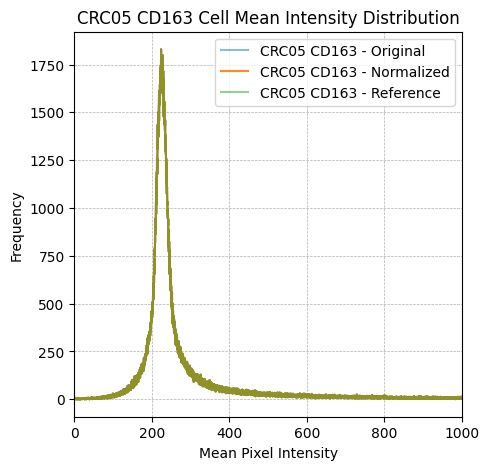

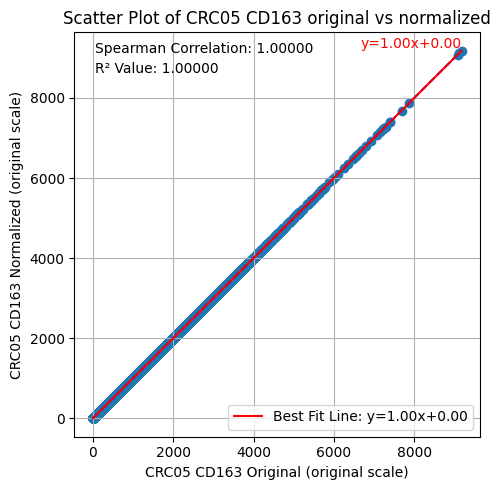

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


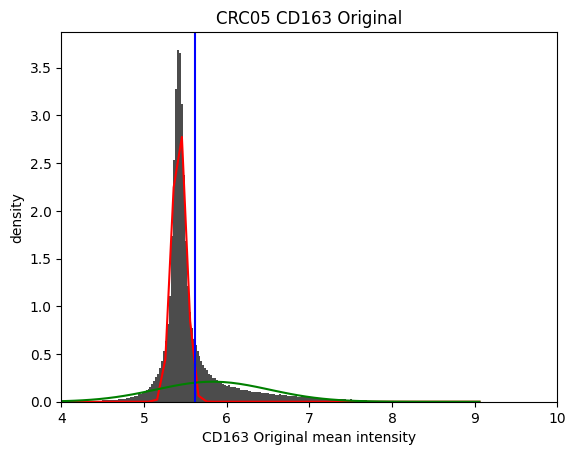

Positive population threshold is: [276.17437722]
Proportion of positive population >= [276.17437722]: 23.56236502001904%
Number of positive population >= [276.17437722]: 172489
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


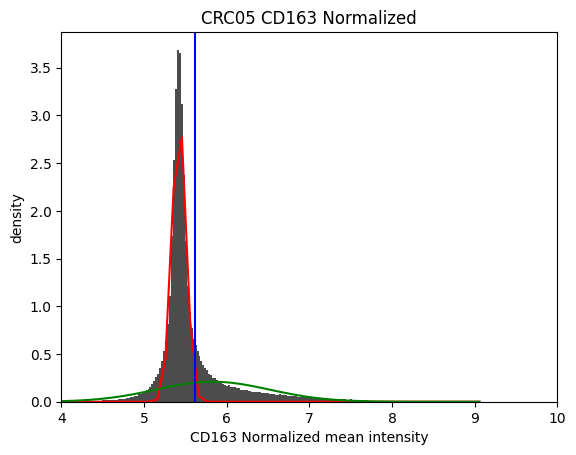

Positive population threshold is: [276.17437722]
Proportion of elements >= [276.17437722]: 23.56236502001904%
Number of elements >= [276.17437722]: 172489
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 1.0134383506524327


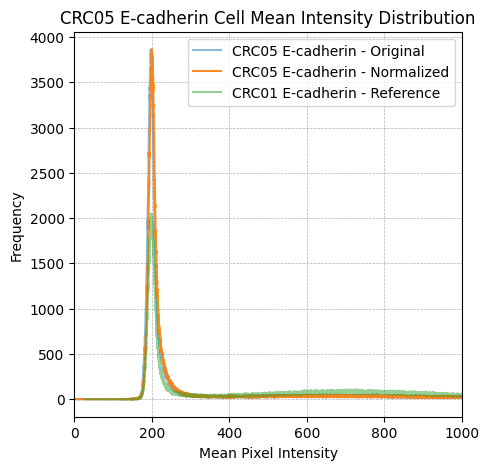

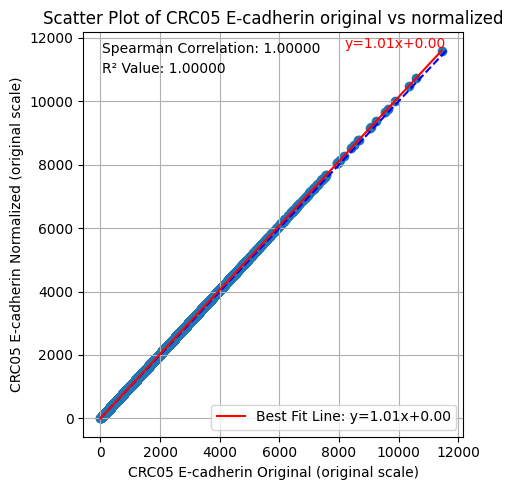

Currently processing E-cadherin Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


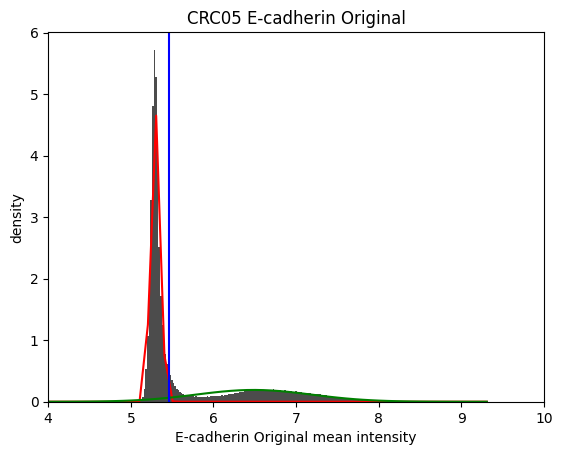

Positive population threshold is: [235.97972973]
Proportion of positive population >= [235.97972973]: 31.870096837250856%
Number of positive population >= [235.97972973]: 233306
Currently processing E-cadherin Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


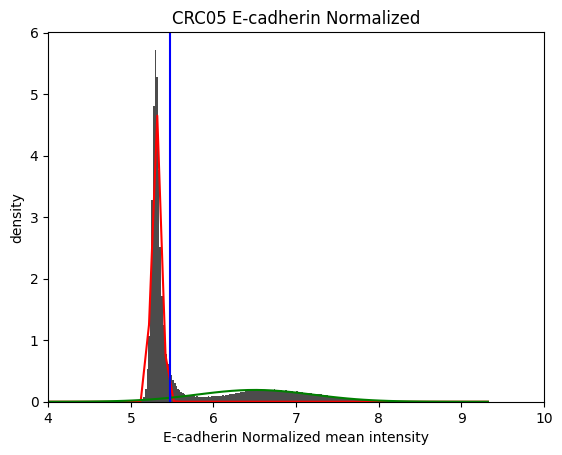

Positive population threshold is: [239.15090808]
Proportion of elements >= [239.15090808]: 31.86996023511959%
Number of elements >= [239.15090808]: 233305
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.1174754425391915


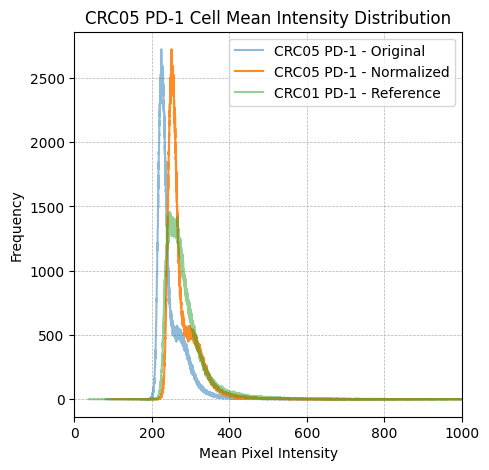

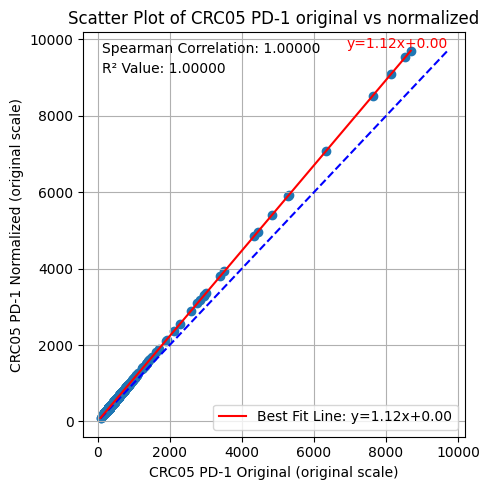

Currently processing PD-1 Original......


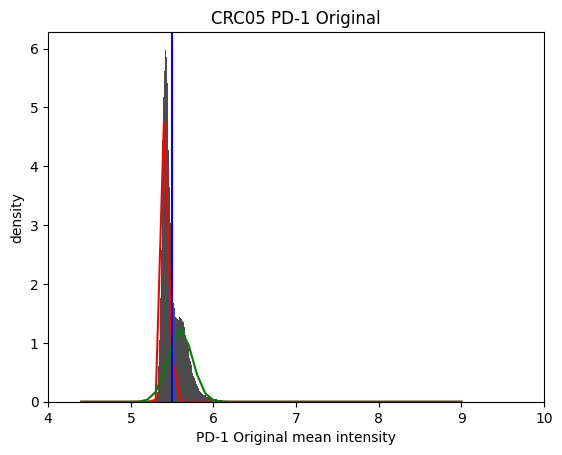

Positive population threshold is: [243.34567901]
Proportion of positive population >= [243.34567901]: 36.96057525889519%
Number of positive population >= [243.34567901]: 270571
Currently processing PD-1 Normalized......


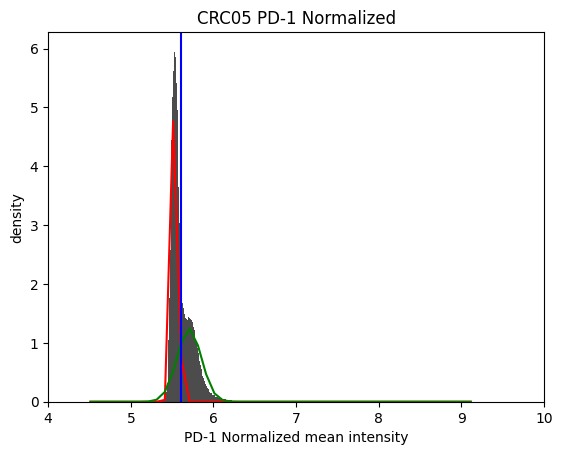

Positive population threshold is: [271.93282034]
Proportion of elements >= [271.93282034]: 36.96057525889519%
Number of elements >= [271.93282034]: 270571
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 1.0226241715253523


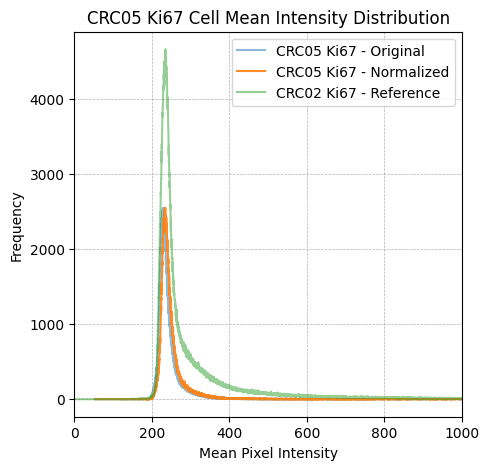

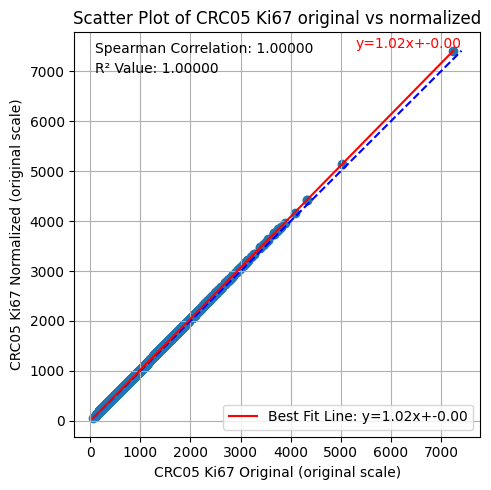

Currently processing Ki67 Original......


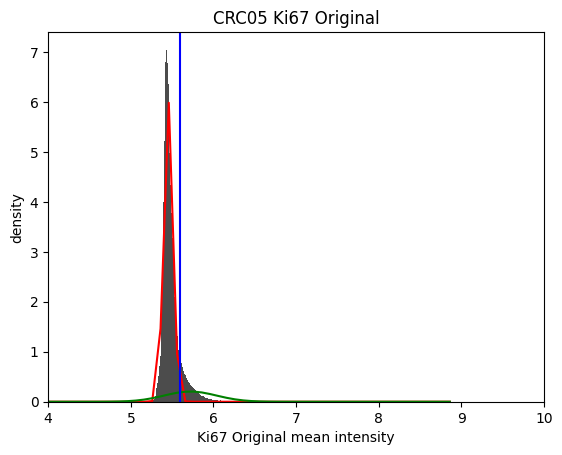

Positive population threshold is: [270.09771987]
Proportion of positive population >= [270.09771987]: 12.1548576400889%
Number of positive population >= [270.09771987]: 88980
Currently processing Ki67 Normalized......


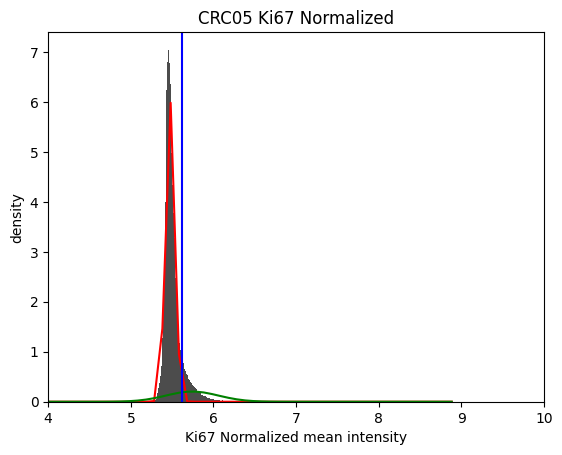

Positive population threshold is: [276.20845701]
Proportion of elements >= [276.20845701]: 12.1548576400889%
Number of elements >= [276.20845701]: 88980
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 1.0146419310833903


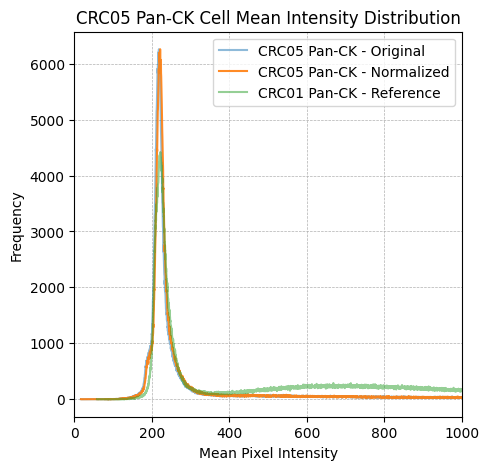

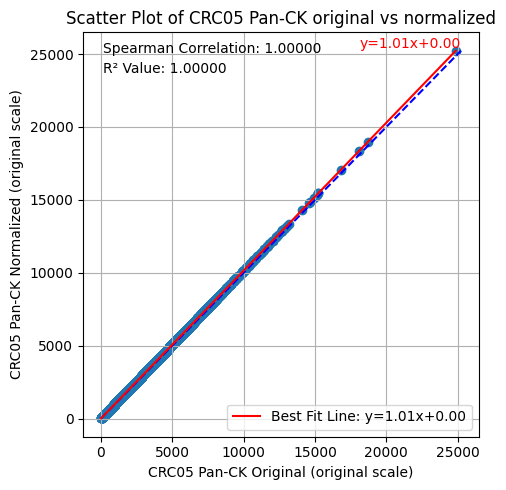

Currently processing Pan-CK Original......


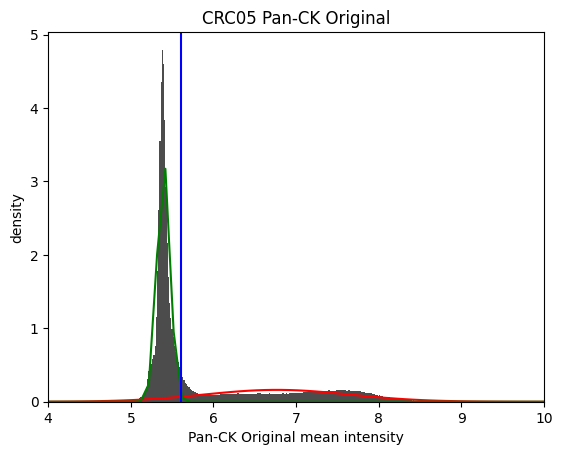

Positive population threshold is: [273.65789474]
Proportion of positive population >= [273.65789474]: 32.60993398018996%
Number of positive population >= [273.65789474]: 238722
Currently processing Pan-CK Normalized......


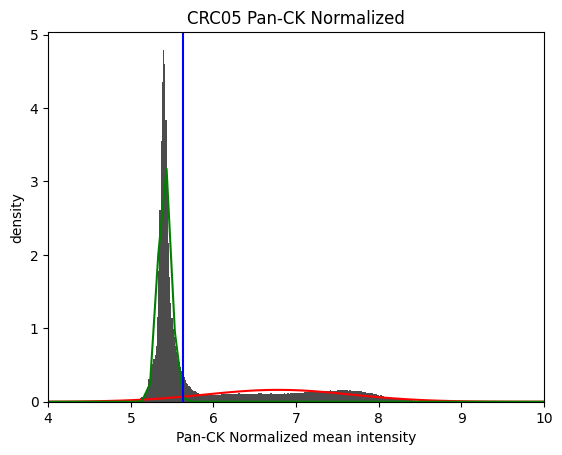

Positive population threshold is: [277.66477477]
Proportion of elements >= [277.66477477]: 32.60993398018996%
Number of elements >= [277.66477477]: 238722
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 1.0411433443203333


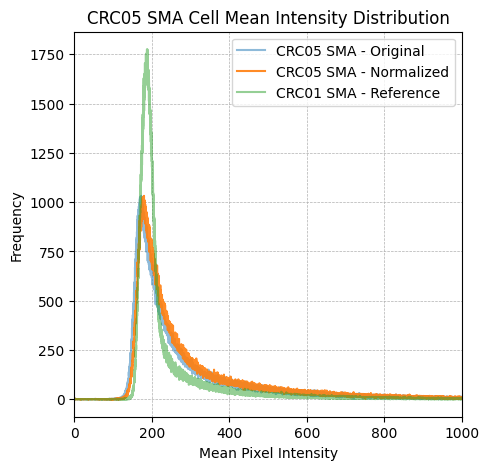

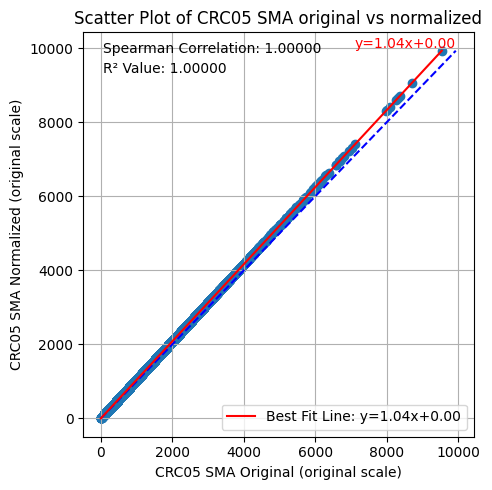

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


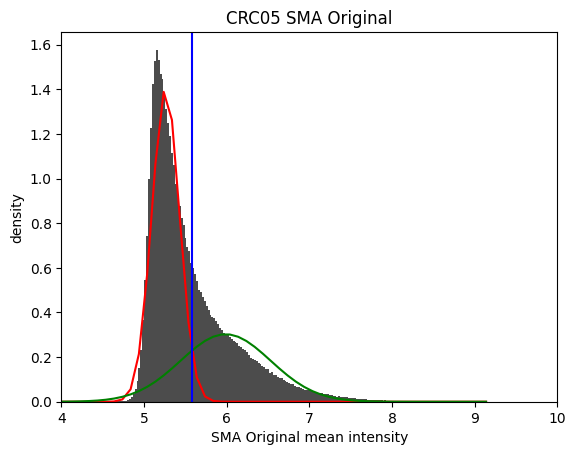

Positive population threshold is: [264.65486726]
Proportion of positive population >= [264.65486726]: 35.413009713777555%
Number of positive population >= [264.65486726]: 259242
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


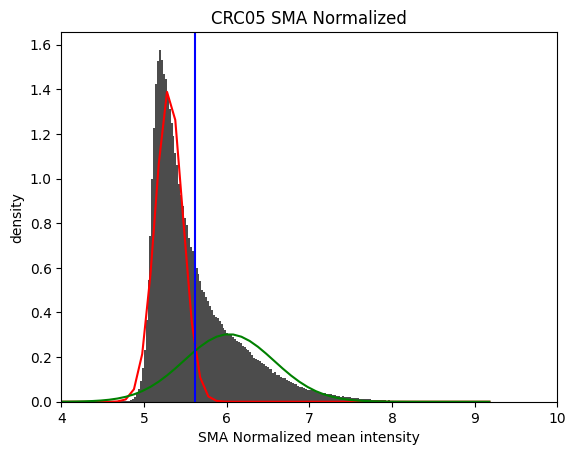

Positive population threshold is: [275.54680563]
Proportion of elements >= [275.54680563]: 35.41259990738376%
Number of elements >= [275.54680563]: 259239
******************************  Processing CRC06 ******************************
##### Processing marker Hoechst #####
Reference sample for Hoechst is CRC01
shift scaling factor for Hoechst is 1.1029920658919934


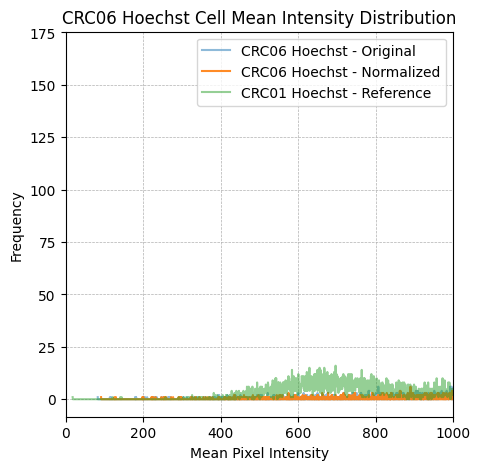

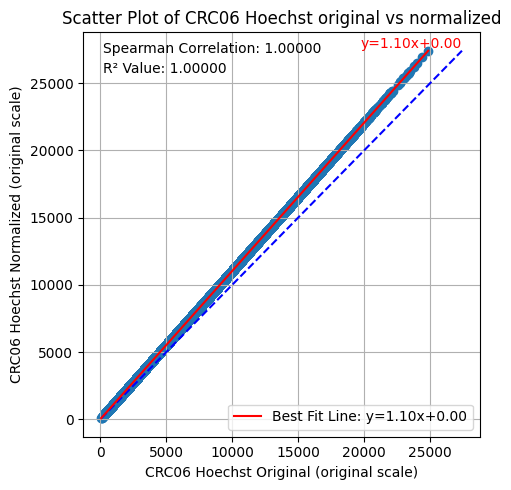

Currently processing Hoechst Original......


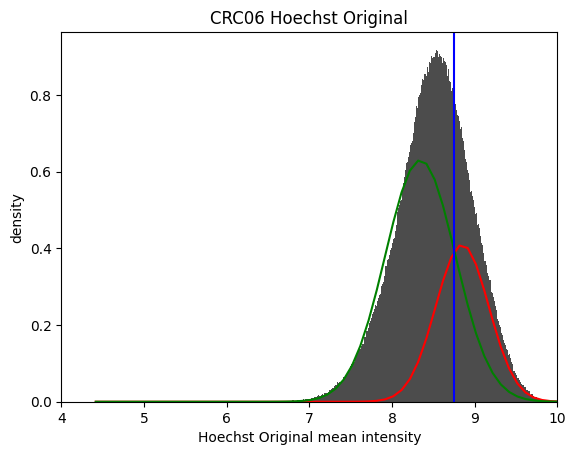

Positive population threshold is: [6348.5]
Proportion of positive population >= [6348.5]: 30.06835601456838%
Number of positive population >= [6348.5]: 264763
Currently processing Hoechst Normalized......


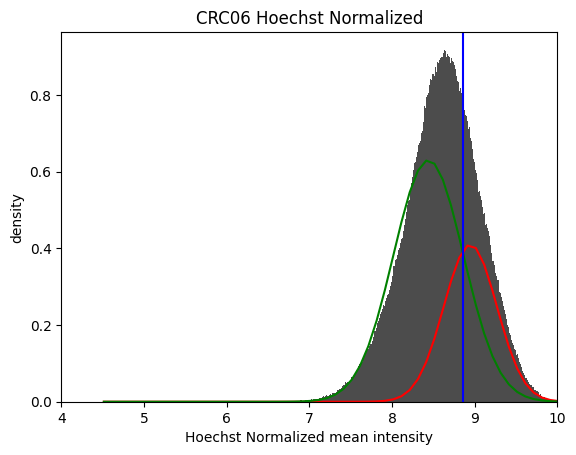

Positive population threshold is: [7002.34513032]
Proportion of elements >= [7002.34513032]: 30.06835601456838%
Number of elements >= [7002.34513032]: 264763
##### Processing marker AF1 #####
Reference sample for AF1 is CRC01
shift scaling factor for AF1 is 1.0385179564943807


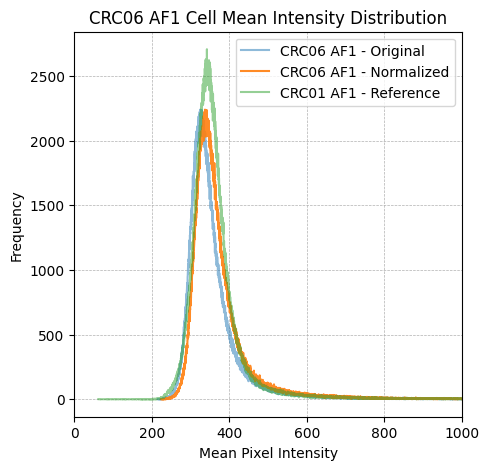

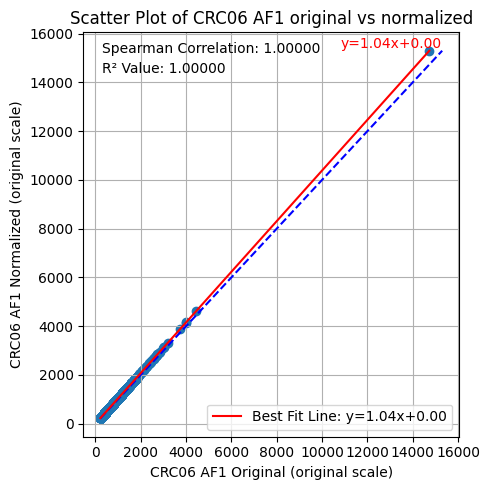

Currently processing AF1 Original......


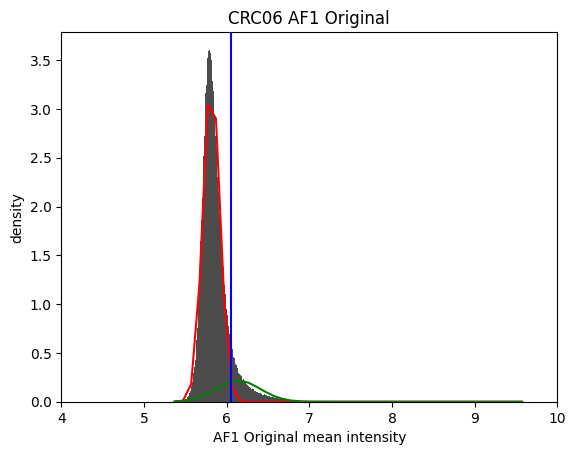

Positive population threshold is: [426.25663717]
Proportion of positive population >= [426.25663717]: 10.245338923861235%
Number of positive population >= [426.25663717]: 90214
Currently processing AF1 Normalized......


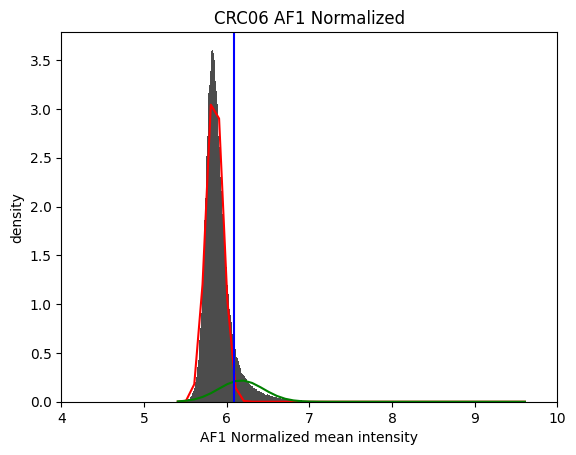

Positive population threshold is: [442.67517177]
Proportion of elements >= [442.67517177]: 10.245338923861235%
Number of elements >= [442.67517177]: 90214
##### Processing marker CD31 #####
Reference sample for CD31 is CRC01
shift scaling factor for CD31 is 0.9687510541344918


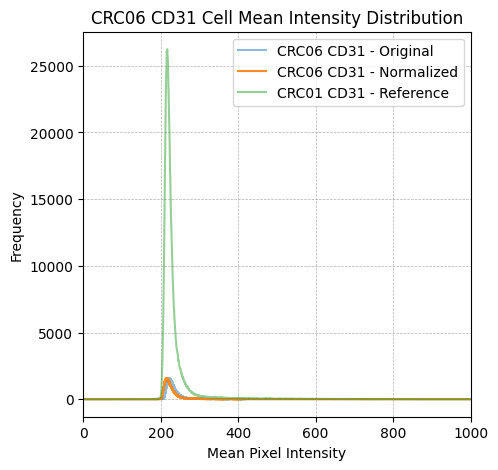

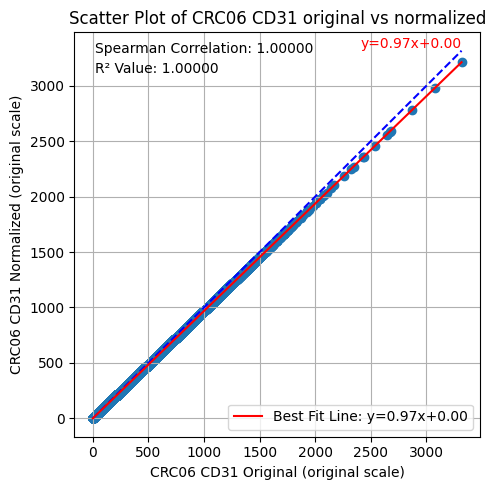

Currently processing CD31 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


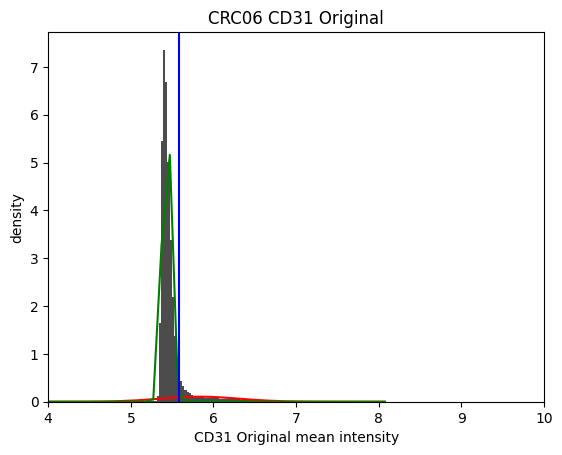

Positive population threshold is: [266.51515152]
Proportion of positive population >= [266.51515152]: 10.4989341731239%
Number of positive population >= [266.51515152]: 92447
Currently processing CD31 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


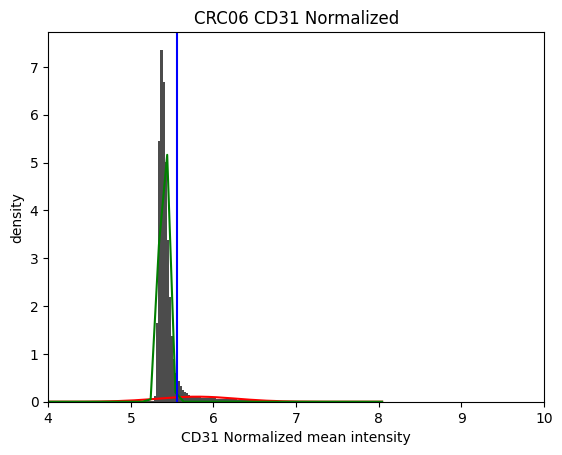

Positive population threshold is: [258.18165349]
Proportion of elements >= [258.18165349]: 10.49950200843349%
Number of elements >= [258.18165349]: 92452
##### Processing marker CD45 #####
Reference sample for CD45 is CRC02
shift scaling factor for CD45 is 0.9169168691400991


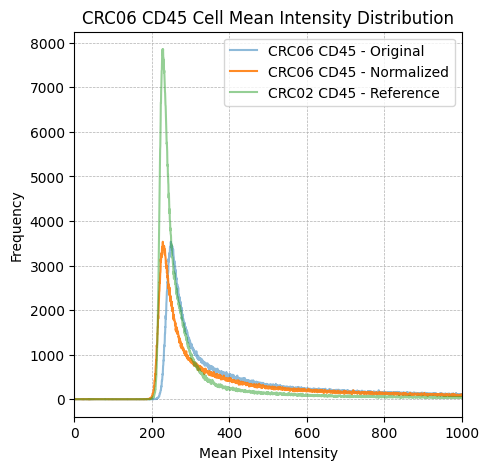

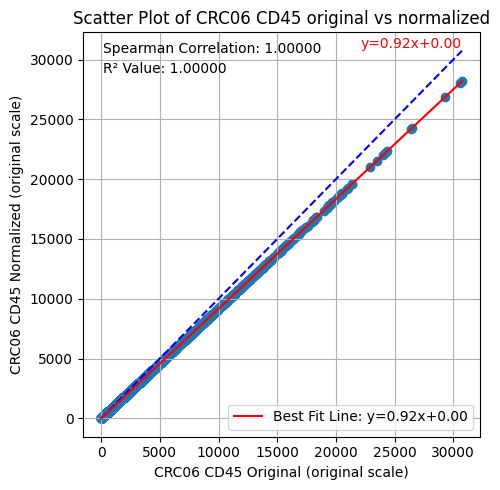

Currently processing CD45 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


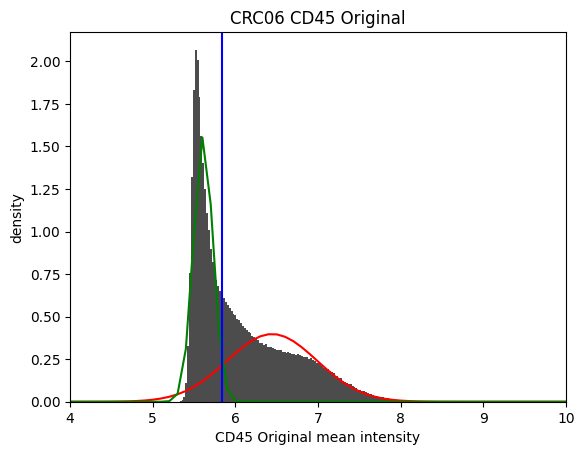

Positive population threshold is: [345.2601626]
Proportion of positive population >= [345.2601626]: 50.70315046386467%
Number of positive population >= [345.2601626]: 446460
Currently processing CD45 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


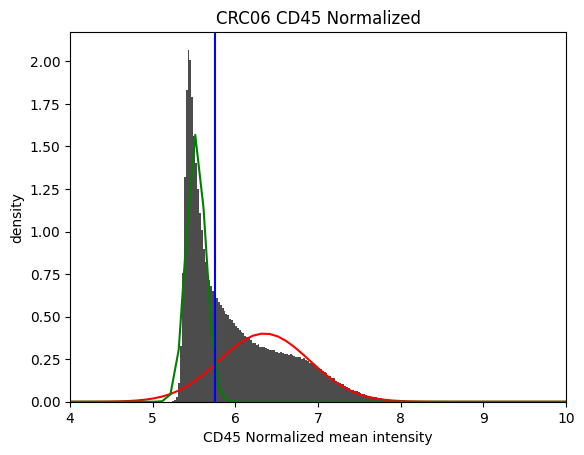

Positive population threshold is: [314.43681163]
Proportion of elements >= [314.43681163]: 51.13629523801953%
Number of elements >= [314.43681163]: 450274
##### Processing marker CD68 #####
Reference sample for CD68 is CRC02
shift scaling factor for CD68 is 1.0


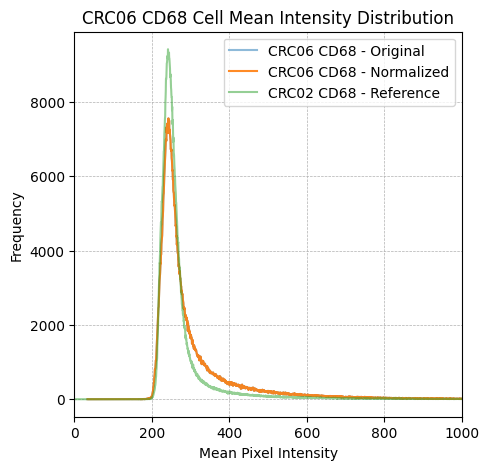

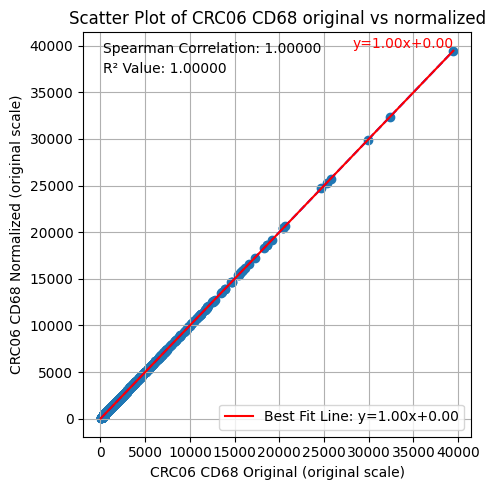

Currently processing CD68 Original......


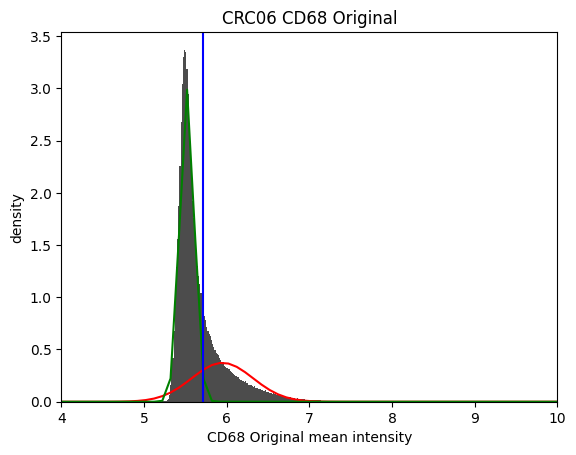

Positive population threshold is: [301.51530612]
Proportion of positive population >= [301.51530612]: 28.071960633113658%
Number of positive population >= [301.51530612]: 247184
Currently processing CD68 Normalized......


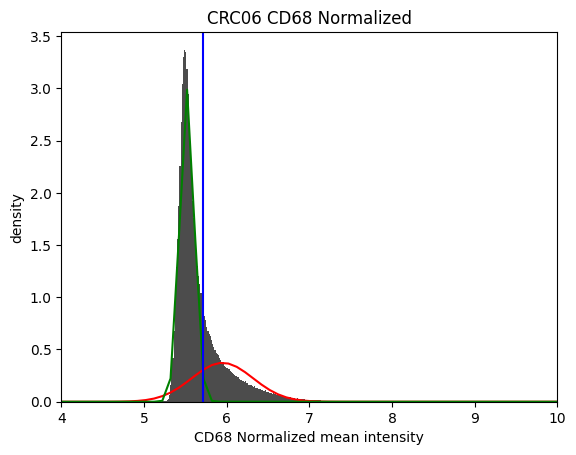

Positive population threshold is: [301.51530612]
Proportion of elements >= [301.51530612]: 28.071960633113658%
Number of elements >= [301.51530612]: 247184
##### Processing marker Argo550 #####
Reference sample for Argo550 is CRC01
shift scaling factor for Argo550 is 1.0199380292125437


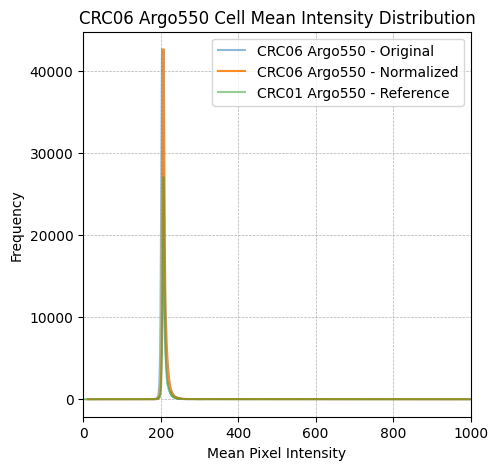

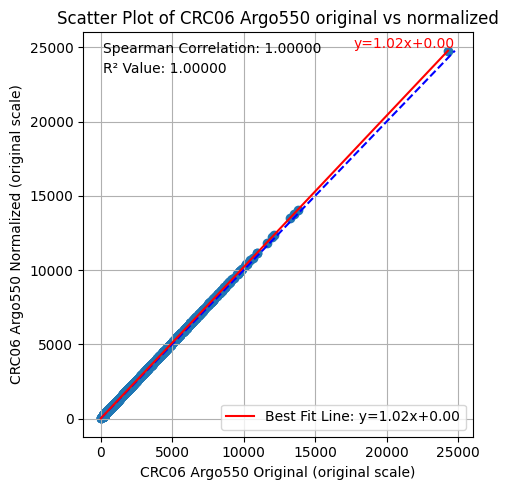

Currently processing Argo550 Original......


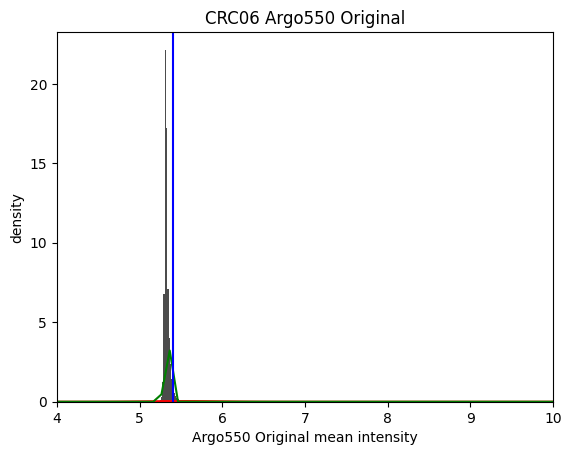

Positive population threshold is: [221.75925926]
Proportion of positive population >= [221.75925926]: 3.7730384980983196%
Number of positive population >= [221.75925926]: 33223
Currently processing Argo550 Normalized......


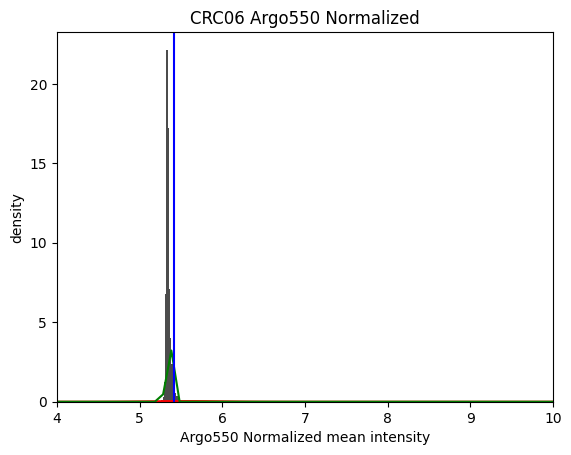

Positive population threshold is: [226.18070185]
Proportion of elements >= [226.18070185]: 3.7730384980983196%
Number of elements >= [226.18070185]: 33223
##### Processing marker CD4 #####
Reference sample for CD4 is CRC02
shift scaling factor for CD4 is 1.0


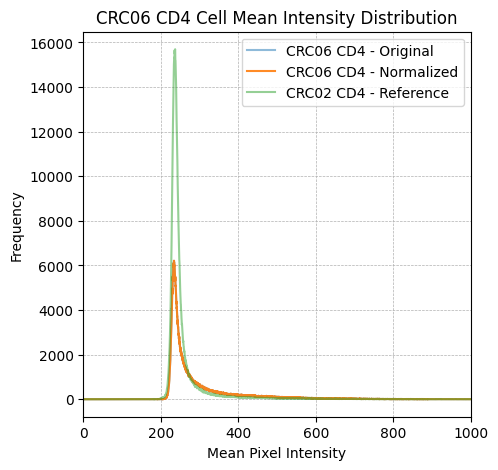

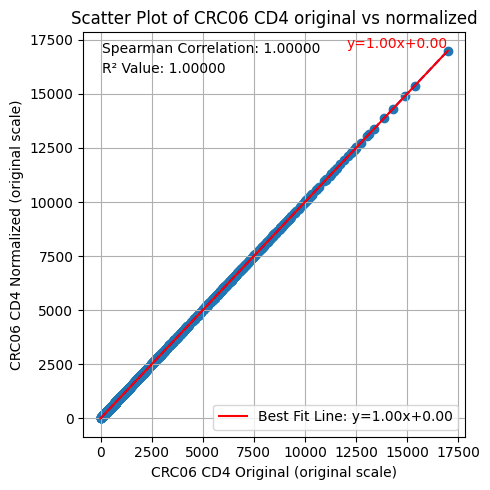

Currently processing CD4 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


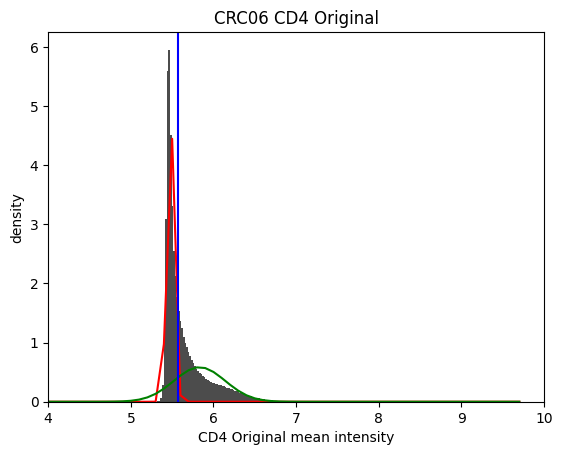

Positive population threshold is: [264.17333333]
Proportion of positive population >= [264.17333333]: 40.10711645280096%
Number of positive population >= [264.17333333]: 353158
Currently processing CD4 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


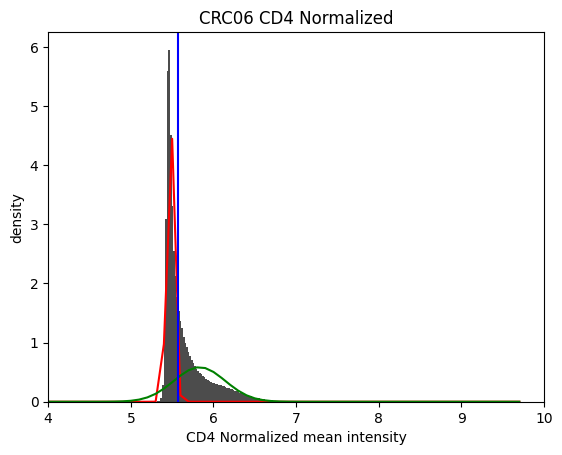

Positive population threshold is: [264.17333333]
Proportion of elements >= [264.17333333]: 40.10711645280096%
Number of elements >= [264.17333333]: 353158
##### Processing marker FOXP3 #####
Reference sample for FOXP3 is CRC01
shift scaling factor for FOXP3 is 1.0136644155042476


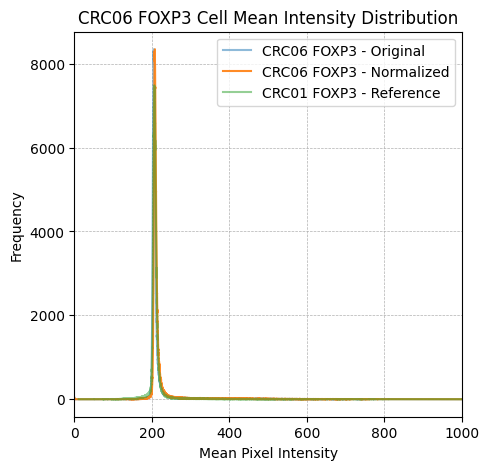

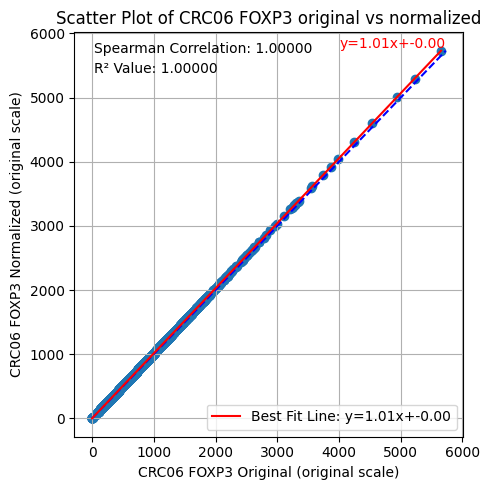

Currently processing FOXP3 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


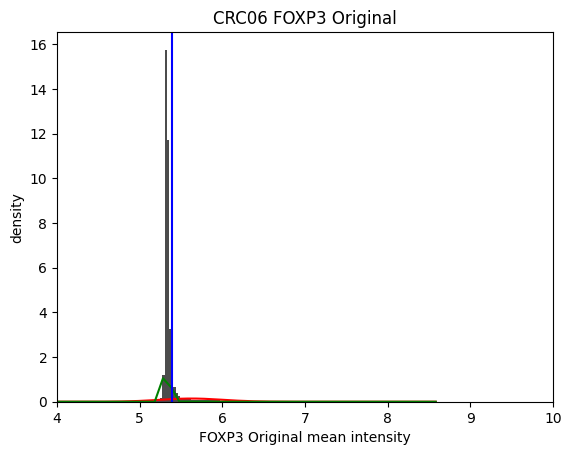

Positive population threshold is: [219.97894737]
Proportion of positive population >= [219.97894737]: 11.60155677728477%
Number of positive population >= [219.97894737]: 102156
Currently processing FOXP3 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


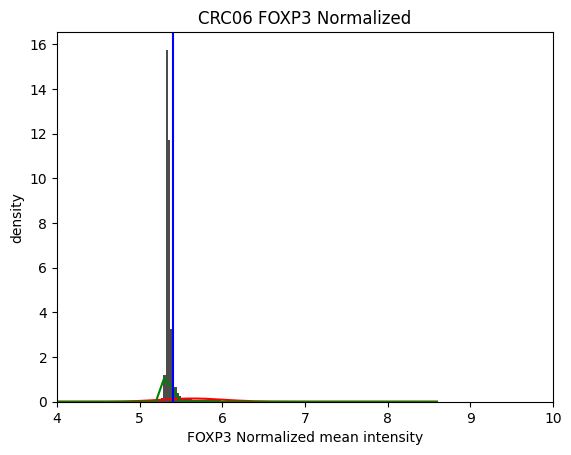

Positive population threshold is: [222.9850534]
Proportion of elements >= [222.9850534]: 11.601443210222854%
Number of elements >= [222.9850534]: 102155
##### Processing marker CD8a #####
Reference sample for CD8a is CRC02
shift scaling factor for CD8a is 1.0100880069084912


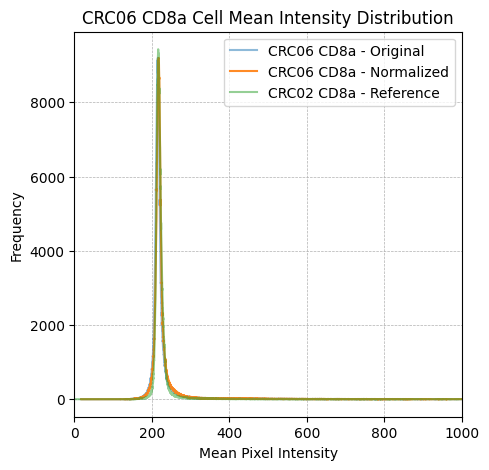

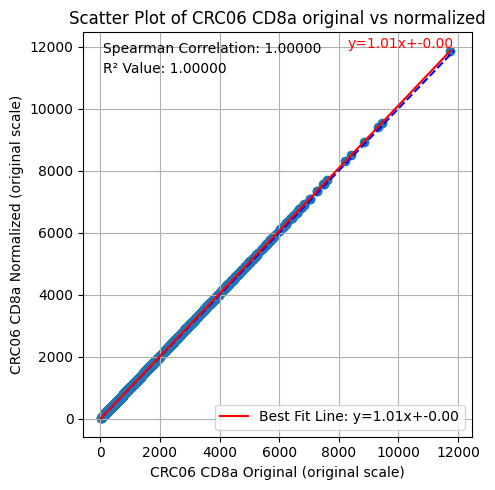

Currently processing CD8a Original......


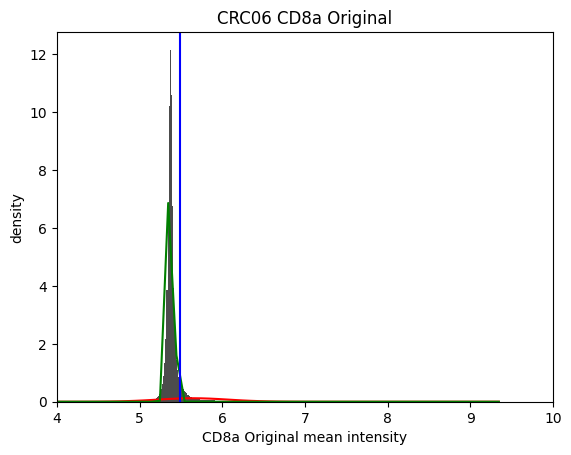

Positive population threshold is: [241.875]
Proportion of positive population >= [241.875]: 9.235159908101535%
Number of positive population >= [241.875]: 81319
Currently processing CD8a Normalized......


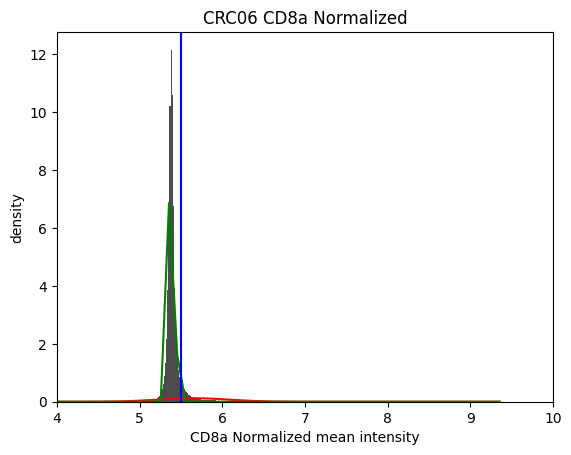

Positive population threshold is: [244.31503667]
Proportion of elements >= [244.31503667]: 9.235159908101535%
Number of elements >= [244.31503667]: 81319
##### Processing marker CD45RO #####
Reference sample for CD45RO is CRC01
shift scaling factor for CD45RO is 0.9685089125261637


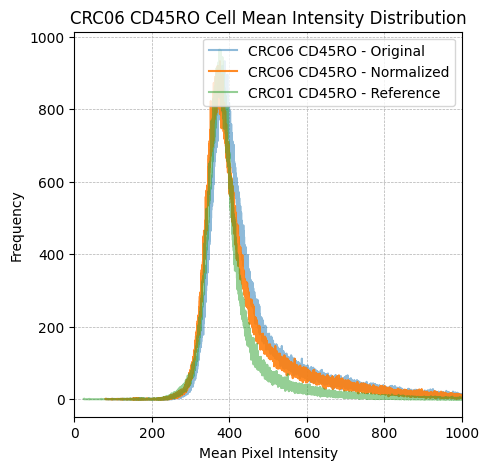

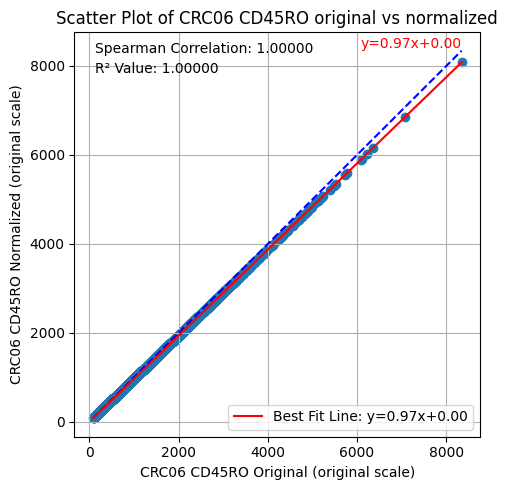

Currently processing CD45RO Original......


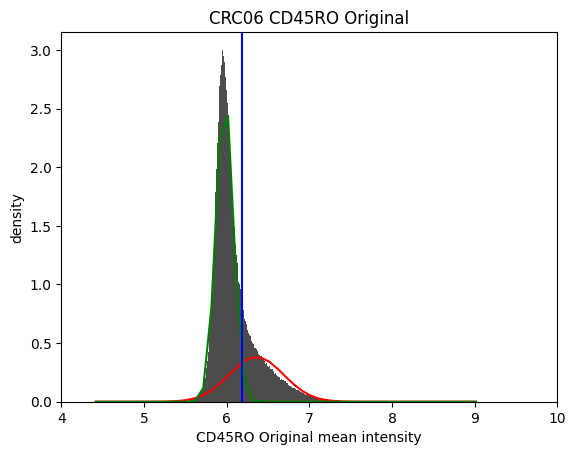

Positive population threshold is: [486.64615385]
Proportion of positive population >= [486.64615385]: 24.513563882040167%
Number of positive population >= [486.64615385]: 215851
Currently processing CD45RO Normalized......


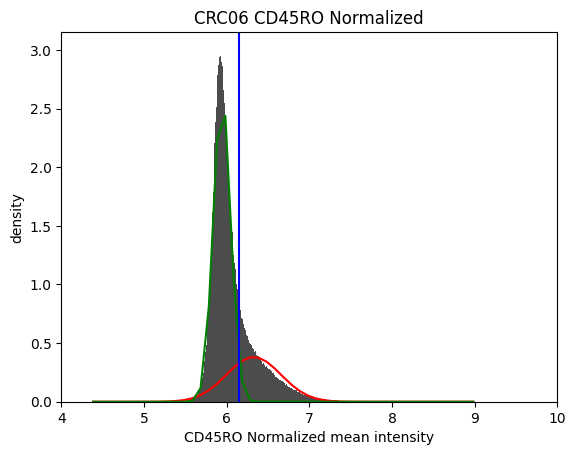

Positive population threshold is: [471.32113725]
Proportion of elements >= [471.32113725]: 24.51367744910208%
Number of elements >= [471.32113725]: 215852
##### Processing marker CD20 #####
Reference sample for CD20 is CRC01
shift scaling factor for CD20 is 0.9895254533665644


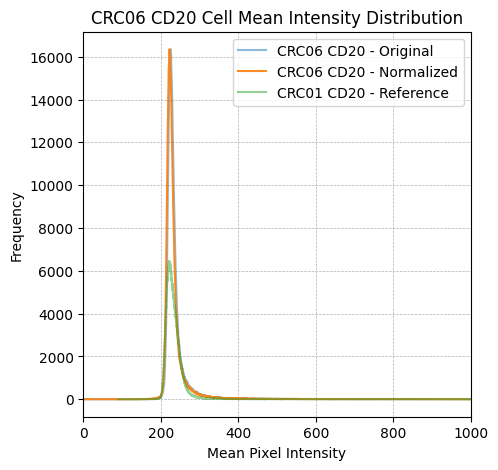

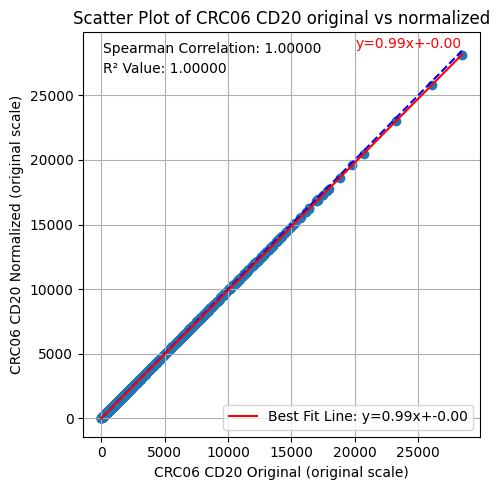

Currently processing CD20 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


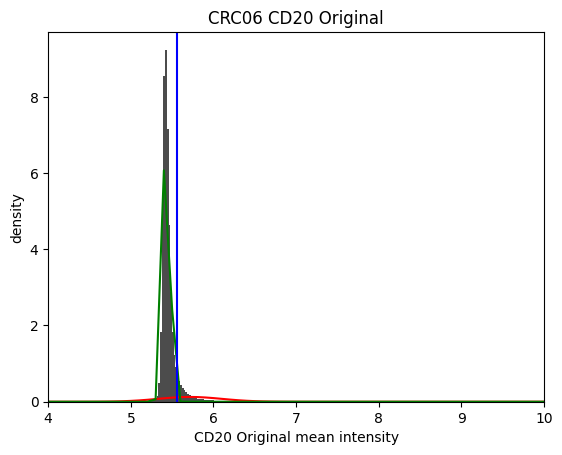

Positive population threshold is: [259.30508475]
Proportion of positive population >= [259.30508475]: 9.64207069095336%
Number of positive population >= [259.30508475]: 84902
Currently processing CD20 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


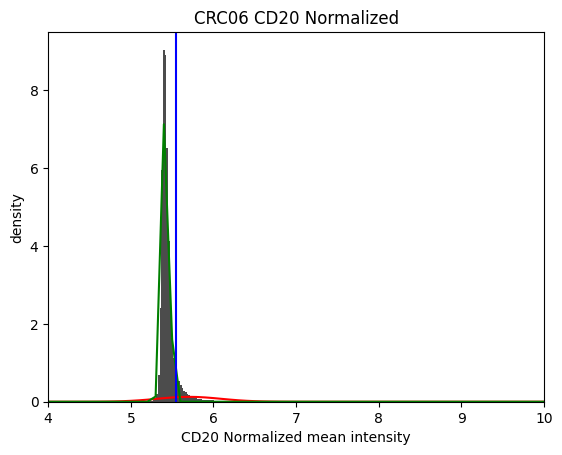

Positive population threshold is: [256.58581709]
Proportion of elements >= [256.58581709]: 9.64320636157254%
Number of elements >= [256.58581709]: 84912
##### Processing marker PD-L1 #####
Reference sample for PD-L1 is CRC01
shift scaling factor for PD-L1 is 0.9156790164524455


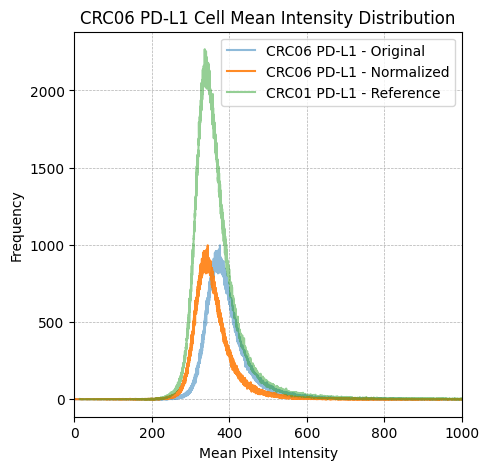

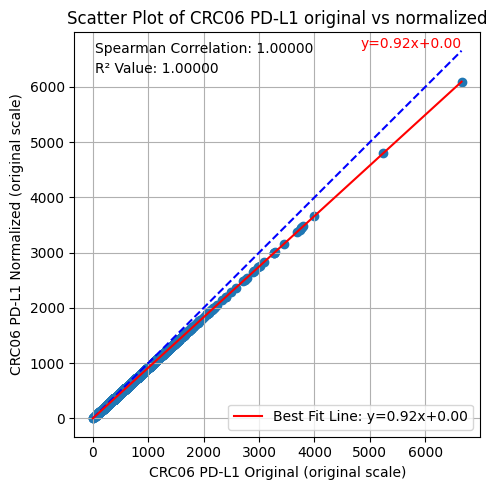

Currently processing PD-L1 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


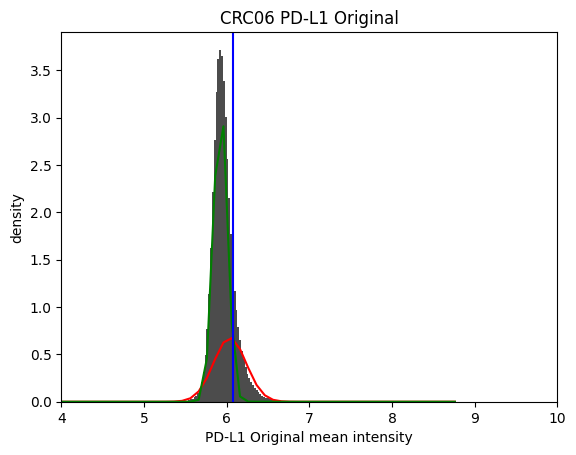

Positive population threshold is: [433.88607595]
Proportion of positive population >= [433.88607595]: 16.926489176491163%
Number of positive population >= [433.88607595]: 149044
Currently processing PD-L1 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


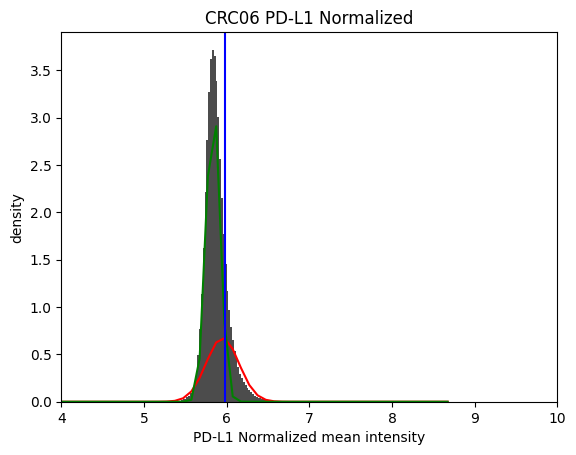

Positive population threshold is: [397.29164635]
Proportion of elements >= [397.29164635]: 16.929669054224867%
Number of elements >= [397.29164635]: 149072
##### Processing marker CD3e #####
Reference sample for CD3e is CRC02
shift scaling factor for CD3e is 0.9497798379014875


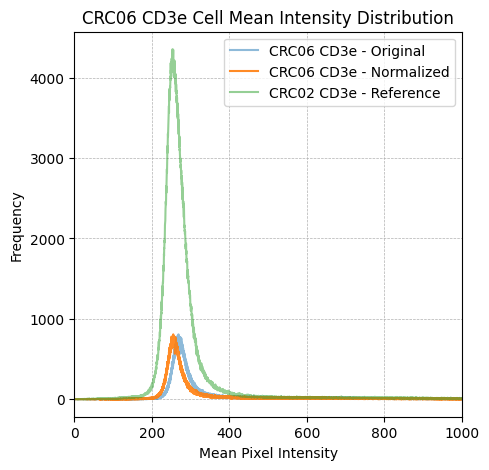

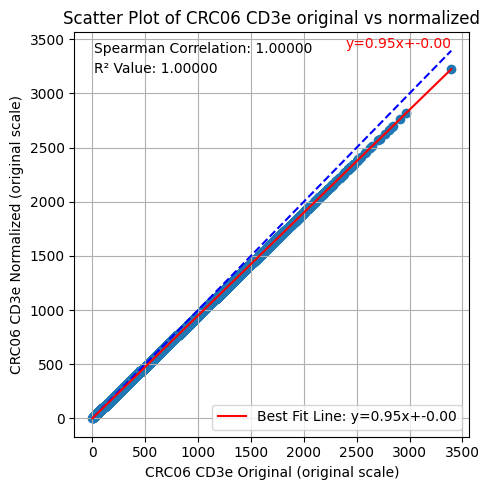

Currently processing CD3e Original......


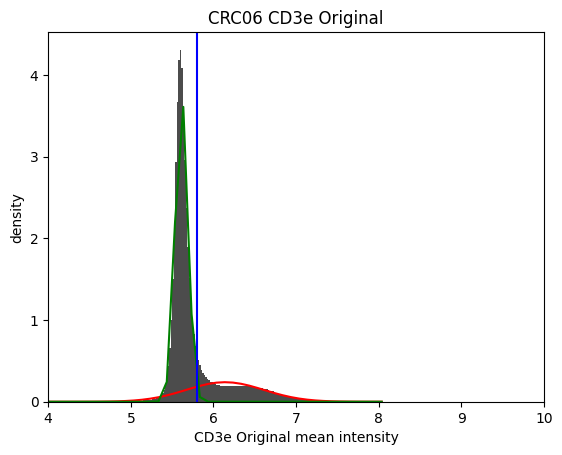

Positive population threshold is: [330.85549133]
Proportion of positive population >= [330.85549133]: 22.95360671953592%
Number of positive population >= [330.85549133]: 202115
Currently processing CD3e Normalized......


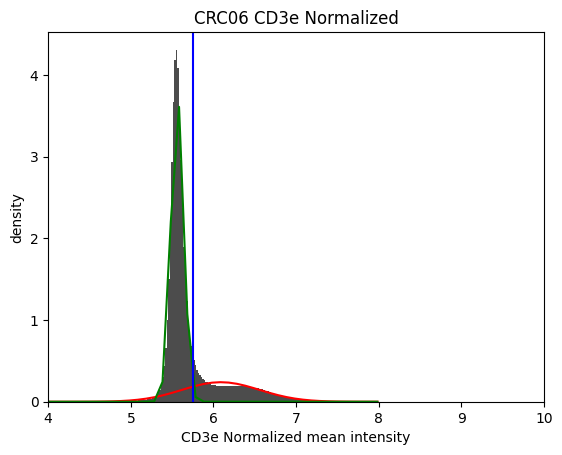

Positive population threshold is: [314.23987492]
Proportion of elements >= [314.23987492]: 22.953720286597836%
Number of elements >= [314.23987492]: 202116
##### Processing marker CD163 #####
Reference sample for CD163 is CRC05
shift scaling factor for CD163 is 0.9422548188068528


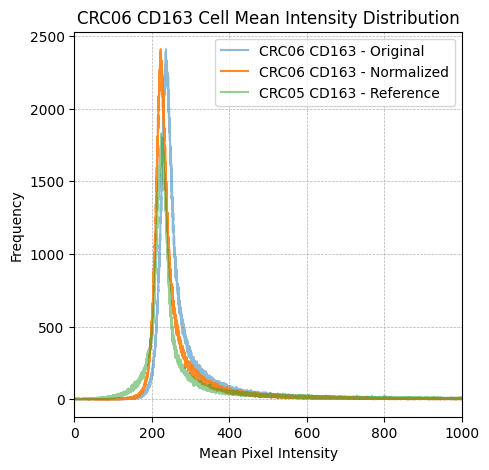

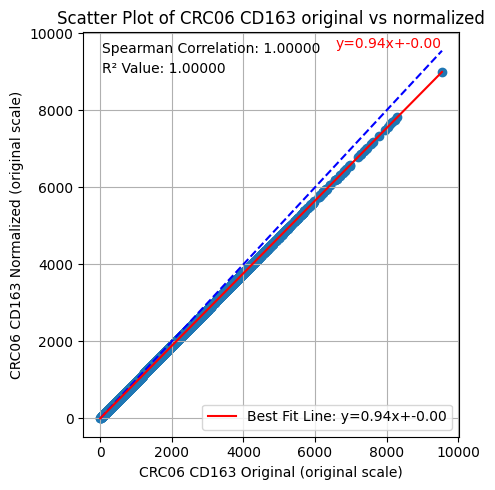

Currently processing CD163 Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


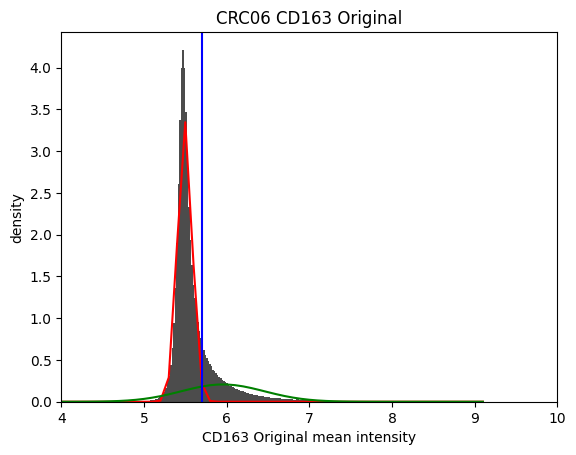

Positive population threshold is: [300.93406593]
Proportion of positive population >= [300.93406593]: 20.210394338909097%
Number of positive population >= [300.93406593]: 177960
Currently processing CD163 Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


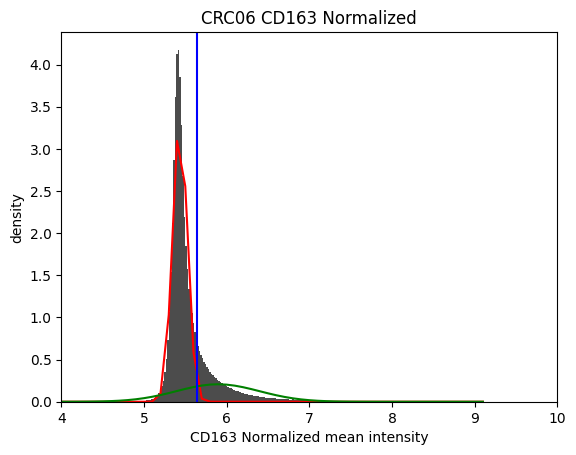

Positive population threshold is: [283.55481878]
Proportion of elements >= [283.55481878]: 20.211189308342522%
Number of elements >= [283.55481878]: 177967
##### Processing marker E-cadherin #####
Reference sample for E-cadherin is CRC01
shift scaling factor for E-cadherin is 0.9867398439739513


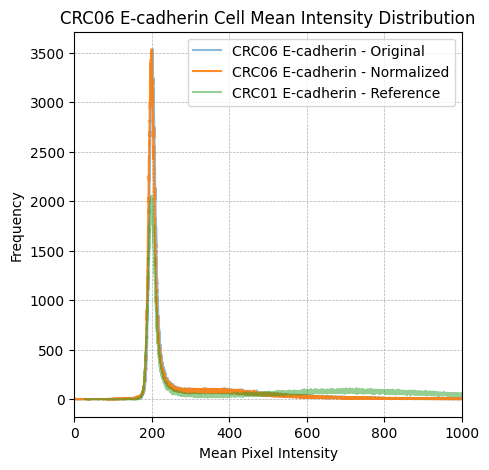

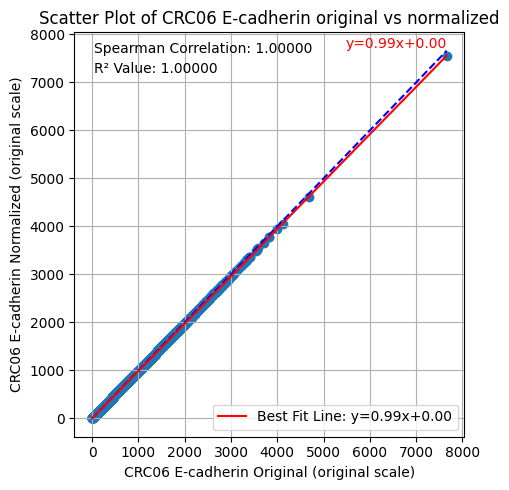

Currently processing E-cadherin Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


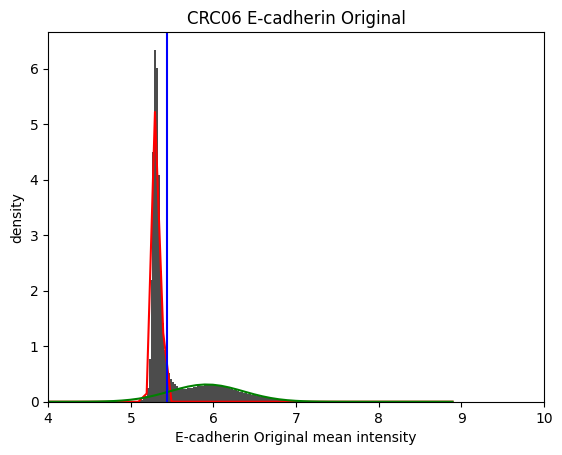

Positive population threshold is: [228.63478261]
Proportion of positive population >= [228.63478261]: 31.350868844807202%
Number of positive population >= [228.63478261]: 276056
Currently processing E-cadherin Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


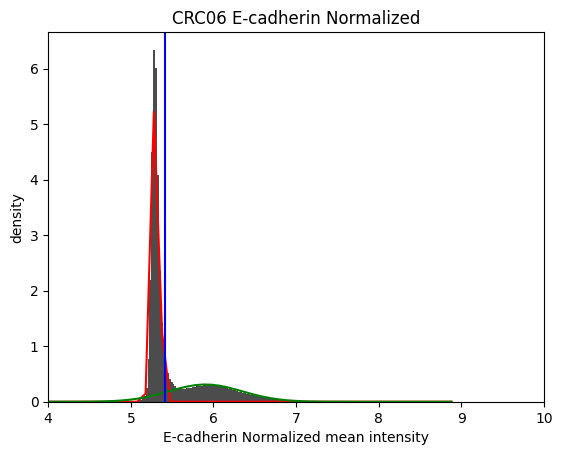

Positive population threshold is: [225.60242189]
Proportion of elements >= [225.60242189]: 31.35120954599296%
Number of elements >= [225.60242189]: 276059
##### Processing marker PD-1 #####
Reference sample for PD-1 is CRC01
shift scaling factor for PD-1 is 1.0571071102490945


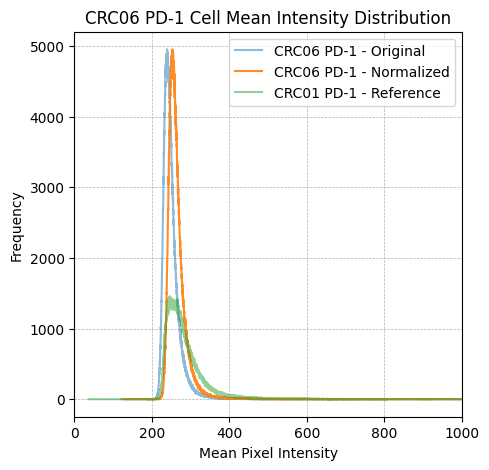

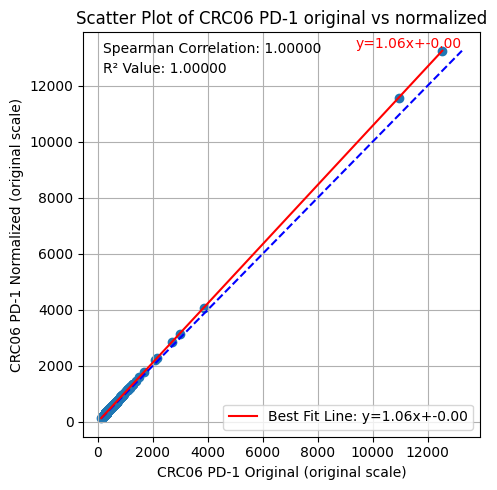

Currently processing PD-1 Original......


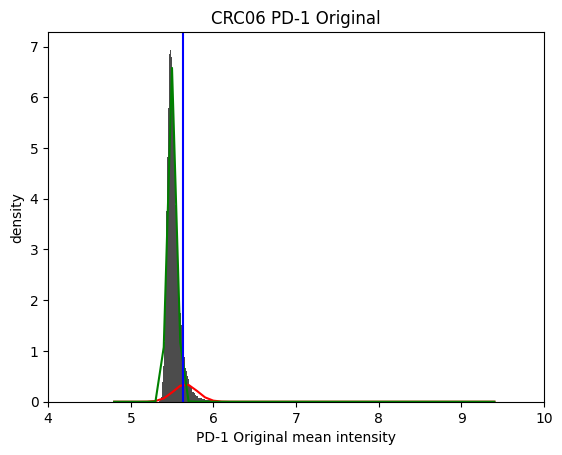

Positive population threshold is: [278.35658915]
Proportion of positive population >= [278.35658915]: 8.576470948977725%
Number of positive population >= [278.35658915]: 75519
Currently processing PD-1 Normalized......


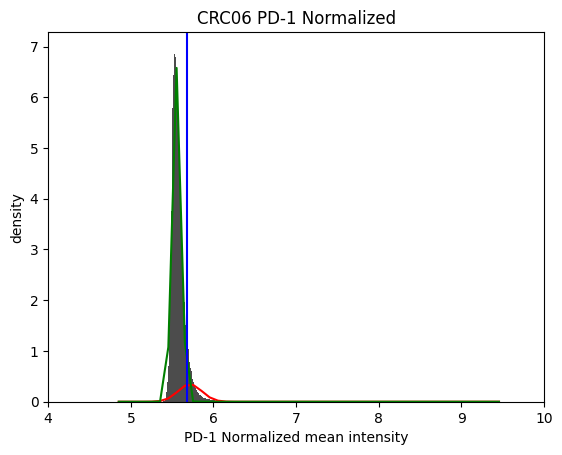

Positive population threshold is: [294.25272957]
Proportion of elements >= [294.25272957]: 8.576470948977725%
Number of elements >= [294.25272957]: 75519
##### Processing marker Ki67 #####
Reference sample for Ki67 is CRC02
shift scaling factor for Ki67 is 1.0


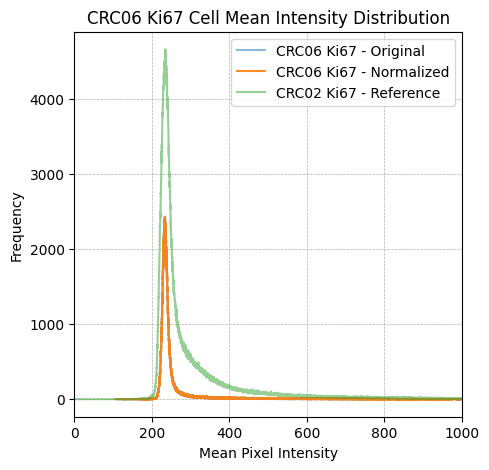

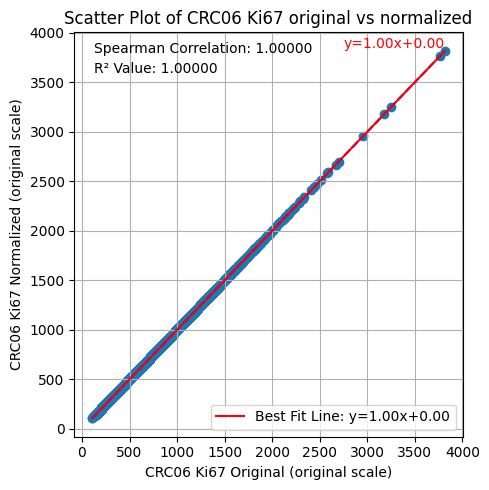

Currently processing Ki67 Original......


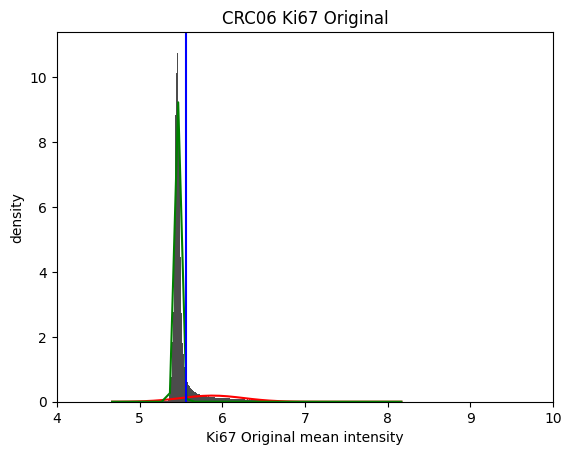

Positive population threshold is: [260.34042553]
Proportion of positive population >= [260.34042553]: 15.953787291164371%
Number of positive population >= [260.34042553]: 140479
Currently processing Ki67 Normalized......


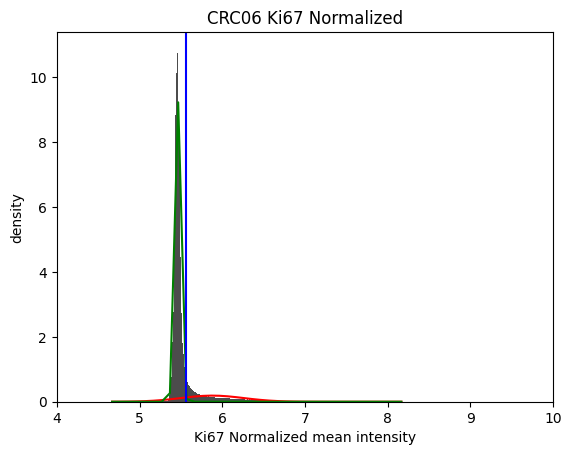

Positive population threshold is: [260.34042553]
Proportion of elements >= [260.34042553]: 15.953787291164371%
Number of elements >= [260.34042553]: 140479
##### Processing marker Pan-CK #####
Reference sample for Pan-CK is CRC01
shift scaling factor for Pan-CK is 0.9573298089130533


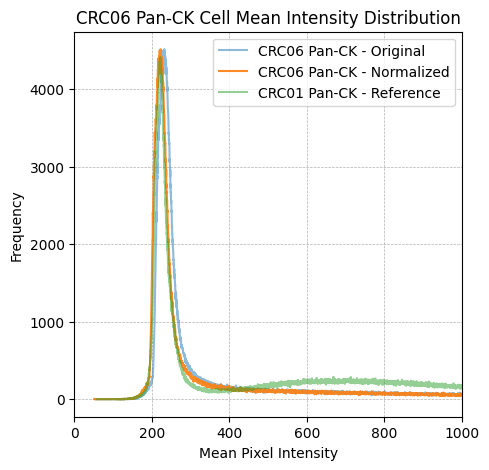

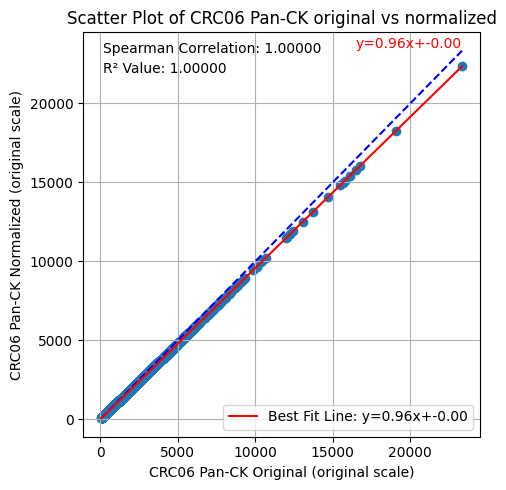

Currently processing Pan-CK Original......


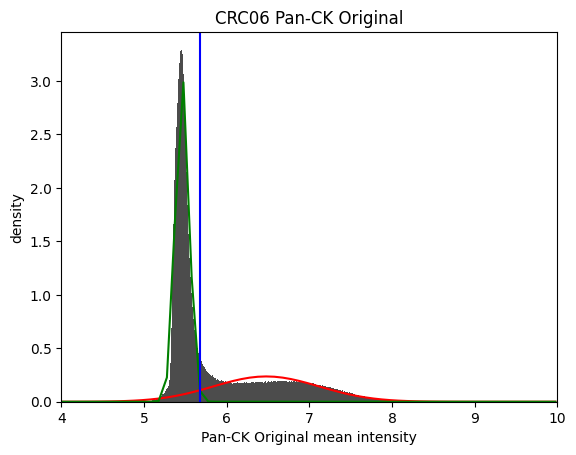

Positive population threshold is: [291.74358974]
Proportion of positive population >= [291.74358974]: 35.40055670573752%
Number of positive population >= [291.74358974]: 311715
Currently processing Pan-CK Normalized......


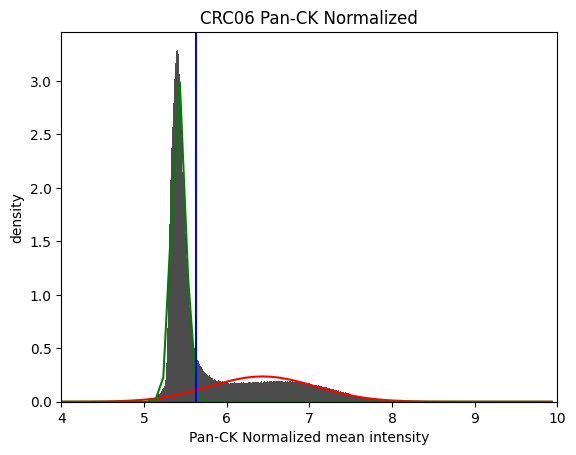

Positive population threshold is: [279.29483502]
Proportion of elements >= [279.29483502]: 35.40032957161369%
Number of elements >= [279.29483502]: 311713
##### Processing marker SMA #####
Reference sample for SMA is CRC01
shift scaling factor for SMA is 0.9734783901149197


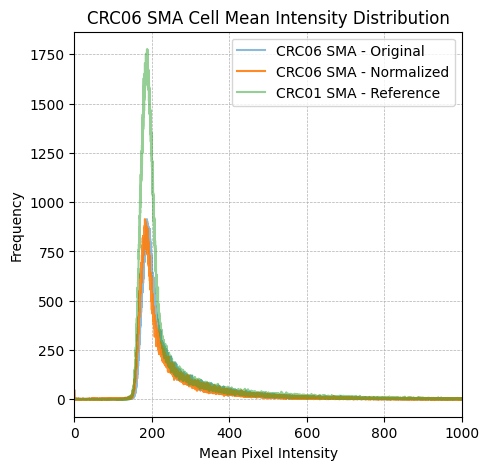

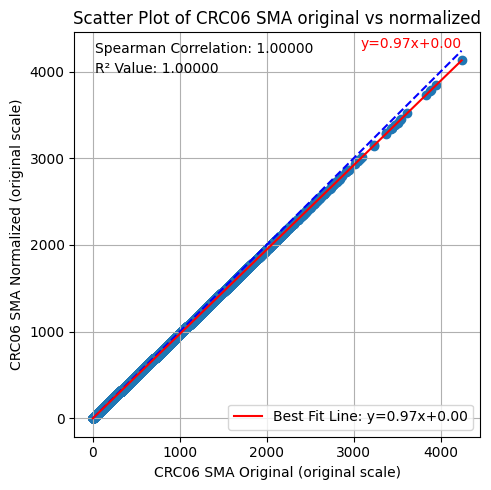

Currently processing SMA Original......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


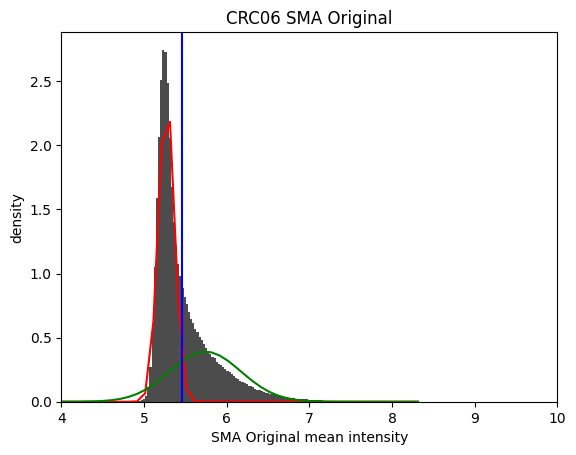

Positive population threshold is: [236.27659574]
Proportion of positive population >= [236.27659574]: 34.99364592288569%
Number of positive population >= [236.27659574]: 308132
Currently processing SMA Normalized......


/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/plot.py:25: RuntimeWarning: divide by zero encountered in log
  X = np.log(X)


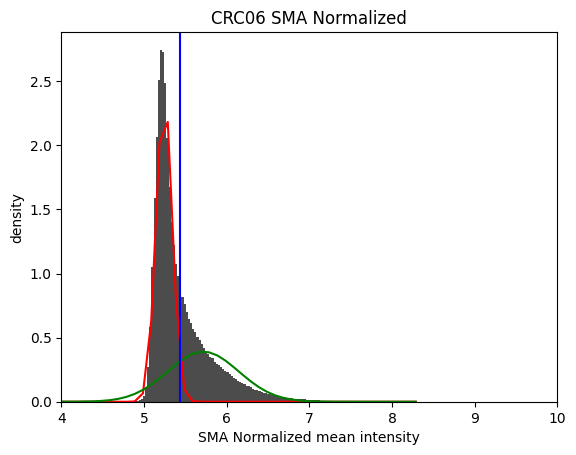

Positive population threshold is: [229.9980453]
Proportion of elements >= [229.9980453]: 34.99716650180515%
Number of elements >= [229.9980453]: 308163
##############################Feature Normalization Done##############################




In [25]:
output_directory = "/home/groups/ChangLab/wangmar/shift-panel-reduction/shift-panel-reduction-main/landmark_normalization/cycif-normalization-pipeline/command_line_script/final_script/normalized_feature_dataset"

generate_normalized_feature(
    feature_data=feature_data,
    sample_names=sample_names,
    marker_dict=marker_list,
    shift_in_log_pixels_dict=shift_in_log_pixels_dict,
    reference_sample=reference_sample,
    num_bins=2**16, # need if you want to plot normalized image's distribution
    output_directory=output_directory, # the dir in which you want the normalized images to be stored at
    dpi=100,
    plot_dist=True, # whether you wanna plot pixel intensity distribution
    plot_single_cell_corr=True, # whether you wanna plot the single cell level correlation
    gmm_analysis=True, # whether you wanna perform a GMM analysis to comparison positive population before and after normalization
    save_normalized_features=False # whether you wanna save the stacked normalized images, set this to false if you first wanna see the performance of the normalization
)